In [1]:
from model1 import *

In [2]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
import os
from os.path import dirname, abspath
import csv
import pandas as pd
import scipy.misc as sm
import numpy as np
import matplotlib.pyplot as plt


In [3]:
import torch.utils.data as tud
from PIL import Image
import torchvision.datasets as td
import torchvision.transforms as transforms

In [4]:
img_size = 128
imgpath = '/home/daiict/Desktop/udit/Diabetic_Retinopathy_Detection-master/Bigan Implementation-DR/train06/'
prep = transforms.Compose([transforms.Scale(128),transforms.CenterCrop(128),transforms.ToTensor()])
images_= td.ImageFolder(imgpath,transform = prep)
tot_imgs = (len(images_))
print tot_imgs
loader = tud.DataLoader(images_,batch_size = 1,shuffle = False)
#print next(iter(loader))


1245


[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
1.0 0.0


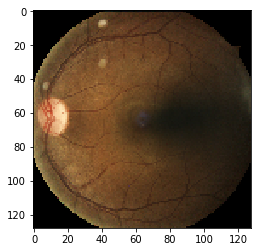

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
0.921569 0.0


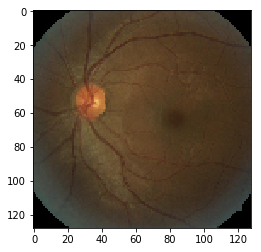

[[[ 0.          0.          0.         ...,  0.00392157  0.          0.        ]
  [ 0.          0.          0.00392157 ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.00784314  0.          0.         ...,  0.01176471  0.          0.        ]
  [ 0.          0.          0.01176471 ...,  0.00784314  0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.  

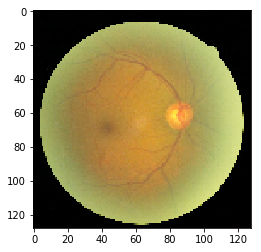

[[[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.00392157  0.          0.         ...,  0.00392157  0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.01176471  0.          0.         ...,  0.00392157  0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.  

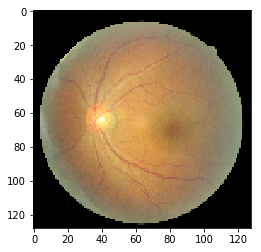

[[[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.00784314  0.00392157  0.00784314 ...,  0.          0.          0.        ]
  [ 0.00392157  0.00784314  0.00784314 ...,  0.00784314  0.          0.00784314]
  [ 0.00784314  0.00784314  0.         ...,  0.00784314  0.00784314
    0.00784314]]

 [[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.00392157  0.         ...,  0.          0.          0.        ]
  [ 0.00392157  0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0

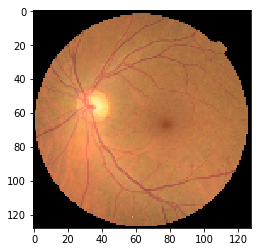

[[[ 0.          0.00784314  0.         ...,  0.00392157  0.          0.        ]
  [ 0.          0.00392157  0.00784314 ...,  0.          0.00392157  0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.00784314 ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.00784314  0.01568628  0.00784314 ...,  0.01176471  0.00784314  0.        ]
  [ 0.00784314  0.01176471  0.01568628 ...,  0.00784314  0.00392157
    0.00784314]
  [ 0.          0.          0.         ...,  0.00784314  0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.00784314 ...,  0.          0.          0.        ]
  [ 0.00392157  0.          0.         ...,  0.          0.          0.        ]]

 [[ 0

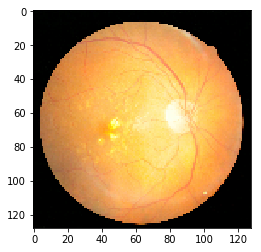

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
0.984314 0.0


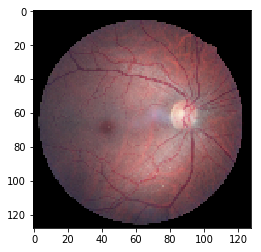

[[[ 0.          0.00392157  0.         ...,  0.          0.          0.00392157]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.00784314  0.00392157  0.         ...,  0.          0.          0.00392157]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.00

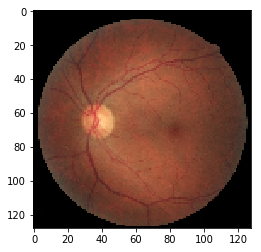

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
1.0 0.0


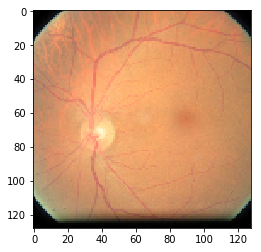

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
0.952941 0.0


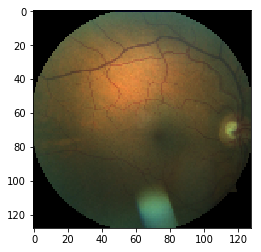

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
1.0 0.0


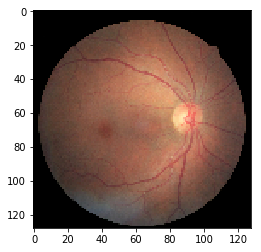

[[[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.00784314  0.         ...,  0.          0.          0.        ]]

 [[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.  

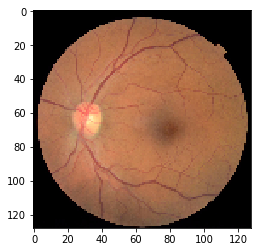

[[[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.00784314  0.00392157  0.00784314 ...,  0.          0.          0.        ]
  [ 0.          0.          0.01568628 ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.00784314 ...,  0.          0.          0.        ]
  ..., 
  [ 0.01176471  0.00392157  0.01568628 ...,  0.          0.          0.        ]
  [ 0.          0.          0.01568628 ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.  

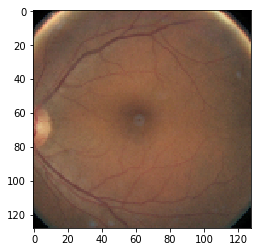

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
0.988235 0.0


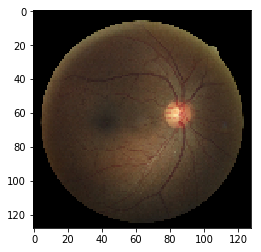

[[[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]

 [[ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  ..., 
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]
  [ 0.  0.  0. ...,  0.  0.  0.]]]
1.0 0.0


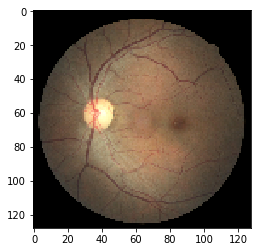

[[[ 0.          0.00784314  0.         ...,  0.00392157  0.00392157
    0.00392157]
  [ 0.00784314  0.00392157  0.00392157 ...,  0.00392157  0.00784314
    0.00392157]
  [ 0.00392157  0.          0.00392157 ...,  0.00784314  0.00784314
    0.00784314]
  ..., 
  [ 0.00784314  0.00784314  0.00784314 ...,  0.00392157  0.          0.01176471]
  [ 0.00784314  0.00784314  0.00784314 ...,  0.00784314  0.00784314
    0.00784314]
  [ 0.01176471  0.00784314  0.00784314 ...,  0.01568628  0.00784314
    0.00392157]]

 [[ 0.          0.00784314  0.         ...,  0.00392157  0.00392157
    0.00392157]
  [ 0.00784314  0.00392157  0.00392157 ...,  0.00392157  0.00784314
    0.00392157]
  [ 0.00392157  0.          0.00392157 ...,  0.00784314  0.00784314
    0.00784314]
  ..., 
  [ 0.00784314  0.00784314  0.00784314 ...,  0.00392157  0.          0.00392157]
  [ 0.00784314  0.00784314  0.00784314 ...,  0.00784314  0.00784314
    0.00784314]
  [ 0.00392157  0.00784314  0.00784314 ...,  0.00784314  0.00784

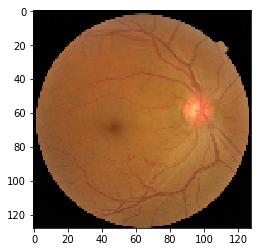

[[[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.00784314  0.          0.        ]
  ..., 
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]
  [ 0.          0.          0.         ...,  0.          0.          0.        ]]

 [[ 0.  

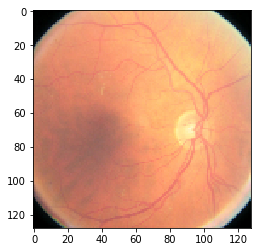

KeyboardInterrupt: 

In [5]:
for i , data in enumerate(loader):
    x,y = data
    x = x.numpy()
    img = x[0,:,:,:]
    print img
    
    print np.max(img),np.min(img)
    
    plt.imshow(img.transpose(1,2,0))
    plt.show()
    

In [6]:
cuda = True
batch_size = 1

In [7]:
G = Generator()
D = Discriminator()
E = Encoder()
# print G,D,E

In [8]:
if cuda:
    G = G.cuda()
    D = D.cuda()
    E = E.cuda()

In [9]:
def gan_loss(dis_enc,dis_gen,criterion,real,fake,cuda,l1):
    labels_ones = Variable(torch.ones(dis_enc.size()[0],1))
    labels_zeros = Variable(torch.zeros(dis_enc.size()[0],1))
    #labels_gen = Variable(torch.ones(dis_fake.size()[0],1))
    
    if cuda:
        labels_ones =  labels_ones.cuda()
        labels_zeros = labels_zeros.cuda()
        #labels_gen  = labels_gen.cuda()    
    dis_loss  = 0.5*criterion(dis_enc,labels_ones)  +  0.5*criterion(dis_gen,labels_zeros)
    #dis_loss = 0.5*criterion(dis_gen,labels_zeros)
    gen_loss =   criterion(dis_gen,labels_ones) + 10*l1(real,fake)
    enc_loss = criterion(dis_enc,labels_zeros)
    
    #sv = 1e-20
    #dis_loss = -torch.mean(torch.log(dis_enc+sv)) -torch.mean(torch.log(1-dis_gen+sv))
    #dis_loss = (-1)*gen_loss
    #gen_loss = -1*dis_loss
    
    return dis_loss, gen_loss,enc_loss

In [10]:
from itertools import chain
recon_criteria = nn.MSELoss()
gan_criterion = nn.BCELoss()
L1_criterion = nn.L1Loss()

gen_parameters = G.parameters()
enc_parameters = E.parameters()
dis_parameters = D.parameters()
optim_gen = optim.Adam(gen_parameters, lr = 0.001, betas=(0.9,0.999))
optim_dis = optim.Adam(dis_parameters, lr = 0.001, betas=(0.9,0.999))
optim_enc = optim.Adam(enc_parameters, lr = 0.001, betas=(0.9,0.999))
iters = 0
gen_loss_total = []
dis_loss_total = []

In [11]:
def as_np(x):
    return x.cpu().data.numpy()

In [12]:

update_int = 2
z_dim = 100
for epoch in range(100):
    
    for i,data in enumerate(loader):
        X,y = data
        X = Variable(X)
        z = Variable(torch.rand(X.size()[0],z_dim,1,1))

        if cuda:
            z = z.cuda()
            X = X.cuda()
            
        oldxx = list(D.parameters())
        oldyy = list(G.parameters())
        oldzz = list(E.parameters())

        ## Now train the network 

        z_hat = E(X)   
        D_enc = D(X,z_hat)  ## Discriminator will give the probability of this being a actual sample
        x_hat = G(z)
        
        D_gen = D(x_hat,z)

       
        ## Loss calculation
        dis_loss,gen_loss,enc_loss = gan_loss(D_enc,D_gen,gan_criterion,x_hat,X,cuda,L1_criterion)
        
        ## Parameter Update
        
        if i%update_int == 0:
            D.zero_grad
            dis_loss.backward()
            optim_dis.step()
        else:
            G.zero_grad()
            gen_loss.backward()
            optim_gen.step()
            E.zero_grad()
            enc_loss.backward()
            optim_enc.step()
            
        newxx = list(D.parameters())
        newyy = list(G.parameters())
        newzz = list(E.parameters())


        for param in D.parameters():
          #  print(param.grad.data.sum())
        #print 'Genrator parameters'
        
        for param in G.parameters():
            #print(param.grad.data.sum())

        if oldxx==newxx and oldyy==newyy and oldzz==newzz:
            #print 'parametets are same'   
    
    if epoch%2 == 0:    
        
        print("iterartion %s Dsicriminator loss %s generator loss %s  " % (epoch,as_np(dis_loss.mean()), as_np(gen_loss.mean())))
        samples = G(z).cpu().data.numpy()[:16]
        import matplotlib.gridspec as gridspec
        fig = plt.figure(figsize = (8,8))
        gs = gridspec.GridSpec(4,4)
        gs.update(wspace = 0.05, hspace = 0.05)
        print epoch
        for i,sample in enumerate(samples):
            ax= plt.subplot(gs[i])
            plt.axis('off')
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            plt.close()

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.00513681955636
0.0
-0.00784209370613
-0.0238168686628
-0.00870011746883
1.27528274059
0.0112212654203
0.0590185672045
-0.00353336893022
0.286998897791
0.0882820561528
0.376121520996
0.0595601573586
0.0276733525097
-0.0110315978527
Genrator parameters
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.0142104011029
0.00413066940382
0.0842498764396
0.295746177435
0.0895387381315
-0.238668501377
-0.082117125392
2.36847448349
0.1617077142
3.92639756203
0.257266551256
-0.306987851858
-0.116394393146
-1.32902419567
-0.0379496514797
Genrator parameters
2.50989614869e-07
-0.00372409913689
-0.00276722363196
-23.739074707
0.000362611957826
9.52271511778e-05
-15.4639568329
0.000863341148943
0.00561349093914
-19.718454361
0.00168276717886
0.00764073245227
0.458243906498
0.437785595655
0.4702930

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.0832441002131
0.0222875308245
0.276338398457
-0.45174190402
-0.12492865324
3.38733291626
-0.0560488328338
35.7591094971
0.129311397672
79.0466003418
0.220593437552
46.5648612976
-0.0235764253885
-26.9180927277
-0.177083179355
Genrator parameters
-1.19045580504e-07
0.00585036259145
0.153222426772
-119.725906372
0.00634429883212
0.52582192421
-182.577362061
0.0020265111234
0.716266572475
-143.941329956
0.0204574801028
0.831557273865
-52.1344032288
4.26069068909
8.78872776031
461.111694336
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.0210376866162
0.0359858982265
0.356768965721
-0.181022018194
-0.0294067040086
1.36220633984
-0.106961227953
36.0072021484
0.115799248219
95.0393371582
0.223991379142
87.0274734497
0.502672016621
2.45649051666
-0.130131304264
Genrator parameters
1.28369720187e-07
-0.00780511181802
-0.181248217821
49.2034378052
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.151364982128
0.112307414412
0.676366329193
1.09395027161
0.215211421251
-21.9319229126
-0.452286720276
20.5483226776
-0.901762783527
77.2778244019
-1.6790907383
61.1406974792
-1.31603980064
1.28026413918
-0.0678162872791
Genrator parameters
9.13897508781e-08
-0.00187618564814
0.129564478993
-33.3117752075
-0.00334414280951
0.367260158062
-158.086929321
-0.00322596635669
0.956147134304
-151.833709717
0.0298557486385
1.10005891323
-41.32056427
6.27035331726
11.894068718
557.350646973
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.150531440973
0.100346080959
0.634811341763
0.927303910255
0.145612478256
-20.2543182373
-0.41693174839
17.4277057648
-0.889634668827
71.8585357666
-1.71510124207
58.1304321289
-1.34142065048
-3.32805252075
-0.0101747959852
Genrator parameters
9.13897508781e-08
-0.00187618564814
0.129564478993
-33.3117752075
-0.003344142

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.114694572985
0.149312958121
0.786963224411
2.1937212944
0.766674518585
-2.34571456909
-0.860061645508
-200.513153076
-1.36810386181
-110.100982666
-1.92904758453
-23.6533317566
-2.93570756912
-303.200592041
-1.17092466354
Genrator parameters
1.46956722347e-08
-0.0109045570716
0.186151474714
-44.1856460571
-0.0131515329704
0.512257397175
-112.423301697
-0.00476222718135
0.844404816628
-78.2537536621
0.00977352727205
0.872055768967
-93.6981582642
0.468241244555
1.81359922886
-106.558128357
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.127778440714
0.224310517311
0.981569051743
2.39760875702
0.877332210541
-20.0579967499
-1.2388933897
-210.325927734
-1.76513922215
-120.207061768
-2.4026081562
-36.0542259216
-3.57106590271
-310.297058105
-1.47723996639
Genrator parameters
9.90694388747e-08
-0.00869120843709
0.266837358475
-37.6884918213
-0.012972

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.0704825222492
0.120090670884
0.752144217491
0.77158343792
0.247137486935
2.91968870163
-0.756362915039
-212.012023926
-1.8190561533
-110.916824341
-1.28484666348
-13.2005310059
-1.89310717583
-302.961975098
-1.14882433414
Genrator parameters
2.27248051488e-08
-0.00259218947031
0.207755446434
-86.4043731689
-0.00950065068901
0.728472173214
-112.08290863
-0.0111551173031
0.999387860298
-127.920890808
-0.00053058587946
1.39843833447
-60.4889640808
3.92272233963
8.78392887115
438.948944092
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.101271688938
-0.0105418730527
0.473795682192
-0.216007471085
-0.0595815479755
14.3534193039
-0.529487848282
-206.388519287
-1.35470056534
-107.177955627
-1.04588222504
-8.72732162476
-1.57170903683
-298.069335938
-0.837328255177
Genrator parameters
2.27248051488e-08
-0.00259218947031
0.207755446434
-86.4043731689
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0581260919571
0.373594790697
1.17239630222
3.34511017799
1.19091391563
251.176269531
4.25213479996
-41.6911315918
5.61959981918
79.9282073975
5.03692102432
140.312225342
3.29238891602
-201.142379761
0.773767948151
Genrator parameters
-1.04020955405e-07
-0.00214310502633
-0.061307631433
-4.50050401688
-0.00121183751617
0.0338007211685
-25.9822826385
0.00194592308253
0.236680269241
-37.2141914368
-0.00786531995982
0.420232325792
-13.8180437088
2.21616482735
4.76804447174
241.476898193
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0679249316454
0.398553133011
1.258223176
3.54321122169
1.2436517477
243.831604004
4.11059904099
-47.7507019043
5.42780590057
75.4974060059
4.93386173248
134.137054443
3.13587617874
-204.963500977
0.716726541519
Genrator parameters
4.81725237478e-08
0.00302194361575
-0.160433486104
45.6911430359
0.0129435872659
-0.59111

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.162272006273
0.403415799141
2.00298333168
4.02853536606
2.1128320694
221.717910767
3.71672868729
30.4920310974
8.03549385071
151.062988281
6.42604970932
185.605377197
4.56946659088
-181.839004517
0.365417599678
Genrator parameters
-7.59122258387e-08
0.00117673364002
-0.152336314321
43.4787902832
0.00935836695135
-0.440609633923
50.1155052185
0.00766804302111
-0.530315876007
73.623336792
0.0100961094722
-0.818462729454
-3.91220355034
-4.24345636368
-9.03604412079
-603.135253906
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0964198559523
0.172358438373
1.55188632011
3.32655215263
1.69838321209
216.103988647
3.6097342968
27.5445022583
7.8789434433
140.971221924
6.10936355591
180.916320801
4.45488214493
-177.994613647
0.483279049397
Genrator parameters
-7.59122258387e-08
0.00117673364002
-0.152336314321
43.4787902832
0.00935836695135
-0.440609633

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
1.66218149662
8.23083114624
16.4702777863
46.5633621216
18.0622177124
349.238891602
6.59449386597
99.51587677
11.1653757095
332.188537598
14.3906602859
330.091369629
9.9241399765
-343.467346191
-4.24836349487
Genrator parameters
6.47637250495e-08
-0.0055543910712
0.130320891738
-70.5775985718
-0.0176178123802
0.622641146183
-97.7418365479
-0.0098911318928
0.879824697971
-65.6307983398
-0.0016731080832
0.914191603661
-68.1296005249
2.33727669716
5.7658829689
180.141845703
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
1.76398897171
8.09985351562
16.3548316956
45.9703063965
17.8693504333
345.837738037
6.52487850189
97.4748916626
11.0188846588
327.148681641
14.2090539932
330.046691895
9.9229888916
-340.902618408
-4.20450162888
Genrator parameters
6.47637250495e-08
-0.0055543910712
0.130320891738
-70.5775985718
-0.0176178123802
0.622641146183
-97.7418

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
2.56814980507
8.52470493317
17.9646091461
49.7019577026
19.3578147888
473.855316162
9.16382980347
169.810180664
15.5271663666
418.033630371
21.0174541473
433.382507324
12.9071416855
-345.577575684
-5.600897789
Genrator parameters
2.6901034289e-08
0.0010514453752
-0.0847787559032
39.4652519226
0.00768805155531
-0.380634248257
64.326210022
0.0071026282385
-0.52427893877
31.9128036499
0.00141001224983
-0.510279417038
36.2141494751
-2.16157627106
-5.0482878685
-242.292144775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
2.18842554092
8.75884342194
18.1880149841
51.6430549622
20.0293827057
455.639831543
8.78658390045
172.994033813
15.7018547058
414.537322998
20.8266773224
415.493621826
12.4283103943
-361.762268066
-6.03060626984
Genrator parameters
1.71681904249e-08
-0.00245048385113
0.0683822929859
-20.6244812012
-0.00666137365624
0.305483609438
-87.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
2.28481316566
11.9947738647
21.4971046448
58.7492828369
22.4339790344
653.454589844
12.9268541336
232.561584473
19.1007499695
507.807495117
25.4140434265
580.161193848
16.1039466858
-78.6723403931
-4.05107879639
Genrator parameters
3.18344461903e-10
0.00063790671993
-0.0202183015645
0.677191078663
-0.000107221283542
0.0604061633348
-43.4237289429
-0.00323143904097
0.313385635614
21.8095588684
0.00248109921813
-0.0132932048291
-91.826499939
-2.39216113091
-3.68741059303
-419.373809814
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
2.19572806358
11.6377229691
21.054605484
57.5093460083
22.1049594879
643.111206055
12.7188920975
231.3409729
19.0413589478
505.558410645
25.232919693
573.211242676
15.9351043701
-92.1481399536
-4.1589050293
Genrator parameters
1.42026479466e-09
-0.00478851282969
0.0718014836311
-35.7146606445
-0.00988571345806
0.378931999

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
6.9077205658
13.1272983551
23.6870613098
66.12109375
25.4650726318
956.078186035
18.9737148285
455.739776611
32.2186393738
680.945068359
32.7039871216
527.24395752
15.6114749908
-610.155883789
-7.32516527176
Genrator parameters
4.2490597707e-09
0.00611459091306
-0.197225302458
50.0408401489
0.0158221386373
-0.605802893639
69.8062057495
0.00807689782232
-0.732179045677
65.6536026001
-0.00691493134946
-0.628332257271
-16.3122997284
-4.10437393188
-7.91211891174
-563.062438965
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
7.26972293854
13.2117109299
23.7975120544
64.8708724976
24.8009281158
934.460388184
18.5748729706
453.026397705
32.0202636719
679.956481934
32.6702651978
449.781555176
14.734623909
-682.247680664
-7.71763515472
Genrator parameters
3.24692450704e-08
-0.0124718891457
0.121446333826
-45.5612831116
-0.015964217484
0.583306908607
-91.18

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
1.35643005371
11.2154159546
21.959690094
62.1200752258
23.8384666443
1561.10681152
31.2373504639
583.485900879
47.6882972717
913.496520996
45.7610664368
652.363098145
19.2722930908
-1028.36157227
-10.8492889404
Genrator parameters
2.37600232822e-08
0.00123087177053
0.0749950110912
-33.4494628906
-0.0138605758548
0.309207886457
-87.7925109863
-0.0118984971195
0.681343257427
-56.7817649841
0.00649526808411
0.599215805531
-33.7746086121
1.98116338253
4.58431577682
85.4123153687
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.329738020897
12.3128614426
23.4122848511
64.3349151611
24.9839458466
1545.59631348
30.9183921814
554.839660645
51.0334815979
929.126647949
47.447971344
703.264526367
20.7089042664
-1011.47644043
-10.3850059509
Genrator parameters
2.37600232822e-08
0.00123087177053
0.0749950110912
-33.4494628906
-0.0138605758548
0.309207886457
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
13.3069553375
22.9498252869
39.2436981201
82.3928375244
37.82188797
1747.45227051
35.1496887207
576.136413574
54.5194778442
941.463378906
60.1868438721
879.429382324
27.9698925018
-802.422607422
-7.82165622711
Genrator parameters
-7.68866925682e-09
8.64625035319e-05
0.0177234876901
-17.7477626801
-0.00577256688848
0.128816157579
-23.3571071625
-0.00500238779932
0.21021027863
-29.1430492401
-0.0128659838811
0.313525110483
-5.23048019409
5.02926301956
9.4853515625
490.223114014
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
13.3069639206
22.9498176575
39.2436904907
82.3928222656
37.8218841553
1747.45214844
35.1496887207
576.136230469
54.5194664001
941.463134766
60.1868362427
879.429138184
27.9698886871
-802.422790527
-7.82165670395
Genrator parameters
-1.81421100365e-09
-0.000369681045413
0.0461741089821
-42.3924674988
-0.00782606285065
0.2620122134

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-7.72571516037
28.7368297577
41.1931762695
97.74559021
46.2628746033
2060.50708008
41.5376968384
688.590637207
70.9408721924
1258.14953613
72.2168960571
1289.21826172
34.4274253845
-555.48236084
-5.58430528641
Genrator parameters
-3.97255917051e-08
-7.48359016143e-05
0.00857453234494
-16.8065490723
-0.0043190815486
0.15457187593
-44.7842979431
-0.00676213204861
0.377209693193
-26.3215026855
0.00521827489138
0.341391772032
-33.0375404358
-0.970880329609
-1.07439720631
-253.54649353
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.358313918114
29.4306201935
41.7694015503
97.9320907593
46.3761825562
2029.17114258
40.9711837769
681.167480469
70.3197860718
1257.28442383
72.1682281494
1265.59289551
34.1926422119
-743.08996582
-6.57137870789
Genrator parameters
6.42807229667e-09
0.000783470750321
-0.017799185589
7.75292158127
0.00167486525606
-0.0655335

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
75.0782394409
91.9561538696
80.0689849854
114.650939941
60.2353363037
1705.65075684
34.3958091736
679.987304688
69.1589736938
1258.02124023
65.3363037109
1030.34692383
30.2107887268
-1467.38354492
-10.5231733322
Genrator parameters
-1.03696038423e-08
-0.00267676194198
0.070260733366
-23.2721805573
-0.00806383043528
0.315258979797
-63.6540679932
-0.0113018481061
0.593268632889
-38.3259086609
0.00695827137679
0.530914545059
-61.2692565918
-2.21444392204
-2.71991801262
-356.200561523
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
75.0769958496
91.9534912109
80.066947937
114.651069641
60.2374038696
1705.61779785
34.3950614929
680.044250488
69.1616973877
1258.02099609
65.3363189697
1030.33312988
30.2105388641
-1467.23779297
-10.5223226547
Genrator parameters
-1.03696038423e-08
-0.00267676194198
0.070260733366
-23.2721805573
-0.00806383043528
0.31525897

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
30.7221450806
45.0538139343
58.726360321
96.7861175537
49.3525276184
2097.47705078
42.741645813
568.06048584
87.8293380737
1740.74047852
79.1584625244
1651.34228516
36.713394165
-1429.71142578
-9.6336107254
Genrator parameters
-4.36290292782e-09
0.00135362683795
-0.00800849776715
1.1844240427
0.00771487504244
-0.157780230045
47.2645187378
0.0101775340736
-0.537047088146
26.0493526459
0.00258067902178
-0.465383023024
71.6226806641
3.65422224998
4.76172304153
324.272888184
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
30.7747211456
45.10754776
58.7457008362
96.7627716064
49.3458633423
2097.35717773
42.7394638062
568.192871094
87.8175125122
1740.10266113
79.1420211792
1650.8536377
36.7068595886
-1429.96057129
-9.6360502243
Genrator parameters
-1.6700141714e-08
0.00244292942807
0.06432864815
4.25613737106
-0.000108385691419
0.0708571225405
-14.300625

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
49.6523284912
43.1322937012
58.0644607544
89.0675735474
46.6679382324
2058.41137695
41.6724624634
502.584472656
93.0024642944
1975.19445801
91.8432617188
2364.64941406
42.9801216125
-850.195739746
-7.25242614746
Genrator parameters
1.79289827429e-09
0.0223533920944
-0.339414030313
93.2930221558
0.0260050669312
-1.25651657581
134.415985107
0.0237995050848
-1.63989925385
100.913772583
-0.0242533516139
-1.26705873013
66.6637191772
-4.12732124329
-9.73578071594
-353.873596191
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
42.9666404724
32.4770927429
52.3229942322
74.6577529907
41.3222427368
2227.06689453
44.9885025024
461.408660889
97.1553344727
2142.421875
95.9749984741
2525.8762207
44.3302307129
-727.529541016
-6.75250244141
Genrator parameters
1.79289827429e-09
0.0223533920944
-0.339414030313
93.2930221558
0.0260050669312
-1.25651657581
134.4159851

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
64.9797515869
46.8568153381
56.1205024719
51.9201889038
37.6828231812
2527.30200195
50.930480957
441.150390625
100.827827454
2420.84399414
107.094177246
3484.50048828
50.9897193909
-517.768127441
-5.07402610779
Genrator parameters
1.99379641685e-08
-0.00945750437677
0.12853859365
-38.1678199768
-0.0164283700287
0.532884657383
-81.0965957642
-0.0150303831324
0.841295480728
-44.9789810181
0.000363173894584
0.506338238716
-15.9328317642
5.35883283615
10.7973518372
543.149353027
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
62.7799034119
45.8507537842
55.1735229492
51.5341796875
37.4968299866
2542.20336914
51.2252998352
440.661956787
100.900123596
2447.25878906
107.833694458
3523.73388672
51.2011260986
-415.559417725
-4.87046146393
Genrator parameters
1.99379641685e-08
-0.00945750437677
0.12853859365
-38.1678199768
-0.0164283700287
0.532884657383
-81

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
185.443649292
121.764465332
94.6375579834
75.4591217041
43.0362625122
2378.70019531
47.5863418579
435.308563232
88.9361801147
2497.00366211
104.314575195
2920.80200195
49.1879615784
-2285.36987305
-8.80265045166
Genrator parameters
1.59246802411e-08
0.00541466660798
-0.0760866999626
25.1555194855
0.0113495169207
-0.327915102243
46.7116661072
0.00891083106399
-0.501543998718
32.4249610901
0.00162590481341
-0.367554783821
0.143718510866
-4.34010362625
-8.69021606445
-554.485412598
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
220.265365601
146.100738525
106.209220886
101.524154663
47.7562103271
2440.43383789
48.9414176941
398.721496582
87.1379089355
2532.59155273
104.812553406
2895.77294922
48.0626869202
-2875.90307617
-9.78987884521
Genrator parameters
-1.24850743077e-08
-0.00412646168843
0.0635558739305
-21.5173130035
-0.0125860534608
0.292606234

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
197.831436157
124.248069763
95.7201080322
96.9817276001
43.0377006531
1907.73413086
39.2663116455
288.063995361
87.2346115112
2389.98242188
102.28591156
2204.95849609
48.9637947083
-2873.09887695
-9.70564746857
Genrator parameters
-1.64154698723e-08
0.0104911029339
-0.0314734317362
15.5182647705
0.0068929810077
-0.229889884591
39.684463501
0.00521851936355
-0.449413716793
-7.00094842911
-0.00620614783838
-0.0429280400276
69.1654815674
3.21340799332
4.75338792801
317.748413086
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
212.767089844
143.051208496
102.342079163
92.4807510376
41.8426895142
2542.55004883
51.9485549927
321.456085205
84.9905853271
2461.09375
104.183639526
2299.47314453
51.5327682495
-2793.87963867
-9.20565414429
Genrator parameters
-1.64154698723e-08
0.0104911029339
-0.0314734317362
15.5182647705
0.0068929810077
-0.229889884591
39.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
224.006515503
150.018875122
105.851272583
100.284309387
48.0101509094
1998.03808594
40.9914054871
216.621429443
91.1874771118
2406.25537109
104.057884216
1539.06286621
48.0497360229
-3351.20458984
-10.6439027786
Genrator parameters
1.62216444721e-08
0.00593952555209
-0.105751641095
28.0205402374
0.0229169279337
-0.470546662807
65.4725265503
0.0112417377532
-0.813299894333
30.424993515
-0.0171091351658
-0.551811397076
117.219818115
2.41815757751
1.92959558964
260.55871582
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
224.006515503
150.018875122
105.851272583
100.284309387
48.0101509094
1998.03808594
40.9914054871
216.621429443
91.1874771118
2406.25537109
104.057884216
1539.06286621
48.0497360229
-3351.20458984
-10.6439027786
Genrator parameters
1.62216444721e-08
0.00593952555209
-0.105751641095
28.0205402374
0.0229169279337
-0.470546662807
65.4725

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
3.49585889126e-08
0.0135497087613
-0.119411610067
34.4123725891
0.0210028216243
-0.485096007586
65.1817092896
0.0111414436251
-0.742101311684
31.5645637512
-0.0122077455744
-0.363322883844
16.5720443726
-2.18087267876
-4.63307523727
-305.454650879
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
3.49585889126e-08
0.0135497087613
-0.119411610067
34.4123725891
0.0210028216243
-0.485096007586
65.18170

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
3.67607810858e-08
-0.00514905806631
0.131072223186
-40.2103309631
-0.0326837338507
0.598230838776
-88.6987762451
-0.0190031211823
1.0009957552
-28.5130023956
0.0135689638555
0.491287916899
-77.9445877075
0.203786462545
2.07764387131
-97.1963806152
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
3.67607810858e-08
-0.00514905806631
0.131072223186
-40.2103309631
-0.0326837338507
0.598230838776
-88.69

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
9.51365564106e-09
0.00134763633832
-0.0221255756915
-7.03308916092
0.00596416322514
-0.0439105145633
6.18018722534
0.00207511521876
-0.0977619737387
-21.1138629913
-9.62715130299e-05
0.165435880423
45.3515281677
4.95885896683
8.48212432861
478.512390137
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
9.51365564106e-09
0.00134763633832
-0.0221255756915
-7.03308916092
0.00596416322514
-0.04391051456

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
5.79534287226e-09
0.00215761060826
-0.0336686037481
6.54196310043
0.00822875648737
-0.141297310591
33.5814933777
0.00897688791156
-0.305826127529
-1.6702696085
-0.0102777266875
-0.0453612916172
50.8155059814
2.46056056023
3.68493652344
316.21182251
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
2.48085640919e-09
-0.00880740676075
0.0563388578594
-10.7692499161
-0.0106735704467
0.223126634955
-42.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
2.84337176026e-09
0.0044271578081
-0.0475752130151
13.5330657959
0.0067498460412
-0.190650522709
23.2315921783
0.0052348934114
-0.278087884188
17.8601589203
0.00495143746957
-0.213421031833
-15.2972974777
-3.14046835899
-5.79207658768
-510.687774658
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
215.236068726
161.164932251
114.006103516
102.590209961
48.3593635559
2249.50610352
46.6077842712
157.558013916
94.6949691772
2723.7578125
109.273452759
1675.76098633
50.1402778625
-3230.75952148
-10.143904686
Genrator parameters
-1.56508086491e-08
0.00875734817237
-0.0290381554514
1.71102166176
-0.000263595720753
0.00653843907639

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
233.281494141
185.020599365
126.933105469
141.071166992
49.7416229248
2130.55053711
44.0223083496
127.556999207
92.8584518433
2616.80395508
109.157859802
1434.5925293
50.1488761902
-3339.5637207
-10.1361694336
Genrator parameters
2.53976963904e-08
0.0286337099969
-0.20318107307
53.291015625
0.022327914834
-0.698380291462
86.3023529053
0.0210553202778
-1.02879786491
47.6615600586
-0.0146924676374
-0.706840932369
60.3372612
-1.86914455891
-5.1788611412
-120.221176147
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
233.281494141
185.020599365
126.933105469
141.071166992
49.7416229248
2130.55053711
44.0223083496
127.556999207
92.8584518433
2616.80395508
109.157859802
1434.5925293
50.1488761902
-3339.5637207
-10.1361694336
Genrator parameters
-6.50064748697e-08
0.0312412083149
-0.20809866488
47.5760650635
0.0187021140009
-0.639737486839
75.3932266235
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30142723265e-08
0.00751283159479
-0.0730316340923
25.0994663239
0.0115608628839
-0.323695093393
45.1472053528
0.0106604257599
-0.526822686195
41.0250968933
-0.00484984694049
-0.484435856342
-1.75602960587
-5.66094589233
-11.0539474487
-494.666381836
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30142723265e-08
0.00751283159479
-0.0730316340923
25.0994663239
0.0115608628839
-0.323695093393
45.1472053528
0.0106604257599
-0.526822686195
41.0250968

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.70448957357e-09
-0.00283139548264
-0.0140346912667
-10.9780826569
-0.00231066578999
0.0333575643599
1.01463389397
0.00333150406368
-0.0731331706047
-8.68416690826
-0.00984480325133
0.0120501713827
72.5016021729
4.15515184402
6.20216417313
395.159484863
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.70448957357e-09
-0.00283139548264
-0.0140346912667
-10.9780826569
-0.00231066578999
0.03335

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.65622224005e-10
0.00626299437135
-0.0707819983363
23.2968425751
0.0123993232846
-0.330058455467
43.2420005798
0.0113269137219
-0.523442924023
35.5544624329
-0.000101442798041
-0.495101571083
-0.715397119522
-4.57278776169
-9.31029605865
-485.576538086
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.85451720226e-09
0.00415744865313
-0.0858621895313
15.3326292038
0.0112957898527
-0.3399148583

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.7850366981e-09
0.00215095910244
-0.0432483404875
-1.95771944523
0.0100724240765
-0.157042130828
31.6636390686
0.012060011737
-0.372254014015
-21.6308898926
-5.36238658242e-05
0.125988230109
60.6373252869
3.99118494987
6.56563138962
349.77243042
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.7850366981e-09
0.00215095910244
-0.0432483404875
-1.95771944523
0.0100724240765
-0.157042130828
31.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.6242560125e-08
-0.00531176943332
-0.0159118641168
0.125129640102
0.00825165491551
-0.143277615309
42.5441360474
0.0165043249726
-0.423256933689
0.327274382114
-8.15251551103e-05
-0.110899366438
35.7953453064
-0.660091638565
-2.07787823677
-41.7625961304
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.6242560125e-08
-0.00531176943332
-0.0159118641168
0.125129640102
0.00825165491551
-0.1432776

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.20520507305e-10
-0.00391882658005
0.0374810025096
-2.04624056816
-0.0134165296331
0.178186118603
-30.758441925
-0.0116979256272
0.378268390894
-17.2361717224
-0.00508782360703
0.309456557035
-11.4038496017
6.37493419647
12.7362546921
483.600463867
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.20520507305e-10
-0.00391882658005
0.0374810025096
-2.04624056816
-0.0134165296331
0.178186118603
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.55233124133e-08
-0.00338634895161
0.0316147655249
-9.712890625
-0.0185801275074
0.291071295738
-64.2346725464
-0.0208299979568
0.600864708424
10.3391227722
-0.00202249269933
0.149676650763
-64.2428588867
-0.726907193661
-0.142737850547
-143.745498657
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.55233124133e-08
-0.00338634895161
0.0316147655249
-9.712890625
-0.0185801275074
0.291071295738


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.1986328837e-09
0.00406875694171
-0.0305768642575
14.0139636993
0.0114617263898
-0.154293775558
20.0997219086
0.00681575667113
-0.318280547857
26.360370636
0.00316535122693
-0.345246165991
3.66386342049
-4.63069725037
-9.32908535004
-497.22668457
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.1986328837e-09
0.00406875694171
-0.0305768642575
14.0139636993
0.0114617263898
-0.154293775558
20.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.92623575055e-09
-0.0141312489286
0.117260441184
-37.4199752808
-0.0301403123885
0.471452534199
-51.3172569275
-0.0173750836402
0.6873010993
-17.0050926208
0.0111236274242
0.293790340424
-32.3876266479
-0.207316383719
0.903900682926
25.5788078308
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.11734629829e-08
-0.011719382368
0.104443654418
-27.0330200195
-0.0257928464562
0.38579005003
-42.0464057922
-0.0151

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.11160716187e-08
-0.00165455392562
0.0257374569774
-21.20287323
-0.0166226290166
0.261770546436
-18.3918247223
-0.00261477101594
0.332689881325
-21.5843391418
0.0132278371602
0.0845688581467
11.0917224884
3.06523990631
4.67562866211
293.577819824
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.11160716187e-08
-0.00165455392562
0.0257374569774
-21.20287323
-0.0166226290166
0.261770546436
-18.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.22834397998e-09
-0.0101004680619
0.0767781808972
-23.1003799438
-0.020527087152
0.304829835892
-22.0626964569
-0.0044105402194
0.3984413445
-49.2196846008
0.0105585660785
0.483849734068
1.23763716221
4.42978572845
8.57989120483
473.697113037
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.22834397998e-09
-0.0101004680619
0.0767781808972
-23.1003799438
-0.020527087152
0.304829835892
-22.06269

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.36858647643e-08
0.0112581327558
-0.123941257596
14.3518753052
0.0251868441701
-0.321809440851
26.4449367523
0.0110629005358
-0.47255051136
32.6629905701
0.00317700649612
-0.434232354164
11.7482185364
-2.03071498871
-4.44440460205
-345.962738037
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.36858647643e-08
0.0112581327558
-0.123941257596
14.3518753052
0.0251868441701
-0.321809440851
26.44

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.25940163748e-10
0.0121081545949
-0.0867450907826
20.9184513092
0.0242511183023
-0.313178539276
25.6543502808
0.0086484933272
-0.473816812038
40.7877731323
0.000746205681935
-0.499606370926
-1.2066732645
-4.82954549789
-9.18548583984
-467.673522949
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.25940163748e-10
0.0121081545949
-0.0867450907826
20.9184513092
0.0242511183023
-0.313178539276
25.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.45610878489e-09
0.0183497499675
-0.15638667345
32.5542221069
0.0440720282495
-0.511164605618
37.9555892944
0.0155363623053
-0.725983560085
40.344203949
0.00170089397579
-0.523250102997
3.6100025177
-5.31489944458
-10.1950645447
-425.962036133
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22131496028e-08
0.0106975371018
-0.187811732292
-1.69643771648
0.0206011924893
-0.241984769702
14.2458

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.1557972357e-08
-0.0199765972793
0.165536403656
-17.2990131378
-0.0524126887321
0.476175427437
-56.211894989
-0.0308125521988
0.944676220417
2.72950363159
-0.0190221685916
0.204494893551
-74.5343856812
-2.44309473038
-2.40538430214
-236.218994141
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.1557972357e-08
-0.0199765972793
0.165536403656
-17.2990131378
-0.0524126887321
0.476175427437
-56.21

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.5155883173e-10
0.0265363752842
-0.227440699935
20.4888420105
0.0427520014346
-0.463954508305
37.8565139771
0.0154828820378
-0.661355018616
12.9950695038
0.00687614129856
-0.286952257156
30.504940033
-1.48393344879
-3.86152887344
-151.124237061
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.5155883173e-10
0.0265363752842
-0.227440699935
20.4888420105
0.0427520014346
-0.463954508305
37.856513

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.43245415529e-09
0.0146551989019
-0.16980561614
23.135974884
0.0487284325063
-0.473668992519
42.9233436584
0.0171237271279
-0.650262713432
13.2745761871
0.0041918605566
-0.255173683167
22.9608058929
-1.30468034744
-3.06148838997
-45.8652839661
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.27664713748e-08
0.0330519415438
-0.257862955332
23.7403240204
0.051990237087
-0.527628481388
52.5681266

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31326487463e-08
-0.0132101979107
0.143625706434
0.0171550922096
-0.0414709188044
0.302956044674
-32.5846405029
-0.02326361835
0.719196677208
-4.58781290054
-0.000177469220944
0.176911979914
-41.1573448181
-1.74074697495
-1.36902189255
-100.877372742
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.86487341125e-08
-0.0229367166758
0.171880066395
-31.7455978394
-0.0613190382719
0.584434747696


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.89120486943e-08
-0.0142432078719
0.147538647056
-5.26545524597
-0.0399812906981
0.342133164406
-24.2646141052
-0.0205028485507
0.576878428459
-11.0871391296
0.000878146500327
0.230612620711
-24.4126396179
1.34559679031
3.59528636932
93.8417816162
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.32104105433e-09
-0.00796922575682
0.08256547153
-2.58834600449
-0.0214370358735
0.199774742126
-6.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.96677721173e-09
0.0105776777491
-0.0930250659585
14.9664850235
0.0323237366974
-0.336370974779
31.8047561646
0.0166678261012
-0.559839487076
20.6250591278
0.00779692921788
-0.359888106585
5.59873437881
-3.51416921616
-6.8920583725
-423.934997559
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.96677721173e-09
0.0105776777491
-0.0930250659585
14.9664850235
0.0323237366974
-0.336370974779
31.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21954926158e-08
-0.00750357378274
0.0756887272
-5.6887960434
-0.0274112001061
0.268271148205
-38.9270515442
-0.0206834301353
0.610606729984
1.91013860703
0.01562073268
0.112131603062
-72.1981964111
-2.62785935402
-2.89930033684
-284.973297119
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.13158273255e-08
0.0123600410298
-0.109015412629
22.3224582672
0.0393270067871
-0.458591580391
43.7546

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.36286004704e-08
-0.00887663755566
0.0846406519413
-14.0336418152
-0.0272922702134
0.320669740438
-33.9969978333
-0.0168305747211
0.552544891834
-25.0640487671
-0.000390578177758
0.421669095755
-5.36537504196
4.83762073517
9.53402233124
420.854003906
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.36286004704e-08
-0.00887663755566
0.0846406519413
-14.0336418152
-0.0272922702134
0.3206697404

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.36008082364e-09
-0.000959156372119
-0.0510479770601
-2.33562421799
0.0214863102883
-0.171200335026
16.1809768677
0.0156159074977
-0.406301558018
-7.52225494385
-0.020093344152
0.0360405445099
56.3372421265
3.55528068542
4.68974924088
327.353057861
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.85274414991e-09
-0.0114809414372
0.0609962493181
-22.0528202057
-0.0392303690314
0.371847867966
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.91088075655e-10
0.0135651100427
-0.0832316055894
10.7691087723
0.0207917913795
-0.241367042065
17.8950996399
0.00741732306778
-0.331050127745
17.1342639923
0.00197206484154
-0.294106245041
-3.34842348099
-2.94259738922
-5.04679203033
-408.789978027
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.19026582929e-09
0.0196735970676
-0.0824567824602
0.119552247226
-0.00677021406591
0.014127978123

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.00776434869e-08
-0.00399052677676
0.0181356333196
-13.7879838943
-0.0257497802377
0.249266788363
-23.4978218079
-0.0106207318604
0.420862853527
-18.5137462616
-0.00354914506897
0.257252186537
13.6339092255
3.35006999969
5.9468755722
241.512664795
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.00776434869e-08
-0.00399052677676
0.0181356333196
-13.7879838943
-0.0257497802377
0.249266788363


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.36969128764e-08
0.0110071962699
-0.0971051156521
4.28214836121
0.0405298620462
-0.414725661278
30.7237453461
0.0257286317647
-0.885915458202
-7.11718273163
-0.0150278666988
0.0196506083012
52.2318115234
3.76365971565
5.55396080017
270.628448486
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.39421307622e-09
0.00580199621618
-0.0165413692594
23.7505817413
0.0401534512639
-0.366129368544
36.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.34146079695e-08
-0.00576498592272
-0.0356069020927
-8.6368560791
0.0137444091961
-0.12406591326
14.7763156891
0.0151988053694
-0.417185246944
4.8739156723
-0.00702666630968
-0.201710239053
35.0849990845
0.562331914902
-0.525246083736
56.2023086548
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.63019522512e-09
0.0247530993074
-0.149331480265
4.1795129776
0.0251256451011
-0.257738232613
18.87

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.22814991907e-08
0.0194106698036
-0.112249463797
8.22337341309
0.0409550890326
-0.344796717167
31.4362773895
0.0235940981656
-0.688419282436
6.68683052063
0.00422847364098
-0.294921278954
35.9232902527
-0.911900222301
-3.11625123024
-28.6263637543
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.53557935443e-09
-0.00334490719251
0.0338877402246
-2.93594264984
-0.0159191302955
0.135559692979
-6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10343090221e-09
-0.0113370390609
0.0626663863659
-11.3956766129
-0.0348219200969
0.277233421803
-26.9673881531
-0.0198274608701
0.522741794586
-16.1510505676
-0.0171265993267
0.441529244184
-18.8397159576
4.35286283493
9.2382774353
312.270599365
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.08682138236e-09
-0.00165062688757
-0.0164276827127
2.91969466209
0.0129368044436
-0.090809263289
11

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.44634090762e-09
-0.00500850472599
0.0223736427724
-10.3629322052
-0.0205153580755
0.153765633702
-17.9274101257
-0.0115429796278
0.346324265003
-23.000957489
-0.0135475182906
0.411796599627
-4.66177558899
4.28921699524
8.54855060577
389.660644531
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.80817543955e-09
0.000679559248965
0.00288762082346
-5.93659162521
-0.0183292217553
0.134283781052
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.24245568967e-10
-0.00423696264625
0.0430252254009
-0.480915755033
-0.0115919196978
0.105492167175
-12.4256315231
-0.0107499333099
0.253720790148
3.75389647484
0.006101034116
0.0609449259937
-22.9534511566
-1.64325404167
-2.27717709541
-83.7930908203
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.51710854779e-09
-0.000482400413603
0.00289901485667
6.48814487457
0.0230030659586
-0.148439675

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22322489915e-08
0.00597397563979
-0.0268888100982
11.5295505524
0.0239081643522
-0.187927052379
24.7521114349
0.015398834832
-0.406339764595
23.7541770935
0.0078696841374
-0.30012306571
2.39416909218
-4.22183704376
-8.31970882416
-368.564941406
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.80264361613e-09
0.000704663689248
-0.0211532078683
-5.86444377899
0.00364291854203
-0.0319187380373

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.73628791345e-08
0.00575235625729
-0.0396918617189
7.72556591034
0.0197094175965
-0.161015421152
22.5791053772
0.0151984542608
-0.381453186274
23.596654892
0.00841388478875
-0.261271029711
-0.844718456268
-4.73527812958
-8.98784351349
-371.861206055
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.35533388956e-08
-0.00557803642005
0.0420331321657
-9.35247993469
-0.0197345837951
0.167848721147

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.42936187331e-08
0.00636517303064
-0.0513494722545
7.0646648407
0.0230621080846
-0.185335248709
20.1983089447
0.0163818895817
-0.391869217157
21.8104991913
0.00788805168122
-0.293086200953
0.546056330204
-4.38954353333
-8.52844429016
-344.519165039
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.42936187331e-08
0.00636517303064
-0.0513494722545
7.0646648407
0.0230621080846
-0.185335248709
20.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.05830416337e-09
0.00622660433874
-0.040866419673
10.0021066666
0.0245279818773
-0.200341805816
21.4641494751
0.0149931320921
-0.39856928587
20.4152565002
0.0104571897537
-0.317131608725
1.44356179237
-4.12161970139
-8.07929706573
-370.377349854
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.88014631325e-09
0.00662244996056
-0.0464794710279
10.0203800201
0.0235936529934
-0.202483728528
21.03

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.44666091223e-08
-0.0139389643446
0.0909565463662
-27.9569129944
-0.0609793439507
0.541052937508
-51.1362800598
-0.034837692976
0.884092092514
-23.9176673889
-0.00447039864957
0.418460726738
-19.7262153625
2.4333782196
5.42492246628
221.465789795
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.36464233644e-08
0.010743515566
-0.0739362090826
17.5764446259
0.0395839549601
-0.356577605009
34.0243492126

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.02240357794e-08
-0.0116128344089
0.0905735120177
-21.2586612701
-0.0536968335509
0.483478367329
-53.5682067871
-0.0413724221289
0.967915654182
-15.3023033142
0.00736760580912
0.316971153021
-31.6343517303
0.289796710014
2.0704741478
-48.2736473083
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.32582442802e-08
-0.0182167571038
0.10931763798
-9.51889038086
-0.0208259150386
0.249522104859
-14

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.84223915514e-08
-0.001644869335
-0.0133195193484
9.05466747284
0.0238012503833
-0.201344907284
14.3086338043
0.00914139300585
-0.15844270587
13.4061431885
0.0170463416725
-0.130201756954
-11.6256904602
-3.07786297798
-4.78407096863
-233.451004028
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.55073268565e-08
0.024670412764
-0.20068153739
40.8312339783
0.0875706747174
-0.86285173893
67.7863

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.89490048494e-09
-0.0059274090454
-0.00664649531245
-13.2012176514
-0.0197693370283
0.229476392269
-22.3170566559
-0.0117493560538
0.500651299953
-18.8990707397
0.0047279028222
0.318115621805
-14.6600427628
2.04014110565
4.93591308594
116.596511841
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.89490048494e-09
-0.0059274090454
-0.00664649531245
-13.2012176514
-0.0197693370283
0.22947639226

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.31352714763e-10
0.00969618931413
-0.0973794162273
8.19762325287
0.0255721900612
-0.274137586355
24.5357723236
0.0178386401385
-0.569644153118
-7.15356254578
-0.012275817804
-0.0366501733661
45.7797203064
2.95806264877
3.92238903046
242.007095337
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.31352714763e-10
0.00969618931413
-0.0973794162273
8.19762325287
0.0255721900612
-0.274137586355
24

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.94367213832e-09
0.0121999951079
-0.0826562121511
15.1503429413
0.0424067787826
-0.357784360647
34.5933837891
0.0246161799878
-0.672363817692
20.4228782654
0.00744898943231
-0.330484271049
6.92867326736
-3.42742538452
-6.97308015823
-202.070251465
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.03872466184e-08
0.0089963125065
-0.064112663269
12.3802232742
0.0328352786601
-0.277361601591
25.47

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.00595137459e-10
0.00908198114485
-0.0733450427651
9.84558677673
0.0320794507861
-0.260290414095
16.5363197327
0.0119207408279
-0.398233443499
25.2554454803
0.0138416690752
-0.360172092915
-9.8751373291
-5.12473487854
-9.52798175812
-361.74520874
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.78816639063e-09
-0.00945366173983
0.0639778748155
-7.52365207672
-0.0266473479569
0.217112883925
-12

8.16701126099
0.0304941926152
-0.228924378753
20.2290534973
0.0166837275028
-0.437461316586
21.8746318817
0.0113829094917
-0.354054540396
-1.15743279457
-4.8742685318
-9.47563171387
-374.729644775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23884680292e-09
0.00920700095594
-0.0618819445372
8.16701126099
0.0304941926152
-0.228924378753
20.2290534973
0.0166837275028
-0.437461316586
21.8746318817
0.0113829094917
-0.354054540396
-1.15743279457
-4.8742685318
-9.47563171387
-374.729644775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.61985125103e-10
-0.00904262252152
0.0533355362713
-3.30202364922
-0.0165730826557
0.136351823807
-3.85957717896
-0.0057619959116
0.180593565106
-15.9677171707
-0.00994308851659
0.237665489316
15.1568021774
4.02707386017
7.38184261322
322.512756348
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.43289832724e-10
0.00927087571472
-0.0614791475236
7.15858507156
0.0326079800725
-0.238757669926


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.8716556244e-08
-0.00186003604904
0.0570650212467
-16.7266654968
-0.0507493056357
0.392632007599
-42.2568206787
-0.0319090485573
0.748128533363
-14.8456449509
0.0019631551113
0.330321788788
-23.3269424438
1.39170670509
3.69980502129
147.984481812
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.06020445148e-09
0.0119072739035
-0.0831183344126
11.3721752167
0.0311774201691
-0.29537242651
18.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.29588215714e-08
0.0121128577739
-0.0773236677051
20.5195941925
0.0454592704773
-0.42426982522
42.7637329102
0.0322728268802
-0.787322580814
23.1596183777
-0.00483036506921
-0.422044336796
21.5560131073
-2.79800367355
-6.62911558151
-133.896987915
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.68417056254e-08
0.0214027836919
-0.104932069778
18.7709102631
0.0458060614765
-0.419799536467
35.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.8013573683e-08
0.0331800468266
-0.136749640107
17.523059845
0.0343387871981
-0.371755689383
29.3235836029
0.0219783503562
-0.639795720577
24.7350063324
0.00560323847458
-0.405155718327
9.92283344269
-3.44372200966
-6.97816324234
-272.71887207
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.97500185095e-08
-0.0294310282916
0.09265062958
-4.67221069336
0.00788466073573
0.0110814291984
12.561

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.01970748196e-09
-0.00146703631617
0.00493205618113
-8.03338813782
-0.0188119262457
0.168845027685
-19.1552295685
-0.0150610152632
0.309453755617
-15.7720022202
-0.00825046095997
0.336877077818
-9.46543312073
3.00743484497
6.35735273361
166.854888916
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.01970748196e-09
-0.00146703631617
0.00493205618113
-8.03338813782
-0.0188119262457
0.16884502768

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.07220965018e-11
0.00183570350055
0.0232559982687
2.47411847115
-0.0286068692803
0.224541842937
-28.4529590607
-0.0316355898976
0.5793171525
5.97374725342
-0.00195671222173
0.118515968323
-36.49817276
-1.77362203598
-1.76323413849
-162.476013184
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.07220965018e-11
0.00183570350055
0.0232559982687
2.47411847115
-0.0286068692803
0.224541842937
-28.45

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.6791204871e-08
0.022563111037
-0.129055827856
-1.54750597477
0.0171882491559
-0.18682333827
3.35897946358
0.0122212478891
-0.31010812521
-5.51001596451
-0.00202478445135
0.0573467947543
11.7974433899
1.00552558899
1.20748305321
75.826499939
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.6165422292e-09
0.0332846902311
-0.203643083572
4.66828775406
0.0469795465469
-0.417937487364
24.99327087

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.90919330029e-09
0.00552589213476
-0.000933944713324
3.25928926468
-0.0130311427638
0.0776086002588
-7.16333961487
-0.013190696016
0.209297806025
-7.36779022217
-0.00680212117732
0.192668795586
4.64408302307
2.65195083618
4.95141601562
244.627288818
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.90919330029e-09
0.00552589213476
-0.000933944713324
3.25928926468
-0.0130311427638
0.077608600258

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.52556747632e-09
0.000663815939333
-0.000162625074154
6.21411418915
0.00375864002854
-0.0240416303277
6.03602790833
0.00363707426004
-0.0632345229387
15.1727743149
0.0106417061761
-0.287156552076
-1.96063148975
-3.9780395031
-7.22285366058
-333.489624023
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.28481064571e-09
-0.0129029667005
0.095353923738
-5.97141361237
-0.0494693443179
0.3601202964

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.53967538508e-09
-0.00653399573639
0.0431112088263
1.25171327591
-0.00696455128491
0.102149173617
4.28595685959
0.000763082993217
0.11129064858
-7.17221593857
-0.00442024273798
0.0917270928621
9.52544212341
2.83311295509
5.10402202606
241.88420105
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.76688910567e-10
-0.00754631077871
0.0561201535165
-9.60524940491
-0.0390335805714
0.307667016983
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.64312863105e-09
0.0053660380654
-0.032607100904
6.57486391068
0.0172411520034
-0.126908928156
13.0685377121
0.0126232886687
-0.292278498411
18.4439182281
0.00928750541061
-0.284855335951
0.597530007362
-4.56495952606
-8.52111625671
-367.236053467
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.74166516951e-09
0.00334148062393
0.00570547720417
-3.25206685066
-0.016720764339
0.139624029398
-2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.27458940572e-10
0.00659843534231
-0.0388760007918
9.39868164062
0.0238472446799
-0.181444376707
20.8171405792
0.0198002755642
-0.453312009573
19.1010398865
0.0058732284233
-0.246502682567
5.33042764664
-4.28158760071
-8.21588420868
-270.801269531
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.27458940572e-10
0.00659843534231
-0.0388760007918
9.39868164062
0.0238472446799
-0.181444376707
20.

-2.38031053543
-0.0211272388697
0.191859826446
-9.64090442657
-0.0154515663162
0.407312870026
-8.71358585358
0.00596461072564
0.11479575932
-2.16745305061
1.16435265541
2.76929187775
126.175979614
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.94679125545e-09
-0.00467807427049
0.0254017040133
-7.44826173782
-0.0129039408639
0.107281848788
-9.84430503845
-0.00373040186241
0.202420338988
-27.3609085083
0.00224282313138
0.258641421795
8.65455627441
5.62656116486
9.75967311859
316.046142578
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.00765667716e-10
0.00597898336127
0.0221599079669
-7.00130367279
-0.0250756535679
0.218675225973
-28.7803039551
-0.0301345940679
0.660111606121
-4.24302053452
0.0069542885758
0.162038072944
-15.457649231
-0.0700067430735
1.37780725956
-5.67710971832
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.00765667716e-10
0.00597898336127
0.0221599079669
-7.00130367279
-0.0250756535679
0.218675225973

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.37201316974e-09
0.0106975138187
-0.0648836866021
13.2273111343
0.0345399491489
-0.270532131195
23.2411327362
0.018435889855
-0.506230056286
22.0709514618
0.000719753210433
-0.331320822239
3.31619095802
-4.72965669632
-8.9481754303
-338.728881836
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.37201316974e-09
0.0106975138187
-0.0648836866021
13.2273111343
0.0345399491489
-0.270532131195
23.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.70212234202e-08
-0.00824703462422
-0.0259226746857
12.0244522095
0.0433488860726
-0.294276624918
28.5354328156
0.0312452111393
-0.732115745544
1.1363825798
-0.00684828031808
-0.0858087390661
25.3127174377
1.48281741142
1.63337314129
75.3916625977
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.61366039922e-10
0.0101239914075
-0.0549031980336
13.0283279419
0.032105859369
-0.254646658897
21.66

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.34870628396e-09
0.011908903718
-0.0905558243394
5.72533893585
0.0323245711625
-0.28473418951
25.6292095184
0.0316778086126
-0.768487811089
-7.73909521103
-0.0208818092942
-0.0190263986588
37.0472335815
3.30610251427
3.57950210571
223.490570068
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.51245796285e-09
0.0247656498104
-0.179811552167
17.2077274323
0.0428849086165
-0.411867141724
26.801

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41208147397e-08
0.0376970991492
-0.229789316654
19.4463882446
0.0585766769946
-0.520944714546
33.2504425049
0.0314321704209
-0.831470966339
2.91895270348
-0.0137567035854
-0.292817234993
35.4658470154
0.741489350796
-0.918625175953
31.5047683716
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23438326227e-09
-0.0116507532075
0.0368956997991
-9.4160823822
-0.0160327795893
0.135656267405
-11.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58101727266e-08
0.0123604871333
-0.0433413125575
10.2557144165
0.0282601602376
-0.211808115244
18.2181015015
0.0159216877073
-0.420598089695
18.9458827972
0.00408617593348
-0.32952311635
2.39770650864
-4.58779811859
-8.81948184967
-311.434143066
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58101727266e-08
0.0123604871333
-0.0433413125575
10.2557144165
0.0282601602376
-0.211808115244
18.21

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.55108637045e-08
-0.00709946872666
0.0313171707094
-5.64043521881
-0.025812048465
0.184884294868
-13.5652675629
-0.0182650666684
0.376415759325
7.27631473541
0.00510321510956
0.0437300242484
-18.1684951782
-0.877449989319
-0.780447483063
15.8937301636
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.55108637045e-08
-0.00709946872666
0.0313171707094
-5.64043521881
-0.025812048465
0.184884294868

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.40482866743e-09
-0.00770638370886
0.0309142060578
-4.46296930313
-0.0160891488194
0.124951243401
-6.94200134277
-0.00715666962788
0.204987496138
-15.2848424911
-0.00758518418297
0.270284771919
9.60970783234
4.53761196136
8.26908016205
307.380340576
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.40901731686e-09
0.00400473736227
-0.058274872601
0.782190322876
0.0300658233464
-0.212343588471

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.51256107428e-09
0.00756949046627
-0.0595243573189
-0.31006410718
0.0206288695335
-0.164088100195
16.7274131775
0.0218267235905
-0.49187630415
-14.3919391632
-0.0148452473804
0.135077193379
31.6920833588
3.12984991074
4.42178344727
225.963729858
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.11332842734e-09
0.0178547743708
-0.0919844731688
9.80651473999
0.0415107272565
-0.309086501598
23.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.52891388439e-09
0.0115945525467
-0.0695519223809
7.45141887665
0.0271860361099
-0.216691479087
16.7844371796
0.0168105475605
-0.397328674793
13.2292404175
0.00836375914514
-0.268874436617
-0.592757225037
-3.75195384026
-6.95549106598
-331.026306152
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.52891388439e-09
0.0115945525467
-0.0695519223809
7.45141887665
0.0271860361099
-0.216691479087


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.07716811424e-08
0.03146629408
-0.191233709455
16.7604885101
0.0551750361919
-0.473111689091
37.7381324768
0.0370975956321
-0.797234117985
15.3345928192
-0.00158867973369
-0.397366762161
20.9530620575
-2.34220290184
-5.37057352066
-224.105163574
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.07716811424e-08
0.03146629408
-0.191233709455
16.7604885101
0.0551750361919
-0.473111689091
37.7381

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.87180090608e-10
-0.00670358911157
-0.00296190590598
-7.38482284546
-0.000957201002166
-0.0111383292824
-5.45670080185
0.00160592771135
-0.0637590289116
-19.0425872803
-0.0126674585044
0.258906453848
10.4469738007
4.82127475739
8.20154571533
259.88961792
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.07920072878e-09
-0.00316010857932
-0.0265791025013
-10.7595481873
-0.00614854041487
0.0239

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.63030273118e-08
-0.0198464877903
0.115360803902
-11.5879278183
-0.0635659769177
0.444500893354
-39.2205352783
-0.045525111258
0.885690152645
-3.77612066269
0.000671863206662
0.32152992487
-36.1208114624
0.0835214629769
2.05141282082
-52.8487358093
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.50560502638e-09
0.00188094866462
-0.00775563856587
-2.53406500816
-0.02249821648
0.152309447527
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.68974201087e-09
-0.00831621512771
0.0497063398361
-4.35199165344
-0.018041588366
0.160473823547
-15.4499015808
-0.0147987352684
0.361923605204
-8.98527812958
-0.00329339178279
0.218393132091
-5.22364473343
2.46054387093
4.90337705612
228.17124939
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.68974201087e-09
-0.00831621512771
0.0497063398361
-4.35199165344
-0.018041588366
0.160473823547
-15

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.99892757691e-09
0.00856953579932
-0.0508524812758
6.76080322266
0.0283329915255
-0.208572864532
17.2046718597
0.0191532503814
-0.421302467585
15.5339660645
0.00461332080886
-0.276924103498
-3.77904963493
-3.665766716
-6.67710113525
-310.035339355
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.99892757691e-09
0.00856953579932
-0.0508524812758
6.76080322266
0.0283329915255
-0.208572864532
17.2046718597
0.0191532503814
-0.4213

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.92381230338e-09
0.00815607886761
-0.0669180005789
5.33247804642
0.0363156497478
-0.261202901602
27.1954460144
0.0352047197521
-0.703279197216
-2.72474813461
-0.00600701710209
-0.170294448733
45.7042160034
3.0963344574
3.48287987709
203.097412109
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.41812478111e-09
-0.0131981289014
0.0834643021226
-9.61380195618
-0.0388137511909
0.296386986971
-23.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.32100774156e-08
0.0147816780955
-0.0886565074325
4.86665201187
0.0399913154542
-0.282281130552
27.5242462158
0.03350263834
-0.751441240311
-2.5595805645
-0.00625155866146
-0.155814498663
44.1245155334
3.58301401138
4.42549228668
197.719711304
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.64796209801e-10
-0.0210347343236
0.113420240581
-12.4975328445
-0.0528830327094
0.386033564806
-30.1105

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04490212038e-08
-0.0130036473274
0.0995058864355
-13.2187728882
-0.0608001351357
0.43027767539
-40.2779350281
-0.0464822016656
0.933798074722
-4.14300060272
0.00423000194132
0.337631464005
-47.9789085388
-1.37941718102
-0.237798511982
-83.7832946777
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41486040661e-08
0.0131583288312
-0.0816101655364
9.45434856415
0.0407300628722
-0.302760750055


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.56529801845e-08
-0.0216576643288
0.143554374576
-15.1244878769
-0.0699355602264
0.512540996075
-36.8966674805
-0.0384259521961
0.869079887867
-17.2752189636
-0.00170685304329
0.460663050413
-21.4741954803
2.29973435402
5.3544011116
162.025253296
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.56529801845e-08
-0.0216576643288
0.143554374576
-15.1244878769
-0.0699355602264
0.512540996075
-36.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.97799507066e-09
0.0154991559684
-0.102210648358
10.4134559631
0.0450378023088
-0.35019376874
25.9564666748
0.0269063878804
-0.6133877635
19.3479595184
0.00388496043161
-0.406944572926
0.989183366299
-4.24916601181
-8.04479885101
-296.973968506
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.74096850667e-09
0.00846016313881
-0.0501122921705
5.19156503677
0.0293506942689
-0.220773726702
22.3077201843
0.0262796189636
-0.58303326

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14243050575e-08
-0.0214404929429
0.116596013308
-5.74918413162
-0.0464571863413
0.320637285709
-26.5850811005
-0.0293501988053
0.676119267941
-4.44517374039
0.00486037461087
0.211283013225
-31.8591251373
-0.89593398571
0.0529900342226
-104.122085571
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14243050575e-08
-0.0214404929429
0.116596013308
-5.74918413162
-0.0464571863413
0.320637285709

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.59319726487e-09
0.0106766587123
-0.0647707134485
8.35019207001
0.0352529846132
-0.261768847704
21.0856838226
0.0215693470091
-0.497530579567
19.3389949799
0.00416341098025
-0.393179267645
0.163023412228
-4.57037353516
-8.62336063385
-301.104766846
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.08025233203e-09
-0.0130108660087
0.0686513632536
-10.6599998474
-0.0404386669397
0.305582731962


0.0553975440562
-0.422904402018
33.5331916809
0.0369397215545
-0.822297334671
5.07602834702
-0.00363235920668
-0.310454964638
35.4295959473
1.40618467331
0.655808985233
74.4659194946
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.15348483279e-09
0.0116982059553
-0.0609221421182
8.89104747772
0.0376301519573
-0.271356761456
23.3462219238
0.0260506756604
-0.562834620476
20.4125595093
0.00533089973032
-0.419316887856
3.67590522766
-4.44316101074
-8.53828907013
-268.39074707
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
250

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.60675061934e-10
-0.0107837459072
0.055841460824
-8.32156467438
-0.0385932140052
0.267359673977
-20.8407516479
-0.0238646864891
0.501344263554
-16.1257953644
-0.00777665991336
0.385773062706
-5.72737932205
4.05251073837
8.00303649902
244.691390991
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.98698271357e-09
-0.0122670670971
0.0808087140322
-8.21353912354
-0.0486926622689
0.344372272491
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.89967929854e-09
0.0026008207351
-0.00948329363018
3.88459062576
0.0185130815953
-0.0931095182896
14.8188085556
0.0158569030464
-0.233308285475
3.64941978455
-0.000967560568824
-0.122963994741
13.902967453
1.18524730206
1.6937110424
114.651664734
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.79645140167e-09
0.00869687460363
-0.0504686236382
5.89500379562
0.0259140320122
-0.200416088104
12

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.13452391715e-09
-0.0024548759684
0.032779250294
-6.77709722519
-0.0314985737205
0.229255571961
-21.197227478
-0.0257070623338
0.506020486355
-8.04179573059
-0.00120644969866
0.216357588768
-11.0747146606
1.16945755482
2.91966032982
27.5275917053
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.13452391715e-09
-0.0024548759684
0.032779250294
-6.77709722519
-0.0314985737205
0.229255571961
-21

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.91638399278e-09
-0.0152247389778
0.077753610909
-8.44975090027
-0.0336904861033
0.259970039129
-20.2403640747
-0.0226887278259
0.502117216587
-18.8316040039
-0.00324571621604
0.339303523302
1.70558512211
4.61652421951
8.43278312683
289.222290039
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.83088163811e-09
-0.0249845907092
0.147345513105
-18.7436714172
-0.0763372406363
0.547281801701
-40

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.57908902515e-09
0.0266009252518
-0.150724619627
6.78375482559
0.0392240658402
-0.314320206642
20.4107646942
0.0237085763365
-0.586989223957
1.75372028351
-0.00720576476306
-0.229795262218
39.7581977844
2.60986852646
2.54064893723
153.396102905
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.08428917353e-08
0.0455768443644
-0.225061997771
18.296087265
0.0580763295293
-0.514795005322
31.3741

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.0657574257e-08
0.0336572118104
-0.157545924187
16.2547893524
0.0582088120282
-0.45151501894
32.4313583374
0.0346430540085
-0.779301285744
20.3370170593
0.000647513545118
-0.476594001055
16.2411556244
-3.02364683151
-6.40683221817
-203.763381958
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.0657574257e-08
0.0336572118104
-0.157545924187
16.2547893524
0.0582088120282
-0.45151501894
32.431358

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.92054413776e-09
-0.0131164342165
0.0771013498306
-7.42535829544
-0.0377479456365
0.262820214033
-14.5920763016
-0.0207553002983
0.441988795996
-16.5966930389
-0.00654735323042
0.370204120874
-4.34372234344
4.2531876564
8.21149635315
254.499160767
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.92054413776e-09
-0.0131164342165
0.0771013498306
-7.42535829544
-0.0377479456365
0.262820214033
-14

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.66981103891e-09
0.0131956702098
-0.0787599235773
4.40754890442
0.0380487591028
-0.253787815571
15.2759027481
0.0268002841622
-0.480965048075
18.5163173676
0.00768880732358
-0.344045817852
-1.49777007103
-5.09884595871
-9.4010515213
-298.088531494
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.66981103891e-09
0.0131956702098
-0.0787599235773
4.40754890442
0.0380487591028
-0.253787815571
15

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.42399466955e-10
-0.0221250988543
0.115351617336
0.465715587139
-0.0452039837837
0.287572354078
-19.0971870422
-0.0447931028903
0.610311746597
-12.4300546646
-0.0080090565607
0.341176480055
-3.93960595131
5.7576842308
10.946480751
297.674377441
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.42399466955e-10
-0.0221250988543
0.115351617336
0.465715587139
-0.0452039837837
0.287572354078
-19.097

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.40787334305e-09
0.00430607842281
-0.023678176105
0.637519955635
0.0143808331341
-0.0732890963554
5.85019302368
0.0143147427589
-0.213308930397
12.4925441742
0.00868526473641
-0.218234285712
-0.792780101299
-4.22011613846
-7.77334880829
-252.288864136
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.65168864644e-09
0.011189090088
-0.0636979937553
3.1123418808
0.0291734002531
-0.186403647065
1

0.0635459274054
-5.51169586182
-0.0413048416376
0.285033464432
-16.0046043396
-0.031404659152
0.531770527363
-14.0850849152
-0.00774502754211
0.305495291948
-4.37424182892
4.59872102737
8.93191719055
271.204986572
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.93372454002e-09
-0.0139778796583
0.0881461501122
-6.99149847031
-0.0419202372432
0.304152369499
-16.0008869171
-0.0289616119117
0.527682840824
-12.3948040009
-0.00768359005451
0.29046562314
-5.44843149185
3.85195684433
7.64334821701
248.783843994
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.77984610068e-09
-0.00224524037912
0.00719118956476
4.1061797142
0.0118557624519
-0.0326643921435
6.39604234695
0.00583333848044
-0.0549351274967
2.65320158005
0.00118571799248
-0.0433735400438
6.09828424454
-0.416127085686
-0.808022499084
16.667383194
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.46791403874e-09
-0.00359947630204
0.0362601317465
-2.9406876564
-0.0224248748273
0.188467159

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.58664225991e-09
0.0111993514001
-0.0560832321644
9.58629512787
0.0268949382007
-0.20559373498
14.7748918533
0.0147645557299
-0.414610952139
17.0427703857
0.00137183803599
-0.219139888883
-0.0461796671152
-3.99642777443
-7.38980960846
-287.538909912
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.58664225991e-09
0.0111993514001
-0.0560832321644
9.58629512787
0.0268949382007
-0.20559373498
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.97224617643e-08
0.00321197952144
-0.00993004161865
2.48434472084
0.0293688159436
-0.194436281919
18.8495826721
0.0241222605109
-0.507925629616
0.334903508425
0.00125561258756
-0.0672737136483
12.8758382797
0.736305594444
0.70853972435
80.1105194092
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.97224617643e-08
0.00321197952144
-0.00993004161865
2.48434472084
0.0293688159436
-0.194436281919


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.00878627463e-09
0.00434536999092
0.00131495390087
-0.899150252342
-0.0117182526737
0.0585545003414
-11.9639177322
-0.0196127500385
0.316497951746
10.7387580872
0.0162875819951
-0.0480201207101
-14.6724491119
-2.92823290825
-3.53753805161
-209.518341064
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.00878627463e-09
0.00434536999092
0.00131495390087
-0.899150252342
-0.0117182526737
0.05855450

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.70118174892e-10
-0.00319037633017
-0.0243881549686
-1.98358774185
0.0162664335221
-0.10094358772
15.0337333679
0.0344595238566
-0.539686918259
-15.9188213348
-0.0196681022644
0.0303508527577
13.9462051392
3.92482089996
4.64493179321
223.761398315
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.70118174892e-10
-0.00319037633017
-0.0243881549686
-1.98358774185
0.0162664335221
-0.10094358772
15

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.22413756698e-09
0.0119099961594
-0.114555679262
-8.47507953644
-0.0111755765975
0.025062629953
-12.0351295471
-0.0101717188954
0.255960822105
-22.1820831299
0.00541582144797
0.290030807257
-0.559676468372
3.93713068962
7.69744110107
219.010574341
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.42981662066e-08
0.0333394370973
-0.124651931226
-0.186729475856
-0.0037200700026
-0.0440136529505
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.91149545876e-09
-0.012387573719
0.0457302853465
-12.4047451019
-0.0338857844472
0.227075427771
-16.8664283752
-0.0175783745944
0.414593726397
-23.0993881226
-0.00116123561747
0.4233751297
-5.00459384918
4.19197368622
8.09535694122
243.346878052
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.91149545876e-09
-0.012387573719
0.0457302853465
-12.4047451019
-0.0338857844472
0.227075427771
-16.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.47882780968e-09
-0.0196334328502
0.0607044361532
-11.1810112
-0.0231066327542
0.20343516767
-11.8961524963
-0.0131431091577
0.349953770638
-19.6971549988
-0.00273419963196
0.397716701031
-5.52495002747
3.31878376007
6.53863430023
220.56489563
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.22079438067e-09
-0.0161101985723
0.0311755724251
-2.98404288292
0.00561347417533
-0.0113492831588
11.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.91627361043e-09
-0.0072140856646
0.0508674867451
-7.09509944916
-0.0246089827269
0.176539376378
-10.9575338364
-0.0187947228551
0.387874573469
-22.3290634155
-0.00212538591586
0.437296926975
-2.15657663345
4.4212884903
8.46576881409
203.838043213
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.93137966626e-09
-0.00774046825245
0.0327701754868
-7.83310174942
-0.0246740113944
0.168703600764
-13.4398488998
-0.0198953449726
0.40406525135
-27

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.34484126244e-09
0.00019258762768
-0.0608250871301
3.31347608566
0.0422451160848
-0.275285929441
22.6715450287
0.0447396412492
-0.708508491516
0.759324669838
0.000838339095935
-0.202193081379
13.7944278717
2.58013319969
2.95605516434
106.09437561
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.34484126244e-09
0.00019258762768
-0.0608250871301
3.31347608566
0.0422451160848
-0.275285929441
22

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26865273842e-08
-0.014396362938
0.0737354978919
-1.41522860527
-0.0213329605758
0.193202093244
-0.183210223913
-0.00438070623204
0.269523859024
-15.5436830521
0.000714399619028
0.246561467648
10.441368103
4.92040777206
8.45591545105
239.232177734
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26865273842e-08
-0.014396362938
0.0737354978919
-1.41522860527
-0.0213329605758
0.193202093244
-0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.5047523751e-10
-0.00916215032339
0.0610834211111
-2.59899377823
-0.0356803014874
0.253038197756
-23.5528659821
-0.0384712293744
0.708031535149
2.67806315422
0.00575150735676
0.138733386993
-30.4513034821
-2.72768068314
-2.90173339844
-172.584487915
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.5047523751e-10
-0.00916215032339
0.0610834211111
-2.59899377823
-0.0356803014874
0.253038197756
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.93039192911e-09
-0.00932033453137
0.0304865632206
-1.0647456646
-0.00640217214823
0.113839261234
-4.35012292862
-0.00498269032687
0.234024256468
-3.95089364052
-0.000863643130288
0.0835835114121
3.08831357956
2.0372467041
3.71832084656
88.9709320068
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.98786062558e-09
0.00253942864947
0.0260321609676
7.7478966713
0.0132133029401
-0.0656604543328
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.66474842192e-10
-0.0198917593807
0.0476902797818
-3.75066685677
-0.0167722441256
0.162441641092
-10.6100111008
-0.0162334442139
0.411062538624
-8.62479019165
-0.00145272864029
0.208291649818
-0.604067146778
2.65947389603
4.67341327667
182.692352295
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.10086534228e-09
0.0014846639242
0.0266214665025
-3.1069226265
-0.0262487865984
0.162063524127
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.77851688932e-09
0.00159670133144
0.0115104280412
-1.27501237392
-0.0126644428819
0.0831695050001
-9.08599948883
-0.0146471308544
0.299730688334
-9.92790603638
-0.00706301629543
0.204176694155
4.72927188873
3.07568883896
4.87555170059
236.578521729
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.74389391816e-09
-0.00300523405895
0.0362921357155
-1.02427065372
-0.0211782120168
0.144227609038


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.40134353805e-09
0.00820639543235
-0.0377450324595
7.03055286407
0.0200879871845
-0.165268972516
11.6430273056
0.0123677700758
-0.323451608419
10.6423025131
0.0039896350354
-0.269606560469
-1.57309687138
-3.54637169838
-6.08586359024
-277.001251221
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.92758214629e-09
-0.00131831946783
0.00780166964978
4.96510887146
0.0137076079845
-0.097959078848

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.47938550299e-08
-0.00913737155497
0.037932317704
-11.0707588196
-0.0349629931152
0.258683592081
-17.80169487
-0.0191570520401
0.489889353514
-15.5816860199
-0.00249119335786
0.338484674692
1.51722729206
3.95455932617
6.98012638092
228.968063354
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.30193109019e-09
-0.0143862152472
-0.0224352926016
2.99994397163
0.0323312692344
-0.186564132571
21.88

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.75463207799e-08
-0.0175289716572
0.0425556153059
-10.7445583344
-0.023426361382
0.19489133358
-13.3664255142
-0.0140235023573
0.418608903885
-16.7332668304
0.0015757776564
0.336761534214
-2.13767576218
3.99888467789
7.38794279099
174.95489502
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.42502220924e-09
-0.00409443443641
-0.00874223094434
5.22419977188
0.0268935412169
-0.168871387839
22.03

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.96991756241e-09
0.00133419875056
-0.0226739682257
5.2439622879
0.0208460576832
-0.159157544374
8.30156421661
0.00788414478302
-0.279730081558
14.6302280426
0.00274680717848
-0.333875268698
0.102800473571
-4.11843729019
-7.73758983612
-194.973144531
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.8124953739e-09
0.00339178554714
-0.048491474241
-0.983488678932
0.0165990162641
-0.136520624161


-0.0353562198579
0.253770172596
-19.7967529297
-0.0260290168226
0.481435030699
-5.25570011139
-0.00615182425827
0.376227349043
-21.3963718414
1.56424593925
4.39315462112
43.4850540161
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.88319074066e-09
-0.000101263489341
0.000650318281259
-12.4785089493
-0.0353562198579
0.253770172596
-19.7967529297
-0.0260290168226
0.481435030699
-5.25570011139
-0.00615182425827
0.376227349043
-21.3963718414
1.56424593925
4.39315462112
43.4850540161
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.88160614762e-09
-0.00476118270308
0.0247089453042
-5.07025241852
-0.0289213936776
0.204428225756
-22.6661567688
-0.0351460501552
0.605661273003
7.09028768539
0.00326504814439
0.180389940739
-29.9814739227
-2.35178112984
-2.21253633499
-132.782836914
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.53818291437e-09
-0.00489885779098
0.0222187358886
-1.92639279366
0.00342646171339
0.04316585138

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.87813564279e-09
-0.00132959568873
0.031008856371
-2.12409377098
-0.0266287215054
0.179955095053
-15.2254714966
-0.0262711849064
0.444651484489
-4.42683124542
-0.00184833747335
0.180770248175
-9.27490711212
1.51617872715
3.56937861443
35.6118621826
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.87813564279e-09
-0.00132959568873
0.031008856371
-2.12409377098
-0.0266287215054
0.179955095053
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.77274397781e-09
-0.00622794916853
0.0427600443363
-1.96483707428
-0.0259375274181
0.190211042762
-17.395866394
-0.0314980596304
0.533286809921
6.85317277908
0.00729540595785
0.0560258552432
-23.901845932
-2.32826542854
-2.66754031181
-166.467376709
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.05771457838e-10
0.0072068781592
-0.0375762358308
3.15217494965
0.0188941303641
-0.13576413691
8.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.7684807214e-09
0.00685100164264
-0.0268323421478
3.17968773842
0.0150253176689
-0.127503201365
6.38149833679
0.0114101069048
-0.306676506996
10.2948150635
0.00734784081578
-0.225585728884
-1.12605071068
-3.22257828712
-5.72126960754
-219.561553955
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.14456735598e-09
-0.00132812513039
-0.0317351147532
-2.09894156456
0.00750459358096
-0.05258253961

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.10224505079e-08
0.0182804409415
-0.143571183085
-1.14230012894
0.0361549220979
-0.254220277071
14.5511541367
0.0325895473361
-0.517708599567
-2.81107521057
-0.00297372415662
-0.115729548037
13.4245977402
0.123888798058
-0.755827248096
-12.1032981873
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.21494644848e-09
-0.000113124231575
-0.0292750969529
-5.65878725052
0.00281309732236
-0.03052152

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.53928805655e-09
-0.00400059809908
0.0240911468863
-1.55709302425
-0.00960633065552
0.0926807895303
-2.14833807945
-0.0042314697057
0.176469251513
-9.88805294037
-0.00939635932446
0.156354978681
8.81783294678
4.00319337845
6.83816051483
221.818527222
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.61001878496e-09
-0.00743388524279
0.0326701067388
-4.87619638443
-0.0265114270151
0.17181605100

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00832409089e-08
-0.0026815419551
0.0303206760436
0.717344045639
-0.0162278003991
0.114774659276
-9.17008876801
-0.0215301048011
0.413564294577
6.1393699646
0.00928981322795
0.0238678399473
-16.9155273438
-2.28987312317
-2.73762702942
-145.913467407
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00832409089e-08
-0.0026815419551
0.0303206760436
0.717344045639
-0.0162278003991
0.114774659276
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.43114675666e-09
0.0091098677367
-0.0459203645587
7.22892045975
0.0321855023503
-0.214631870389
12.9548501968
0.0186349563301
-0.433714032173
16.3952445984
0.00822616461664
-0.320871859789
-0.128559723496
-4.56578016281
-8.22570323944
-233.01210022
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.22964410771e-09
0.0141746839508
-0.0416480451822
6.23324775696
0.0186879560351
-0.155195340514
11

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.0346639101e-09
0.0107736801729
-0.0474482029676
9.81975746155
0.0347735770047
-0.244401738048
17.7470664978
0.022637071088
-0.526665866375
19.3911762238
0.00479133985937
-0.360286712646
1.88975083828
-5.03941249847
-9.25434684753
-239.223403931
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31947217596e-08
-0.00282310973853
0.0239340309054
-0.379037976265
-0.0128918495029
0.0846759825945
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.21296800066e-10
-0.00824301503599
0.0818856954575
-7.88679075241
-0.0369093567133
0.245473995805
-17.2356185913
-0.0221969224513
0.502107083797
-17.3366508484
0.00119189918041
0.313860923052
-3.23379063606
3.73433756828
7.02112197876
183.211853027
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.63144941579e-09
-0.0183282010257
0.0561442933977
-17.4276332855
-0.0567461773753
0.3949662745
-24

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.70213040621e-09
0.0159514266998
-0.0956926345825
12.0555095673
0.0471751876175
-0.348918408155
22.1853904724
0.0266594775021
-0.645119786263
20.1120758057
0.00288671790622
-0.413744986057
1.48296999931
-4.85411310196
-9.01770687103
-234.101608276
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.70213040621e-09
0.0159514266998
-0.0956926345825
12.0555095673
0.0471751876175
-0.348918408155
22

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.82064182911e-09
0.00372607493773
0.00932426936924
-0.469366967678
-0.019602233544
0.110153213143
-14.2059993744
-0.0264015644789
0.460017681122
5.59048128128
0.0149510717019
0.0919983908534
-29.8606815338
-2.07548046112
-1.53495001793
-127.326644897
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.82064182911e-09
0.00372607493773
0.00932426936924
-0.469366967678
-0.019602233544
0.1101532131

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.89216142544e-09
0.00521694310009
-0.0526396110654
6.6685333252
0.037131216377
-0.25545629859
19.2998275757
0.0335754901171
-0.583944499493
7.72971439362
-0.00108881876804
-0.279896914959
13.361577034
-1.44773030281
-3.61089873314
-62.0338592529
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.12786437967e-08
0.0261221919209
-0.12591907382
14.5307807922
0.0655232146382
-0.468219906092
24.37715

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.06068101156e-09
0.0105514368042
-0.0602062642574
2.75479316711
0.0338694900274
-0.221523955464
16.4075012207
0.0339023023844
-0.628399670124
-7.44892311096
-0.0120399640873
-0.0140690524131
24.7787475586
3.15634131432
3.93993782997
152.369415283
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.59583757109e-09
-0.0133182052523
0.0503844507039
-8.60375881195
-0.0403008274734
0.250621259212
-14

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.77843228611e-09
-0.0155331455171
0.0381120331585
-4.37080049515
-0.0325969830155
0.229814022779
-16.1723594666
-0.0335214547813
0.58976405859
-2.34845376015
0.00331866694614
0.224941298366
-16.0902004242
0.744704246521
2.61009287834
27.0525226593
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.77843228611e-09
-0.0155331455171
0.0381120331585
-4.37080049515
-0.0325969830155
0.229814022779
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.1279098544e-08
-0.00855408515781
0.0518940202892
-0.41828763485
-0.0113273896277
0.105072498322
1.01276862621
-0.00344077916816
0.18778860569
-5.30589532852
-0.00251063564792
0.0769140422344
1.81828629971
1.99750626087
3.36679697037
135.450424194
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.86325985144e-08
-0.0232628881931
0.108281910419
-3.71894240379
-0.040536288172
0.299555629492
-18.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.12408337983e-09
-0.0132766747847
0.0604962147772
-5.40222454071
-0.0263642091304
0.201679125428
-11.2051172256
-0.0166835077107
0.442201048136
-18.3481731415
-0.0129240686074
0.278989195824
3.84603738785
4.82727909088
7.94935655594
233.942459106
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.12408337983e-09
-0.0132766747847
0.0604962147772
-5.40222454071
-0.0263642091304
0.201679125428
-11.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.36418520924e-09
-0.00542745552957
0.0182920377702
-3.48742198944
0.0022102186922
0.017089528963
2.27009630203
0.00969542376697
-0.133121356368
-13.2039833069
-0.0105138225481
0.201027885079
12.6302852631
4.31322336197
6.89071178436
205.765899658
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.07206687971e-09
-0.0128152444959
0.0409905388951
2.65604496002
0.0262380950153
-0.105840951204
13.4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41494638228e-08
0.0135423997417
-0.0612776130438
3.87915802002
0.0214158259332
-0.180127650499
11.2248353958
0.0181627832353
-0.371989428997
10.6428155899
0.00370615907013
-0.310672700405
5.20806598663
-2.4469268322
-4.74338769913
-178.839630127
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41494638228e-08
0.0135423997417
-0.0612776130438
3.87915802002
0.0214158259332
-0.180127650499
11.22

0.0111826686189
-0.342232763767
-5.98618888855
-3.8941822052
-6.56532287598
-230.627792358
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59805324529e-09
0.0106965405867
-0.0542244836688
5.10168075562
0.0237380601466
-0.191981121898
7.03561973572
0.010426107794
-0.286304950714
15.3229436874
0.0111826686189
-0.342232763767
-5.98618888855
-3.8941822052
-6.56532287598
-230.627792358
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator par

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.90577509329e-09
0.0257246121764
-0.0850805342197
6.48845148087
0.0128063503653
-0.151117324829
8.25300502777
0.0144342090935
-0.190962404013
-2.31547498703
-0.00202421657741
0.043971568346
8.68153095245
1.86111390591
2.97791671753
129.680023193
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.29968627158e-09
0.0184678174555
-0.0823151618242
6.23080348969
0.0357289388776
-0.257698744535
14.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.63088065064e-09
0.0254846177995
-0.110786288977
4.96578121185
0.0418716482818
-0.310741662979
13.6031312943
0.0387469641864
-0.609364628792
8.41477870941
0.00901592150331
-0.317823946476
5.75270080566
-2.69461297989
-5.38647603989
-94.4115829468
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.17860598848e-09
-0.02498521097
0.126085221767
-2.92896223068
-0.0608700960875
0.407488375902
-20.5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.98422661319e-10
-0.0375358089805
0.16387373209
2.23548650742
-0.0572504922748
0.402802437544
-17.5616340637
-0.0622991919518
0.815805196762
3.10412430763
-0.00404386967421
0.144035279751
-13.8717432022
0.591778278351
2.20144891739
3.15854763985
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.98422661319e-10
-0.0375358089805
0.16387373209
2.23548650742
-0.0572504922748
0.402802437544
-17.5616

0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.33203695138e-09
-0.02459740825
0.122755773365
-2.33960366249
-0.0691742971539
0.44165661931
-25.0252857208
-0.0701845511794
0.903631091118
2.64731574059
-0.00630563078448
0.216769099236
-16.4125137329
0.293386667967
1.78861880302
3.96449232101
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.33203695138e-09
-0.02459740825
0.122755773365
-2.33960366249
-0.0691742971539
0.44165661931
-25.0252857208
-0.0701845511794
0.903631091118
2.64731574059
-0.00630563

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.32122295327e-08
0.00425404077396
-0.0350639820099
-1.20043098927
0.0247649531811
-0.145649671555
10.8195400238
0.028477653861
-0.435547083616
-4.24967718124
-0.00114362942986
-0.017857696861
10.7703094482
1.2314119339
1.29891967773
94.2529678345
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.58068064088e-09
-0.00346219609492
0.0108753573149
-1.60375976562
-0.00275064399466
0.0544683150947


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.27132171457e-09
0.00667892862111
-0.0297833830118
3.74191713333
0.0167020261288
-0.102535754442
6.95586967468
0.0131286680698
-0.266247332096
13.7129831314
0.00891115702689
-0.256484180689
-0.0232684854418
-4.46643304825
-7.87075424194
-250.503112793
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.42639702669e-10
-0.00089820951689
0.0267363283783
0.410997927189
-0.0221292860806
0.14593666791

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.83982317848e-09
0.00651297159493
-0.0350859090686
-0.419844567776
0.0230380743742
-0.114113688469
14.8704795837
0.0347838178277
-0.470416486263
-4.52989053726
-0.00244367844425
-0.0220599342138
8.68057250977
0.673367857933
0.263432711363
70.9056396484
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.70541513823e-09
-0.00727924332023
0.0172887276858
1.59111487865
0.0149121908471
-0.0778878703

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.46449011093e-09
-0.00460381107405
0.0219906195998
-4.86081552505
-0.0167986005545
0.0926936715841
-5.79279756546
-0.00427667843178
0.211631655693
-21.2021751404
-0.002260385314
0.260521322489
3.32929301262
5.5493183136
9.81208610535
235.892959595
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.46449011093e-09
-0.00460381107405
0.0219906195998
-4.86081552505
-0.0167986005545
0.0926936715841
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.5391670988e-09
-0.0123474830762
0.0461666174233
-5.29629611969
-0.0302968490869
0.176925390959
-12.521812439
-0.0197554454207
0.514635205269
-20.294008255
-0.0124228037894
0.181658402085
-7.22928190231
5.27172994614
8.75964736938
233.267578125
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.43125383451e-09
-0.00544688664377
0.0443354956806
3.0245449543
-0.00898337457329
0.086683191359
1.088

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.25372787099e-09
0.022940415889
-0.0996937677264
5.57097196579
0.0412675142288
-0.282295644283
15.2629671097
0.0299532003701
-0.654579460621
7.48586940765
0.0104354117066
-0.177919194102
11.4808969498
-1.11715745926
-1.69135773182
-120.280311584
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.25372787099e-09
0.022940415889
-0.0996937677264
5.57097196579
0.0412675142288
-0.282295644283
15.2629

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01095689995e-09
0.0232209619135
-0.0523958131671
6.00790071487
0.0129346325994
-0.0820090547204
2.31979322433
-0.00786450318992
0.0766901150346
6.69069004059
0.0159332398325
-0.181657209992
0.982582092285
-0.716025829315
-0.267648994923
-94.0225982666
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01095689995e-09
0.0232209619135
-0.0523958131671
6.00790071487
0.0129346325994
-0.082009054720

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.76824277232e-09
-0.0122310454026
0.0719978660345
1.47105646133
-0.00682921055704
0.0615703612566
-2.89941191673
-0.0121597927064
0.245797365904
0.780939280987
0.00726286321878
0.0156676992774
-3.7335486412
1.10753488541
2.76278805733
45.596157074
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.76824277232e-09
-0.0122310454026
0.0719978660345
1.47105646133
-0.00682921055704
0.0615703612566
-2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.03355612536e-09
-0.00125998898875
-0.0123243024573
0.731766462326
0.0235802643001
-0.141349166632
16.4334945679
0.0412315577269
-0.65085631609
-14.2666530609
-0.020191796124
-0.00491540646181
20.5910243988
3.18889927864
3.21454977989
142.763259888
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.63875362964e-09
0.00573747139424
-0.0350649468601
-0.382156819105
0.021041283384
-0.134949758649

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.82045675704e-09
0.00832690484822
-0.029315309599
5.60021686554
0.0277325287461
-0.16697743535
10.1042776108
0.0166707206517
-0.35865342617
12.2094583511
0.0100749926642
-0.299263477325
0.5382989645
-4.30448198318
-7.72677993774
-223.501678467
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.82045675704e-09
0.00832690484822
-0.029315309599
5.60021686554
0.0277325287461
-0.16697743535
10.1042

2.99083922073e-08
0.026501275599
-0.102653585374
10.129655838
0.0563120320439
-0.349926590919
16.3544139862
0.0284088663757
-0.634080648422
4.79512643814
0.00369757600129
-0.261401444674
11.1740837097
-1.12496078014
-2.7735915184
-73.5504302979
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.30817329086e-09
0.00183291209396
-0.0208681281656
2.59246611595
0.0288584940135
-0.165164291859
14.0337228775
0.031271006912
-0.531256914139
3.16278243065
0.00240570050664
-0.199202716351
10.2820749283
-0.794911980629
-1.75392210484
-110.544525146
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.249565

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.4914972831e-09
-0.0162929762155
0.0602999888361
-0.0322926528752
-0.00415996275842
0.0818091481924
2.70173740387
0.00302981119603
0.0547592863441
5.48903083801
0.00432742433622
-0.0560072436929
-0.894905805588
-0.0563863813877
-0.00608859397471
33.4028244019
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.00497446107e-11
-0.0135982315987
0.0493412055075
-5.27492809296
-0.0321776606143
0.20

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.52724443992e-09
0.00186146376655
0.00971233472228
1.3822478056
-0.01204354316
0.0714779496193
-9.18859767914
-0.0228130426258
0.382564634085
7.31055259705
0.00369553687051
0.0245514586568
-16.68957901
-1.20668804646
-1.40641117096
-0.516924679279
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.52724443992e-09
0.00186146376655
0.00971233472228
1.3822478056
-0.01204354316
0.0714779496193
-9.18

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.47885623139e-09
-0.011293662712
0.0528650432825
-2.59829711914
-0.018904004246
0.149407863617
-7.67962741852
-0.0158743020147
0.340332716703
-13.0047550201
-0.0107342293486
0.250714957714
3.22063302994
3.88666057587
6.45642709732
210.481918335
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.47885623139e-09
-0.011293662712
0.0528650432825
-2.59829711914
-0.018904004246
0.149407863617
-7.67962

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.51942458615e-10
-0.00793915148824
-0.00153753417544
-4.36833906174
-0.00350945978425
-0.0211041849107
-3.04218029976
0.00373801426031
-0.0692641437054
-14.2417936325
-0.00922740250826
0.2198690027
5.67472791672
3.93295884132
6.21066045761
156.397964478
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.01927388541e-09
-0.00713626667857
-0.0142903104424
-7.51454544067
-0.0144205987453
0.03941588

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.98034316618e-09
-0.0206122938544
0.0828903242946
-6.26218986511
-0.0548849850893
0.332686275244
-21.129945755
-0.0474168881774
0.767651319504
-0.989771187305
-0.00294129457325
0.300920933485
-18.4342460632
0.184650808573
2.18414568901
-38.6051101685
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.91739990341e-09
0.0138695398346
-0.035776771605
1.4766728878
-0.0153513718396
0.0704579129815
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.77019329487e-09
-0.0101941581815
0.0427340976894
-2.90418481827
-0.0239341948181
0.154373854399
-9.47123622894
-0.0184675492346
0.375964075327
-9.93564891815
-0.00807139556855
0.288964152336
-1.65270352364
3.46567463875
5.75732135773
202.781158447
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.77019329487e-09
-0.0101941581815
0.0427340976894
-2.90418481827
-0.0239341948181
0.154373854399
-9

0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.68117608723e-09
0.0121306106448
-0.0493343882263
3.99166178703
0.0275293141603
-0.181641027331
10.4540662766
0.0223041269928
-0.407655149698
11.9853620529
0.00947047304362
-0.298118293285
-2.14098000526
-3.68947482109
-5.85581350327
-224.843597412
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.68117608723e-09
0.0121306106448
-0.0493343882263
3.99166178703
0.0275293141603
-0.181641027331
10.4540662766
0.0223041269928
-0.407655149698
11.9853620529
0.00947047304362
-0.2

-0.0651497244835
2.96530675888
0.0300850681961
-0.22097414732
16.0821380615
0.0392877198756
-0.659970104694
-3.19024562836
-0.00365016702563
-0.154325783253
25.0376338959
2.51727437973
2.45549750328
130.382354736
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.51802861789e-09
0.0130296805874
-0.0651497244835
2.96530675888
0.0300850681961
-0.22097414732
16.0821380615
0.0392877198756
-0.659970104694
-3.19024562836
-0.00365016702563
-0.154325783253
25.0376338959
2.51727437973
2.45549750328
130.382354736
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.10205905407e-09
0.00732275051996
-0.0420296117663
1.78808653355
0.0391771122813
-0.21556276083
17.2927894592
0.0384129397571
-0.694896459579
-2.52616357803
-0.00288014183752
-0.174357846379
25.259349823
2.84447646141
3.13001441956
122.867874146
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.38968675351e-09
-0.0228972714394
0.0891576707363
-5.87908315659
-0.0536289401352
0.305550336838
-17.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.44828860016e-09
-0.0147339226678
0.0707826316357
-5.67032718658
-0.0471950918436
0.315746456385
-22.0033607483
-0.0487503781915
0.834978163242
0.539077043533
-0.000787657336332
0.282396107912
-28.1552619934
-1.63450324535
-0.805962562561
-77.4681091309
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.44828860016e-09
-0.0147339226678
0.0707826316357
-5.67032718658
-0.0471950918436
0.3157464563

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.53798090614e-09
-0.00672790547833
0.0416591241956
-1.62820386887
-0.0257962252945
0.163529604673
-11.9259376526
-0.0276620220393
0.491812437773
-3.46824765205
-0.00154642108828
0.232460856438
-12.8032026291
0.492933213711
1.69985020161
85.2245788574
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.4559344537e-09
-0.0257574431598
0.120277382433
-8.38969516754
-0.0688473656774
0.406161516905
-2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.04640633936e-08
0.0163540579379
-0.0752325206995
5.72185134888
0.0385892540216
-0.256263822317
15.0824642181
0.0282707288861
-0.540820240974
14.2020015717
0.00760460179299
-0.383382916451
0.598959624767
-4.3723449707
-8.05651855469
-214.039794922
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.04640633936e-08
0.0163540579379
-0.0752325206995
5.72185134888
0.0385892540216
-0.256263822317
15.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31815340865e-08
-0.0191236063838
0.0892542079091
-2.91073489189
-0.039591960609
0.23463536799
-15.5425834656
-0.0312904939055
0.601354002953
-1.30698788166
0.00161720789038
0.197005242109
-19.6960449219
-0.710555493832
0.328746944666
-73.229019165
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31815340865e-08
-0.0191236063838
0.0892542079091
-2.91073489189
-0.039591960609
0.23463536799
-15.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.26877353068e-09
0.0148093597963
-0.0659189447761
5.35165309906
0.0336855724454
-0.223081991076
13.3495044708
0.0240491479635
-0.477541834116
13.7953529358
0.00777913676575
-0.377503156662
0.630335748196
-4.40363693237
-8.0793094635
-215.632751465
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.87758439299e-09
-0.0142990667373
0.0634922832251
-6.36550235748
-0.0383615903556
0.256517767906
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.86690493567e-09
0.0125142140314
-0.050994195044
4.99540758133
0.0342086143792
-0.218398094177
14.0249176025
0.0273706372827
-0.514259457588
14.6603441238
0.00880494434386
-0.397157728672
2.21375823021
-4.37456464767
-8.00461769104
-199.505706787
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.86690493567e-09
0.0125142140314
-0.050994195044
4.99540758133
0.0342086143792
-0.218398094177
14.024

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.21991275046e-09
-0.0150890816003
0.0709616616368
-5.27701377869
-0.0456922501326
0.29352453351
-18.4358768463
-0.039806265384
0.688942611217
3.13750982285
0.000540109118447
0.218387067318
-24.6983623505
-1.45353794098
-0.527808368206
-103.287773132
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.21991275046e-09
-0.0150890816003
0.0709616616368
-5.27701377869
-0.0456922501326
0.29352453351


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.14775455385e-09
0.00608248915523
-0.0112813133746
1.39826023579
0.0119654396549
-0.0671158507466
8.78674030304
0.0185037180781
-0.251557379961
0.758771896362
-0.000947930850089
-0.104311466217
12.6385421753
2.02876496315
2.97821831703
120.645317078
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.14775455385e-09
0.00608248915523
-0.0112813133746
1.39826023579
0.0119654396549
-0.0671158507466


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.57000861995e-09
-0.00262437248603
0.0202183853835
-3.35526800156
-0.0234438404441
0.175074130297
-12.3615655899
-0.0262888222933
0.458949953318
-6.89896249771
-0.00346619775519
0.205594152212
-4.1111035347
1.91559171677
3.91522693634
70.0647506714
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.57000861995e-09
-0.00262437248603
0.0202183853835
-3.35526800156
-0.0234438404441
0.175074130297
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.00703995038e-09
-0.0164832025766
0.0614082552493
-4.96344995499
-0.0294714123011
0.202256903052
-11.9317798615
-0.0229186303914
0.459936231375
-13.442656517
-0.00831634737551
0.323464930058
1.54579329491
4.25235176086
7.41695594788
205.852157593
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.86995059437e-08
-0.0329453386366
0.144113123417
-10.9501466751
-0.0695242583752
0.46188929677
-24.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92204652194e-09
-0.0386968776584
0.181111037731
-8.585272789
-0.0653545930982
0.409026622772
-19.8870620728
-0.0383329689503
0.758879363537
-8.35209274292
-0.001571692992
0.330983400345
-14.8104848862
0.537881970406
2.16524410248
12.2370920181
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92204652194e-09
-0.0386968776584
0.181111037731
-8.585272789
-0.0653545930982
0.409026622772
-19.88706

-0.00255625578575
-0.00559185398743
-1.43835902214
0.00380141474307
-0.0431553423405
1.91850197315
0.00880187191069
-0.168024629354
-10.2250490189
-0.00771380960941
0.0557831414044
16.8194255829
3.83970832825
5.24836730957
166.427810669
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.37692540597e-10
-0.00255625578575
-0.00559185398743
-1.43835902214
0.00380141474307
-0.0431553423405
1.91850197315
0.00880187191069
-0.168024629354
-10.2250490189
-0.00771380960941
0.0557831414044
16.8194255829
3.83970832825
5.24836730957
166.427810669
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.249565124

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.76011416342e-09
-0.0126357870176
0.0536348298192
-4.37055444717
-0.0308558605611
0.188559010625
-8.20476055145
-0.0182972066104
0.373154163361
-11.2972736359
-0.0062923822552
0.326215952635
-2.22227525711
4.05861568451
7.43981647491
184.857330322
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.78374559567e-09
-0.00680503621697
0.058397307992
-0.311746090651
-0.0294625461102
0.189839094877
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.4701057583e-09
0.0143089322373
-0.062271181494
2.54424571991
0.0316612310708
-0.198028057814
9.63421535492
0.0270367376506
-0.45470315218
14.0292358398
0.00819835346192
-0.34299787879
-0.461522489786
-4.88775444031
-8.61029243469
-217.411941528
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.4701057583e-09
0.0143089322373
-0.062271181494
2.54424571991
0.0316612310708
-0.198028057814
9.6342

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.88967089041e-09
-0.00960143841803
-0.0135742528364
-4.5604634285
0.0041321888566
-0.0355388633907
0.0532125607133
0.0194454155862
-0.178543761373
-5.65107822418
-0.0055703157559
0.126820474863
4.08162117004
0.833073019981
1.07680797577
43.8732070923
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.92682194831e-09
-0.0337880216539
0.142172768712
1.72201836109
-0.050981529057
0.327819526196
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.57879406718e-09
-0.0568050928414
0.236454755068
1.84687018394
-0.0855873525143
0.534643888474
-28.2383270264
-0.108167037368
1.17930352688
5.80188465118
-0.00676117325202
0.184643551707
-17.8104877472
0.410861492157
2.26510286331
-31.2041950226
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.57879406718e-09
-0.0568050928414
0.236454755068
1.84687018394
-0.0855873525143
0.534643888474
-28.238

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.54857151944e-10
0.0182812772691
-0.0850868225098
1.18232238293
0.0403796024621
-0.254257678986
9.72686004639
0.0392752364278
-0.54988014698
11.2435369492
0.00723081640899
-0.253434985876
0.555762290955
-5.15662097931
-9.24567985535
-222.541351318
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.45435671786e-09
-0.0177959445864
0.0798853337765
-1.86918199062
-0.0454615093768
0.293523102999
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00713464235e-08
-0.0235009044409
0.104673177004
-8.36350822449
-0.0498993061483
0.337536484003
-15.1205244064
-0.0377682633698
0.631718575954
-7.56624126434
-0.00626394618303
0.288521140814
-7.02421474457
2.535415411
5.2703576088
106.424346924
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00713464235e-08
-0.0235009044409
0.104673177004
-8.36350822449
-0.0498993061483
0.337536484003
-15.120

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.24136442739e-09
0.0157967749983
-0.0602312758565
7.94561100006
0.0333881750703
-0.21269339323
11.1009531021
0.0215704310685
-0.451103806496
10.7846431732
0.00478348508477
-0.239432036877
2.3861887455
-3.53681564331
-6.67598724365
-161.966705322
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.24136442739e-09
0.0157967749983
-0.0602312758565
7.94561100006
0.0333881750703
-0.21269339323
11.1009

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.23365173422e-09
0.0120493061841
-0.031068181619
6.10117530823
0.0143502075225
-0.0864868164062
1.13309466839
-0.00417814357206
0.0329118296504
7.52409887314
0.00706300698221
-0.0994116961956
-3.80872321129
-1.59988832474
-2.50337600708
-33.1234741211
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.55477141056e-08
-0.00139709771611
0.00270686601289
0.29826888442
0.0248624160886
-0.1047096848

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.58560204966e-08
-0.0213368684053
0.090977974236
-10.7157278061
-0.0485544130206
0.29959949851
-15.1799573898
-0.0251910835505
0.569768249989
-11.0561819077
-0.00187273626216
0.234539121389
-4.56034803391
2.60207343102
5.16679811478
102.587188721
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.68419647304e-09
-0.0273690205067
0.11615883559
-11.8643045425
-0.0522289834917
0.348602086306
-17.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.44257228385e-08
0.0155167700723
-0.0613754503429
3.09874081612
-0.00456338468939
-0.0153770176694
-7.74797725677
-0.0227848459035
0.291573017836
3.65497422218
0.0106893070042
-0.0991519242525
-3.34602046013
-0.461919099092
0.0741807669401
-64.6939697266
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.46059561404e-09
0.00527318194509
-0.0176229067147
4.79191970825
0.0292775500566
-0.17379501462
14.6194458008
0.0271578039974
-0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.92513060838e-09
-0.0200086608529
0.0667451545596
-7.35994672775
-0.0138708055019
0.114924818277
3.24363946915
0.0169627312571
-0.115366615355
-8.85493755341
-0.0164954233915
0.048817705363
3.30954861641
2.46518063545
2.71286773682
111.28452301
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.92513060838e-09
-0.0200086608529
0.0667451545596
-7.35994672775
-0.0138708055019
0.114924818277
3.24

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21289644994e-10
0.00559163093567
-0.0328978635371
-1.72359418869
0.00385654903948
-0.05900227651
4.03199911118
0.0179806333035
-0.301978170872
-8.72881317139
-0.0067648915574
0.0523060150445
9.00813579559
3.48329806328
4.97018003464
168.073913574
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.04310581973e-09
0.0191651768982
-0.0733722373843
9.33813858032
0.0462711006403
-0.273807048798
14

0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.94896221173e-09
0.0100334668532
-0.0354411974549
5.80855989456
0.0267689172179
-0.148525938392
9.54027175903
0.0167075302452
-0.370319604874
16.4302921295
0.00842047389597
-0.315790355206
0.477821439505
-4.79950141907
-8.40012836456
-204.96081543
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.94896221173e-09
0.0100334668532
-0.0354411974549
5.80855989456
0.0267689172179
-0.148525938392
9.54027175903
0.0167075302452
-0.370319604874
16.4302921295
0.00842047389597
-0.31

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00149293303e-08
0.0135393701494
-0.0407188273966
7.07831764221
0.0297107324004
-0.175484091043
10.2575740814
0.019033415243
-0.431475579739
17.8310241699
0.00902782846242
-0.375059783459
1.58405447006
-4.95258522034
-8.86582183838
-194.47807312
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.28693500301e-09
-0.00561946630478
0.00968470145017
-3.09322452545
-0.0128699829802
0.0970600917935
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.02296870764e-09
-0.0205458980054
0.0601014606655
-12.4133272171
-0.0609691403806
0.315340071917
-17.3634414673
-0.0397495105863
0.744043469429
-15.5681037903
-0.00755178369582
0.51663929224
-4.37376880646
2.66942715645
6.13235473633
76.3753967285
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.02296870764e-09
-0.0205458980054
0.0601014606655
-12.4133272171
-0.0609691403806
0.315340071917
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.99463556783e-10
-0.00906368624419
0.039358291775
-1.70012569427
-0.00828535296023
0.0956962406635
3.84875535965
0.0105581535026
0.0659505873919
-12.7836990356
-0.00655908416957
0.183713823557
7.43611288071
4.77053976059
7.86755180359
178.023086548
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.99463556783e-10
-0.00906368624419
0.039358291775
-1.70012569427
-0.00828535296023
0.0956962406635


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.42915062801e-10
-0.00818899646401
0.0464846938848
-1.17987239361
-0.0319641083479
0.213830903172
-15.3267326355
-0.0455166250467
0.683852672577
4.49355220795
0.00647518597543
0.167011871934
-17.0010681152
-2.85999464989
-3.02086877823
-131.827087402
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.42915062801e-10
-0.00818899646401
0.0464846938848
-1.17987239361
-0.0319641083479
0.213830903172

-4.43150806427
-0.00315754674375
0.0694456845522
3.47202157974
2.74381875992
4.58114433289
104.407974243
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.83481699121e-10
1.4771183487e-05
0.0255304500461
-0.896206915379
-0.0127281257883
0.095413967967
-1.98963427544
-0.00475832866505
0.188004270196
-4.43150806427
-0.00315754674375
0.0694456845522
3.47202157974
2.74381875992
4.58114433289
104.407974243
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.8998498288e-09
-0.00977769121528
0.0433090105653
-1.46546673775
-0.00811686739326
0.0936714783311
-1.16297030449
-0.00456626294181
0.190307959914
-5.90224552155
-0.00589003181085
0.102699704468
4.06959581375
3.27481222153
5.16622400284
153.65234375
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.93261778697e-09
-0.0190726611763
0.060355708003
-3.57498526573
-0.0211306642741
0.172128304839
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.27460725202e-09
-0.00256797135808
0.0121165625751
-1.25726234913
-0.0131054418162
0.0803541094065
-6.30842351913
-0.0163765884936
0.299942940474
-9.3634519577
-0.00941425934434
0.205403983593
1.59534883499
3.22769427299
4.98160743713
185.09425354
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.51331835951e-10
-0.00408879108727
0.0291572734714
0.373178184032
-0.0181499384344
0.115433603525
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.87704304824e-11
0.00779725844041
-0.0304319299757
4.0340628624
0.0183292385191
-0.125280067325
7.4394993782
0.0129732806236
-0.30165335536
8.51654911041
0.00738237705082
-0.228419616818
-0.724878549576
-3.53685283661
-5.78346681595
-206.104949951
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.03202118757e-09
-0.00120454106946
0.0135789625347
1.82824397087
0.00858064275235
-0.0417521595955


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.20576260088e-09
-0.00896273180842
0.024564569816
-6.33212041855
-0.0313818864524
0.199534252286
-11.6580276489
-0.0213576368988
0.46081289649
-11.6363840103
-0.00656500598416
0.285127460957
-0.739332854748
3.55961799622
6.01162862778
161.256317139
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.02001047001e-08
-0.000541053130291
-0.00884993746877
2.50271701813
0.0245521552861
-0.1374883502

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.50798769027e-08
-0.0200175493956
0.052996199578
-6.54106092453
-0.0243455972522
0.18842497468
-9.66047859192
-0.0197855271399
0.482595145702
-12.3598690033
-0.00526866642758
0.270582079887
-2.61637806892
3.42001056671
6.04139041901
110.288253784
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.54837936811e-09
-0.00378700927831
0.0126197934151
1.76773154736
0.0203415099531
-0.116732932627
13

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.35445796193e-09
0.00122207473032
-0.0172068309039
-2.95413756371
-0.000242756213993
-0.00794292613864
1.04216301441
0.0114625673741
-0.163564771414
-6.56634235382
-0.00794399622828
0.0980984717607
9.27779102325
4.8273024559
7.72784233093
168.243865967
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.18406515096e-10
0.00426383689046
-0.0183524992317
5.22692251205
0.0208439677954
-0.1516009867

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.71196778765e-09
-0.00729605508968
0.0112246349454
-7.71936702728
-0.0167135410011
0.125142589211
-6.4052400589
-0.00774504384026
0.287602782249
-7.76037406921
-0.00515522388741
0.311348468065
-3.58467340469
3.06917619705
5.84707117081
131.280776978
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.71196778765e-09
-0.00729605508968
0.0112246349454
-7.71936702728
-0.0167135410011
0.12514258921

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41989175972e-09
0.00395157746971
-0.00356712751091
3.80969905853
0.0165880452842
-0.118557035923
7.71746063232
0.0174606647342
-0.337074309587
11.6974277496
0.00959429144859
-0.2840500772
0.308275520802
-4.44794845581
-7.47034025192
-178.866195679
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41989175972e-09
0.00395157746971
-0.00356712751091
3.80969905853
0.0165880452842
-0.118557035923
7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.96425292593e-09
-0.00667634280398
0.0287458878011
-2.29966115952
-0.0146909486502
0.113460019231
-6.56315660477
-0.0168054588139
0.313490360975
-10.0367918015
-0.00899096019566
0.214470282197
-1.21581864357
3.56423044205
5.68282604218
159.642120361
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.70322447654e-09
0.00460748141631
-0.0272540170699
3.39579629898
0.0208615213633
-0.15172611177
9.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.34150468512e-10
-0.00489448057488
0.041805241257
1.86173379421
-0.0106505760923
0.097632817924
-6.05677652359
-0.0232799295336
0.357787519693
6.34298038483
0.00720636174083
-0.00234703556634
-12.21833992
-2.55038380623
-2.8894944191
-118.543441772
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.27422025445e-09
-0.00671493681148
0.0312933214009
-0.632826507092
-0.0192535798997
0.152296707034


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.75957415094e-09
-0.00199674884789
0.00326819973998
1.57186698914
0.0140871461481
-0.0932924970984
4.07653570175
0.0139189902693
-0.271953612566
-1.6817830801
-0.00278900726698
-0.0942760854959
7.22410154343
0.636146605015
0.627175152302
1.75296676159
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.64297045255e-10
0.00461010774598
-0.0200946554542
1.9371445179
0.0119359735399
-0.100525073707

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.90575030704e-09
0.0218059271574
-0.0977551788092
0.0894665494561
0.0223690029234
-0.1794269979
8.29628658295
0.0293540488929
-0.394794642925
-0.644459962845
-0.00085213087732
-0.139277338982
7.72534275055
-0.506135582924
-1.45068752766
-39.9107398987
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.54991414042e-09
0.00183540210128
-0.0225853584707
-2.81779789925
-0.000523200375028
-0.0167551

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.59781529621e-09
-0.00294180447236
0.0159222017974
-1.33972716331
-0.00587207498029
0.0585656166077
-0.495396763086
-0.00239230156876
0.102589286864
-6.34133911133
-0.00602750713006
0.128573000431
5.85022163391
3.57348203659
5.55007648468
165.708236694
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.59781529621e-09
-0.00294180447236
0.0159222017974
-1.33972716331
-0.00587207498029
0.0585656

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2692510154e-08
-0.00741321407259
0.0114707779139
-8.36204910278
-0.0393777266145
0.252766907215
-14.3784713745
-0.0381740778685
0.645228624344
-6.95763921738
-0.00392320286483
0.333124518394
-10.0945148468
1.05346953869
2.22937107086
77.5366439819
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2692510154e-08
-0.00741321407259
0.0114707779139
-8.36204910278
-0.0393777266145
0.252766907215


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.05134390083e-09
-0.00773536693305
0.0277503672987
-3.43995022774
-0.0181235093623
0.12700907886
-7.79643964767
-0.0205109473318
0.382207542658
-14.5030136108
-0.00864239409566
0.254339426756
1.4832983017
4.72317886353
7.43374061584
191.019927979
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.14082626574e-09
0.0082201929763
-0.0302587561309
3.69395089149
0.0211124848574
-0.14765752852
6.613

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.41956524103e-09
0.0141290053725
-0.0487621948123
5.74711942673
0.0214416403323
-0.174445718527
8.01769733429
0.0214518904686
-0.464689671993
9.09100055695
-0.000245061703026
-0.292404681444
5.98120355606
-2.60340309143
-4.82418584824
-122.886009216
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.41956524103e-09
0.0141290053725
-0.0487621948123
5.74711942673
0.0214416403323
-0.174445718527


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.09019299038e-09
0.0202541574836
-0.0799193456769
11.1081705093
0.0464714951813
-0.345147639513
16.2732315063
0.0356746390462
-0.739952266216
14.2266845703
-0.00131790572777
-0.389798372984
7.78378343582
-3.25349569321
-6.42084407806
-105.549804688
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.38131309011e-10
-0.00419033551589
0.00285642244853
-3.46678614616
-0.0085985828191
0.02900121174

0.26985925436
-8.00590896606
-6.0798949562e-05
0.106676496565
3.57657814026
3.21116328239
4.90794372559
132.519287109
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.68809871532e-09
-0.0013505355455
-0.00834502559155
-3.2907371521
-0.0024981892202
0.000332693685777
1.7759116888
0.0139279896393
-0.250713407993
-9.29985809326
-0.0151047892869
0.054684124887
17.8910827637
4.20925951004
5.15639019012
151.625442505
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.5485

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.02388200327e-09
0.0174249112606
-0.0659736692905
6.87474918365
0.0430447980762
-0.285481065512
16.9286174774
0.0389469824731
-0.627257049084
10.9159812927
0.00475215259939
-0.236508458853
4.60926198959
-1.12966036797
-2.38117384911
4.15500736237
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.02388200327e-09
0.0174249112606
-0.0659736692905
6.87474918365
0.0430447980762
-0.285481065512
16.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.13658860101e-09
0.01414982602
-0.0537480898201
5.90738630295
0.0300380494446
-0.214556053281
11.3126764297
0.025210659951
-0.490944415331
13.2142972946
0.00565815437585
-0.357522279024
0.184004113078
-4.64584207535
-8.00341892242
-179.367904663
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.98700855348e-09
-0.00389328878373
-0.00595420086756
-3.32927560806
-0.00657292176038
0.012972843833

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.49109541276e-09
-0.0100657194853
0.0248244572431
-2.23539876938
-0.0120581910014
0.135791495442
-6.05212974548
-0.0187885854393
0.411331385374
-4.74141073227
-0.00104623264633
0.218815326691
-6.82324647903
2.07029366493
4.48324632645
58.2779922485
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.49109541276e-09
-0.0100657194853
0.0248244572431
-2.23539876938
-0.0120581910014
0.135791495442
-6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.20516574498e-09
-0.00369711034
0.0015244204551
-3.06520962715
-0.00744083151221
0.0364178940654
-3.62835454941
-0.00413093343377
0.0622756145895
-12.0404682159
-0.00949657242745
0.244483336806
7.06222057343
4.10921669006
6.09474468231
173.198852539
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.09338316179e-09
0.0124298529699
-0.0517714582384
1.53615367413
0.0278328564018
-0.199316546321
13

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.40400071966e-09
-0.0180985927582
0.062248788774
-2.00344228745
-0.0267397724092
0.205577358603
-12.454577446
-0.0369117185473
0.612968325615
-1.06450116634
0.00156339909881
0.185955047607
-12.4298610687
-0.133750423789
1.42913889885
-55.916431427
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.40400071966e-09
-0.0180985927582
0.062248788774
-2.00344228745
-0.0267397724092
0.205577358603
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.00634200762e-09
-0.00465546175838
0.0309521257877
0.253876209259
-0.0174450986087
0.100009024143
-7.05977010727
-0.0212995167822
0.343172729015
-8.51717948914
-0.00614169659093
0.161710396409
-0.597695767879
2.96051812172
5.17409753799
82.3833847046
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.00634200762e-09
-0.00465546175838
0.0309521257877
0.253876209259
-0.0174450986087
0.1000090241

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.28190720261e-08
0.0170243550092
-0.0555587299168
5.24894332886
0.0300570502877
-0.193720594049
9.42932033539
0.0224907267839
-0.470678687096
12.1727819443
0.00622492842376
-0.34208804369
2.10495352745
-4.36904335022
-7.65181112289
-167.376785278
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.19725393436e-09
-0.0199605505913
0.0709990337491
-5.64278316498
-0.0275878310204
0.216835796833
-7.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.60958551937e-09
-0.0183586478233
0.0356268286705
-3.18849277496
0.00701691862196
-0.00195316155441
5.92439842224
0.0213418472558
-0.229329898953
-1.47940862179
-0.000856195692904
0.00665306486189
7.77005338669
2.1833126545
3.22794508934
101.608169556
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.60958551937e-09
-0.0183586478233
0.0356268286705
-3.18849277496
0.00701691862196
-0.00195316155

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.40767042467e-09
-0.0088700093329
0.0249116122723
-4.07639837265
-0.0231452509761
0.160537987947
-9.00523948669
-0.0204789694399
0.372951388359
-10.6611433029
-0.00894580129534
0.36205586791
-2.09573912621
4.0144276619
7.20468473434
154.261795044
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.59603893937e-09
0.0131016774103
-0.0433079525828
3.42219352722
0.0205194465816
-0.148945793509
7.62

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.33211264242e-09
-0.0138847324997
0.0442174114287
-3.00969314575
-0.0148609401658
0.116028748453
-4.10124969482
-0.00803949125111
0.198712855577
-9.22317409515
-0.00875885225832
0.276621848345
3.04668712616
4.06174850464
6.7688293457
174.135482788
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.33211264242e-09
-0.0138847324997
0.0442174114287
-3.00969314575
-0.0148609401658
0.116028748453
-4.

191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.40752342506e-08
0.0389502309263
-0.144095003605
3.86450958252
0.0381752997637
-0.283797383308
9.95233535767
0.0353382267058
-0.591677546501
2.48711276054
0.00422427710146
-0.276937007904
9.35190010071
-0.618684887886
-2.04816222191
-22.5560112
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.6147622369e-09
0.0167246162891
-0.0662832185626
0.757728338242
0.0259758494794
-0.203105837107
5.72397470474
0.0257967598736
-0.414629817009
0.057135887444
0.00224915728904
-0.173989072442
5.64645290

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.40629957363e-09
0.0218493808061
-0.0964563786983
-2.36812710762
0.0281754247844
-0.213864311576
6.49966716766
0.0391218103468
-0.460003733635
-4.9668507576
-0.00158799043857
0.013784173876
6.06441020966
0.484734177589
-0.533065378666
73.4040527344
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.40629957363e-09
0.0218493808061
-0.0964563786983
-2.36812710762
0.0281754247844
-0.213864311576
6.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.96902430314e-09
-0.0359146781266
0.145727753639
-0.0335677824914
-0.0553797483444
0.373579949141
-14.5202722549
-0.0717544034123
0.825109899044
-3.99778032303
-0.0118490606546
0.360837727785
-6.69661521912
2.68507003784
4.93949890137
135.497192383
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.1026882981e-09
-0.0414398163557
0.158455148339
1.34996306896
-0.0502635724843
0.396763801575
-14.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74577508005e-09
-0.00953137129545
0.058707781136
-0.0258411020041
-0.0268840994686
0.188223868608
-6.95989608765
-0.0343463532627
0.46063876152
-4.01391649246
-0.00573486275971
0.169132471085
-2.57853865623
2.90486550331
5.63450050354
81.8170089722
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74577508005e-09
-0.00953137129545
0.058707781136
-0.0258411020041
-0.0268840994686
0.1882238686

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30626176542e-09
-0.000731354637537
-0.0106043536216
-2.41706228256
0.0016799661098
-0.0351400189102
-1.24777507782
0.00530308950692
-0.0476849973202
-12.894949913
-0.0113127566874
0.20041641593
3.28425741196
4.00926113129
6.04935359955
180.739395142
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.1844040172e-10
-0.00519167631865
0.0361451804638
0.846392810345
-0.0159441512078
0.1188486889
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.82531356486e-09
-0.0144881187007
0.0690905451775
-5.227186203
-0.0359153412282
0.239367246628
-9.12383842468
-0.0288382321596
0.494187712669
-8.55220413208
-0.00943650119007
0.227717503905
-3.6844098568
2.62702488899
4.83819532394
90.7110137939
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.40242533936e-10
-0.0016004354693
0.0315262489021
1.02328360081
-0.00991597492248
0.0983522385359
-5.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.69298353114e-09
-0.00436339946464
0.0117736998945
-1.72101163864
-0.00363826844841
0.0366836935282
-1.45576190948
0.00221848953515
0.0945469215512
-14.0551652908
-0.0100588360801
0.146655365825
1.54863381386
4.40193748474
6.72364997864
168.343582153
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.81048437248e-09
0.0284193195403
-0.102117702365
4.98807430267
0.0201610475779
-0.207217812538
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59988644555e-09
0.00581060955301
-0.00143826194108
0.351471960545
-0.00813764333725
0.0700343698263
-9.84448242188
-0.0369485467672
0.450845688581
6.42797279358
0.0104954913259
0.141582205892
2.83184432983
-1.75039720535
-1.21243476868
-66.2307052612
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59988644555e-09
0.00581060955301
-0.00143826194108
0.351471960545
-0.00813764333725
0.070034369

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.28206795075e-09
0.00696881813928
-0.0241748541594
3.5408873558
0.0150871705264
-0.0920465439558
6.64425086975
0.0136658335105
-0.288898646832
11.5835418701
0.00515810307115
-0.217825978994
-0.0800964534283
-5.0567522049
-8.62622642517
-193.481689453
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.28206795075e-09
0.00696881813928
-0.0241748541594
3.5408873558
0.0150871705264
-0.0920465439558


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.47507614404e-09
0.000730768719222
-0.0246741119772
-1.40995275974
0.0209941715002
-0.122623056173
8.88549995422
0.0384048931301
-0.547303676605
-3.63357973099
-0.00181213265751
0.00518073281273
8.27717685699
2.18118739128
2.8820168972
95.8268737793
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.71349925546e-09
0.00833640806377
-0.029145937413
3.73588824272
0.0192638449371
-0.114495240152
7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.7251091928e-11
0.00702183367684
-0.0506285429001
-1.44752287865
0.0127018960193
-0.126069873571
7.49450445175
0.0436464361846
-0.601453602314
-14.591088295
-0.0247248522937
0.139726340771
4.04924869537
3.28590536118
3.38816332817
145.833023071
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.54117367149e-08
0.013695217669
-0.0870923995972
5.12904405594
0.022645290941
-0.184197902679
8.039663

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.98969770951e-09
-0.0098748235032
0.0198245979846
-4.20090055466
-0.0110989930108
0.0758756548166
-4.08001279831
-0.00359327183105
0.156407758594
-11.2120923996
-0.00681139156222
0.22255808115
1.92648077011
4.57341337204
7.56727981567
172.100143433
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.65483998621e-09
-9.73841379164e-05
-0.0167324189097
-2.88951516151
-0.00918561406434
0.021402265

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.66876307112e-09
-0.00730894412845
0.0343281067908
0.384211689234
-0.000357290991815
0.0516956411302
-1.21780288219
-0.00962554290891
0.227615401149
6.25923442841
0.00645588338375
0.024208560586
-5.19163751602
-0.37892717123
-0.123657554388
27.0116672516
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.66876307112e-09
-0.00730894412845
0.0343281067908
0.384211689234
-0.000357290991815
0.051695

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.47492755787e-08
-0.00873619876802
0.00740913581103
-1.61661589146
-0.0124618634582
0.0979064628482
-2.9971973896
-0.0135950390249
0.230327516794
6.53157949448
0.00504400581121
0.0605098828673
-4.95943832397
-0.62997841835
-0.629747986794
23.6116790771
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.47492755787e-08
-0.00873619876802
0.00740913581103
-1.61661589146
-0.0124618634582
0.0979064

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.62077995469e-09
-0.00529272435233
-0.0048043532297
-3.41677641869
-0.00334404688329
-0.00053126871353
0.414969623089
0.0123683027923
-0.129615217447
-16.1339073181
-0.017484985292
0.21188826859
7.91903495789
3.26333236694
4.15904140472
121.797828674
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.62077995469e-09
-0.00529272435233
-0.0048043532297
-3.41677641869
-0.00334404688329
-0.000531268

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.00308755641e-09
-0.0126005699858
0.0398511476815
-3.68364620209
-0.0274431332946
0.170454323292
-8.08836650848
-0.0214211698622
0.394956082106
-8.90835475922
-0.0114854779094
0.308632791042
-1.82742440701
3.9943356514
6.84567070007
161.338058472
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.2850948628e-09
0.00365974125452
-0.0261255465448
-1.91868710518
0.00713151320815
-0.0677181407809
5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21701759781e-09
0.00357793294825
0.00106274732389
1.70349133015
-0.00696986960247
0.0479558184743
-6.09231090546
-0.0249109175056
0.352902382612
7.19804906845
0.00205510528758
0.0639770179987
-12.5009117126
-1.21402966976
-1.48885512352
0.618996977806
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21701759781e-09
0.00357793294825
0.00106274732389
1.70349133015
-0.00696986960247
0.04795581

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.19877449581e-09
0.0118657751009
-0.0404804684222
3.03938817978
0.0219617057592
-0.147448450327
7.46969175339
0.0192460566759
-0.359149754047
9.60126686096
0.00954925827682
-0.286213964224
0.370760291815
-4.0291762352
-6.78958177567
-180.485534668
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.19877449581e-09
0.0118657751009
-0.0404804684222
3.03938817978
0.0219617057592
-0.147448450327
7.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.94123125855e-09
0.00475730886683
-0.0210219752043
3.89258217812
0.0328865535557
-0.205239504576
11.9375362396
0.0364267975092
-0.571036875248
6.0224480629
0.00500201107934
-0.28576233983
5.647377491
-2.35913085938
-4.99891424179
-51.0413017273
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.94123125855e-09
0.00475730886683
-0.0210219752043
3.89258217812
0.0328865535557
-0.205239504576
11.9

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.77035324973e-10
0.00618301751092
-0.0223396848887
0.47684943676
0.00758478371426
-0.0404968671501
2.79465222359
0.0118353236467
-0.119175553322
-4.80023002625
-0.00201416341588
0.0974382907152
5.73599386215
2.73925042152
4.16218519211
124.655975342
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.77333025831e-09
0.0131944306195
-0.0489155352116
2.84841442108
0.0221189148724
-0.167097553611
6.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.58680915472e-09
0.0113678909838
-0.0522669404745
-0.451884001493
0.0155670018867
-0.122540004551
4.47206068039
0.0228186063468
-0.365482658148
-8.29473590851
-0.00556385423988
0.0302550587803
11.4401798248
2.90979671478
3.40422344208
141.047821045
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.26022905842e-09
0.0130700925365
-0.0473287850618
2.20228719711
0.0320011563599
-0.232900500298
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.98003080598e-09
-0.0018133611884
0.0155086005107
-1.28024399281
-0.0256772693247
0.154511794448
-11.9917840958
-0.0396093428135
0.584812521935
4.2087521553
0.0012187899556
0.169560223818
-15.7106342316
-1.49378299713
-1.13383722305
-61.2371520996
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.75745398631e-09
0.0116706695408
-0.0400240309536
2.63587999344
0.0236447360367
-0.15105496347
6.844

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.93592747073e-10
-0.00286397594027
0.0284979455173
-1.69309639931
-0.0313444957137
0.185550048947
-12.6509485245
-0.0422492586076
0.658544659615
1.52179181576
-0.00161204929464
0.227012783289
-15.3743228912
-1.25898456573
-0.887428700924
-23.4129924774
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.81996842439e-09
-0.00504895392805
0.0351059436798
0.398617953062
-0.0213394165039
0.14147049

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.17170503802e-09
0.0162349175662
-0.0582090243697
3.50407719612
0.0309215076268
-0.196395307779
9.30934906006
0.0281238891184
-0.49673563242
12.2189731598
0.0115326456726
-0.339532256126
-0.179420545697
-4.73718881607
-8.0996761322
-169.881195068
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.8610323827e-09
-0.0187802501023
0.0652489736676
-3.98962283134
-0.033895291388
0.225487500429
-10.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.82752682274e-09
0.016183687374
-0.0478401407599
2.29311442375
0.0219610836357
-0.169464990497
9.19120121002
0.033732932061
-0.528431653976
6.2379527092
0.00679609179497
-0.255928754807
5.76375293732
-2.38299584389
-4.89768362045
-59.4380073547
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.82752682274e-09
0.016183687374
-0.0478401407599
2.29311442375
0.0219610836357
-0.169464990497
9.1912

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.68063252204e-09
-0.0142303993925
0.0777513831854
-4.1222782135
-0.047106873244
0.283011496067
-13.9141998291
-0.043598048389
0.729014694691
-3.12014293671
-0.00500848889351
0.344691574574
-14.2916545868
-0.0637562423944
1.01819992065
22.8151340485
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.56885382252e-09
-0.0089808544144
0.0353463105857
-0.818713128567
-0.0213141869754
0.132458657026
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.54193135827e-09
0.0144031532109
-0.0530997142196
5.17982959747
0.0386296547949
-0.204766005278
10.9363393784
0.0247001498938
-0.386724948883
12.6496772766
0.0106390127912
-0.309657871723
0.0886594504118
-3.07698321342
-5.1726975441
-84.4281082153
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.54193135827e-09
0.0144031532109
-0.0530997142196
5.17982959747
0.0386296547949
-0.204766005278
10.9

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.52355697134e-09
-0.018489299342
0.0429516769946
-1.05546796322
-0.0220264811069
0.14019960165
-9.26350498199
-0.0313320346177
0.474897325039
-1.4008821249
8.43766611069e-05
0.164177492261
-10.1093082428
0.199589639902
1.63339340687
-33.5899620056
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.52355697134e-09
-0.018489299342
0.0429516769946
-1.05546796322
-0.0220264811069
0.14019960165
-9.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.5886849048e-10
0.018444955349
-0.0689488872886
4.55315256119
0.0433477424085
-0.262303233147
13.909318924
0.0377509109676
-0.633791327477
8.43105888367
0.00948663242161
-0.420182198286
8.05446434021
-2.35584449768
-4.54964542389
-130.417572021
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51683110516e-09
0.0150579251349
-0.055901248008
3.60621786118
0.0291615314782
-0.184976041317
8.9604

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.48050138605e-09
0.00911816116422
-0.058740451932
2.64260196686
0.0298237130046
-0.188627138734
10.0070409775
0.0306899454445
-0.536794006824
-1.73806893826
-0.00215058936737
-0.152027651668
13.4726810455
1.17792165279
0.131579637527
83.5413208008
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.15035163617e-08
0.0136394212022
-0.0814175382257
5.2691192627
0.05186913535
-0.317223012447
14.7953

0.0796348527074
-5.05297756195
-0.0475823245943
0.272416263819
-12.3247852325
-0.0359086170793
0.601349949837
-7.98154878616
-0.011722529307
0.412569463253
-7.76245212555
2.75281882286
5.15551614761
127.579483032
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.56653009956e-09
-0.0208308976144
0.0796348527074
-5.05297756195
-0.0475823245943
0.272416263819
-12.3247852325
-0.0359086170793
0.601349949837
-7.98154878616
-0.011722529307
0.412569463253
-7.76245212555
2.75281882286
5.15551614761
127.579483032
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.00969027478e-09
0.0123979467899
-0.0443487651646
3.18615484238
0.0259857084602
-0.160604164004
7.63635969162
0.0211502742022
-0.389736771584
9.96837902069
0.0101898983121
-0.294168919325
-0.33663854003
-4.07602024078
-6.8727555275
-166.841094971
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.6711063644e-09
-0.0115443654358
0.0430461838841
-2.3635840416
-0.0216662529856
0.138648182154
-6.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.21044540847e-10
0.0154624078423
-0.0521334037185
3.85132575035
0.0255153607577
-0.156704083085
7.39654445648
0.0168786458671
-0.318002969027
13.672457695
0.0119379712269
-0.283111929893
-4.75431585312
-3.36378026009
-5.05045318604
-135.566177368
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.41161401959e-09
0.0130928810686
-0.0504172630608
3.09444022179
0.0258343890309
-0.165197610855
7.794

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.57134791027e-09
0.00578603288159
-0.0181002635509
-0.404980033636
0.0206494107842
-0.129906535149
10.3957223892
0.0376563929021
-0.537763118744
-3.03701329231
-0.00324015202932
-0.160655483603
16.9043636322
2.26563429832
2.03949999809
93.8260498047
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.57134791027e-09
0.00578603288159
-0.0181002635509
-0.404980033636
0.0206494107842
-0.129906535149

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.8863138242e-11
0.00374126271345
-0.0123735610396
1.57426607609
0.00137108040508
0.00196911743842
0.0190914645791
-0.0068036285229
0.117251046002
4.65064382553
0.00321554578841
-0.00383856194094
-4.87850856781
-1.52602982521
-2.464884758
-7.83069133759
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.11419922177e-08
0.0243617650121
-0.129859551787
3.50168800354
0.0422405786812
-0.264562368393


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.43308014344e-08
0.029749315232
-0.104387499392
6.15288925171
0.0452877879143
-0.291968464851
12.0931539536
0.033780772239
-0.628818929195
10.773434639
0.00935267098248
-0.409744203091
5.49185609818
-3.16764855385
-5.71564054489
-124.16633606
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.43308014344e-08
0.029749315232
-0.104387499392
6.15288925171
0.0452877879143
-0.291968464851
12.09315395

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51210599597e-09
-0.0114263780415
0.0492304041982
-3.24789452553
-0.0266637951136
0.163670912385
-5.23227214813
-0.0173419639468
0.339119851589
-8.47247028351
-0.00835858844221
0.289876639843
-1.34709501266
3.76936149597
6.38779783249
141.143630981
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51210599597e-09
-0.0114263780415
0.0492304041982
-3.24789452553
-0.0266637951136
0.163670912385


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.16782672421e-09
0.0138587942347
-0.0532133467495
1.96084415913
0.0251531749964
-0.16382971406
6.51687765121
0.0247598197311
-0.400028020144
11.3661060333
0.0102711208165
-0.321338176727
-0.34902498126
-4.641497612
-7.55314064026
-170.378067017
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.16782672421e-09
0.0138587942347
-0.0532133467495
1.96084415913
0.0251531749964
-0.16382971406
6.516877

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.76865521807e-09
-0.00860081426799
-0.0127181112766
-4.61302804947
0.00627662800252
-0.0622454695404
1.63310074806
0.029803995043
-0.261415809393
-3.50089406967
-0.00509578827769
0.0915735587478
2.33534836769
0.198735430837
-0.112783849239
18.578207016
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.20216564376e-09
-0.0332527756691
0.122682981193
0.87685918808
-0.0430027991533
0.30188506841

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.18819120998e-09
-0.0670066475868
0.240455403924
1.07175838947
-0.0835662558675
0.562059760094
-19.1341362
-0.115418404341
1.18664157391
3.16094756126
-0.00748095288873
0.207773685455
-10.5155525208
0.603582620621
2.66311597824
-29.4519729614
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.18819120998e-09
-0.0670066475868
0.240455403924
1.07175838947
-0.0835662558675
0.562059760094
-19.134136

-174.241073608
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.8100888283e-09
0.0223707910627
-0.0916146486998
0.322716474533
0.0396969355643
-0.266025990248
7.28175544739
0.046597622335
-0.578182697296
9.47353458405
0.00996405724436
-0.280337244272
0.243045479059
-4.92471027374
-8.08765792847
-174.241073608
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.7829757932e-09
-0.0208239164203
0.0806433409452
-0.698675751686

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19913412533e-08
-0.0202828031033
0.0831553786993
-4.93687772751
-0.0429785214365
0.278428286314
-9.8487739563
-0.037323474884
0.573565006256
-7.01445055008
-0.00798773858696
0.287088602781
-4.23005485535
3.04211616516
5.58652877808
103.39302063
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19913412533e-08
-0.0202828031033
0.0831553786993
-4.93687772751
-0.0429785214365
0.278428286314
-9.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22327037388e-10
-0.0135887153447
0.0304751843214
-4.42407226562
-0.0338424034417
0.221029490232
-11.3580884933
-0.0336065106094
0.569868981838
-8.49230098724
-0.0072218272835
0.247378066182
-3.66254925728
2.47744035721
4.53244829178
79.0379943848
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22327037388e-10
-0.0135887153447
0.0304751843214
-4.42407226562
-0.0338424034417
0.221029490232
-11

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.11051148674e-09
-0.000262604618911
0.00451362365857
0.318406283855
0.0144249154255
-0.0762457624078
8.0551366806
0.0277258623391
-0.370966553688
-7.11244678497
-0.006730588153
-0.0853678658605
9.23958492279
1.75568985939
1.74913346767
54.4730377197
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.31771984622e-09
-0.00977981183678
0.0376145653427
-3.958766222
-0.0257880408317
0.146234184504


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22282806103e-09
0.00256037339568
-0.00226157484576
1.50399267673
-0.00138645397965
0.0059575936757
-2.31427693367
-0.0128400363028
0.158267170191
11.59278965
0.0133452275768
-0.105178669095
-9.71692752838
-2.87516236305
-3.35738372803
-139.22253418
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.54567567026e-09
0.00652376236394
-0.000742549425922
1.79914963245
0.0185272842646
-0.089744664728

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.40457972925e-09
0.0253383573145
-0.139332890511
7.67116737366
0.0466305650771
-0.32702934742
11.9818601608
0.0333714336157
-0.708434402943
0.155034869909
-0.00362341897562
-0.244536116719
11.5660495758
0.344130992889
-0.788657069206
-8.65649700165
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.99012395242e-09
0.0164280254394
-0.0675946325064
5.12413883209
0.029796499759
-0.181525453925
8.02

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.50725307183e-09
0.017721183598
-0.0715246871114
5.62205076218
0.0329226180911
-0.190604805946
8.26488399506
0.0184332430363
-0.446427822113
13.2609796524
0.00504822097719
-0.244544386864
-0.274614363909
-5.01587581635
-8.78360748291
-165.368225098
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.85166776041e-09
0.0104276174679
-0.0789937674999
0.593305885792
0.00880451872945
-0.0794605016708

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.64136793046e-09
-0.0024936189875
0.0109275709838
-2.16590213776
-0.0186650976539
0.0877254977822
-11.167468071
-0.03375858441
0.529349625111
2.22744846344
0.00679037813097
0.288011580706
-11.7265529633
-2.63417840004
-2.20093584061
-101.463035583
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.64136793046e-09
-0.0024936189875
0.0109275709838
-2.16590213776
-0.0186650976539
0.0877254977822


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.0683501134e-08
0.0252391118556
-0.119796283543
7.35592269897
0.0383420437574
-0.241915166378
9.39812469482
0.0246551223099
-0.495128005743
3.02825045586
-0.000511104299221
-0.260512143373
7.56275606155
-0.0402056276798
-1.53427255154
14.8056640625
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.0683501134e-08
0.0252391118556
-0.119796283543
7.35592269897
0.0383420437574
-0.241915166378
9.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.73529507114e-09
0.0256305355579
-0.0931369140744
7.76990795135
0.0381086245179
-0.234596341848
9.42583751678
0.0259897615761
-0.540765523911
10.5729503632
0.00722920848057
-0.363228678703
4.17866420746
-3.05777597427
-5.8893661499
-97.8018493652
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.73529507114e-09
0.0256305355579
-0.0931369140744
7.76990795135
0.0381086245179
-0.234596341848
9.425

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.03494102177e-09
0.00354457623325
0.00432322733104
1.46957814693
-0.00461592338979
0.0411828868091
-3.28899288177
-0.0228059105575
0.312085479498
6.78081655502
0.00546685187146
0.176091134548
-1.09246814251
-3.73596024513
-4.30727243423
-120.91078186
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.10832967646e-09
-0.00765740405768
0.00629373639822
-6.70300626755
-0.0424318127334
0.223352581

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16786580406e-08
0.0109337167814
-0.0146912848577
3.8859000206
0.00553032569587
-0.0199028234929
-0.0524307414889
-0.0120794270188
0.142085179687
1.47924017906
0.00408612005413
0.114293128252
3.1986451149
-0.239433765411
0.553692579269
6.71175575256
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16786580406e-08
0.0109337167814
-0.0146912848577
3.8859000206
0.00553032569587
-0.0199028234929

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74182446244e-10
-0.00528845144436
0.0320749506354
-0.197225958109
-0.00838721264154
0.0722405388951
-1.18412744999
-0.00836249627173
0.182350635529
-7.99389886856
-0.00583311636001
0.117968708277
-0.129358157516
4.15541601181
6.72768688202
134.144958496
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74182446244e-10
-0.00528845144436
0.0320749506354
-0.197225958109
-0.00838721264154
0.0722

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.33908004077e-09
-0.0211789309978
0.0669003799558
-5.20966625214
-0.0418237000704
0.263571828604
-9.90849971771
-0.0359767191112
0.582746207714
-8.10792922974
-0.00586658995599
0.280061662197
-3.85551190376
2.55640673637
5.16839647293
44.4521217346
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.33908004077e-09
-0.0211789309978
0.0669003799558
-5.20966625214
-0.0418237000704
0.263571828604
-9

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.3621506407e-10
0.00736126350239
-0.031085640192
2.14459824562
0.0184819754213
-0.139520764351
3.57905268669
0.0150952078402
-0.300719857216
8.28807640076
0.0113482959569
-0.246770083904
-0.987129807472
-3.95846295357
-5.75110912323
-149.909347534
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.3621506407e-10
0.00736126350239
-0.031085640192
2.14459824562
0.0184819754213
-0.139520764351
3.5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.42996791764e-11
-0.00944328121841
0.0321211703122
-0.498194098473
-0.00407486548647
0.058293916285
0.90491771698
-0.000702003599145
0.0996934175491
-5.20826292038
-0.00743805244565
0.0798483937979
4.17449903488
3.26643943787
4.24456930161
143.980819702
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.42996791764e-11
-0.00944328121841
0.0321211703122
-0.498194098473
-0.00407486548647
0.0582939

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.56040735888e-11
0.0070246248506
-0.0227790959179
2.23584580421
0.0134746320546
-0.0954753234982
4.68496704102
0.0142474807799
-0.278125315905
6.3457775116
0.00805762317032
-0.210322871804
-0.0405944958329
-3.29592180252
-4.60759735107
-180.305053711
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.53873663705e-09
0.00856159068644
-0.0279014445841
2.5569229126
0.0134997749701
-0.100982278585


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.96221755195e-10
0.00923585239798
-0.0297501683235
3.13505601883
0.0154146701097
-0.110287591815
5.234146595
0.0139343105257
-0.298838526011
7.78273677826
0.00759605038911
-0.237923577428
-0.468447268009
-3.79798173904
-6.21813869476
-167.500076294
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.4935193344e-09
0.00208972766995
0.0100805945694
2.65426826477
0.0011152070947
0.0141535345465
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.6672214416e-09
0.0129984272644
-0.0539574064314
3.74273824692
0.026753352955
-0.198203295469
10.0677957535
0.0334886573255
-0.615988790989
1.53490614891
-0.0101546114311
-0.278996825218
18.0955543518
2.3052251339
2.07571101189
63.6426391602
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.87223408893e-09
0.00908788479865
-0.0287023037672
3.65001821518
0.0190407633781
-0.124802008271
6.11147

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.42435058087e-09
-0.00502184778452
0.00781843997538
-4.3042974472
-0.0187620483339
0.118145957589
-6.52660179138
-0.014787832275
0.344114601612
-11.0080690384
-0.00749231036752
0.306540310383
-0.563499033451
5.014336586
9.98490905762
151.796554565
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.27254700905e-10
-0.000520078931004
0.00129664165433
0.282043874264
0.00782023649663
-0.067431598901

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.13766418508e-09
0.000186713994481
0.0103670600802
3.67611336708
0.0246517155319
-0.140560820699
10.0473117828
0.03013632074
-0.508100509644
10.0428771973
0.00741741480306
-0.324969172478
4.26987028122
-3.46367073059
-7.51070785522
-80.0811920166
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.63957042282e-09
0.0184746347368
-0.0432268381119
6.14900112152
0.0206074975431
-0.178920462728
6.656

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.53065116137e-10
0.00275508826599
-0.0105145070702
-1.89755129814
-0.00461350567639
0.0326083265245
-4.98503351212
-0.0106920013204
0.165351644158
8.36138248444
0.0062522161752
0.065975278616
-7.97886323929
-3.54561448097
-4.51433753967
-118.752052307
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.55333565192e-10
-0.00576274096966
0.0174296330661
-2.33861660957
-0.0184085164219
0.1238356009

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19865006809e-10
-0.00458091497421
0.0105425035581
-2.33540415764
-0.0151384565979
0.102615259588
-5.39389133453
-0.0197973772883
0.35288003087
-11.9162034988
-0.01208342053
0.248621419072
-0.726298570633
4.86483383179
8.24990749359
158.069625854
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19865006809e-10
-0.00458091497421
0.0105425035581
-2.33540415764
-0.0151384565979
0.102615259588
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.41929159933e-09
0.0110446726903
-0.0367161035538
2.67005324364
0.0272887032479
-0.192838728428
10.1363868713
0.0414254963398
-0.61391800642
-0.731895506382
-0.00278598419391
-0.228596702218
12.4268274307
1.47715818882
0.599767327309
77.3094940186
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.72590262082e-08
-0.00198244024068
0.00875395536423
4.7801566124
0.0199119690806
-0.0841869488358
6.

0.195543274283
3.5431098938
0.000362365972251
0.0673964396119
-6.97583675385
-1.61990916729
-2.70312333107
5.31008195877
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.03929350973e-09
-0.00215535191819
0.0287383180112
2.23472428322
-0.00455088960007
0.0487914122641
-1.39061880112
-0.0128820957616
0.195543274283
3.5431098938
0.000362365972251
0.0673964396119
-6.97583675385
-1.61990916729
-2.70312333107
5.31008195877
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-346

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.40121167394e-09
0.00583881465718
-0.0183906648308
1.73710620403
0.0137634249404
-0.0854147896171
4.00079727173
0.0170772131532
-0.259115666151
7.51299619675
0.00854687206447
-0.250051528215
-0.587083816528
-3.66811037064
-5.57832860947
-155.498977661
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.63375124329e-10
0.00626053987071
-0.0208856016397
1.6364017725
0.0135294478387
-0.088003255426

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.7172753764e-10
-0.00757317291573
0.0228673648089
-1.87436032295
-0.0158137772232
0.104469843209
-4.32074975967
-0.0211756005883
0.308281630278
-7.27206850052
-0.00872791837901
0.270628541708
-0.199771627784
4.0227355957
5.95101690292
151.893600464
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.7172753764e-10
-0.00757317291573
0.0228673648089
-1.87436032295
-0.0158137772232
0.104469843209


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.26223020924e-09
0.00556159950793
-0.0151102924719
1.68073344231
0.0162981878966
-0.0941292569041
4.7217130661
0.020423039794
-0.296459674835
8.11104297638
0.00811723619699
-0.243017420173
-0.361376404762
-3.86250662804
-5.88234710693
-132.803451538
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.16924797517e-09
-0.00581538677216
0.0390064194798
2.11862564087
-0.0134563595057
0.07677949965
-7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.91422047289e-10
-0.00539054023102
0.0154133625329
-2.1401860714
-0.018965670839
0.111638106406
-5.77111434937
-0.022737281397
0.342768162489
-9.72833538055
-0.00844968296587
0.25992500782
0.206482842565
4.02875709534
5.82333993912
134.574752808
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.60827084983e-09
-0.0070661585778
0.0141927748919
-3.76811695099
-0.0317115783691
0.181463748217
-9.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.73167080675e-09
-0.0225504320115
0.047703742981
-7.63712692261
-0.0485565848649
0.274842679501
-9.80794239044
-0.0396930240095
0.675839841366
-11.4762172699
-0.00729001499712
0.384387135506
-4.48444080353
2.72186613083
4.45014238358
82.3645172119
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.73167080675e-09
-0.0225504320115
0.047703742981
-7.63712692261
-0.0485565848649
0.274842679501
-9.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.08166680852e-09
-0.0177918355912
0.0585926920176
-6.50007772446
-0.0481812879443
0.292428016663
-13.2427339554
-0.0410196222365
0.678658545017
-11.550122261
-0.00290346355177
0.36651173234
-5.11708307266
2.48879575729
5.00233411789
43.0140991211
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.08166680852e-09
-0.0177918355912
0.0585926920176
-6.50007772446
-0.0481812879443
0.292428016663
-13.2427339554
-0.04101962

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.56078544428e-09
-0.0115706352517
0.039277382195
-3.62690258026
-0.0285060089082
0.165398851037
-7.33750391006
-0.027040746063
0.52057081461
-4.47036457062
0.0019981560763
0.315149098635
-8.89745807648
-0.178353428841
-0.244345873594
37.7589683533
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.56078544428e-09
-0.0115706352517
0.039277382195
-3.62690258026
-0.0285060089082
0.165398851037
-7.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.36866162848e-09
-0.010008492507
0.0175367500633
-3.60192203522
-0.02009415254
0.0822240114212
-1.75233089924
-0.0027612557169
0.0599990226328
-9.40179443359
-0.0130678946152
0.141187429428
11.4956865311
3.83635568619
4.31294536591
112.54725647
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.36866162848e-09
-0.010008492507
0.0175367500633
-3.60192203522
-0.02009415254
0.0822240114212
-1.75233089924
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.27831754071e-08
-0.018799116835
0.0689941048622
-5.95842695236
-0.0558883361518
0.322286039591
-14.06316185
-0.0403540581465
0.66721457243
-9.52554512024
-0.0035000978969
0.394493728876
-5.96750926971
2.84061098099
5.35396289825
76.1674194336
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.27831754071e-08
-0.018799116835
0.0689941048622
-5.95842695236
-0.0558883361518
0.322286039591
-14.0631

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.52242696017e-10
-0.0145903732628
0.0406683124602
-4.03379869461
-0.0310031473637
0.172457560897
-7.28855514526
-0.0255807861686
0.451670020819
-10.411699295
-0.00813388265669
0.35902774334
-0.828866064548
4.51059865952
7.21059417725
140.94102478
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.52242696017e-10
-0.0145903732628
0.0406683124602
-4.03379869461
-0.0310031473637
0.172457560897
-7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.59461124492e-09
-0.017652451992
0.0637311115861
-4.4622426033
-0.0393229983747
0.229372516274
-7.7755150795
-0.0281619541347
0.540498435497
-3.87654399872
-0.00467687752098
0.343779861927
-8.20645713806
1.0916134119
1.88919866085
73.6712799072
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.6060612274e-09
0.0128284012899
-0.0397083610296
2.87075209618
0.0274237208068
-0.153629526496
6.51775

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.32020100302e-09
0.0117787178606
-0.045148473233
2.48982143402
0.0240449756384
-0.153408229351
4.13246583939
0.0152840716764
-0.314977109432
9.71528625488
0.00937488116324
-0.289611548185
-2.33153796196
-4.30624294281
-6.4798746109
-146.822647095
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.32020100302e-09
0.0117787178606
-0.045148473233
2.48982143402
0.0240449756384
-0.153408229351
4.1324

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.03363015316e-09
-0.0180389750749
0.0654368102551
-2.46375846863
-0.042565189302
0.24353851378
-11.9883394241
-0.0429280288517
0.683002829552
-5.63100242615
-0.00526362471282
0.361227333546
-8.59673976898
0.541313707829
1.27467310429
40.7045860291
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.03363015316e-09
-0.0180389750749
0.0654368102551
-2.46375846863
-0.042565189302
0.24353851378
-11.9

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.76269731723e-10
0.0122150741518
-0.0398715101182
2.51433587074
0.0213776901364
-0.134614899755
6.12742328644
0.0200578682125
-0.383083343506
9.92128944397
0.00703000510111
-0.30795365572
0.055874504149
-4.76929712296
-7.48526287079
-150.573883057
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.70930672236e-09
0.0141750294715
-0.0416157394648
3.43864512444
0.0297115687281
-0.192380100489
8.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.36996605358e-09
-0.00613695709035
0.00595536828041
1.64015591145
0.0223088823259
-0.096209011972
6.80557155609
0.0256332550198
-0.415802925825
-2.89476323128
-0.00630068592727
-0.146868228912
9.71977901459
2.00197529793
1.64752674103
55.7268676758
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.65565808128e-09
-0.0121963378042
0.0380595624447
-2.80788135529
-0.0214691925794
0.130007013679
-5.935

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.50869547358e-10
0.014976836741
-0.051215082407
2.90036845207
0.0239947065711
-0.159199237823
4.11917972565
0.0134605336934
-0.304622352123
10.3149738312
0.00918863434345
-0.301742851734
-2.17486810684
-4.24458885193
-6.36545038223
-146.642227173
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.64305960135e-10
-0.0125188920647
0.0375438258052
-2.57499885559
-0.0214287359267
0.129519075155
-5.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.16063730743e-10
0.010300450027
-0.0393599197268
2.55118823051
0.020091239363
-0.136882260442
2.63342905045
0.00858952105045
-0.219483956695
9.7058763504
0.0097058005631
-0.265298515558
-3.04961943626
-3.99579191208
-5.88502883911
-146.063812256
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.15130660561e-09
0.0190035346895
-0.0363171584904
4.11027574539
0.00916249584407
-0.0668986812234
-0

-0.0616045668721
2.66875958443
0.028449350968
-0.177647039294
6.4408659935
0.0272091180086
-0.424007147551
10.5184679031
0.0108655914664
-0.335833728313
0.0466427132487
-4.21846389771
-6.6897354126
-125.895530701
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.81564291274e-09
-0.00170657434501
-0.0207733977586
-0.825004160404
0.0137059120461
-0.0828457325697
3.81683516502
0.0218133367598
-0.297419607639
-7.39003705978
-0.00521765090525
0.0122555792332
7.68335342407
2.39156198502
1.95746564865
109.735351562
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.28250122

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.52611831242e-09
-0.0271471161395
0.0943716615438
-1.47297263145
-0.0437611863017
0.276927083731
-8.96635246277
-0.0500627458096
0.618064284325
-6.16576385498
-0.011011544615
0.32719168067
-2.74633359909
3.3552441597
6.25151443481
66.4891204834
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.3726980904e-10
0.018741093576
-0.0667735859752
0.804639339447
0.0273778568953
-0.180367603898
5.497321

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.42230446601e-09
0.0155379222706
-0.0725090056658
-1.01522600651
0.0352447815239
-0.20121255517
6.49867773056
0.0486665517092
-0.512083888054
-1.88729214668
0.00286298291758
-0.128384962678
5.03086805344
0.747822165489
1.67384457588
-40.6580734253
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.42230446601e-09
0.0155379222706
-0.0725090056658
-1.01522600651
0.0352447815239
-0.20121255517
6.49

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.57206159201e-09
0.0112524330616
-0.0446847938001
1.39330077171
0.0236179679632
-0.135753542185
1.5654528141
0.0162256751209
-0.230080917478
10.1794567108
0.0103395329788
-0.223055928946
-2.98954534531
-3.90358710289
-5.52678203583
-142.3697052
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.05058006739e-09
-0.0163937490433
0.0643365979195
0.573847234249
-0.0162016823888
0.141495153308
1.02

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16074261314e-10
0.0113607505336
-0.0417335033417
0.964844346046
0.0190330184996
-0.119067378342
3.85725927353
0.0238240752369
-0.315989524126
7.3580789566
0.0107635390013
-0.222367942333
-0.316544622183
-4.1570892334
-6.3610329628
-154.284225464
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16074261314e-10
0.0113607505336
-0.0417335033417
0.964844346046
0.0190330184996
-0.119067378342
3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.80762071977e-10
-0.0068017821759
0.040711838752
-0.387175917625
-0.0270709879696
0.164873406291
-7.19965267181
-0.0366630516946
0.473686635494
3.04397153854
-0.00448410864919
0.197936698794
-5.64588975906
-0.9030200243
-1.47349572182
18.6430130005
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.63209001869e-10
0.00897869467735
-0.030880453065
1.57018184662
0.0146869365126
-0.087902367115
3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.17426077143e-09
-0.0025833954569
0.0297276061028
2.78223657608
-0.00571522768587
0.0752566680312
-0.827388167381
-0.0224435385317
0.315989196301
4.38293790817
0.000864211120643
0.0201917104423
-2.58391475677
-1.37005496025
-2.49066019058
4.93549394608
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.17426077143e-09
-0.0025833954569
0.0297276061028
2.78223657608
-0.00571522768587
0.075256668

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.29998686763e-09
0.00473179295659
-0.031931322068
-2.83756923676
0.00241284235381
-0.0733059123158
0.760451436043
0.0248988233507
-0.267227530479
-13.2713375092
-0.0145366825163
0.153699979186
-2.76794505119
4.61286973953
5.73581218719
142.317855835
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.29998686763e-09
0.00473179295659
-0.031931322068
-2.83756923676
0.00241284235381
-0.07330591231

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.95131030725e-10
-0.0041502523236
0.0378469564021
2.04218053818
-0.00969625916332
0.0921125113964
0.527503907681
-0.0153478095308
0.300892293453
2.4958190918
0.00110542553011
0.00211799284443
-2.09873723984
-0.315678358078
-1.16599285603
42.0451507568
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.86764201063e-10
0.000715542410035
-0.0204574614763
-1.86647129059
-8.21222783998e-05
-0.03468

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.44881369124e-08
0.0339030772448
-0.0960033684969
2.19811010361
0.029525494203
-0.213710129261
6.29649114609
0.0322090946138
-0.548093676567
4.31000757217
0.0131060974672
-0.190129458904
7.06615257263
-0.686863183975
-0.628168046474
-58.3706245422
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.44881369124e-08
0.0339030772448
-0.0960033684969
2.19811010361
0.029525494203
-0.213710129261
6.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.53337751385e-08
0.0113909104839
-0.0146316178143
3.52123355865
0.00105634215288
0.0013008704409
-0.340324252844
-0.0201800987124
0.228631660342
3.30932950974
0.0134910140187
-0.195811629295
0.613844633102
-0.27025398612
0.601501166821
-59.8158340454
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.53337751385e-08
0.0113909104839
-0.0146316178143
3.52123355865
0.00105634215288
0.001300870440

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.81016809822e-09
-0.0105259148404
0.0484137386084
0.20511700213
-0.0058002602309
0.0484193153679
-1.13693976402
-0.0136778587475
0.217421188951
1.10418307781
0.0048943744041
0.0212011467665
0.196158915758
1.46722304821
3.14966344833
37.5267372131
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.81016809822e-09
-0.0105259148404
0.0484137386084
0.20511700213
-0.0058002602309
0.0484193153679
-1.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.66778590938e-10
0.00150956306607
-0.0105407722294
-0.669545352459
0.0151677392423
-0.0873106792569
6.91559505463
0.042346585542
-0.534398138523
-10.1072635651
-0.0137575604022
-0.00773719185963
5.92486047745
3.08073806763
2.79954791069
102.855873108
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.00996688579e-10
0.00453929649666
-0.024000082165
-1.7602481842
0.00846856925637
-0.067489251494

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.60480356676e-09
0.0115357702598
-0.0371023379266
3.54563426971
0.0370527431369
-0.170719444752
6.14289188385
0.022571247071
-0.398676991463
7.42203140259
0.0108143389225
-0.309614926577
1.01962196827
-3.77457952499
-5.83215045929
-138.684967041
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.60480356676e-09
0.0115357702598
-0.0371023379266
3.54563426971
0.0370527431369
-0.170719444752
6.14

4.86180877686
0.0555760599673
-0.279590845108
8.46252250671
0.0319201275706
-0.594479203224
2.90409874916
0.00625329278409
-0.258001685143
5.47042369843
-0.883038461208
-1.92302918434
-35.8721160889
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.4968151163e-09
0.00645516905934
-0.0266217105091
0.856262385845
0.0259589441121
-0.136446759105
7.70638942719
0.0355458073318
-0.511099934578
1.13918173313
0.00620216596872
-0.256015956402
5.86064052582
-0.351632982492
-0.292497873306
-66.7788009644
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.8627014

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.09263209381e-09
-0.010482753627
0.0324375517666
-0.79031085968
0.00157572270837
0.0394998118281
2.87693858147
0.00886474829167
-0.0532787106931
5.11142206192
0.00435426505283
-0.0548846796155
-0.0902729332447
-0.220673814416
-0.556335449219
24.0513019562
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.91676008399e-10
-0.012532543391
0.0341751612723
-2.78127789497
-0.0280894506723
0.14602297

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.50535011917e-09
-0.0100610777736
0.0377749055624
-1.49767327309
-0.0302776806056
0.169746235013
-8.1774969101
-0.0354737713933
0.507448136806
3.90389108658
-0.000741701805964
0.186061486602
-9.92076015472
-0.769714057446
-0.96679443121
16.1793308258
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.21679022413e-08
-0.000307690352201
0.0131845269352
-0.4284735322
-0.0077200862579
0.07068888098

50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.06591027513e-09
-0.00482335686684
0.00583253847435
0.505479156971
0.0256870444864
-0.112010709941
8.39330673218
0.0366298668087
-0.476693958044
-4.3624548912
-0.00334837147966
-0.0948800295591
8.17287254333
0.969754338264
0.246414422989
43.6714668274
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.06591027513e-09
-0.00482335686684
0.00583253847435
0.505479156971
0.0256870444864
-0.112010709941
8.39330673218
0.0366298668087
-0.476693958044
-4.3624548912
-0.00334837147966
-0.0948800295591
8.17287254333
0.969754338264
0.246414422989
43.6714668274
parametets

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.18580750458e-09
0.0101748211309
-0.0274917222559
2.92106819153
0.0352693982422
-0.18631182611
8.36554431915
0.034881670028
-0.519062638283
5.91458463669
0.00658344849944
-0.26197245717
3.12465834618
-2.62161231041
-5.12450361252
-49.2120628357
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.18580750458e-09
0.0101748211309
-0.0274917222559
2.92106819153
0.0352693982422
-0.18631182611
8.365544

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.82379994335e-09
0.00704043451697
-0.0264056976885
0.255345612764
0.0107665555552
-0.0629739388824
2.56975269318
0.0147266555578
-0.171462669969
-2.74892449379
-0.000825818977319
0.0520086660981
4.32276725769
2.43976163864
3.31089544296
99.828453064
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.28046939507e-09
0.0183388013393
-0.0522764064372
2.59065103531
0.0251112282276
-0.150508075953
4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.63343480356e-09
0.0109796710312
-0.0443726070225
-0.533909082413
0.012836064212
-0.107583992183
3.10476398468
0.0232638828456
-0.338023900986
-7.05743694305
-0.00431323191151
0.0173217859119
8.09529304504
2.82316255569
2.96209049225
119.621261597
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.69895419744e-09
0.0125581203029
-0.0399673432112
0.854389846325
0.0304731689394
-0.194663837552
7.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.29372165705e-09
-0.00446174154058
0.0178968794644
-0.426253587008
-0.0244703814387
0.138488635421
-8.99199676514
-0.041710279882
0.572105884552
3.18003749847
-0.000927238026634
0.179502755404
-10.8358345032
-1.47409152985
-1.176451087
-52.1385726929
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.93578511396e-11
0.0111563643441
-0.0344603173435
1.78306460381
0.0219767428935
-0.12821982801
4.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.57598378792e-09
0.0044037620537
-0.0268505960703
-0.992639124393
0.00970436166972
-0.0681998580694
3.48811984062
0.0222302675247
-0.324855864048
-6.1995177269
-0.00415653036907
-0.0482795313001
9.11339187622
1.97885918617
2.2904343605
43.584072113
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.67262123543e-09
-0.00602565007284
0.0267556607723
-0.831222891808
-0.0305659528822
0.166445240378

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.30967237055e-10
0.00179065961856
-0.0125396642834
-1.35100471973
-0.00193500251044
-0.0223630201072
0.499690145254
0.0102888625115
-0.126940906048
-9.28204250336
-0.00907576736063
0.0895298942924
7.51919126511
2.71097803116
2.86309528351
109.374359131
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.9474213353e-09
0.0165714044124
-0.0552725121379
2.47523903847
0.029749430716
-0.174098476768

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.37989911006e-09
0.00691032642499
-0.0406540632248
3.56454443932
0.0440171808004
-0.246450349689
8.01297855377
0.0340386517346
-0.574767649174
5.80689001083
0.00790628604591
-0.281165242195
4.55071306229
-1.61806428432
-3.48827719688
-23.5215187073
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.94157409542e-09
-0.0100638605654
0.0418193414807
-2.49198436737
-0.027406770736
0.180763423443
-4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.98807015295e-09
-0.0110399154946
0.0417227596045
-1.53693211079
-0.0350444763899
0.198718175292
-10.3128871918
-0.0464061647654
0.686608791351
0.364301770926
-0.00499670626596
0.317240804434
-12.2178649902
-0.911547362804
-0.392127275467
-3.46851110458
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.08938693808e-09
0.0166061390191
-0.0662879645824
2.04426193237
0.0308252088726
-0.19408009946

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.15284137792e-09
-0.0187683273107
0.0657278671861
-2.11127877235
-0.0305249877274
0.195494264364
-7.82757520676
-0.0320532619953
0.510407805443
-9.50451755524
-0.00897963158786
0.257281541824
-1.22122681141
3.39251828194
5.92817258835
73.2345199585
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.84841314371e-09
-0.0039410116151
0.0230288747698
-1.7602673769
-0.025886034593
0.149265900254
-2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.66683056036e-09
-0.00168874510564
0.0106595791876
-0.87820571661
-0.00973954517394
0.0649725869298
-2.02281236649
-0.0115974564105
0.286707341671
-3.88843536377
-0.00395634584129
0.178987368941
-2.29427862167
1.82988536358
3.19265460968
65.1438369751
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.47056105865e-09
0.0270071364939
-0.0588655993342
3.0540728569
0.0324053689837
-0.18306837976
8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.12209005923e-09
0.0196978766471
-0.0665127933025
2.36207723618
0.0288814418018
-0.17997866869
6.52969360352
0.0271619148552
-0.467082440853
7.33770608902
0.00615197746083
-0.230419933796
2.4050078392
-3.00542211533
-5.77449989319
-48.7892112732
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.7752201365e-09
0.0238990560174
-0.0692873671651
3.79453063011
0.0389420352876
-0.220587283373
7.808

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.03732183638e-10
0.0162944383919
-0.0563988573849
2.55363464355
0.0271122269332
-0.169910162687
5.15641307831
0.0177715886384
-0.370622456074
10.075717926
0.0100549226627
-0.308902084827
-1.42586457729
-4.52138137817
-7.28730392456
-140.104995728
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.03732183638e-10
0.0162944383919
-0.0563988573849
2.55363464355
0.0271122269332
-0.169910162687
5.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10063069769e-11
-0.0224702637643
0.057690475136
-3.41011095047
-0.0353267341852
0.192379325628
-6.78599309921
-0.0262954365462
0.466728150845
-9.37684249878
-0.0117168268189
0.350749313831
-1.76594114304
4.20208358765
7.03681564331
126.519989014
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10063069769e-11
-0.0224702637643
0.057690475136
-3.41011095047
-0.0353267341852
0.192379325628
-6.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.71553438122e-09
-0.00177486240864
-0.00576827162877
0.344792217016
0.0100466953591
-0.0564266331494
4.1528878212
0.020596653223
-0.33446636796
-1.48629760742
0.00225047813728
-0.208403646946
8.34808540344
0.518314778805
0.523342430592
-30.3040809631
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.71553438122e-09
-0.00177486240864
-0.00576827162877
0.344792217016
0.0100466953591
-0.0564266331

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.24900986723e-09
-0.0222760569304
0.07082657516
-2.77907252312
-0.0358032882214
0.209445253015
-8.0081319809
-0.0325865894556
0.531323134899
0.734735786915
-0.00124643545132
0.202305823565
-11.4466619492
-0.360830813646
0.785471916199
-31.7415351868
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.3779804792e-09
-0.00690616108477
0.0344251841307
-0.419130384922
-0.016585374251
0.116826966405


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.18076926015e-09
-0.0121641298756
0.0381118841469
-2.15355849266
-0.0215669684112
0.120669595897
-4.73307943344
-0.0158418212086
0.278687417507
-10.9714155197
-0.0114849759266
0.250135242939
4.02611017227
3.93996667862
5.67603349686
128.370132446
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.98184579858e-10
-0.0144733097404
0.050529114902
-1.8353921175
-0.0239027459174
0.146920382977
-5.4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.03997182982e-09
-0.00216153613292
0.0132104372606
1.04568970203
-0.0107309818268
0.0784474611282
-5.82095909119
-0.0322639942169
0.448566764593
4.9796872139
0.00474951649085
0.0996546819806
-13.3568029404
-2.90277528763
-3.01095867157
-97.1178741455
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.03997182982e-09
-0.00216153613292
0.0132104372606
1.04568970203
-0.0107309818268
0.07844746112

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04556008296e-09
0.0162861309946
-0.0567421913147
2.88951277733
0.0280785374343
-0.177795872092
5.18149232864
0.0174861140549
-0.354636251926
9.51606369019
0.0101337879896
-0.30264288187
-1.73072981834
-4.24891376495
-6.71927165985
-130.116149902
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04556008296e-09
0.0162861309946
-0.0567421913147
2.88951277733
0.0280785374343
-0.177795872092
5.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.44353911841e-10
0.0137874847278
-0.0469482578337
2.40933632851
0.0245738625526
-0.155963912606
4.22046661377
0.0150216445327
-0.311696708202
10.180519104
0.0113667817786
-0.297443777323
-2.25987172127
-4.31353902817
-6.52565002441
-131.386611938
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.44353911841e-10
0.0137874847278
-0.0469482578337
2.40933632851
0.0245738625526
-0.155963912606
4.220

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.04882188782e-09
0.0198142696172
-0.0614173747599
1.24780380726
0.0375418774784
-0.246657967567
10.6279296875
0.0561415851116
-0.771341145039
3.55026125908
0.00740854348987
-0.336534261703
8.03102302551
0.211324334145
-0.5062469244
2.18144512177
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.65898939031e-09
0.0073444545269
-0.0355596542358
-2.03350973129
0.0128037501127
-0.104413188994
5.87

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.8212419895e-09
-0.00597454607487
0.00407610181719
-3.66033983231
-0.0003857932752
-0.0443612039089
3.18610787392
0.0325065590441
-0.32300567627
-0.21506524086
0.000465344171971
-0.0910238549113
1.85704171658
-0.659327447414
-1.21122026443
-35.4130172729
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.48577328218e-09
-0.0162225235254
0.0612931549549
0.367511332035
-0.0183347146958
0.1369846

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51463552811e-09
0.0259944032878
-0.0943453907967
0.141388475895
0.0331474877894
-0.23553840816
2.81878209114
0.0338274948299
-0.414692908525
9.05159664154
0.012119689025
-0.270113259554
-1.36971855164
-4.49385023117
-6.32030534744
-136.88053894
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.97610874517e-10
-0.0390073955059
0.129971161485
1.68903315067
-0.041758581996
0.296762317419
-6.8895

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28498731047e-09
-0.0268466211855
0.0943321734667
1.04618227482
-0.0373891703784
0.258821159601
-5.97494268417
-0.0568649806082
0.60365062952
-7.19975376129
-0.0124309044331
0.29233750701
-0.235572293401
4.59198760986
6.9635424614
140.695281982
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28498731047e-09
-0.0268466211855
0.0943321734667
1.04618227482
-0.0373891703784
0.258821159601
-5.97

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.85215423396e-10
0.00637636799365
-0.0170643106103
1.42582547665
-0.0255153272301
0.166730552912
-7.79569387436
-0.0521337985992
0.576279342175
-1.78067314625
-0.00578421168029
0.212491571903
-2.8587706089
1.88530802727
3.775203228
41.5102577209
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.85215423396e-10
0.00637636799365
-0.0170643106103
1.42582547665
-0.0255153272301
0.166730552912
-7.79

144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.35267838334e-10
-0.00185935641639
0.00922783091664
0.326016247272
-0.0194653794169
0.139027759433
-9.49148845673
-0.0489446818829
0.609725415707
6.69565582275
0.00242551090196
0.161545708776
-8.89873695374
-2.3175470829
-2.08461380005
-94.3073425293
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.35267838334e-10
-0.00185935641639
0.00922783091664
0.326016247272
-0.0194653794169
0.139027759433
-9.49148845673
-0.0489446818829
0.609725415707
6.69565582275
0.00242551090196
0.161545708776
-8.89873695374
-2.3175470829


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.66921612485e-09
-0.0129027152434
0.0410719923675
-2.45783901215
-0.0240414552391
0.133418038487
-5.134578228
-0.0204623993486
0.386623978615
-11.0747909546
-0.0113348253071
0.229513689876
0.696989655495
4.22749471664
6.68486976624
146.857131958
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.66921612485e-09
-0.0129027152434
0.0410719923675
-2.45783901215
-0.0240414552391
0.133418038487
-5.13

-0.153577417135
-0.00425711367279
0.0205018669367
-2.33534312248
-0.0124309631065
0.197689011693
5.72656822205
0.00387911265716
0.132439956069
-7.48451852798
-1.26069188118
-1.52456283569
-3.93504714966
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.65607261238e-09
-0.00406229123473
0.0151550937444
-0.153577417135
-0.00425711367279
0.0205018669367
-2.33534312248
-0.0124309631065
0.197689011693
5.72656822205
0.00387911265716
0.132439956069
-7.48451852798
-1.26069188118
-1.52456283569
-3.93504714966
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.57825785563e-09
0.00127329374664
0.00731069827452
0.195518225431
-0.015075285919
0.0678175017238
-5.67401361465
-0.0259364359081
0.371462374926
6.35069704056
0.00921839661896
0.0160845853388
-7.56118202209
-2.25288152695
-2.15891289711
-102.615486145
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58152602125e-09
-0.014451242052
0.0605563782156
-1.44691753387
-0.0271146595478
0.15364792943
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.72491354533e-09
0.0115952901542
-0.0197645314038
2.71026015282
0.0328725613654
-0.160359725356
8.02563667297
0.0320150256157
-0.552409172058
3.51037454605
0.00105105910916
-0.259629398584
3.70006608963
-1.5048391819
-3.31197929382
-55.9957122803
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.72491354533e-09
0.0115952901542
-0.0197645314038
2.71026015282
0.0328725613654
-0.160359725356
8.0

50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.67755240202e-09
0.0181254055351
-0.0615751333535
1.26204681396
-0.00729231443256
-0.0150124747306
-5.60658502579
-0.0224301125854
0.310813099146
-3.59127235413
-0.00176553952042
0.217880859971
-2.13050842285
1.57880616188
3.46045327187
45.3110580444
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.87309670183e-12
-0.00979632046074
0.0262982323766
-3.79869532585
-0.0282405354083
0.133085474372
-5.73689031601
-0.0177555121481
0.359245836735
-11.5267105103
-0.00860664248466
0.261172860861
0.62709915638
5.09724378586
8.69086647034
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.19176523994e-09
-0.0103500764817
0.0253984108567
0.982556641102
0.0237964652479
-0.106689162552
6.0200548172
0.0238772425801
-0.419196456671
7.89174556732
0.00667578959838
-0.241965696216
1.18301308155
-2.73495054245
-5.218105793
-53.1850395203
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.5129021348e-09
-0.0171611402184
0.058552518487
-0.143055126071
0.00764673762023
-0.0241335500032
2.94

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.57396254205e-09
0.00428607407957
-0.0227713156492
-0.294313281775
-0.0107977502048
0.0613029673696
-5.238676548
-0.0258020870388
0.346109747887
0.479876041412
3.5981182009e-05
0.194153428078
-3.88760566711
-0.67923784256
0.825429260731
-58.1556129456
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.57396254205e-09
0.00428607407957
-0.0227713156492
-0.294313281775
-0.0107977502048
0.06130296

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.48684273174e-09
0.0126256709918
-0.0509271286428
1.23663115501
0.0256143864244
-0.152296036482
6.33776426315
0.033355332911
-0.475811064243
6.12547588348
0.0042933402583
-0.230870872736
1.50848388672
-2.35182642937
-5.16282176971
-22.5709934235
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84987225538e-09
0.0150002129376
-0.0371686257422
3.41511535645
0.02431935817
-0.13387414813
5.421918

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.27554516844e-09
-0.0132789341733
0.0152996545658
-3.45733737946
-0.0173788201064
0.0450571514666
0.657740950584
0.0119186425582
-0.052848868072
-7.99618721008
-0.00799084547907
0.0353915058076
-3.77121901512
2.95102548599
3.35401582718
95.6579589844
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.27554516844e-09
-0.0132789341733
0.0152996545658
-3.45733737946
-0.0173788201064
0.04505715146

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.75619035875e-10
-0.00890243239701
0.0250425748527
-1.62760043144
-0.0180370602757
0.111685931683
-4.38673782349
-0.0237726531923
0.37703537941
-10.8380670547
-0.0113154519349
0.231476321816
-0.93199044466
5.42075920105
8.54436016083
150.494674683
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.75619035875e-10
-0.00890243239701
0.0250425748527
-1.62760043144
-0.0180370602757
0.111685931683
-4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.95683832974e-09
0.0123286154121
-0.0362987555563
2.39575481415
0.0267348252237
-0.15668207407
5.67319202423
0.0299743078649
-0.435727924109
8.76459598541
0.0107044484466
-0.238921970129
0.616705656052
-3.75420117378
-6.23508834839
-90.5704269409
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.95683832974e-09
0.0123286154121
-0.0362987555563
2.39575481415
0.0267348252237
-0.15668207407
5.67

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.66220548437e-09
0.00721273291856
-0.0285537242889
1.64060759544
0.0159394368529
-0.122876964509
2.27093911171
0.0142360972241
-0.269464850426
6.36247158051
0.0105752944946
-0.229440227151
-0.780241668224
-3.76012015343
-5.00898933411
-126.711074829
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.66220548437e-09
0.00721273291856
-0.0285537242889
1.64060759544
0.0159394368529
-0.122876964509

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.17584181175e-10
-0.0121733685955
0.0362832210958
-0.775652885437
-0.0213294774294
0.15384529531
-7.61169719696
-0.0435059480369
0.592942118645
-1.78613209724
-0.00304878037423
0.274860709906
-6.21095228195
-1.27110671997
-1.49270832539
-8.03697395325
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.17584181175e-10
-0.0121733685955
0.0362832210958
-0.775652885437
-0.0213294774294
0.153845295

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.43869635597e-09
-0.00331271649338
0.0191916991025
-0.938379526138
-0.0158593598753
0.108902573586
-4.21129417419
-0.0250737648457
0.356417894363
-7.48643684387
-0.00514778774232
0.125078573823
0.631287395954
2.52894377708
4.49952030182
33.5068893433
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.74178490812e-10
0.00732586812228
-0.0211134143174
1.528891325
0.0112766008824
-0.0841238051653
3.41447353363
0.01434

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.68980401788e-09
0.00875422358513
-0.0246022716165
1.95187282562
0.0118609108031
-0.0902466401458
3.68908047676
0.0140745481476
-0.278275817633
6.77994632721
0.00723644392565
-0.226466178894
-0.406548678875
-3.78133559227
-5.81324577332
-149.233215332
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.11429459998e-09
0.00674615893513
-0.000494782056194
2.52625179291
0.00444183591753
-0.0016313

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.26466345466e-09
0.0157338436693
-0.0492150485516
1.93901336193
0.0149608720094
-0.150587171316
6.76768922806
0.03411597386
-0.58878582716
0.826422810555
-0.00289059523493
-0.299885421991
14.6757974625
2.35766386986
2.14018464088
55.7400474548
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.31898081135e-10
0.0128928441554
-0.0352683700621
2.39147377014
0.0135797606781
-0.107708707452
4.22015

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.09903222476e-09
-0.00425513600931
-0.00620094360784
-2.86240053177
-0.00649931794032
0.0155578870326
-0.967664420605
0.00469562225044
-0.0335292443633
-8.67708873749
-0.00723268976435
0.111740387976
6.96511220932
4.80804872513
7.04649829865
125.393821716
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.80914491668e-09
-0.00578761706129
0.0121559817344
-2.89168787003
-0.017408426851
0.1153526

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.29647412198e-11
-0.00237681460567
0.0062201609835
2.15417766571
0.0233740378171
-0.130302891135
7.66818380356
0.031490162015
-0.486552119255
9.27575778961
0.0077491835691
-0.322235673666
3.06736135483
-4.10489988327
-7.78143024445
-78.6572570801
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.29647412198e-11
-0.00237681460567
0.0062201609835
2.15417766571
0.0233740378171
-0.130302891135
7.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.41096048576e-09
-0.0050419154577
0.00870220549405
-1.33734834194
-0.0141475601122
0.102481514215
-6.09949302673
-0.0304182376713
0.432365059853
3.08158183098
-0.00195984961465
0.29736828804
-9.337433815
-1.8496658802
-0.958203554153
-56.8635902405
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.41096048576e-09
-0.0050419154577
0.00870220549405
-1.33734834194
-0.0141475601122
0.102481514215
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.89219323438e-10
-0.00692989397794
0.0185876525939
-1.32458150387
-0.0150092197582
0.106747068465
-4.19041204453
-0.0229870006442
0.365948677063
-11.2199811935
-0.0125676402822
0.228427350521
-1.08258855343
5.24993896484
8.19555473328
135.725631714
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.89219323438e-10
-0.00692989397794
0.0185876525939
-1.32458150387
-0.0150092197582
0.106747068465
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.60564944358e-11
0.0121381245553
-0.0333726480603
1.51508712769
0.0221210736781
-0.167675301433
7.3230714798
0.0414094738662
-0.579362630844
-1.58997547626
0.000474253669381
-0.237268775702
10.3796520233
1.76838028431
0.864814460278
71.6741104126
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.02656041842e-09
0.00320495292544
-0.00489494251087
4.10946846008
0.0186656676233
-0.0976952463388


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.03667854698e-09
0.00113706977572
-0.00654454948381
-0.104979917407
0.00417552422732
-0.0394868962467
2.12290358543
0.0143442675471
-0.187748804688
4.54537343979
0.00744306109846
-0.187411665916
0.816891133785
-2.97290635109
-4.25726366043
-104.701591492
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.41972483453e-10
-0.00301160011441
0.0242890268564
1.38756990433
-0.00183408672456
0.0456175

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.01152419774e-09
0.0058745983988
-0.0151522820815
1.26266121864
0.0121616562828
-0.0716639906168
3.0519695282
0.0156563352793
-0.235648572445
6.70732975006
0.0106560327113
-0.234776198864
-0.666455686092
-3.98405599594
-5.75466346741
-129.387237549
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.01152419774e-09
0.0058745983988
-0.0151522820815
1.26266121864
0.0121616562828
-0.0716639906168


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.65590563483e-09
-0.00479881139472
0.0216653458774
0.718324422836
-0.00493368785828
0.0648154020309
-1.29585087299
-0.0151265654713
0.220462962985
5.60953140259
0.00172524002846
0.100210465491
-8.16838169098
-1.91940832138
-2.79283571243
-9.37943172455
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.65590563483e-09
-0.00479881139472
0.0216653458774
0.718324422836
-0.00493368785828
0.0648154

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30344179894e-10
-0.006076219026
0.013993550092
-1.30199766159
-0.0153279155493
0.0772947743535
-2.91142177582
-0.0168940145522
0.252869784832
-6.22123813629
-0.0102405557409
0.230727851391
0.287178426981
3.94579601288
5.62658309937
124.28012085
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.17744069839e-10
0.00453791115433
-0.0107280109078
0.973552465439
0.0128524610773
-0.0736768692732
3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.44792663707e-10
0.00866376888007
-0.0153539516032
1.81029593945
0.0145438807085
-0.0867208093405
3.39973497391
0.0167479384691
-0.29460683465
6.66473579407
0.0108863245696
-0.250490397215
0.296046346426
-3.92839932442
-5.57357215881
-121.251174927
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.44792663707e-10
0.00866376888007
-0.0153539516032
1.81029593945
0.0145438807085
-0.0867208093405

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75101888544e-09
0.0065705110319
-0.014321227558
0.878528356552
0.00982964411378
-0.058360081166
2.00305223465
0.0145414378494
-0.268098533154
5.78484344482
0.00722973234951
-0.222423285246
0.795877337456
-3.37398433685
-4.86370658875
-102.854187012
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.37154732016e-10
0.00677292747423
-0.016251232475
1.65537595749
0.0157529301941
-0.0874854847789
3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.84215673219e-09
0.00323515664786
0.00390402786434
0.930089354515
0.00538003770635
-0.00200259080157
-0.806462883949
-0.00174504192546
0.071803227067
4.0759267807
0.0109855849296
0.0131303984672
-6.22528219223
-3.94118714333
-4.34823465347
-103.962921143
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.84215673219e-09
0.00323515664786
0.00390402786434
0.930089354515
0.00538003770635
-0.0020025

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.01038119485e-09
-0.0290491320193
0.0685785934329
-5.7586555481
-0.0509339943528
0.270779371262
-7.76119661331
-0.0350522361696
0.652384698391
-11.5023965836
-0.00314358761534
0.352581322193
-2.40451216698
3.39699053764
5.65244865417
62.8310928345
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.62586058347e-09
0.0116869974881
-0.0506694875658
-1.80775761604
-5.83768705837e-05
-0.089566305279

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.65520930295e-09
0.0179056655616
-0.0526822730899
3.23736190796
0.0328199528158
-0.179434925318
6.35144376755
0.0244808662683
-0.476026296616
10.2822971344
0.00521891517565
-0.309532463551
-0.0272668655962
-4.89924764633
-7.58292865753
-116.903541565
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.65520930295e-09
0.0179056655616
-0.0526822730899
3.23736190796
0.0328199528158
-0.179434925318
6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.34545555095e-09
-0.0158942677081
0.0424382537603
-3.40728068352
-0.0343624055386
0.19649772346
-7.55023241043
-0.0305700208992
0.514800548553
-10.0847234726
-0.00603782758117
0.339461416006
-1.45501720905
4.2543888092
7.17718362808
94.3173980713
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.34545555095e-09
-0.0158942677081
0.0424382537603
-3.40728068352
-0.0343624055386
0.19649772346
-7.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42863116284e-08
0.0454505756497
-0.116348862648
6.36477804184
0.0566523931921
-0.362749695778
9.05324649811
0.0430589430034
-0.791259348392
5.60650444031
0.0033547882922
-0.412925451994
10.0946531296
-0.0202580355108
-1.25469958782
2.97536611557
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.78070907914e-09
-0.0158826969564
0.0432587563992
-2.49986195564
-0.0275949593633
0.148114740849
-4.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.27577981302e-11
-0.0204022675753
0.0483048595488
-3.15445780754
-0.0330999754369
0.182820960879
-5.47255849838
-0.0291016586125
0.479255437851
-9.23154449463
-0.00815110187978
0.321961164474
-0.703612267971
4.35479879379
7.0460600853
108.831176758
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.92406115882e-11
0.0131169855595
-0.035129185766
2.49851703644
0.0336542725563
-0.187808975577
7.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.83894144357e-09
0.0161730237305
-0.0377146750689
3.65450167656
0.0272744949907
-0.129779562354
6.15881490707
0.0179765280336
-0.231401234865
10.109003067
0.00901808403432
-0.2194673419
-1.68979346752
-2.50615382195
-3.63949966431
-47.4763870239
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.83894144357e-09
0.0161730237305
-0.0377146750689
3.65450167656
0.0272744949907
-0.129779562354
6.15

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.01146121981e-09
-0.00857445504516
0.0315780416131
0.370865106583
-0.00647507514805
0.0511093847454
1.5314296484
-0.00434693088755
0.138396278024
-2.79259037971
-0.00215872493573
0.0569091066718
-0.0137503985316
1.74120116234
2.05566167831
73.5462188721
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.20584456151e-10
-0.0089414389804
0.0382708907127
1.08387756348
-0.0195949822664
0.1439871788

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.81428028156e-09
-0.0149820419028
0.0440557785332
-1.31570374966
-0.0196777191013
0.131623327732
-3.56032180786
-0.0191628467292
0.374880492687
-9.58372592926
-0.00986569281667
0.250203132629
1.48776125908
4.60977935791
6.77961397171
123.043510437
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.81428028156e-09
-0.0149820419028
0.0440557785332
-1.31570374966
-0.0196777191013
0.131623327732
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.47474565892e-09
-0.00610337499529
0.000579482060857
-1.89177322388
-0.00608477182686
0.00240331282839
1.24419295788
0.0131032913923
-0.155952617526
-1.877597332
-0.00609481381252
-0.0222637280822
4.0847735405
0.636981070042
-0.575142383575
40.1702651978
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.47474565892e-09
-0.00610337499529
0.000579482060857
-1.89177322388
-0.00608477182686
0.00240

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.69219685328e-09
0.00313563691452
-0.0221323892474
-0.0894676372409
0.0125099094585
-0.0865594372153
4.35938215256
0.0278828386217
-0.421947836876
1.20777499676
-0.00349633372389
-0.146742790937
6.43633747101
0.394620537758
-1.3782145977
54.7095832825
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.24722520779e-10
-0.0125295585021
0.0332274846733
-1.94268274307
-0.0185234509408
0.110564246774

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.67474922819e-09
0.000338138488587
0.00489626638591
0.466705322266
0.0130547052249
-0.078488625586
3.77933454514
0.0201871544123
-0.30862686038
5.66709041595
0.00770457554609
-0.273952931166
0.919540882111
-2.74626231194
-4.0094628334
-106.87399292
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.67474922819e-09
0.000338138488587
0.00489626638591
0.466705322266
0.0130547052249
-0.078488625586


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.93429297421e-09
0.00688546709716
-0.0220814719796
0.15222889185
0.017230104655
-0.107775218785
4.60741281509
0.0253357049078
-0.350098401308
4.02244377136
0.00674152933061
-0.267642199993
2.4141497612
-2.21194577217
-3.48318266869
-81.0424118042
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.93429297421e-09
0.00688546709716
-0.0220814719796
0.15222889185
0.017230104655
-0.107775218785
4.607

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.58079102323e-09
-0.0142529159784
0.0440717563033
-0.695307016373
-0.00990287400782
0.0799563154578
1.21710288525
-0.00191338802688
0.0932421088219
-2.56912875175
-0.00265592732467
0.0798069536686
3.02654147148
2.9952955246
4.25507926941
94.4653778076
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.58079102323e-09
-0.0142529159784
0.0440717563033
-0.695307016373
-0.00990287400782
0.0799563154

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.41581010541e-10
0.0101152248681
-0.046960927546
-1.88667058945
0.0102496538311
-0.120802484453
0.299325585365
0.0254772491753
-0.241893008351
-10.9330158234
-0.0125807374716
0.168495729566
3.56946754456
4.02222681046
4.83074522018
119.927001953
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.41581010541e-10
0.0101152248681
-0.046960927546
-1.88667058945
0.0102496538311
-0.120802484453
0.29

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.47520040628e-09
0.0174928978086
-0.0638469234109
-1.7096145153
0.0116813154891
-0.127692729235
2.40596342087
0.0330963656306
-0.314594238997
-6.76222324371
-0.00756036955863
0.0984788537025
6.11957168579
3.22694206238
4.03857326508
102.318412781
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.47520040628e-09
0.0174928978086
-0.0638469234109
-1.7096145153
0.0116813154891
-0.127692729235
2.4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.8532091417e-09
0.00956843793392
-0.0433681234717
-0.112040713429
0.0211998131126
-0.17692784965
2.98896574974
0.0327600464225
-0.376994490623
-0.349419504404
0.00564554333687
-0.172409206629
1.98633098602
-0.60280829668
-0.574627757072
-56.9409980774
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.8532091417e-09
0.00956843793392
-0.0433681234717
-0.112040713429
0.0211998131126
-0.176927849

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.27131033373e-09
-0.00882277358323
0.0425329133868
1.51136553288
-0.0114253852516
0.145656466484
-3.40306138992
-0.0386755354702
0.411526829004
8.35371685028
0.00637566670775
0.0159103237092
-6.08415555954
-2.91654038429
-3.18903827667
-95.7478637695
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.84026160766e-10
0.010605330579
-0.0335633158684
0.783566892147
0.0119459005073
-0.095862999558

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.16665876959e-09
0.0099983625114
-0.0279088597745
1.30082094669
0.00998017005622
-0.0800074934959
2.8728146553
0.0149611346424
-0.232715412974
6.88612747192
0.00962085276842
-0.195489019156
-0.491205751896
-4.67977714539
-7.07816791534
-126.864128113
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.16665876959e-09
0.0099983625114
-0.0279088597745
1.30082094669
0.00998017005622
-0.0800074934959

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.760733781e-09
0.00748519366607
-0.0252464804798
1.97000801563
0.0124955829233
-0.0966208279133
0.953166007996
0.00102350977249
-0.135347574949
7.69445228577
0.00741435308009
-0.226911276579
-1.27993357182
-4.90845823288
-7.13632011414
-123.901123047
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.23986204321e-10
-0.00227768719196
0.00581986922771
-0.490247130394
-0.00860361382365
0.09009989

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.24481816153e-10
-0.0122072147205
0.0434581525624
-2.32415747643
-0.0188980512321
0.123478770256
-1.79196000099
-0.00753179937601
0.200529977679
-5.89430379868
-0.00444180658087
0.172855749726
1.24704968929
3.88372445107
5.71853351593
99.7976989746
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.96033428274e-09
0.0130758518353
-0.0150775853544
2.73765969276
0.0108761582524
-0.00288239237852

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.80602477418e-09
0.0100785065442
-0.0355275012553
-0.932840466499
0.00532226497307
-0.0943943932652
2.43675899506
0.0287275016308
-0.393933176994
2.33071732521
-0.00535901775584
0.0517433397472
1.57770776749
-1.07597017288
-3.75905156136
53.4053115845
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30125954456e-09
0.00981560349464
-0.0233506392688
1.37283527851
0.00965226721019
-0.08360322564

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.18133447258e-09
-0.0219134520739
0.0589370988309
-2.69600462914
-0.0290060304105
0.229036748409
-7.16294431686
-0.0410475023091
0.616154193878
0.967582166195
0.00337674911134
0.153539642692
-0.680596470833
-0.416099518538
0.304663151503
-10.2981786728
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26285897295e-08
-0.0177806690335
0.00399985304102
-4.62223052979
-0.00909279566258
0.01032738

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.64510191528e-10
0.0108389398083
-0.0260676387697
1.69219624996
0.0131619600579
-0.0973586067557
3.68227100372
0.0178545694798
-0.326988905668
7.42115020752
0.00692352280021
-0.225048139691
-0.373257696629
-4.879134655
-7.55348968506
-142.52003479
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.64510191528e-10
0.0108389398083
-0.0260676387697
1.69219624996
0.0131619600579
-0.0973586067557
3.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.69069777359e-09
0.00114273605868
-0.0125844599679
-1.70145881176
-0.0126937190071
0.0853403061628
-4.42572689056
-0.0215708967298
0.351597487926
-6.83666706085
-0.00741337239742
0.257329642773
-0.194810122252
4.15778112411
6.62972784042
109.008918762
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.80480697054e-09
-0.022956630215
0.051640316844
-2.25503063202
-0.0135331302881
0.120275564492


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.57207613383e-09
-0.00690675480291
0.0335392169654
-1.6955871582
-0.0216154381633
0.121557280421
-4.66620254517
-0.022827219218
0.373004943132
-3.47053766251
-0.00460814498365
0.237941265106
-1.9293949604
2.41660475731
4.12322854996
66.0125808716
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.82726012099e-09
0.0182422976941
-0.0308255329728
1.73883914948
0.0124211208895
-0.123087346554
2.914

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.04036998197e-09
0.0308389347047
-0.0768313705921
2.6803381443
0.0232117567211
-0.207771256566
6.6162571907
0.0361871123314
-0.559655189514
1.0141159296
0.00460680667311
-0.263169407845
4.86633825302
-0.432238310575
-1.25095593929
-27.2888011932
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.73318717553e-10
-0.0303656961769
0.0710147023201
-3.22621798515
-0.0334779173136
0.230979919434
-7.09

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.60117818793e-09
0.00351857556961
-0.0121673569083
1.03127479553
0.0187953244895
-0.146717399359
7.31645679474
0.0401930175722
-0.503900945187
1.47534167767
0.0030620819889
-0.188505634665
4.43566036224
-0.889599740505
-2.60044980049
3.69106864929
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.60117818793e-09
0.00351857556961
-0.0121673569083
1.03127479553
0.0187953244895
-0.146717399359
7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.13165057722e-10
0.00588465249166
-0.00189225212671
2.45423746109
0.00711392425001
0.00484792143106
-0.965641796589
-0.0168597195297
0.221337899566
7.19689416885
0.0061171008274
-0.0843335986137
-6.8946390152
-2.5671005249
-3.29707813263
-62.6279563904
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42154407637e-09
-0.0146846016869
0.0356940813363
-1.35665154457
-0.0200120024383
0.1267553418

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.84540407797e-10
-0.00967816822231
0.0344629324973
0.252939015627
-0.0130780506879
0.130622893572
-5.64609098434
-0.0381955057383
0.519599556923
0.947149813175
-0.000222801434575
0.0804229229689
-6.62448596954
-1.01524937153
-0.118502140045
-74.6478347778
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.84540407797e-10
-0.00967816822231
0.0344629324973
0.252939015627
-0.0130780506879
0.1306228

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.39867140092e-09
-0.00221598683856
0.0126206381246
1.39942002296
-0.000956770672929
0.0400858893991
-2.87700772285
-0.0248421337456
0.305357456207
4.67029666901
-0.000418851152062
0.141104251146
-5.28625774384
-1.44106292725
-1.37143552303
-9.13114643097
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.37407604686e-09
-0.0159390177578
0.036965854466
-1.73668837547
-0.0181935373694
0.1344838589

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.66224433796e-10
-0.020336670801
0.0501147434115
-2.78604674339
-0.0244843997061
0.195300489664
-5.89476490021
-0.033999081701
0.531137824059
-2.90186786652
-0.00853034202009
0.320502698421
-4.67161178589
1.28409767151
2.83181357384
29.0513553619
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.99048222349e-09
0.0105951884761
-0.0294808931649
1.43978118896
0.0149269495159
-0.117809511721
2.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.02079081141e-09
0.0115547310561
-0.0288320016116
0.246468245983
0.00537529215217
-0.0541202910244
0.683378279209
0.0118434168398
-0.181351035833
-1.76234447956
0.0023165778257
-0.0926874056458
3.06136226654
0.064985178411
0.159079998732
-44.6869239807
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.12011555586e-09
0.00948232691735
-0.013941148296
0.196018055081
-0.00720648700371
0.073884114

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.19437640176e-09
0.00538998050615
-0.00664704665542
0.0993901565671
0.00662560481578
-0.0454347208142
1.26433694363
0.0155441807583
-0.217661127448
2.65428543091
0.00500536616892
-0.146452799439
1.06499707699
-1.81415235996
-2.66430807114
-87.9695739746
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.19437640176e-09
0.00538998050615
-0.00664704665542
0.0993901565671
0.00662560481578
-0.0454

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.42746081622e-09
0.0168300978839
-0.0439516417682
1.62922656536
0.0211996547878
-0.139482423663
4.59698534012
0.0253999531269
-0.397585123777
9.08781051636
0.0107375346124
-0.301103055477
-0.411497414112
-4.64022731781
-7.61109352112
-124.668968201
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.42746081622e-09
0.0168300978839
-0.0439516417682
1.62922656536
0.0211996547878
-0.139482423663
4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.46169315435e-10
-0.0176736675203
0.0470712259412
-1.42197990417
-0.0221935547888
0.147271260619
-4.79520654678
-0.027139198035
0.421033382416
-9.78827571869
-0.0109230009839
0.319560319185
0.454875767231
4.96329402924
8.13761425018
128.433029175
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.46169315435e-10
-0.0176736675203
0.0470712259412
-1.42197990417
-0.0221935547888
0.147271260619
-4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.51379472793e-09
-0.0150907868519
0.0441358014941
-1.17728996277
-0.0205016452819
0.138352558017
-4.44691181183
-0.0242572817951
0.374042958021
-8.25080776215
-0.00936697330326
0.264623790979
0.367846995592
4.37589740753
7.22488832474
108.761428833
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.51379472793e-09
-0.0150907868519
0.0441358014941
-1.17728996277
-0.0205016452819
0.138352558017


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.73305297785e-09
0.00382545590401
-0.0159967578948
0.528643548489
0.0145204802975
-0.11024017632
6.40122795105
0.0318419896066
-0.452874183655
-1.59851443768
0.00366264814511
-0.20382925868
8.76732540131
2.31811308861
2.61891293526
66.8301544189
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.73305297785e-09
0.00382545590401
-0.0159967578948
0.528643548489
0.0145204802975
-0.11024017632
6.4

0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.44070008648e-09
-0.0039203860797
0.000842807989102
-0.78355038166
0.000427975028288
-0.0221920628101
3.28140068054
0.0204084962606
-0.287331372499
-6.5474486351
-0.00376352877356
-0.0543506145477
9.73312950134
3.30723667145
3.68528532982
103.876647949
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.44070008648e-09
-0.0039203860797
0.000842807989102
-0.78355038166
0.000427975028288
-0.0221920628101
3.28140068054
0.0204084962606
-0.287331372499
-6.5474486351
-0.0037635287

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.99275271232e-09
0.0333723686635
-0.104517966509
2.58266997337
0.0444396361709
-0.269935548306
8.95996284485
0.0403266735375
-0.665384292603
7.95112514496
0.0119121111929
-0.431576102972
4.01675033569
-2.0270755291
-3.11344957352
-84.8667297363
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.35017619307e-09
-0.00618392694741
0.013116995804
-1.0514652729
-0.00490164849907
0.0123952385038
0.65

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.54403778652e-09
-0.00704427948222
0.0269757993519
-0.643911719322
-0.0167695693672
0.131530225277
-5.29883718491
-0.032562520355
0.469040393829
-2.8946852684
-0.00188581191469
0.14051578939
-4.90035104752
0.472400635481
2.59706020355
-53.4554328918
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.48696038499e-09
-0.0202508214861
0.0649706944823
-1.69221794605
-0.0317811928689
0.201981425285


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.33968222574e-09
-0.00480367569253
0.00620860047638
-1.08087170124
-0.00585280265659
0.0102660311386
-0.797824144363
0.00366318691522
-0.0329670831561
-9.10040569305
-0.0102212103084
0.127086743712
4.98688650131
4.14376115799
5.54602813721
105.699798584
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.87765181181e-09
-0.0241071302444
0.0538917779922
-1.76353025436
-0.025390394032
0.1571103930

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.10991701677e-10
-0.00350545416586
0.00284345401451
-1.57726073265
-0.00514239538461
0.00604610191658
-0.168753743172
0.00949800387025
-0.116214349866
-9.41900634766
-0.00892898440361
0.102691859007
7.73751735687
3.88355016708
4.94657278061
107.25944519
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.16566134523e-09
-0.0113969435915
0.0299679096788
-1.31410062313
-0.0160121060908
0.104767411

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.56600066248e-10
-0.0100676408038
0.0242698267102
-0.786270618439
-0.0133163472638
0.0789001882076
-2.44973349571
-0.0168530642986
0.225711047649
-6.16548156738
-0.00530909188092
0.199261829257
0.427414387465
3.55070734024
5.74769592285
102.26373291
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.46789034261e-08
-0.0158844459802
0.0580465644598
-1.87413275242
-0.0232919789851
0.184981182218

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.11832240637e-09
0.019925635308
-0.0521816685796
1.99541676044
0.0235647931695
-0.152456387877
4.73333930969
0.0246758423746
-0.396533101797
8.32817935944
0.00904190447181
-0.289540886879
-0.225374504924
-4.08159017563
-6.5875954628
-110.362800598
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.11832240637e-09
0.019925635308
-0.0521816685796
1.99541676044
0.0235647931695
-0.152456387877
4.733

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10464881686e-09
0.000114828551887
-0.000335900462233
1.32881474495
-0.00527960713953
0.0522662773728
-4.74803161621
-0.0325889997184
0.430561631918
3.64285421371
9.98064642772e-05
0.155287846923
-10.5308265686
-2.47139120102
-2.5349957943
-68.0407714844
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10464881686e-09
0.000114828551887
-0.000335900462233
1.32881474495
-0.00527960713953
0.052

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.28001617586e-09
-0.0110122850165
0.0257829334587
-1.43271815777
-0.0120362928137
0.073155477643
-2.0958647728
-0.00618565408513
0.124897755682
-9.52151966095
-0.010865018703
0.180523738265
5.52702045441
3.94180059433
5.06475353241
106.72089386
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.28001617586e-09
-0.0110122850165
0.0257829334587
-1.43271815777
-0.0120362928137
0.073155477643
-2.095

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.81024134255e-10
0.0150014860556
-0.0401188693941
1.81988978386
0.0204285327345
-0.129451826215
4.48512268066
0.0220943726599
-0.353304296732
8.49155521393
0.00869937613606
-0.299823045731
-0.40406280756
-4.42419147491
-6.8720369339
-117.200111389
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.69295047267e-10
0.00328191416338
-0.0174476411194
-1.21022963524
0.0104827480391
-0.0895649269223

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.3198190863e-09
0.0022018942982
-0.011704380624
-1.42425370216
-2.03517265618e-05
-0.0390688404441
2.18952894211
0.0233149453998
-0.285881310701
-5.68474340439
-0.00552083365619
-0.0070777926594
5.89689922333
3.21098566055
3.44095802307
93.5540008545
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.3198190863e-09
0.0022018942982
-0.011704380624
-1.42425370216
-2.03517265618e-05
-0.0390688404441
2.18952894211
0.0233149453998
-0.285881310701


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.33215927178e-09
0.016112934798
-0.0443843901157
0.749938488007
0.016291283071
-0.118089683354
3.29405617714
0.0237608421594
-0.315584033728
7.23750066757
0.00963547360152
-0.285144299269
-0.318036228418
-4.43725633621
-6.4383764267
-126.630279541
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.87316845263e-10
0.0285018011928
-0.0847207382321
0.758019983768
0.0249806083739
-0.205334827304
5.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.37542599532e-09
-0.0118398368359
-0.000998097239062
-4.26117181778
-0.0159219894558
0.000885072688106
-1.58364105225
0.0181669741869
-0.132758900523
-6.36203241348
-0.0106533858925
0.202448531985
1.08320200443
2.23540711403
2.54001665115
61.7615013123
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.37542599532e-09
-0.0118398368359
-0.000998097239062
-4.26117181778
-0.0159219894558
0.00088507

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.8655192946e-09
0.0198713373393
-0.068183362484
0.234946012497
0.0245583225042
-0.184158802032
1.97222566605
0.0285710841417
-0.342088997364
7.70845842361
0.00961441453546
-0.21732647717
-1.03855228424
-4.32323741913
-5.6870675087
-120.338638306
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.8655192946e-09
0.0198713373393
-0.068183362484
0.234946012497
0.0245583225042
-0.184158802032
1.972

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.12168682623e-09
-0.00476223509759
0.0272661969066
2.75727629662
-0.014982951805
0.158000603318
-6.71379899979
-0.0638580322266
0.617971837521
0.146864578128
-0.00020555453375
0.127853646874
-2.6075861454
0.132121220231
1.78984701633
-36.8954277039
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.12168682623e-09
-0.00476223509759
0.0272661969066
2.75727629662
-0.014982951805
0.158000603318
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.73113079427e-10
0.00197397195734
-0.0123238172382
-1.16465866566
0.00561300292611
-0.0692124068737
2.80966567993
0.0274779777974
-0.300213813782
-9.82009124756
-0.00828258227557
0.00680008670315
5.13114643097
3.23262381554
3.69414615631
95.5418777466
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.73113079427e-10
0.00197397195734
-0.0123238172382
-1.16465866566
0.00561300292611
-0.06921240

5.48495340347
0.0296022705734
-0.464707940817
6.92585611343
0.0114631447941
-0.293196707964
0.845503628254
-3.69714784622
-6.1385884285
-113.963951111
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.0887113433e-09
0.0182497650385
-0.0523792989552
2.98944878578
0.0306440088898
-0.185618072748
5.48495340347
0.0296022705734
-0.464707940817
6.92585611343
0.0114631447941
-0.293196707964
0.845503628254
-3.69714784622
-6.1385884285
-113.963951111
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.1109

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.50738541041e-10
0.00491292914376
-0.0183493942022
0.0276529099792
-0.00700522447005
0.0368821062148
-4.97765541077
-0.0255038458854
0.361870229244
8.26930904388
0.0043478673324
0.135332986712
-10.5186605453
-2.46885871887
-2.30828309059
-91.8948135376
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.50738541041e-10
0.00491292914376
-0.0183493942022
0.0276529099792
-0.00700522447005
0.036882

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.31523294664e-10
0.00445251725614
-0.00829356350005
0.996655583382
-0.00494059780613
0.0245989598334
-3.48539996147
-0.0213134773076
0.286716997623
7.02388954163
0.00712276482955
0.0477020852268
-7.24683952332
-2.68256664276
-2.90371870995
-100.038116455
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.31523294664e-10
0.00445251725614
-0.00829356350005
0.996655583382
-0.00494059780613
0.0245

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.44098971539e-09
0.00189668138046
-0.0170612018555
-0.37431499362
0.00377599918284
-0.0730783492327
3.80220317841
0.0258863270283
-0.386877268553
-8.37247848511
-0.00806649960577
-0.0600172281265
7.22985267639
3.31527900696
3.5890007019
107.123092651
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.44098971539e-09
0.00189668138046
-0.0170612018555
-0.37431499362
0.00377599918284
-0.07307834923

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.64573066286e-09
-0.0110850566998
0.0562254562974
-3.17219662666
-0.00810708478093
0.092294998467
1.31897425652
0.014661883004
-0.106494344771
-4.84884548187
-0.00849348958582
-0.0448208749294
2.32956266403
1.46420907974
0.938777506351
48.2803916931
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.64573066286e-09
-0.0110850566998
0.0562254562974
-3.17219662666
-0.00810708478093
0.092294998467


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.69695021871e-09
0.00516467774287
-0.0237621925771
-0.899218797684
0.000492639897857
-0.0516159124672
2.30593729019
0.0176213271916
-0.276366502047
-5.29693031311
-0.00169677205849
-0.0499298088253
6.15972566605
3.29627108574
4.03184843063
101.372840881
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.57234580911e-09
0.0162493828684
-0.0513343960047
2.70203900337
0.0298696011305
-0.1856856644

134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.3859030307e-09
0.012889736332
-0.0310227684677
2.19411492348
0.0190645307302
-0.109559938312
4.01634073257
0.0201570317149
-0.322937548161
9.46604919434
0.00860910117626
-0.246327191591
-0.314032018185
-5.22785282135
-8.64950466156
-127.939918518
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.3859030307e-09
0.012889736332
-0.0310227684677
2.19411492348
0.0190645307302
-0.109559938312
4.01634073257
0.0201570317149
-0.322937548161
9.46604919434
0.00860910117626
-0.246327191591
-0.314032018185
-5.22785282135
-8.64950466156
-127.939918518
parametets are same
0.0
0.0
0.0


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.02778263467e-10
0.0198524501175
-0.0448087491095
2.84997487068
0.0215166229755
-0.137958407402
4.07118844986
0.0224805604666
-0.38269123435
9.71332740784
0.00968503486365
-0.28791180253
-0.0600660592318
-5.36308479309
-9.12063312531
-124.337249756
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68106611859e-09
-0.00377016537823
-0.00477188546211
-0.753687441349
-0.00934554822743
0.0546001940

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.40547534406e-09
-0.0328248478472
0.0803650319576
-5.18608903885
-0.0443082712591
0.276203095913
-6.9753613472
-0.0450953058898
0.703575611115
-6.59117698669
-0.0122689679265
0.432515799999
0.691900014877
2.50431084633
5.97205209732
23.6314468384
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.40547534406e-09
-0.0328248478472
0.0803650319576
-5.18608903885
-0.0443082712591
0.276203095913
-6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.23693782889e-09
-0.00238460954279
-0.00803254824132
-1.00167441368
-0.00589713267982
-0.0133426161483
-0.380614757538
0.00159275950864
-0.0377951711416
-10.136267662
-0.00478420872241
0.0513074696064
-2.09698343277
5.80413341522
8.40461826324
136.020172119
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.88848073132e-10
-0.010063841939
0.0318164974451
-1.23048365116
-0.0019509261474
0.052978

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.09985087704e-09
0.0100552402437
-0.0234705042094
1.43498277664
0.0139849763364
-0.0979297086596
3.02563667297
0.0209066513926
-0.300735712051
7.52764606476
0.00941575784236
-0.230561107397
-0.430536687374
-5.01093149185
-7.74225139618
-127.445068359
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14221698766e-09
0.0052337422967
-0.0264332219958
-1.4692953825
-0.00174822774716
-0.0503478944

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.18270929003e-09
0.006295313593
-0.0301323588938
-1.78179562092
0.00896674115211
-0.0937221199274
2.38939714432
0.0309006739408
-0.378168851137
-0.575739860535
-0.00379089661874
-0.0636640712619
3.96894645691
3.13755750656
3.40651249886
88.0984039307
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.18270929003e-09
0.006295313593
-0.0301323588938
-1.78179562092
0.00896674115211
-0.09372211992

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.67711186552e-09
-0.00588995264843
0.0233801677823
-0.983600974083
7.65763688833e-05
0.0537043735385
0.0131834633648
0.000899834791198
0.104411065578
-2.25929427147
-0.00668485462666
0.0917051210999
1.10170900822
3.01858401299
3.66267347336
98.6358718872
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.67711186552e-09
-0.00588995264843
0.0233801677823
-0.983600974083
7.65763688833e-05
0.053704

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.65139385394e-09
-0.0169506110251
0.0403844453394
-0.191960722208
-0.0215421579778
0.167295828462
-5.26209449768
-0.0464694872499
0.559170007706
-6.12668657303
-0.00272186705843
0.192188620567
-2.27829480171
0.339788079262
2.47204136848
-64.4565963745
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.65139385394e-09
-0.0169506110251
0.0403844453394
-0.191960722208
-0.0215421579778
0.16729582846

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.90565793648e-10
0.00862978026271
-0.0245241224766
1.47700059414
0.0100085567683
-0.086966663599
1.54965722561
0.00787255447358
-0.210373789072
4.12387228012
0.00525310914963
-0.156089439988
-0.944716691971
-3.01101160049
-3.71374487877
-149.336608887
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00492059119e-09
0.00872259680182
-0.0213601365685
1.31479358673
0.00924370065331
-0.0746634751

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.56862983608e-10
-0.00835862476379
0.0165158864111
-2.01106119156
-0.0174016822129
0.117683686316
-3.76758790016
-0.0228931028396
0.374834299088
-7.5316119194
-0.00699347490445
0.260821938515
-0.440040200949
3.80557155609
6.25797653198
103.795639038
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.19684386846e-08
-0.0080713480711
0.0239503514022
-0.867116689682
0.0034680373501
-0.008370863273

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.73975694856e-09
-0.0325692668557
0.0719579830766
-1.62300097942
-0.0223359465599
0.18453066051
-3.99564385414
-0.0294615868479
0.530563533306
-8.93496513367
-0.00936915352941
0.251482844353
-2.56650137901
3.42385005951
6.0892367363
58.7388153076
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.62067725696e-10
0.0074525908567
-0.00534796575084
0.262762457132
0.0150192426518
-0.0873607546091
4.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.73716263596e-09
8.92979878699e-05
-0.00678447075188
-1.91336393356
-0.00617565819994
-0.00435336353257
-0.0276496596634
0.0105127524585
-0.148268967867
-5.36706113815
-0.00279125012457
0.0400710180402
6.01177883148
5.32490921021
8.78369808197
113.403327942
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.38021150065e-10
0.00769698712975
-0.0175721943378
2.38195824623
0.0171640533954
-0.10954

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.02579214409e-09
-0.00309815979563
-0.00542714074254
-2.19408631325
-0.0132794464007
0.0519132576883
-2.81009554863
-0.0129121430218
0.197722256184
-8.69343662262
-0.0156569946557
0.317410707474
-0.0389798879623
6.81209087372
12.1447505951
140.436325073
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.85902171224e-09
-0.00670512486249
0.0113775162026
-3.83588814735
-0.0130021581426
0.101575732

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.39373321165e-09
0.0075483545661
-0.00425007194281
1.68950283527
0.0141408992931
-0.0946641564369
3.31754493713
0.0199382305145
-0.298176974058
7.15755033493
0.0111258178949
-0.245495900512
-0.186426386237
-5.15512895584
-8.9251909256
-112.78969574
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.54583942605e-10
-0.0101504903287
0.0200425926596
-1.05074095726
-0.0220058597624
0.164940774441
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.07282058184e-09
-0.00747740268707
0.0244826655835
-0.201246127486
-0.00929229240865
0.0940854400396
-2.72794413567
-0.0210814960301
0.32537573576
-8.2047662735
-0.00922385137528
0.169281467795
-0.832871615887
4.28147315979
6.70078706741
99.702796936
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.37080416305e-09
0.0124933309853
-0.0251883920282
1.29936492443
0.0191763266921
-0.125667601824


1.79322171211
0.00143993692473
0.00851538684219
-1.28113818169
-0.0145045630634
0.192667707801
5.01211690903
0.00215624435805
0.0863323807716
-7.17417478561
-2.18350529671
-2.85716843605
-31.5278186798
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.81794668208e-09
0.00543581321836
-0.0019059892511
1.79322171211
0.00143993692473
0.00851538684219
-1.28113818169
-0.0145045630634
0.192667707801
5.01211690903
0.00215624435805
0.0863323807716
-7.17417478561
-2.18350529671
-2.85716843605
-31.5278186798
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.01160002386e-09
-0.00462446641177
0.00367839448154
0.801476478577
0.00735806161538
-0.0685570314527
1.61022746563
0.0146167390049
-0.225497364998
-0.586321353912
-0.000103395432234
-0.127848118544
4.73358058929
0.940515577793
1.05799591541
14.1448545456
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.80681433651e-09
0.00453051459044
-0.0109331244603
1.23955464363
0.0090489750728
-0.07884833

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.68839231064e-10
-0.0147881200537
0.0230847895145
-1.50908136368
-0.0224493555725
0.151083290577
-6.21236515045
-0.03647589311
0.471882194281
-2.93136429787
-0.0046403859742
0.211635157466
-4.87019062042
0.887640297413
3.01271748543
-21.0490531921
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.28995167062e-09
0.0137876924127
-0.0333130657673
-0.281708240509
0.0114621911198
-0.0659304708242
3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.01198702143e-09
0.00908375065774
-0.0161415915936
0.325940489769
-0.000144534918945
0.00778652634472
-1.79480087757
-0.0142850447446
0.160047203302
-1.75852239132
-0.00610665138811
0.185567095876
-2.1297519207
2.03467416763
2.46136379242
84.1879577637
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.96555685459e-10
-0.0141505654901
0.0272883065045
-1.2829259634
-0.0231836214662
0.15136876702

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.62298929851e-09
0.00624944502488
-0.0126290833578
0.902430951595
0.0107314977795
-0.0657372027636
2.38157105446
0.0165120828897
-0.234786584973
5.68006944656
0.00891049392521
-0.205082446337
-0.709822177887
-4.05883693695
-5.8048915863
-109.22013092
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.83995091069e-10
0.00631624273956
-0.013187892735
0.864996016026
0.0107398219407
-0.066200070083

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.81602999305e-09
0.00771872885525
-0.0139731904492
1.23757565022
0.0132792592049
-0.0857609510422
3.07188415527
0.0196233782917
-0.287265896797
5.56080436707
0.00799083337188
-0.225303038955
-0.119199834764
-4.06955337524
-5.66414785385
-103.892578125
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.81602999305e-09
0.00771872885525
-0.0139731904492
1.23757565022
0.0132792592049
-0.085760951042

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.06291905569e-10
-0.016941646114
0.0348432175815
-0.46357691288
-0.025797188282
0.180469751358
-7.01641225815
-0.0492608547211
0.653301775455
-7.39681577682
-0.0048287641257
0.298400849104
-5.07271194458
-0.0860645920038
1.78482055664
-38.1160087585
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.06291905569e-10
-0.016941646114
0.0348432175815
-0.46357691288
-0.025797188282
0.180469751358
-7.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.52329801498e-09
0.0119616370648
-0.0316065177321
1.90347635746
0.020428661257
-0.123987860978
2.68659520149
0.0159287098795
-0.303660392761
6.59049081802
0.00615990487859
-0.23468400538
-1.16719031334
-4.57726812363
-6.33840560913
-99.2365722656
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.47754552827e-09
0.0151635939255
-0.0144837358966
1.54654419422
0.0181323271245
-0.0738402977586
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.49132278643e-09
-0.0165110900998
0.0368895158172
-2.21851158142
-0.0272289197892
0.1511734128
-4.79019021988
-0.026971841231
0.427817255259
-7.97543334961
-0.0052637909539
0.274941116571
0.397779732943
4.62747812271
6.4604511261
88.3839187622
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.49132278643e-09
-0.0165110900998
0.0368895158172
-2.21851158142
-0.0272289197892
0.1511734128
-4.79019021988
-0.026971841231
0.427817255259
-7.97543334

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.78280526295e-10
0.0209424551576
-0.0578591972589
2.09408974648
0.0389885045588
-0.21636466682
7.65886354446
0.0420600026846
-0.626708269119
9.29233360291
0.00551064778119
-0.391405344009
3.55219602585
-3.26542806625
-5.68976974487
-61.1343421936
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.44040165853e-09
-0.0059691183269
0.00638295849785
-1.2124209404
-0.00844163075089
0.014691574499
-0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59110769005e-09
0.0234239846468
-0.0629620850086
1.42421269417
0.0304235294461
-0.206401437521
6.31139183044
0.043268378824
-0.643469810486
10.4214468002
0.00637959502637
-0.296663671732
1.44203317165
-3.56162071228
-6.43924236298
-42.0064163208
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.93404444974e-10
0.0159988738596
-0.0386345274746
1.96466457844
0.0238995924592
-0.143877565861
4.455

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.1441160786e-10
0.0137028731406
-0.037948012352
1.86741805077
0.0214741546661
-0.141570523381
2.5643093586
0.0170429926366
-0.320475161076
7.64617395401
0.00873543974012
-0.2637347579
-1.68266439438
-4.69944095612
-6.98346090317
-108.945213318
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.04595823511e-09
-0.00997264776379
0.021764067933
-1.56606948376
-0.0166722219437
0.0926730334759
-1.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.05865272104e-09
0.0133267845958
-0.0328040383756
1.44619703293
0.0206495374441
-0.125972002745
3.70309734344
0.0243027992547
-0.372221410275
7.40831232071
0.00913558155298
-0.286706537008
-0.19572198391
-4.712266922
-7.3060669899
-111.274047852
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.05865272104e-09
0.0133267845958
-0.0328040383756
1.44619703293
0.0206495374441
-0.125972002745
3.70

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.05819139509e-09
-0.00615372834727
0.0147842848673
-0.454382240772
-0.00593175506219
0.0445296950638
0.877717733383
-0.0010843189666
0.0523760691285
-4.29330873489
-0.00523562077433
0.064190864563
4.65330171585
3.80838561058
5.28931760788
99.7891159058
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.0715589244e-09
0.0125607196242
-0.0264145210385
0.732592463493
0.0185915697366
-0.12376061826

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.58420493285e-09
-0.019584313035
0.0560755059123
-0.76320463419
-0.0309691242874
0.210136771202
-6.84033489227
-0.0437487773597
0.665352642536
-3.80262422562
-0.00839047972113
0.370614618063
-5.88625717163
0.464307695627
1.14334797859
25.2012119293
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.46704159931e-09
0.0116382567212
-0.0329574123025
1.71740663052
0.0182057619095
-0.131957367063
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.13251696488e-10
0.0134337292984
-0.0312361363322
1.30929422379
0.0173521712422
-0.110677137971
3.33716320992
0.0196657776833
-0.341620564461
7.45331430435
0.00810723286122
-0.277131915092
-0.1352904737
-4.87284564972
-7.57242202759
-112.341293335
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.511125447e-09
0.0178469233215
-0.0375490151346
1.74578332901
0.0248204134405
-0.160977751017
4.830

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.94763333134e-10
-0.00291246571578
0.00172040681355
1.21206271648
0.0143594397232
-0.0838930085301
3.7787027359
0.0245861355215
-0.390075147152
-1.16571426392
-0.00173755141441
-0.201002553105
7.17475652695
1.94003880024
1.60228002071
41.9090003967
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.57582674582e-09
-0.0139749748632
0.0323557034135
-1.45635282993
-0.017926832661
0.106978960335
-3.3534877

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.86466747493e-10
0.0153339123353
-0.0401287935674
1.54970467091
0.0202737059444
-0.132058113813
2.03640890121
0.0142908440903
-0.281820744276
7.40697097778
0.00871101487428
-0.245967239141
-1.5725260973
-4.3672375679
-6.45144128799
-111.078437805
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.65036042796e-10
-0.0123588507995
0.0271029174328
-1.29091024399
-0.0170964282006
0.102301612496
-3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.92865490034e-09
0.0228622835129
-0.043999157846
2.64541459084
0.017633613199
-0.0791464671493
-0.106373980641
-0.0038928235881
0.0292877517641
4.61913013458
0.00462937168777
0.00659651402384
-5.11973810196
-1.54069519043
-1.13177740574
-48.9658622742
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.92865490034e-09
0.0228622835129
-0.043999157846
2.64541459084
0.017633613199
-0.0791464671493
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.6541471243e-09
-0.000400730932597
-0.0134188197553
-0.529981076717
0.00512695964426
-0.0684195458889
2.22917914391
0.0201217383146
-0.269344985485
-4.73121547699
-0.0032110074535
-0.0473514795303
5.06571388245
2.34464168549
1.69254553318
84.4280166626
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.71256794804e-09
0.0170052219182
-0.0417596809566
-0.117047399282
0.000750586506911
-0.071889

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.50423681791e-09
-0.0308270473033
0.079328648746
-0.579616785049
-0.0270486567169
0.224080756307
-4.91096448898
-0.0492209047079
0.537857353687
-5.69259166718
-0.00870285276324
0.252794027328
-1.12073600292
3.39158582687
6.12870168686
44.2411613464
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.16564601994e-10
0.0206280630082
-0.055474370718
0.175171419978
0.0166845638305
-0.149751573801
3.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.5674400907e-10
0.0226097814739
-0.068605966866
-0.887215256691
0.0224865227938
-0.197870150208
4.0318107605
0.0535395890474
-0.518716454506
-2.09041237831
0.00250656716526
-0.134032383561
3.4142062664
0.96891772747
2.01073265076
-27.2699737549
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.5674400907e-10
0.0226097814739
-0.068605966866
-0.887215256691
0.0224865227938
-0.197870150208
4.031

0.0188054610044
-0.139143511653
0.773679316044
0.0213679317385
-0.245838060975
6.88934993744
0.010060319677
-0.149819478393
-1.99104189873
-3.90487146378
-5.38478708267
-106.5051651
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.99821509234e-10
0.0161724723876
-0.0494424141943
0.559876680374
0.0188054610044
-0.139143511653
0.773679316044
0.0213679317385
-0.245838060975
6.88934993744
0.010060319677
-0.149819478393
-1.99104189873
-3.90487146378
-5.38478708267
-106.5051651
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.6782593093e-09
0.0135540049523
-0.0401267521083
0.219413042068
0.0133913401514
-0.110698617995
2.23545122147
0.027313074097
-0.304894268513
5.17620182037
0.0105109130964
-0.163479298353
-0.481308430433
-4.19555044174
-6.22408008575
-116.250282288
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.6782593093e-09
0.0135540049523
-0.0401267521083
0.219413042068
0.0133913401514
-0.110698617995
2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.7534383662e-09
-0.010639728047
0.0360381752253
-0.0297543741763
-0.0165255833417
0.153267562389
-4.23269128799
-0.039233148098
0.4647590518
2.86391448975
-0.0061634038575
0.20227651298
-4.45589351654
-1.04101288319
-1.71250796318
11.9376621246
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.08610143101e-09
0.0096121430397
-0.0256433822215
0.633079111576
0.00990447215736
-0.0769186466932
2.15434908867
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.80607570303e-10
-0.00507343979552
0.0295677818358
2.12771940231
-0.000969247310422
0.07831659168
-0.441750109196
-0.0254335440695
0.332284122705
3.34925675392
-0.00181576563045
0.0789669826627
-3.00859475136
-1.78248035908
-2.99870944023
-4.57769775391
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.80607570303e-10
-0.00507343979552
0.0295677818358
2.12771940231
-0.000969247310422
0.07831659

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.85261933467e-10
0.00271223508753
-0.0218040775508
-1.92575657368
-0.00431564450264
-0.0406483709812
0.132003322244
0.018833918497
-0.196382030845
-7.46548986435
-0.00954717490822
0.121919043362
-0.607788264751
4.30498790741
4.89599561691
101.407501221
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.85261933467e-10
0.00271223508753
-0.0218040775508
-1.92575657368
-0.00431564450264
-0.040648

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.20687831845e-09
-0.00258390326053
0.0261578299105
1.4315059185
-0.00261760689318
0.0679189115763
0.424955517054
-0.0143064763397
0.261637181044
3.46355724335
0.000205349293537
0.0436773300171
-1.42124807835
-0.810137748718
-1.80169677734
23.8497562408
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.56415444433e-10
-0.000339739344781
-0.0141746774316
-1.38974642754
-0.00457472028211
-0.01516

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.27152382751e-09
0.0296228714287
-0.0571262650192
0.668885409832
0.0216577351093
-0.153897345066
3.27935194969
0.0323886945844
-0.449623227119
3.68412089348
0.0116766514257
-0.19265691936
4.17728900909
-0.782101750374
-0.703094661236
-38.3298606873
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.27152382751e-09
0.0296228714287
-0.0571262650192
0.668885409832
0.0216577351093
-0.153897345066
3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.3147178859e-10
0.0180336907506
-0.0220609586686
3.27431082726
0.0102149648592
-0.00921918824315
0.034302778542
-0.0218698438257
0.214292436838
1.96440386772
0.00983185693622
-0.164561286569
-0.0885466560721
-0.47653529048
0.230693876743
-46.1021080017
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.3147178859e-10
0.0180336907506
-0.0220609586686
3.27431082726
0.0102149648592
-0.00921918824

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.17497131416e-09
-0.00685171131045
0.0324282683432
0.402002125978
0.00442493427545
0.0372550562024
-0.614313721657
-0.0126960994676
0.190174221992
0.297268122435
0.000992700341158
0.0159837454557
-0.0289962738752
1.57916820049
3.29729890823
32.0807495117
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.17497131416e-09
-0.00685171131045
0.0324282683432
0.402002125978
0.00442493427545
0.03725505

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.1640112752e-09
-0.00020329101244
-0.000677612726577
-0.979566037655
0.00402391981333
-0.0569045655429
3.29952979088
0.0387700535357
-0.459686100483
-5.63323354721
-0.00566080957651
-0.0310073178262
3.23945116997
3.14248871803
2.85487437248
84.6902160645
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.36033415035e-10
0.00355198024772
-0.0199583396316
-1.9109505415
-0.00339829945005
-0.0429354

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.43115766302e-10
0.0149117307737
-0.0360104329884
2.28494668007
0.0293491259217
-0.160535156727
3.55378556252
0.0242628436536
-0.402394473553
4.78930091858
0.00939291156828
-0.301582634449
0.617331564426
-3.62810850143
-5.40859508514
-105.259223938
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.43115766302e-10
0.0149117307737
-0.0360104329884
2.28494668007
0.0293491259217
-0.160535156727
3.5

2.62543153763
0.00798672903329
-0.251705646515
3.4878153801
-0.715004682541
-1.65297567844
-20.0601387024
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.68995484273e-10
0.00568231102079
-0.014556591399
-0.105891406536
0.0152680194005
-0.109306372702
4.47823047638
0.0348069556057
-0.476658135653
0.261292248964
0.00770409824327
-0.279284387827
3.64192771912
-0.147967934608
0.163310885429
-48.8272895813
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.22212689652e-09
-0.0141671067104
0.0318060591817
-1.22019827366
0.00109663791955
0.0341391377151
2.22453594208
0.0124715045094
-0.0745936334133
4.29302787781
0.00276158563793
-0.0345677509904
-0.528660237789
-0.229649096727
-0.583614349365
23.3338127136
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.78837761161e-09
-0.0157460048795
0.030702220276
-1.49839067459
-0.0219970811158
0.12394776

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.28582655634e-09
-0.0103813093156
0.0249653160572
-0.59080016613
-0.0195302553475
0.13460059464
-5.18785715103
-0.0345531627536
0.473131328821
2.1070330143
-0.0042514950037
0.207602456212
-6.26112651825
-0.859652936459
-1.21178889275
10.7018556595
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41323050432e-09
-0.00368579057977
0.0155374826863
-0.722005903721
-0.00039917480899
0.05901190266

0.173282667994
43.2714881897
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.66860683446e-09
-0.0063354014419
0.0068714749068
-0.0436257347465
0.0136236650869
-0.0965245217085
5.55102539062
0.0377523712814
-0.45477449894
-1.66682291031
0.00100634712726
-0.122862882912
5.0368013382
0.948110342026
0.173282667994
43.2714881897
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.85413551179e-09
0.0134516917169
-0.032361209392

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.35949215721e-09
-0.00081747531658
-0.00436461111531
-1.32254564762
-0.000236012390815
-0.0299460645765
1.73724627495
0.0227517187595
-0.248985156417
-7.18550920486
-0.00802835077047
0.0570532977581
4.34447479248
3.23410344124
3.51914763451
86.5025024414
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.18742398931e-10
0.0101449815556
-0.0254748649895
1.12295436859
0.0231834501028
-0.155144304

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.43543132936e-09
0.0112831387669
-0.0300898905843
0.0153160355985
0.0122215934098
-0.0729129686952
1.69479978085
0.0159961208701
-0.20785908401
-0.705562412739
0.00205334927887
0.00206561619416
2.80537962914
2.09650301933
2.47122335434
70.8609924316
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.43543132936e-09
0.0112831387669
-0.0300898905843
0.0153160355985
0.0122215934098
-0.0729129686952

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.64773980518e-09
-0.0120519557968
0.0255201887339
-1.23059093952
-0.0125227952376
0.0738559663296
-1.00606930256
-0.00866713747382
0.14262586832
-6.36180353165
-0.00885527208447
0.192907601595
2.10245108604
4.31397819519
6.14018154144
103.347610474
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.40923725414e-09
0.0115279993042
-0.0341432392597
-0.4752189219
0.00708638411015
-0.0866715237498


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28558505455e-10
0.0162125136703
-0.0376740805805
0.751699209213
0.015759114176
-0.102649398148
1.1371768713
0.0161028858274
-0.241277575493
6.03805398941
0.00771780544892
-0.214557752013
-0.951802968979
-3.67743468285
-4.48090600967
-103.427528381
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28558505455e-10
0.0162125136703
-0.0376740805805
0.751699209213
0.015759114176
-0.102649398148
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28412488923e-09
-0.0157285220921
0.0397683307528
-1.08869409561
-0.0214863419533
0.134136870503
-3.35194969177
-0.0262376088649
0.393199175596
-6.97183990479
-0.00997971370816
0.289234399796
-0.501648426056
3.93738365173
6.22189474106
89.8784484863
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28412488923e-09
-0.0157285220921
0.0397683307528
-1.08869409561
-0.0214863419533
0.134136870503

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.452136851e-10
0.017400989309
-0.0427842028439
1.19845175743
0.0205043461174
-0.133618697524
3.69049358368
0.0277220830321
-0.392313182354
8.39751148224
0.0107109025121
-0.312101364136
-0.254650503397
-4.71871852875
-7.66410160065
-111.741767883
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01030320063e-11
0.00302201253362
-0.00497023761272
-0.51722329855
0.000250308541581
-0.0121583836153

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.9371315097e-09
-0.0172777529806
0.0474453642964
-0.294697344303
-0.01638411358
0.116968438029
-2.91211605072
-0.0268632099032
0.372283726931
-6.5096745491
-0.00797232612967
0.227735251188
-1.10187470913
3.45971846581
6.34441661835
53.2996177673
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.80102688319e-09
0.00580694479868
-0.0206906199455
1.60925996304
0.0243492238224
-0.17606523633
4.317

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.83126444301e-10
0.0177351888269
-0.0446509830654
1.12736797333
0.0217432361096
-0.136869683862
3.6854186058
0.0284182820469
-0.408221781254
8.13592243195
0.010627492331
-0.299287319183
-0.412459164858
-4.70753288269
-7.62411689758
-107.948822021
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.83126444301e-10
0.0177351888269
-0.0446509830654
1.12736797333
0.0217432361096
-0.136869683862
3.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.98804569765e-10
0.00403888477013
-0.0188437309116
0.248184144497
0.00910149235278
-0.0786029472947
2.82227468491
0.0204012207687
-0.326955884695
-4.95388889313
0.000927782268263
-0.122702404857
6.35197591782
2.57257843018
2.91945123672
54.0787582397
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.61353621972e-10
-0.0201508514583
0.0543782375753
-0.729083180428
-0.0209904368967
0.14799572527

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10358389094e-09
-0.0239412002265
0.0643902420998
-1.79807543755
-0.0325531810522
0.220582082868
-7.1610660553
-0.0436018519104
0.672957539558
-1.82348656654
-0.00750359799713
0.347147226334
-5.71352720261
-0.259422391653
0.457828581333
-4.37572574615
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10358389094e-09
-0.0239412002265
0.0643902420998
-1.79807543755
-0.0325531810522
0.2205820828

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.68686042912e-09
-0.00698913447559
0.0162250716239
-0.973574638367
-0.00587178207934
0.0153594631702
0.42432397604
0.00958514586091
-0.10950525105
-6.41552066803
-0.00544159393758
0.0481176003814
5.43539047241
3.47081923485
4.1598110199
102.159095764
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.42208536455e-09
0.0135384025052
-0.0333943665028
1.37736153603
0.00156663067173
0.00094328843988

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.33759703103e-10
-0.0108492700383
0.0228163916618
-0.173463702202
-0.0136055219918
0.118138082325
-3.82091903687
-0.0327296406031
0.44389590621
-3.39764451981
-0.00390408257954
0.146617040038
-3.48714876175
0.497384518385
2.57065153122
-50.3519287109
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.03987235384e-09
-0.0240106564015
0.0603290870786
-1.03813791275
-0.0307260043919
0.185586512089

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.49736256517e-10
-0.00404308130965
0.00539195630699
-0.853460431099
-0.00513001810759
0.00765903526917
-0.716992616653
0.00218861503527
-0.0302185174078
-7.52388572693
-0.00848649814725
0.112680055201
3.84297347069
4.13703346252
5.47747564316
94.717376709
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.2250966342e-09
-0.0225894507021
0.0583751834929
-1.61500871181
-0.0268331263214
0.156389817

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.11703568407e-10
-0.00328676379286
0.00271679344587
-1.23673462868
-0.00579966185614
0.00610351515934
-0.253830134869
0.00698019610718
-0.106357268989
-7.91424417496
-0.00739273335785
0.0850180611014
6.43638324738
3.91270279884
4.93826055527
95.7472229004
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.26718191495e-09
-0.0111887669191
0.0276436116546
-1.03349208832
-0.0148534215987
0.09541700

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.72909331297e-09
-0.00894338916987
0.0200080163777
-0.654558777809
-0.0118718249723
0.0714673697948
-1.78486049175
-0.0173525586724
0.205649748445
-5.6963891983
-0.00637117354199
0.204881697893
0.323628872633
3.68435049057
5.96184682846
90.0973587036
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.05036723553e-09
-0.0222756434232
0.0536073818803
-1.5969312191
-0.0237739924341
0.167809307575


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.61815483024e-10
0.0207859780639
-0.0491157211363
1.57156693935
0.0226756911725
-0.13997527957
3.59406256676
0.0247614644468
-0.380374699831
7.36305570602
0.0099712908268
-0.294802576303
-0.185104906559
-4.14267110825
-6.66648006439
-96.0342941284
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.61815483024e-10
0.0207859780639
-0.0491157211363
1.57156693935
0.0226756911725
-0.13997527957
3.594

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.3261374221e-09
0.000779026071541
-0.00174045562744
1.2176886797
-0.00319808349013
0.0528637208045
-3.6502904892
-0.0313155502081
0.419412046671
3.18618440628
-0.0014050656464
0.162096753716
-9.08511734009
-2.47499752045
-2.51363945007
-61.6811523438
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.3261374221e-09
0.000779026071541
-0.00174045562744
1.2176886797
-0.00319808349013
0.0528637208

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.91368343394e-09
-0.0111145544797
0.0238297563046
-1.09790158272
-0.0126472041011
0.0688687860966
-1.60494983196
-0.00742026139051
0.125263854861
-8.05331134796
-0.00981202721596
0.173495277762
4.63560199738
3.95151805878
5.04871416092
95.3188476562
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.91368343394e-09
-0.0111145544797
0.0238297563046
-1.09790158272
-0.0126472041011
0.068868786096

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.03792960285e-09
0.0152948591858
-0.038132045418
1.36495995522
0.0201124418527
-0.121325030923
3.4985268116
0.0226885210723
-0.343252390623
7.29293298721
0.00881560984999
-0.290840625763
-0.469215005636
-4.42267847061
-6.78393745422
-103.517929077
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.47854189897e-10
0.004310362041
-0.0164678636938
-1.24838924408
0.00854233279824
-0.0863193646073
4

0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.18800130528e-10
-0.000392772024497
-0.00427536759526
-1.38402664661
-0.00270095816813
-0.0257639959455
1.63934826851
0.0218033213168
-0.263395160437
-3.96652793884
-0.00485050398856
-0.0140218948945
4.79648733139
3.16525220871
3.30473899841
84.6369934082
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.18800130528e-10
-0.000392772024497
-0.00427536759526
-1.38402664661
-0.00270095816813
-0.0257639959455
1.63934826851
0.0218033213168
-0.263395160437
-3.96652

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.86357604296e-10
0.0143596027046
-0.0369965769351
0.504176735878
0.0145783079788
-0.10561003536
2.54867506027
0.0230494718999
-0.298332571983
5.73562955856
0.00938301067799
-0.2724429667
-0.338438689709
-4.33460235596
-6.05423212051
-112.385894775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.65735514202e-09
0.0258768480271
-0.0715548843145
0.371340364218
0.0221102125943
-0.180412426591
3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.95340690477e-10
-0.00941330939531
-0.00491662882268
-3.43330264091
-0.0215500555933
0.0116699170321
-1.64010286331
0.0143037531525
-0.103358089924
-4.49750995636
-0.0105871139094
0.170022875071
0.833338201046
2.07140016556
2.20594239235
50.299621582
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.95340690477e-10
-0.00941330939531
-0.00491662882268
-3.43330264091
-0.0215500555933
0.01166991

0.0100763048977
-0.261205881834
-0.683378398418
-4.40943145752
-5.93589687347
-109.046592712
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.19493756504e-10
0.0212246906012
-0.0657283440232
0.126789107919
0.0230928473175
-0.176562458277
1.51922309399
0.0292554106563
-0.334533184767
5.918009758
0.0101135224104
-0.217845156789
-0.840031445026
-4.23951625824
-5.39594221115
-106.236755371
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.281037912e-10
-0.035032145679
0.0950390174985
-0.543325304985
-0.0347785577178
0.256177574396
-5.01701784134
-0.053426515311
0.595259487629
-5.66126537323
-0.0130461091176
0.311126381159
-0.18898512423
3.84526062012
5.70656776428
86.8417205811
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.281037912e-10
-0.035032145679
0.0950390174985
-0.543325304985
-0.0347785577178
0.256177574396
-5.01701

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.46435785509e-10
0.000192046165466
-0.00749799609184
-1.13076221943
0.00423481920734
-0.0600514188409
2.17023062706
0.0253561083227
-0.286732316017
-7.9771490097
-0.00707792583853
-0.0166806206107
4.22033405304
3.31145000458
3.71351051331
87.5263824463
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.46435785509e-10
0.000192046165466
-0.00749799609184
-1.13076221943
0.00423481920734
-0.0600514

93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.57147200702e-10
0.0194703899324
-0.0475389994681
2.27156639099
0.0337563715875
-0.179699420929
4.65181303024
0.0312686376274
-0.475167542696
5.94545459747
0.011830563657
-0.295115828514
0.717002272606
-3.76241016388
-6.19094848633
-99.0607833862
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.57147200702e-10
0.0194703899324
-0.0475389994681
2.27156639099
0.0337563715875
-0.179699420929
4.65181303024
0.0312686376274
-0.475167542696
5.94545459747
0.011830563657
-0.295115828514
0.717002272606
-3.76241016388
-6.19094848633
-99.0607833862
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04680974999e-09
0.00601689191535
-0.0240394528955
0.0288533121347
-0.00808830652386
0.0336873270571
-4.10805034637
-0.0226559340954
0.368110209703
7.45702934265
0.00217154389247
0.17337270081
-9.60437297821
-2.53440785408
-2.37326860428
-82.1766815186
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04680974999e-09
0.00601689191535
-0.0240394528955
0.0288533121347
-0.00808830652386
0.033687

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.03186842088e-10
0.00793320592493
-0.0163682047278
1.10077106953
-0.00420445017517
0.0191571190953
-2.97921442986
-0.0199380461127
0.283142179251
6.02183485031
0.00509022455662
0.0749805942178
-6.4138417244
-2.70610332489
-2.94779038429
-89.8054275513
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.36461153488e-09
3.83597216569e-05
0.00101024936885
0.349507838488
-0.0101708695292
0.06374303

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.2937651778e-10
-0.00528811989352
0.00858815386891
-1.59483087063
0.0023558428511
-0.0206636022776
3.65901780128
0.029339035973
-0.4181612432
-6.74514484406
-0.00548978243023
-0.125713169575
6.24151039124
3.02206778526
2.9736521244
91.9796524048
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.2937651778e-10
-0.00528811989352
0.00858815386891
-1.59483087063
0.0023558428511
-0.0206636022776
3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.8998498288e-10
0.0174789763987
-0.0610443465412
-0.0136261563748
-0.00370638584718
-0.00528515130281
-2.29169559479
-0.0160280019045
0.245621025562
-5.58252096176
-0.00535704800859
0.19304600358
0.484112858772
3.44536495209
5.92055225372
73.2059555054
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.89621184999e-09
0.0186319462955
-0.0691010802984
0.894679009914
-0.00592071516439
-0.021440943

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.9281182751e-09
-0.0200433060527
0.0454993955791
-2.7072634697
-0.0308330766857
0.153278514743
-4.12649488449
-0.0245795752853
0.400252640247
-8.41606044769
-0.00960895325989
0.277320563793
-0.106840766966
4.88540554047
8.31190872192
100.373001099
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.9281182751e-09
-0.0200433060527
0.0454993955791
-2.7072634697
-0.0308330766857
0.153278514743
-4.12

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.2455992621e-09
-0.0134777501225
0.0330824442208
-2.23362517357
-0.0173654817045
0.102186225355
-2.2268550396
-0.0131771536544
0.237242490053
-3.98251986504
-0.00759453885257
0.23482696712
-1.11558580399
3.22985482216
5.37778997421
88.3361587524
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.96558358268e-09
-0.0212071668357
0.0518026798964
-0.97146987915
-0.00629200413823
0.0252520516515
2.5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.14581879937e-09
0.0224218163639
-0.0461542345583
2.30641198158
0.0225658789277
-0.136094212532
3.38500809669
0.0248216353357
-0.383588850498
8.07208347321
0.0114339087158
-0.255126535892
-0.12655159831
-5.42119550705
-9.02184391022
-112.509506226
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.77600156803e-09
0.00134244421497
-0.00637169368565
-0.478726178408
-0.00808817427605
0.04811552912


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.65814450637e-09
-0.0390953533351
0.0783574134111
-4.02170038223
-0.0460081510246
0.262914180756
-5.80255365372
-0.0475354269147
0.704309821129
-5.21247386932
-0.0140271876007
0.404494583607
0.676699876785
2.46081256866
5.77964878082
17.9682044983
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.65814450637e-09
-0.0390953533351
0.0783574134111
-4.02170038223
-0.0460081510246
0.262914180756
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.96756938414e-09
-0.00352662103251
-0.00111155526247
-0.692308723927
-0.00641563627869
-0.00240460876375
-0.431987911463
-0.00212181964889
-0.0075886095874
-8.84501266479
-0.00520115625113
0.0107390685007
-1.93843710423
5.84535598755
8.23430156708
123.529579163
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.43924694385e-09
-0.0105572445318
0.0305534638464
-0.975095927715
-0.00410746084526


0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.37985631202e-10
0.0115408794954
-0.0238305423409
1.06644010544
0.0136165004224
-0.0921734049916
2.46514296532
0.0225388538092
-0.297269642353
6.37495851517
0.00834018737078
-0.199712917209
-0.530314922333
-5.04448270798
-7.71514177322
-116.704017639
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.11697367706e-10
0.00496209785342
-0.021594511345
-1.31439876556
-0.00398663291708
-0.0349060446024
0.715766727924
0.015617698431
-0.191646665335
-4.377

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.1639542663e-09
0.00449491711333
-0.0253112111241
-1.739757061
0.00487204035744
-0.0750584900379
1.71525192261
0.0304403863847
-0.351530522108
-0.34592217207
-0.00164769217372
-0.0718754455447
3.04979658127
3.18338036537
3.41130018234
82.4876861572
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.1639542663e-09
0.00449491711333
-0.0253112111241
-1.739757061
0.00487204035744
-0.0750584900379


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.26569882247e-10
-0.00906042661518
0.036373488605
1.34291887283
-0.00573453865945
0.100855760276
-1.91370224953
-0.0327037088573
0.375252813101
0.0595274269581
0.00245499052107
0.108768865466
-2.87514424324
-2.81283688545
-2.2351360321
-85.8824386597
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.26569882247e-10
-0.00906042661518
0.036373488605
1.34291887283
-0.00573453865945
0.10085576027

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.10478753818e-10
-0.0148327210918
0.0352821871638
0.210901379585
-0.0184591822326
0.149234101176
-4.22295045853
-0.0492017306387
0.54201644659
-6.23264551163
-0.00421187095344
0.174244239926
-1.32194197178
0.468601375818
2.50043201447
-59.1017913818
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.10478753818e-10
-0.0148327210918
0.0352821871638
0.210901379585
-0.0184591822326
0.149234101176
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.71262181793e-10
0.00855224020779
-0.0219827461988
1.11006772518
0.00887338910252
-0.080425389111
1.07701933384
0.00878139678389
-0.204884856939
3.08149027824
0.00427658716217
-0.132212653756
-0.831189572811
-2.91980648041
-3.3724925518
-140.117980957
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.02863495499e-09
0.00940749049187
-0.0214097462595
0.9678170681
0.00823710672557
-0.07053718715

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.70018665813e-10
-0.00728698680177
0.0127175534144
-1.50693738461
-0.0124674942344
0.105533733964
-2.7430024147
-0.0232240576297
0.355095416307
-6.57058906555
-0.00764087028801
0.24239654839
-0.221104189754
3.90615034103
6.41486406326
96.8944778442
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.63598928743e-09
-0.00904035102576
0.0216428861022
-0.705863118172
0.00191897922195
-0.017627559602

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.36931896325e-09
-0.0364433415234
0.0738659724593
-1.0765389204
-0.0204941313714
0.180356889963
-3.01704192162
-0.0321772098541
0.527203500271
-8.00032234192
-0.0105862095952
0.249190196395
-2.30576753616
3.49735355377
6.15423440933
54.6787185669
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.06354400234e-09
0.00103028235026
0.00303305033594
-0.17300696671
0.00962285324931
-0.0673551335931
3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.96731519964e-10
-0.000923362676986
-0.00267956964672
-1.69248855114
-0.00649150134996
-0.00143237621523
-0.132293462753
0.0097830882296
-0.137954950333
-5.13768339157
-0.0039643580094
0.0625139027834
5.32343959808
5.4011759758
8.9606962204
104.428741455
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.52850887503e-09
0.0064856512472
-0.0127764744684
1.86464166641
0.0141671840101
-0.09801390

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.93612592625e-09
-0.00983374193311
0.00989857874811
-3.36685419083
-0.0285849422216
0.170267209411
-4.38155269623
-0.0279375351965
0.408061683178
-3.61880373955
-0.0141814164817
0.383155435324
-2.64499688148
2.52802920341
5.67010736465
30.3075332642
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.93612592625e-09
-0.00983374193311
0.00989857874811
-3.36685419083
-0.0285849422216
0.1702672094

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42519782034e-10
-0.00995556917042
0.0177337061614
-0.384080678225
-0.0183714032173
0.153299406171
-4.68244600296
-0.0483872815967
0.629810094833
0.848787367344
-0.00369878439233
0.296918988228
-6.3456325531
-2.11906671524
-2.07890987396
-53.5654258728
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.73921363159e-10
-0.00602922495455
0.0236734300852
-0.392750948668
0.0013372215908
0.0429706312

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.35388597503e-09
-0.00253651966341
0.00735957548022
1.12826478481
-0.00572721334174
0.0618817470968
-2.31505632401
-0.0258933529258
0.304709255695
-5.25492095947
-0.00476722372696
0.107282586396
-1.03359007835
2.75617074966
4.79389333725
33.9594078064
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.35388597503e-09
-0.00253651966341
0.00735957548022
1.12826478481
-0.00572721334174
0.06188174

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.1675109464e-10
-0.0027335442137
-7.75405205786e-05
0.277531325817
-0.00861200410873
0.0694038122892
-3.16612315178
-0.0283050648868
0.356725126505
1.85083627701
-0.00191189709585
0.174337118864
-7.40081357956
-1.52115345001
-0.657256245613
-58.3731918335
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.80510903394e-09
-0.00087607675232
0.00481620477512
-0.244669497013
0.00017336581368
-0.0131592126563
1.15691363811
0.013310036

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30597754833e-11
0.00281067239121
-0.00728029711172
0.861050665379
0.00841745268553
-0.0710828080773
0.829891979694
0.0146176675335
-0.238189682364
2.95059108734
0.00723859993741
-0.188897773623
1.09026563168
-2.16103053093
-2.73119926453
-73.7578201294
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.79988529531e-09
-0.00139935757034
-0.0135743627325
-1.50101852417
-0.00168227939866
-0.02322

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.27570512329e-09
0.0123990215361
-0.0256916303188
-0.115490719676
0.00945396628231
-0.0484534278512
2.51325631142
0.0173579100519
-0.169498175383
0.651294648647
0.0016432935372
-0.124559797347
2.67509317398
-0.710481584072
-1.24080598354
-23.8524532318
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02412034408e-09
-0.00678862957284
0.00411018589512
-0.495560109615
-0.00685323029757
0.036849

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.60016025272e-10
0.000170263781911
0.00181021075696
-1.19584655762
-0.00239010131918
0.00598305696622
0.182816505432
0.00640807952732
-0.0408489406109
-1.43934607506
-0.00368132558651
0.0305929053575
2.45370435715
2.99869370461
3.69833540916
79.6323394775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.60016025272e-10
0.000170263781911
0.00181021075696
-1.19584655762
-0.00239010131918
0.00598

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21144694276e-09
-0.0161279737949
0.0251125525683
-2.24262261391
-0.030779056251
0.186619743705
-4.69496011734
-0.0403964668512
0.555635750294
-2.83072757721
-0.00744969025254
0.305094331503
-4.18302679062
0.410804331303
0.740372538567
24.3390617371
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21144694276e-09
-0.0161279737949
0.0251125525683
-2.24262261391
-0.030779056251
0.186619743705


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14488729608e-09
-0.00878093019128
0.0184070896357
-0.446561127901
-0.0108114210889
0.0760205760598
-2.06343388557
-0.0219880994409
0.291169792414
-5.38540840149
-0.00871617533267
0.166930302978
0.837097525597
4.16160011292
5.31877613068
90.8408584595
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.3646329339e-10
0.00899231061339
-0.0208192020655
0.918467223644
0.0147008979693
-0.0877865627

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.26023644245e-11
-0.0123808961362
0.0339592732489
-0.0546247623861
-0.00370367104188
0.0661661177874
-0.27757525444
-0.0116007737815
0.209853127599
-3.29065537453
-0.00686079403386
0.08301525563
0.814359605312
3.58124089241
4.54646873474
72.8898544312
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.10886338895e-09
0.0107673136517
-0.0179696530104
1.16741406918
0.0142665049061
-0.08245690912

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.09977804641e-10
0.0162320248783
-0.0212375111878
1.29473984241
0.0196745656431
-0.0778170973063
1.51046717167
0.0107176769525
-0.0881126150489
0.456845104694
0.0086487904191
-0.037983506918
-2.28831934929
-2.32506322861
-1.73848319054
-57.5316734314
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.51921894246e-09
0.0198370814323
-0.0432378016412
1.97599434853
0.0246326830238
-0.144772723317


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.24236976262e-09
-0.00828103907406
0.0228485967964
-1.95972037315
-0.0174931455404
0.121792010963
-1.71758019924
-0.0223253536969
0.398742824793
-6.02584886551
0.000343571649864
0.203888952732
-1.88661074638
2.20909905434
3.93053841591
25.3600940704
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14127374218e-10
0.00319980783388
-0.00547378184274
0.248881265521
-0.000165743636899
0.02109472

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.87978013552e-09
0.021498978138
-0.0549460612237
1.46184873581
0.0397130697966
-0.195590600371
5.98288869858
0.0421930886805
-0.595025718212
8.02194595337
0.00331711862236
-0.345208644867
2.53539347649
-3.22431778908
-5.39782190323
-53.460357666
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.62309396426e-09
-0.00669214362279
0.00729998620227
-0.959890604019
-0.00817448087037
0.0135720381513

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.88952869912e-09
0.0246519856155
-0.061205111444
0.800251543522
0.0300328899175
-0.191223412752
4.91848134995
0.0455122701824
-0.619029760361
9.62531852722
0.00648204842582
-0.269547492266
0.920503258705
-3.60845279694
-6.32754802704
-36.0875663757
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.41343842081e-10
0.0163216292858
-0.0372650325298
1.46088373661
0.0244734957814
-0.133656099439
3.5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.39863276516e-09
0.014204621315
-0.0366770289838
1.42742598057
0.0218419544399
-0.13370411098
1.96190226078
0.0182187054306
-0.314976930618
6.54979705811
0.00734135275707
-0.2287684232
-1.411262393
-4.5863609314
-6.65167665482
-95.7932357788
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.26782189986e-10
-0.00954691786319
0.0193923860788
-1.22046172619
-0.0149291111156
0.0796354934573
-0.899

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22076215803e-09
0.0133602330461
-0.0297774989158
1.08422076702
0.0199897587299
-0.114709675312
2.90427684784
0.0245149433613
-0.35390111804
6.41403341293
0.00798314623535
-0.254319339991
-0.213395759463
-4.63179922104
-7.04366207123
-98.8204498291
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22076215803e-09
0.0133602330461
-0.0297774989158
1.08422076702
0.0199897587299
-0.114709675312
2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.9737105807e-11
-0.0076383696869
0.0171799995005
-0.392097324133
-0.0054689263925
0.0436596684158
0.881445407867
-0.00150928553194
0.0433146618307
-3.60583782196
-0.00294960080646
0.0360346436501
4.05804586411
3.72157502174
5.05818080902
89.8289871216
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.15986881105e-09
0.0101099051535
-0.0192983560264
0.516100525856
0.0162129811943
-0.11020184308

-0.251788496971
5.88649225235
0.00874271057546
-0.208994761109
-1.18945324421
-4.4138174057
-6.50256156921
-96.9531936646
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.98445704314e-09
0.0119195319712
-0.0317593514919
1.37450480461
0.0183004308492
-0.123390056193
1.4034537077
0.0121151199564
-0.251788496971
5.88649225235
0.00874271057546
-0.208994761109
-1.18945324421
-4.4138174057
-6.50256156921
-96.9531936646
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.548

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.06320327279e-10
0.0188488643616
-0.0392427891493
1.24333810806
0.0233884863555
-0.154354527593
3.88749027252
0.033216599375
-0.465864419937
7.72731208801
0.00569417886436
-0.252502501011
0.923905730247
-3.92241239548
-6.79084730148
-52.9141807556
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.18485665723e-09
0.0196833312511
-0.0409023016691
1.33998894691
0.0258968714625
-0.132232517004
2.89

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92457605408e-09
0.0208086632192
-0.0421724393964
1.36999714375
0.0227784905583
-0.135172590613
2.4627263546
0.0249865818769
-0.418838858604
5.86876487732
0.0070894761011
-0.27209559083
1.47047567368
-3.54236388206
-5.3179898262
-81.8182830811
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92457605408e-09
0.0208086632192
-0.0421724393964
1.36999714375
0.0227784905583
-0.135172590613
2.462726

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.10297137879e-10
-0.0135443331674
0.0273182485253
-1.03732967377
-0.0164965707809
0.0969636440277
-2.63311028481
-0.0194746479392
0.286236137152
-6.28996372223
-0.00846112892032
0.245488613844
0.148273020983
4.53200054169
6.90407705307
100.872695923
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.45015030487e-09
-0.0113661671057
0.0205365866423
-1.1332899332
-0.0185832977295
0.107289627194


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.17142917588e-09
-0.00134976091795
-0.00427192309871
0.874258935452
-0.00675008259714
0.0595767013729
-2.43782830238
-0.0212633516639
0.289821743965
1.66843283176
-0.00141070364043
0.157058537006
-4.96524810791
-1.24340415001
-0.513746380806
-45.9038314819
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.17142917588e-09
-0.00134976091795
-0.00427192309871
0.874258935452
-0.00675008259714
0.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.63999344397e-09
0.0200757160783
-0.044326595962
-0.122442878783
0.00136868865229
-0.0716493055224
-0.0501928552985
0.0203763041645
-0.251257956028
0.2820789814
0.00174811889883
-0.0959939956665
2.64886808395
-0.490464121103
-1.0070887804
-16.6458129883
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58877355716e-11
0.0409919247031
-0.0918134897947
1.20206081867
0.0254467036575
-0.1975481808

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.59806406891e-10
0.0214922372252
-0.0531203337014
0.0685564279556
0.0172629263252
-0.142920106649
2.54148650169
0.0349756926298
-0.379061311483
5.18821144104
0.0098138153553
-0.217401653528
-0.239180549979
-4.2844376564
-5.97923612595
-100.130996704
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.99660393668e-09
0.0155552718788
-0.0406032539904
-0.191664889455
0.00826875865459
-0.085544079542

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.68511257673e-09
0.0307159088552
-0.0729648321867
0.741047263145
0.0393435582519
-0.219672620296
4.14291000366
0.0531585849822
-0.515216290951
4.17103862762
0.0114414645359
-0.216197416186
1.58166241646
-2.15753388405
-3.07399511337
-56.370136261
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.8938984542e-10
-0.0513851493597
0.129711732268
0.733495950699
-0.0484166480601
0.320432543755
-4.93

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.21389517619e-09
-0.0418287813663
0.106771208346
-0.109664276242
-0.0452966541052
0.308736115694
-5.31278324127
-0.0707355290651
0.747601926327
0.077878780663
-0.00889569893479
0.258886605501
-3.36323976517
0.825667440891
1.85514056683
24.4740333557
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.21389517619e-09
-0.0418287813663
0.106771208346
-0.109664276242
-0.0452966541052
0.308736115694

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.02002317703e-09
-0.00603154068813
0.033509157598
1.56397604942
-0.0110632833093
0.137825787067
-3.44119572639
-0.0476190783083
0.44505611062
4.29105949402
0.00278923544101
0.0925421118736
-4.68774175644
-2.03077149391
-1.59353744984
-68.0225601196
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.02002317703e-09
-0.00603154068813
0.033509157598
1.56397604942
-0.0110632833093
0.137825787067
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.97879096126e-10
0.0103521188721
-0.0254664570093
0.444456011057
0.00989648234099
-0.0754917934537
1.76484882832
0.0201470088214
-0.234877020121
4.55068445206
0.00950783211738
-0.128961756825
-0.529460430145
-4.30249071121
-6.22992706299
-102.010383606
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.65254129772e-09
-0.0243603345007
0.0653233602643
-0.934578359127
-0.0298502184451
0.198647573

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.30437172174e-09
-0.00557766063139
0.0120741538703
0.129643172026
-0.00252662179992
0.0373969003558
-0.0884299427271
-0.00543529679999
0.111915461719
-4.88674592972
-0.00757926609367
0.0676102340221
0.8638240695
3.5677614212
4.31267499924
82.7171478271
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.59225085841e-09
0.0249304920435
-0.0511284917593
1.52587842941
0.0117925684899
-0.12597274780

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.6694699784e-09
0.00712445797399
-0.0143579198048
1.35014474392
0.00286306324415
0.0295919217169
-3.18559145927
-0.0371978767216
0.392185777426
2.01521229744
0.00134200998582
0.123100049794
-0.545558989048
-2.65291690826
-2.35829782486
-62.1171379089
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.6694699784e-09
0.00712445797399
-0.0143579198048
1.35014474392
0.00286306324415
0.0295919217169


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.67055710879e-09
0.00838232506067
-0.0143492603675
0.710988521576
0.00914248917252
-0.0622472800314
1.88473820686
0.0174953788519
-0.247066378593
4.62947130203
0.0067549883388
-0.157402873039
-0.555838763714
-4.956782341
-7.33658123016
-106.011009216
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.67055710879e-09
0.00838232506067
-0.0143492603675
0.710988521576
0.00914248917252
-0.062247280

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.09280770491e-09
-0.001587246079
0.00629693968222
1.43827176094
-0.000455208355561
0.0597299709916
-2.75449705124
-0.0423246882856
0.48049479723
3.97261238098
0.00409811455756
0.0343038626015
-0.603921413422
-2.85759472847
-2.68424534798
-73.8895721436
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.09280770491e-09
-0.001587246079
0.00629693968222
1.43827176094
-0.000455208355561
0.05972997

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.60585178278e-09
0.0187921393663
-0.0220647584647
2.89223122597
0.0116055374965
-0.0120259001851
0.102060183883
-0.0215090382844
0.201153174043
1.6780872345
0.00841556861997
-0.137372523546
-0.373230308294
-0.631280899048
-0.143727183342
-41.7750091553
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.60585178278e-09
0.0187921393663
-0.0220647584647
2.89223122597
0.0116055374965
-0.012025900185

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.6572949941e-09
-0.00382947130129
0.024090077728
0.3166205585
0.00547758862376
0.0267640631646
-0.119214206934
-0.0104997260496
0.158074304461
0.326856166124
0.0010742242448
0.0208844002336
-0.122623555362
1.5239751339
3.2074098587
28.2161006927
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.6572949941e-09
-0.00382947130129
0.024090077728
0.3166205585
0.00547758862376
0.0267640631646
-0.11

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.80428149988e-10
-0.000756564666517
0.00284220208414
-0.966491580009
0.00170954852365
-0.049935888499
2.35507273674
0.0364578068256
-0.430015146732
-4.53118133545
-0.00581150315702
-0.0783637166023
2.71965074539
3.15493702888
2.90693640709
78.5788269043
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.46294354408e-09
0.00373950088397
-0.0179036185145
-1.78946340084
-0.00510801002383
-0.035842

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.59719196044e-09
0.0154213765636
-0.0360648408532
1.80100536346
0.0291415974498
-0.153608053923
2.53639125824
0.0244401805103
-0.397017538548
4.19660902023
0.0103183258325
-0.277232915163
0.490604698658
-3.60814905167
-5.40355730057
-93.4384918213
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.59719196044e-09
0.0154213765636
-0.0360648408532
1.80100536346
0.0291415974498
-0.153608053923
2.53

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.11635186942e-10
0.0275096092373
-0.07232876122
2.32058501244
0.029644254595
-0.232711106539
2.86539006233
0.03304072842
-0.551395714283
2.44377732277
0.00827665347606
-0.249103158712
3.13886618614
-0.637656986713
-1.55306458473
-14.4272222519
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.77686843017e-09
0.00520438887179
-0.0128872282803
-0.332086056471
0.013273161836
-0.104159772396
3.508

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.55153781331e-09
-0.016677102074
0.0317857787013
-1.28771650791
0.00189534830861
0.0303599834442
2.08162736893
0.0143971256912
-0.0844041034579
3.73767066002
0.00225143809803
-0.0270971786231
-0.627177238464
-0.201715886593
-0.493321716785
22.2351703644
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.01032479552e-09
-0.0146390516311
0.027854334563
-1.18071687222
-0.0206237453967
0.1142799034

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.51018938968e-09
-0.0104450052604
0.0225569847971
-0.529322147369
-0.0180037766695
0.129670351744
-3.98360896111
-0.0335879065096
0.457806944847
1.64610385895
-0.00462972093374
0.22341299057
-5.55077505112
-0.851241409779
-1.16787314415
7.64185905457
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.76854814021e-09
-0.00335498969071
0.0130154937506
-0.612507581711
-0.000349205220118
0.053618893

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.57999124895e-09
-0.00826438795775
0.0122855240479
-0.145908892155
0.013583958149
-0.085615336895
4.42087888718
0.0359256081283
-0.42846596241
-1.3698964119
0.00177477509715
-0.138421401381
4.39153957367
0.998709321022
0.27147719264
43.1160430908
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.29114538242e-11
0.0137177743018
-0.030212091282
0.782793223858
0.0171275045723
-0.102525062859
2.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.88707030399e-09
0.0120954932645
-0.0264146439731
0.921846210957
0.0207094550133
-0.146633982658
3.847894907
0.0370972417295
-0.450969159603
5.62051200867
0.00808292347938
-0.228488594294
0.99608117342
-2.89638590813
-5.22887229919
-34.1838340759
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.88707030399e-09
0.0120954932645
-0.0264146439731
0.921846210957
0.0207094550133
-0.146633982658
3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.26539151274e-09
0.01548159495
-0.0356055311859
-0.0365929044783
0.0105606801808
-0.0780364200473
1.22659933567
0.01703046076
-0.220996707678
-0.192700758576
0.00221781944856
-0.0181868690997
2.32580471039
1.97310566902
2.42168092728
64.4102706909
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.97730923144e-09
0.0166012383997
-0.0353030189872
0.92353785038
0.0121015142649
-0.107069380581
1.5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.25880816881e-09
-0.0112247960642
0.0223730839789
-0.99990683794
-0.0114575019106
0.066502250731
-0.726616382599
-0.00841028243303
0.130293309689
-5.34137964249
-0.00762688647956
0.162696361542
1.7652566433
4.21181678772
6.14448261261
94.3256835938
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.45741238259e-10
0.0101839685813
-0.0291675534099
-0.418203264475
0.00548988254741
-0.080180577933

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42653674931e-09
0.0157196670771
-0.0346266850829
0.536807060242
0.0134694892913
-0.0938752368093
0.666490852833
0.016157053411
-0.222547098994
5.06821918488
0.00656120711938
-0.177670866251
-0.82753187418
-3.39685940742
-5.10527801514
-93.7570800781
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42653674931e-09
0.0157196670771
-0.0346266850829
0.536807060242
0.0134694892913
-0.0938752368093

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.25988150205e-10
-0.0163220968097
0.0367323756218
-0.896832346916
-0.0206965729594
0.129516392946
-2.48905658722
-0.0259858779609
0.37269949913
-6.2656583786
-0.00966869108379
0.259035587311
-0.275126248598
3.93784594536
6.54985284805
81.6530685425
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.25988150205e-10
-0.0163220968097
0.0367323756218
-0.896832346916
-0.0206965729594
0.129516392946

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.11239017997e-09
0.0169791597873
-0.0398052856326
0.928668558598
0.019266333431
-0.125777408481
2.82636260986
0.0276276897639
-0.37245374918
7.47578859329
0.0102490093559
-0.285284757614
-0.316135853529
-4.74706459045
-7.76707315445
-100.995193481
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.11239017997e-09
0.0169791597873
-0.0398052856326
0.928668558598
0.019266333431
-0.125777408481
2.82

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.82325265996e-09
-0.0172783751041
0.0443691760302
-0.129212886095
-0.0128412526101
0.108550198376
-2.26165413857
-0.0273483097553
0.354852408171
-5.72779655457
-0.00813512783498
0.216361612082
-1.07057738304
3.44492173195
6.27599191666
45.3705558777
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.80601852864e-09
0.00649196188897
-0.0184480827302
1.31476664543
0.0252291560173
-0.170075401664


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.8410341574e-10
0.0175149906427
-0.041179869324
0.864946365356
0.0197916906327
-0.127292454243
2.79753875732
0.0283330976963
-0.386561483145
7.29626464844
0.0105583295226
-0.275801092386
-0.44455960393
-4.70565891266
-7.59523105621
-97.603805542
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.8410341574e-10
0.0175149906427
-0.041179869324
0.864946365356
0.0197916906327
-0.127292454243
2.797

0.00220002513379
-0.150756448507
5.41142034531
2.55482411385
2.84483742714
50.9637374878
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.33303323935e-09
0.00618500914425
-0.0182832423598
0.409180998802
0.0065943794325
-0.0787523761392
2.10461306572
0.0189996920526
-0.32294306159
-4.64200782776
0.00220002513379
-0.150756448507
5.41142034531
2.55482411385
2.84483742714
50.9637374878
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator par

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.04704181278e-09
0.0179984923452
-0.0426614247262
1.03430092335
0.0206578709185
-0.12810279429
3.11036324501
0.0258099157363
-0.381505072117
7.16781187057
0.009296618402
-0.298621147871
-0.391438692808
-4.65650987625
-7.4555311203
-105.797134399
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.89092216832e-09
-0.0218206942081
0.052057877183
-1.2977257967
-0.0310509707779
0.202240586281
-5.696

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.23320029136e-09
0.0353285484016
-0.0935180336237
1.44016194344
0.0395454838872
-0.240821003914
5.6171836853
0.0366097390652
-0.649220585823
5.1765255928
0.0116819124669
-0.388005703688
2.12622284889
-2.02016282082
-3.06340146065
-64.8726501465
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.33518462953e-09
-0.00823171436787
0.0196926109493
-0.769237816334
-0.00666937464848
0.0191430319101
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.84943632525e-10
-0.0203047841787
0.0490494407713
-0.977122724056
-0.0235420372337
0.153442963958
-3.50376844406
-0.0328090041876
0.433601021767
-7.05477142334
-0.00887975934893
0.263081818819
-0.20733217895
3.65749716759
6.16675710678
59.1944923401
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.39344899455e-09
-0.00647367397323
0.014307747595
0.157833680511
-0.0120208682492
0.101412765682


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.85645318299e-10
0.0149906268343
-0.0347271114588
0.696559429169
0.0195682384074
-0.116997525096
2.95626616478
0.0260767508298
-0.38043102622
6.38874769211
0.00995656941086
-0.27953144908
0.138449579477
-4.34093618393
-6.7659702301
-94.8116607666
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.85645318299e-10
0.0149906268343
-0.0347271114588
0.696559429169
0.0195682384074
-0.116997525096
2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23271792773e-09
-0.0165374744684
0.0396589078009
-0.837930142879
-0.0244229324162
0.167846575379
-4.2578086853
-0.0374232009053
0.554560482502
0.232333734632
-0.00685468129814
0.245973110199
-6.37024450302
-1.13759887218
0.196659460664
-57.6621856689
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23271792773e-09
-0.0165374744684
0.0396589078009
-0.837930142879
-0.0244229324162
0.167846575

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.39950984135e-09
0.00152155209798
-0.00142266147304
-0.813952863216
0.00385291175917
-0.027282666415
2.00981879234
0.0171136390418
-0.241590872407
-1.20154595375
0.00225406954996
-0.0964043363929
4.4166135788
2.77450108528
3.81348419189
71.3639221191
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.39950984135e-09
0.00152155209798
-0.00142266147304
-0.813952863216
0.00385291175917
-0.027282666

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.3619154389e-10
-0.0138374017552
0.0333909392357
-0.817906022072
-0.0206607077271
0.144053965807
-3.41657280922
-0.0333980731666
0.426614403725
-6.56648254395
-0.00686918571591
0.236540153623
-0.133766457438
3.27954006195
5.42020988464
58.0047454834
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.3619154389e-10
-0.0138374017552
0.0333909392357
-0.817906022072
-0.0206607077271
0.144053965807
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.88755694303e-10
-0.0202008057386
0.0455121323466
-0.643939256668
-0.0178619511425
0.1268209517
-2.72771000862
-0.0283255707473
0.385235756636
-6.79257106781
-0.00941230170429
0.253754884005
0.75487613678
4.07270097733
5.94252634048
89.4039382935
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.66078828257e-09
-0.0448443964124
0.106225609779
-2.33187103271
-0.0512172989547
0.303208559752
-6.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.70625122312e-09
0.0298744048923
-0.0731274038553
0.548613727093
0.0214748978615
-0.155776664615
3.97725892067
0.0298672392964
-0.443152248859
-0.0342812165618
0.00250899861567
-0.187990605831
6.37083339691
1.39429450035
0.870059072971
40.9333190918
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.24900986723e-09
0.032884594053
-0.0717162415385
2.0192091465
0.0243160258979
-0.191170364618
3.50

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.41746014926e-09
0.0392746441066
-0.0846486464143
2.02733588219
0.0326169729233
-0.204536303878
3.90882825851
0.0331614725292
-0.534591376781
5.6505022049
0.0115511696786
-0.359536349773
1.93282842636
-3.15056657791
-4.97721529007
-71.5927810669
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.41746014926e-09
0.0392746441066
-0.0846486464143
2.02733588219
0.0326169729233
-0.204536303878
3.90

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.69712421894e-09
0.00608227681369
-0.0115626147017
-0.64810281992
0.00314827007242
-0.0394402481616
1.87106740475
0.0167566444725
-0.230366125703
-0.466583669186
0.00228917738423
-0.0497960411012
3.36703586578
2.64735269547
3.04742956161
76.6043701172
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.08122949377e-09
-0.0141199501231
0.0339585654438
-1.09023606777
-0.0171394832432
0.1032263860

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.24700977217e-09
0.00886707194149
-0.0205769371241
0.0473616980016
0.0169927384704
-0.108406789601
3.50669670105
0.0331290140748
-0.412631213665
2.93917942047
0.00804089941084
-0.263435661793
1.25708425045
-1.79739892483
-2.65339279175
-51.5608329773
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.24700977217e-09
0.00886707194149
-0.0205769371241
0.0473616980016
0.0169927384704
-0.108406789

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.9746518016e-10
-0.00198527169414
-0.014339174144
-1.40090763569
-0.000509946490638
-0.0650934651494
-0.00343315675855
0.017188206315
-0.196430876851
-2.79788851738
-0.00250020017847
-0.0440149083734
0.393911004066
1.5888260603
2.30077052116
5.87707042694
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.9746518016e-10
-0.00198527169414
-0.014339174144
-1.40090763569
-0.000509946490638
-0.065

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.44990694398e-10
-0.0351975150406
0.0938784629107
0.851318359375
-0.0211752001196
0.188625812531
-1.74252009392
-0.0466627702117
0.444100677967
-3.82561278343
-0.00858586188406
0.253243327141
0.0704145729542
3.67741632462
4.52970552444
88.4351882935
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.44990694398e-10
-0.0351975150406
0.0938784629107
0.851318359375
-0.0211752001196
0.188625812531
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.84436038559e-10
0.0241115912795
-0.0659127756953
-0.547618210316
0.0206158403307
-0.173042342067
2.58240008354
0.0452750138938
-0.448232024908
4.82746839523
0.00965320132673
-0.236389458179
-0.480347812176
-4.37922143936
-5.80346059799
-95.3638305664
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.45834633258e-09
-0.022692495957
0.0600335411727
0.404863238335
-0.022323699668
0.189894288778

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.25983223853e-09
-0.0297353230417
0.0692592412233
-1.00067663193
-0.0261544827372
0.198978960514
-3.75659942627
-0.0391933508217
0.489689141512
-5.07094049454
-0.0111030023545
0.245149806142
-0.467159599066
3.60574698448
5.55788230896
69.2146606445
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.25983223853e-09
-0.0297353230417
0.0692592412233
-1.00067663193
-0.0261544827372
0.198978960514


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.67099239895e-10
-0.013765332289
0.0282398369163
-0.9339427948
-0.0215829722583
0.165937423706
-4.1662607193
-0.0379315726459
0.499294638634
-6.4953751564
-0.0110199069604
0.242467865348
-0.674616396427
3.47079539299
5.805747509
57.8412475586
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.67099239895e-10
-0.013765332289
0.0282398369163
-0.9339427948
-0.0215829722583
0.165937423706
-4.1662607

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.89994442401e-09
-0.0152706755325
0.0334369316697
-1.43485462666
-0.0191296320409
0.116596587002
-2.86152148247
-0.0229676980525
0.334113478661
-6.88423538208
-0.0114105800167
0.23218126595
0.40201368928
4.62775754929
7.62986183167
100.190055847
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.89994442401e-09
-0.0152706755325
0.0334369316697
-1.43485462666
-0.0191296320409
0.116596587002
-2.86

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.36581251759e-09
-0.0042504183948
0.0145934643224
0.23115940392
0.0133989388123
-0.057475425303
3.00901579857
0.0172235742211
-0.324351072311
2.5871117115
0.00713621266186
-0.258920669556
1.16293537617
-2.29868888855
-3.77070975304
-69.1593322754
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.36581251759e-09
-0.0042504183948
0.0145934643224
0.23115940392
0.0133989388123
-0.057475425303
3.009

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84151893734e-09
0.0206598546356
-0.0475093983114
1.2558773756
0.0159359425306
-0.115506798029
2.68218779564
0.0237741563469
-0.373488306999
7.44574737549
0.00976289436221
-0.227198347449
-0.597068011761
-4.74429941177
-7.90243864059
-100.763015747
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84151893734e-09
0.0206598546356
-0.0475093983114
1.2558773756
0.0159359425306
-0.115506798029
2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.75437664396e-10
0.0200134776533
-0.04723649472
1.43967795372
0.0186928659678
-0.12386662513
2.65638256073
0.0228572003543
-0.36577257514
7.79333639145
0.0100413346663
-0.219443902373
-0.682160675526
-5.2871055603
-8.8344078064
-103.404922485
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.75437664396e-10
0.0200134776533
-0.04723649472
1.43967795372
0.0186928659678
-0.12386662513
2.65638256

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.74883404927e-09
0.0261601451784
-0.0623869523406
2.10607290268
0.0264514423907
-0.174700319767
1.88180816174
0.0164657011628
-0.348549455404
7.05810832977
0.0119418045506
-0.240035325289
-0.664240241051
-4.5513753891
-7.22534513474
-96.9409103394
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.74883404927e-09
0.0261601451784
-0.0623869523406
2.10607290268
0.0264514423907
-0.174700319767
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.19657181333e-10
0.00714368745685
-0.0128277959302
0.834745466709
0.0170702598989
-0.0978465676308
2.82699346542
0.0298268944025
-0.370553612709
6.90132045746
0.0101945288479
-0.219493880868
0.0105214128271
-4.65825080872
-7.60575723648
-92.4967041016
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.19657181333e-10
0.00714368745685
-0.0128277959302
0.834745466709
0.0170702598989
-0.097846567

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.76729064505e-09
0.0108629390597
-0.0315277278423
0.448434650898
-0.00540407793596
0.0339607335627
-2.34143328667
-0.022310635075
0.292511194944
-0.318288147449
-0.00481221312657
0.214865148067
-1.83961224556
-0.75525778532
0.624538660049
-47.9886627197
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.14707745524e-08
0.0333092138171
-0.083792231977
2.81492996216
0.0335840880871
-0.241634681821

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.27918661722e-09
0.0182052981108
-0.0341510176659
1.6924700737
0.0154789658263
-0.119265414774
2.74335622787
0.0252834614366
-0.345746427774
7.21763706207
0.0141859157011
-0.245678052306
-0.495779752731
-6.03756141663
-10.3698120117
-101.890449524
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.27918661722e-09
0.0182052981108
-0.0341510176659
1.6924700737
0.0154789658263
-0.119265414774
2.7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.28044427786e-09
-0.0188046172261
0.0349316634238
-2.02985334396
-0.0167582798749
0.0678170546889
0.605722784996
0.00838422868401
-0.0174781624228
-5.45242214203
-0.00861901510507
0.0184611044824
-2.88523030281
2.93815374374
3.34971380234
72.1757736206
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.28044427786e-09
-0.0188046172261
0.0349316634238
-2.02985334396
-0.0167582798749
0.06781705468

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.00815422256e-10
-0.0122873466462
0.0260540191084
-0.295071572065
-0.00939395278692
0.100321747363
-2.10470819473
-0.0302918236703
0.365898907185
-7.06009531021
-0.011918772012
0.1693918854
-0.715390205383
5.81227350235
8.73841381073
116.179527283
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.00815422256e-10
-0.0122873466462
0.0260540191084
-0.295071572065
-0.00939395278692
0.100321747363
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.06154204818e-10
0.0142123149708
-0.0307817514986
0.742149949074
0.0153536628932
-0.115462072194
2.70569491386
0.0322850979865
-0.353825122118
6.59511327744
0.00880532059819
-0.18621148169
-0.107753701508
-3.57026839256
-5.86040210724
-51.5464286804
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.06154204818e-10
0.0142123149708
-0.0307817514986
0.742149949074
0.0153536628932
-0.115462072194

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.01647498699e-09
-0.0112415943295
0.0242727771401
-0.613001465797
-0.00863933656365
0.0810821428895
-1.72802650928
-0.0207187049091
0.272162258625
-4.49871921539
-0.00632826471701
0.166389301419
0.48907572031
3.9681520462
4.97284555435
91.445098877
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.01647498699e-09
-0.0112415943295
0.0242727771401
-0.613001465797
-0.00863933656365
0.0810821428895

1.25428986549
0.593999505043
70.8419647217
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.59301921549e-10
-0.0135411843657
0.0299012437463
0.382808923721
-0.00732365949079
0.12349652499
-3.54133462906
-0.0447815470397
0.551789224148
-1.10433125496
-0.00587693275884
0.265874177217
-2.42358183861
-1.39466452599
-1.82752418518
-7.76273155212
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.59301921549e-10
-0.01354118436

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.9844219297e-10
-0.00803767889738
0.0198315493762
0.183586016297
-0.00748371100053
0.0819727703929
-1.74065136909
-0.0342792123556
0.326278567314
-6.54547691345
-0.00556129869074
0.10287514329
0.564488172531
2.82626795769
4.37128448486
36.7810325623
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.00582694688e-10
0.00866628065705
-0.0172590631992
0.572449445724
0.00600764527917
-0.0638525485992
1.42596769333
0.01549017

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.38413749748e-11
0.00878489669412
-0.0182765219361
0.761372506618
0.00764186261222
-0.0649212524295
1.59207284451
0.0157693419605
-0.240790933371
4.17602729797
0.00706011708826
-0.180074155331
-0.324531316757
-3.83465957642
-5.53978300095
-120.019195557
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.08710915217e-09
0.00868047308177
-0.0102315088734
1.3747150898
0.00723291002214
-0.02006957

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.08486610993e-10
0.0137264886871
-0.0304545816034
0.491149514914
0.00963098555803
-0.112919449806
2.55197048187
0.0322831757367
-0.52163875103
-1.34344768524
0.00475670630112
-0.308994293213
8.93122673035
2.49271702766
2.29149866104
52.3090209961
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.23689552729e-10
0.0127988308668
-0.0266073402017
0.909998834133
0.00984135549515
-0.0831509977579
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.35834365977e-09
-0.00443475414068
-0.0015303674154
-1.56566905975
-0.00750291440636
0.0160794071853
-0.364844381809
4.28325729445e-05
-0.0372079387307
-7.34194087982
-0.00855042971671
0.0886629968882
4.52964687347
5.32315731049
8.33406829834
99.3581085205
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.94978611034e-09
-0.00672350963578
0.00788706168532
-1.24864625931
-0.0116389896721
0.0862

3.30644488335
3.81082034111
66.8190231323
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.3071144167e-10
0.00581206381321
-0.00325581943616
0.862679004669
0.0169995408505
-0.112296700478
3.57053351402
0.0330914109945
-0.438719034195
7.35118293762
0.0166730247438
-0.343072682619
1.56544947624
-5.01343536377
-9.4302778244
-69.8406600952
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.3071144167e-10
0.00581206381321
-0.00

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.84328996511e-10
0.00557837588713
-0.0180328898132
-0.912505447865
-0.00287160766311
0.0115847783163
-1.60431492329
-0.000692445086315
0.122971370816
5.99321508408
-0.00347235542722
0.164249688387
-3.82335782051
-4.2941942215
-5.4624004364
-86.5254974365
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.33790933887e-09
-0.00271251518279
-0.000798971392214
-0.572231769562
-0.00630972953513
0.08

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.0249117938e-09
-0.0115508465096
0.0243250131607
0.064870968461
-0.00839149393141
0.102901346982
-1.97183907032
-0.0323649160564
0.378385305405
-8.65575790405
-0.0159478932619
0.180729553103
-1.27323257923
5.74782752991
8.89986896515
105.213905334
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.0249117938e-09
-0.0115508465096
0.0243250131607
0.064870968461
-0.00839149393141
0.102901346982
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.18880938216e-10
0.0112028149888
-0.0222828350961
0.197344809771
0.00923759676516
-0.129284277558
3.32013607025
0.0391379930079
-0.524546980858
-1.05022382736
0.00746623799205
-0.269646793604
6.98639965057
1.85954475403
1.16150343418
57.3724098206
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.13158590568e-09
0.0075664925389
-0.00961475819349
1.68528985977
0.0149787673727
-0.100942879915
3.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.80896364554e-09
0.000578168022912
0.00479938089848
-0.183810636401
-8.59803985804e-05
-0.0128506207839
0.92328363657
0.0130073074251
-0.127295717597
3.27337646484
0.00765186548233
-0.143179252744
0.486549913883
-2.83623766899
-4.1910905838
-68.584854126
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.41877678681e-10
-0.00144431134686
0.00876399502158
0.362026453018
-3.29085742123e-05
0.0221

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.59780880036e-10
0.00452577928081
-0.006507627666
0.630558848381
0.00687640300021
-0.0458409003913
1.33287870884
0.0143911652267
-0.177938058972
4.56457233429
0.00950569938868
-0.171566262841
-0.584843397141
-3.78357434273
-5.40901660919
-87.3511428833
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.59780880036e-10
0.00452577928081
-0.006507627666
0.630558848381
0.00687640300021
-0.04584090

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.94857496594e-12
1.57695467351e-05
0.00225672707893
0.0570957139134
-0.00186837068759
0.02939526923
-0.189988672733
-0.00414391933009
0.130885690451
3.7004609108
-0.000610667746514
0.103251881897
-5.15419578552
-1.99339807034
-2.64075922966
-7.20437479019
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.94857496594e-12
1.57695467351e-05
0.00225672707893
0.0570957139134
-0.00186837068759
0.02

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.45119513365e-11
-0.00596891250461
0.00876796990633
-0.695413351059
-0.0101151829585
0.0544961541891
-1.25600850582
-0.0162931401283
0.197413727641
-3.7676987648
-0.00893685407937
0.168029740453
0.204531446099
3.53406763077
4.87767744064
82.8133239746
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.6815883675e-11
0.00530903367326
-0.0091304872185
0.332172125578
0.00798226054758
-0.0580016002

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.74839714823e-10
0.0103001184762
-0.0159835629165
0.782637059689
0.0099692652002
-0.0775016471744
1.60630631447
0.0187644995749
-0.270978778601
3.97013688087
0.0100356787443
-0.192309990525
0.0124953603372
-3.55466866493
-4.83762407303
-81.092300415
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.74839714823e-10
0.0103001184762
-0.0159835629165
0.782637059689
0.0099692652002
-0.0775016471744


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.45307774094e-10
0.00816096831113
-0.0144390538335
0.430912464857
0.00592416105792
-0.056035913527
0.74188798666
0.0175114646554
-0.241315066814
3.52612066269
0.00651053246111
-0.157232269645
0.467277169228
-3.21558761597
-4.39258098602
-71.5515899658
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.44968539582e-11
0.00861598085612
-0.016962453723
0.621483802795
0.0104648815468
-0.07438786327

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10294706701e-09
0.0104967420921
-0.02020685561
0.811179339886
0.0126682110131
-0.0873115956783
1.94329488277
0.0220404472202
-0.297105550766
4.93309736252
0.00742529192939
-0.181887686253
-0.430033117533
-4.29319953918
-5.83915042877
-81.4078063965
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.93421828448e-09
-0.00733688427135
0.0106023233384
0.867496669292
-0.000549568969291
0.028549119

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.86414489085e-10
-0.0159315448254
0.0376070514321
-0.490989416838
-0.0116809569299
0.1045415923
-3.1643037796
-0.0233171470463
0.329399079084
-2.82451033592
-0.00565646123141
0.207525387406
-1.25595653057
2.31496715546
2.65954875946
52.3387031555
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.91892534985e-09
-0.0373882129788
0.0739509761333
-2.45937395096
-0.0357169248164
0.240269348025
-3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.78786763172e-10
-0.00418268423527
0.00249381782487
-1.44083595276
-0.00880993716419
0.01103408169
-0.498261392117
0.00660941936076
-0.126549899578
-1.88019549847
-0.00991350505501
-0.038785148412
6.8113117218
3.97355246544
4.13831996918
67.9421310425
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.04518754446e-09
0.0284749828279
-0.0778975039721
1.25812590122
0.0272769294679
-0.185494422913


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.06041805839e-09
0.0212015789002
-0.0451598726213
1.39799320698
0.0143905207515
-0.0784358009696
0.6528647542
0.00330005353317
0.012941072695
3.9212372303
0.00404439400882
0.0673272237182
-6.41352081299
-2.29141974449
-2.90669941902
-18.2169876099
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.06041805839e-09
0.0212015789002
-0.0451598726213
1.39799320698
0.0143905207515
-0.0784358009696
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.40243422115e-10
-0.00746645452455
0.0148080121726
-0.977761924267
-0.0119662852958
0.0399259254336
0.390755355358
0.00021970688249
-0.025434140116
-3.68354868889
-0.00591023731977
-0.00718140136451
5.99440908432
3.62814497948
4.12367725372
70.0769805908
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.30193109019e-09
-0.0113049484789
0.0297361109406
-1.13587141037
0.00910639856011
-0.0532412

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.03131014839e-08
-0.0133590819314
0.0319549441338
-0.285021662712
-0.00571401556954
0.100883945823
-1.35070502758
-0.0204786732793
0.343456566334
-3.92241692543
-0.00649331044406
0.197666287422
-2.08888030052
2.40238928795
4.50953197479
28.1336975098
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.03131014839e-08
-0.0133590819314
0.0319549441338
-0.285021662712
-0.00571401556954
0.10088394582

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.19410178914e-09
-0.00608965568244
0.00806533358991
-0.769827187061
-0.00865340139717
0.0369307473302
-1.36250662804
-0.0100267138332
0.0907531231642
-6.01674938202
-0.00557628832757
0.123025074601
3.64571523666
3.98310089111
5.11840724945
85.4229354858
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.34509794601e-10
0.0114612411708
-0.0265503432602
-0.874296963215
0.0108225382864
-0.121738635

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.07217656975e-09
-0.0149736506864
0.030564384535
0.934419572353
-0.00384700391442
0.104803800583
-2.4458501339
-0.0404167547822
0.471870422363
-3.71323347092
-0.006868456956
0.192146137357
-4.0354514122
0.686109364033
2.60473132133
-30.758398056
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.07217656975e-09
-0.0149736506864
0.030564384535
0.934419572353
-0.00384700391442
0.104803800583
-2.44

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.76020273304e-09
-0.00763529725373
0.0190925113857
0.879096448421
-0.00476776855066
0.0630207583308
-2.34490275383
-0.0288185887039
0.28885409236
-4.57453107834
-0.00690493686125
0.139810845256
-0.417469322681
3.11791038513
5.27194023132
37.8977851868
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26794930111e-09
-0.0189450588077
0.0434633754194
-0.956422388554
-0.0206536091864
0.147466361

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2717400466e-09
0.0190984755754
-0.0394091159105
1.07797861099
0.0214034114033
-0.125331744552
2.24635887146
0.0258656702936
-0.381917744875
5.70733118057
0.00918546877801
-0.262511461973
0.328395575285
-4.38612651825
-6.86949253082
-83.6603012085
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.09869721601e-09
-0.023088099435
0.0572340637445
-1.17792272568
-0.0219479259104
0.148441702127
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.52370352078e-09
-0.00614150380716
0.0131213674322
-1.60849785805
0.000900515937246
-0.0349505804479
2.58164739609
0.0276174340397
-0.270292490721
0.9507137537
0.00286944280379
-0.0930358842015
2.89418363571
1.88209676743
2.37264752388
52.921295166
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.52370352078e-09
-0.00614150380716
0.0131213674322
-1.60849785805
0.000900515937246
-0.034950580447

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.89956494978e-09
-0.00943278521299
0.0157694946975
-0.829308867455
-0.0147099373862
0.0999815538526
-2.37551116943
-0.0251974649727
0.312361270189
-5.609416008
-0.010416042991
0.234182611108
-0.0752608850598
4.23180627823
6.59582901001
80.8003387451
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.46859235883e-09
0.0138211064041
-0.0277566127479
0.68073362112
0.0137059977278
-0.105094529688


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.61022484235e-09
-0.0104662291706
0.0222164075822
-0.930458009243
-0.0095216780901
0.0557654201984
-0.921512186527
-0.00585774192587
0.105160720646
-3.8691675663
-0.0105544468388
0.130235403776
1.54832780361
4.06860733032
5.89037227631
89.7491836548
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.61022484235e-09
-0.0104662291706
0.0222164075822
-0.930458009243
-0.0095216780901
0.0557654201984

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.72710928787e-09
0.02939295955
-0.0719882771373
0.64254796505
0.0173683781177
-0.170259803534
2.29723215103
0.0388734079897
-0.466391891241
1.74630987644
0.00787305552512
-0.223157390952
3.29581999779
-0.825546264648
-2.06627941132
-10.91492939
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.4068746168e-12
0.0159382000566
-0.0352491289377
-0.0218373835087
0.0130903758109
-0.13016268611
0.792378842831
0.024468569085
-0.347562730312
-1.6426

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.39090525156e-10
0.0268455725163
-0.0704375505447
-1.10490655899
0.00966601260006
-0.160885363817
2.50733804703
0.047131806612
-0.405115514994
0.246430367231
-0.00114491872955
-0.0775690376759
2.05987071991
-0.288311183453
-2.10993981361
35.7810630798
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.39090525156e-10
0.0268455725163
-0.0704375505447
-1.10490655899
0.00966601260006
-0.160885363

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.88936866152e-09
-0.0534418039024
0.124864622951
0.756471931934
-0.0305593088269
0.306414783001
-3.97218942642
-0.0814393237233
0.748325586319
-1.98889279366
-0.0123099070042
0.241331875324
-1.37990260124
2.62644672394
3.85797119141
70.9730148315
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.48155629379e-09
-0.0573382079601
0.133864372969
1.28813076019
-0.0264469143003
0.330083876848
-2.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41158204517e-09
-0.02319275029
0.0628481805325
0.643029510975
-0.0117369834334
0.162079676986
-1.74972891808
-0.0481508783996
0.43013894558
-3.16409397125
-0.00761217344552
0.126298427582
-0.619626104832
3.23978638649
5.41951704025
49.534362793
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41158204517e-09
-0.02319275029
0.0628481805325
0.643029510975
-0.0117369834334
0.162079676986
-1.74

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.00552513169e-10
-0.000330710783601
-0.00994176324457
-0.817113637924
-0.001949128462
-0.022652760148
-0.676999092102
0.00301431072876
-0.0237826798111
-5.65388202667
-0.0131145771593
0.10915825516
1.3343821764
3.88482832909
5.04978513718
93.8724899292
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.89961865419e-10
-0.0123532256112
0.0391850806773
0.991663217545
-0.00377498148009
0.097560279

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.11720055429e-09
-0.0283231977373
0.0654116719961
-0.730930030346
-0.0203234516084
0.193107962608
-2.65915346146
-0.0438544340432
0.465911328793
-4.57817268372
-0.0108912568539
0.183026656508
-1.28427684307
2.56670975685
4.21324205399
37.2169342041
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59381841058e-09
-0.00424004998058
0.0174527969211
0.869414687157
0.00150863279123
0.0668472796679

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.12353770731e-09
-0.00374166015536
0.0106420395896
0.121394440532
-0.00321419071406
0.0346325337887
1.09531683847e-05
-0.00612855702639
0.105259738863
-3.96547913551
-0.00753794796765
0.0579534582794
1.10581362247
3.46551370621
4.2179312706
76.6575241089
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.09208997401e-09
0.0254632011056
-0.0535266213119
1.21258354187
0.0119628030807
-0.1235467866

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.99044700114e-09
0.00635607494041
-0.0149125736207
1.4346678257
0.00923854950815
0.0307511650026
-2.58213400841
-0.0390564575791
0.398435533047
1.59559631348
0.000598544254899
0.130841970444
-1.07040965557
-2.66946220398
-2.39386725426
-58.7675018311
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.99044700114e-09
0.00635607494041
-0.0149125736207
1.4346678257
0.00923854950815
0.0307511650026


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.2537793026e-09
0.00940905511379
-0.0151069657877
0.506675064564
0.0049713300541
-0.0599480606616
1.46393692493
0.0185828655958
-0.250725150108
4.29630470276
0.00786513462663
-0.153689309955
-0.515384972095
-4.93193912506
-7.22043514252
-97.1514053345
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.2537793026e-09
0.00940905511379
-0.0151069657877
0.506675064564
0.0049713300541
-0.059948060661

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.82277345732e-10
0.0012996456353
-0.0017170291394
1.35972106457
0.00605041626841
0.0523238554597
-2.1572830677
-0.0404885262251
0.450491428375
3.1726372242
0.00246326369233
0.064148940146
-0.90278172493
-2.82636642456
-2.61335778236
-66.4248428345
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.82277345732e-10
0.0012996456353
-0.0017170291394
1.35972106457
0.00605041626841
0.0523238554597
-2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.16730108807e-09
0.0196774788201
-0.0224721096456
2.73107361794
0.0159325040877
-0.0138386124745
0.0837559700012
-0.0232183095068
0.199142441154
1.42939031124
0.00799571536481
-0.11853505671
-0.634728729725
-0.759591221809
-0.383854269981
-38.7715682983
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.16730108807e-09
0.0196774788201
-0.0224721096456
2.73107361794
0.0159325040877
-0.01383861247

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.35821665026e-09
-0.00843686703593
0.0237666070461
0.326795488596
0.0125621203333
0.0234897471964
0.175646916032
-0.00981975812465
0.147825405002
0.300477862358
7.80026894063e-05
0.0215823687613
-0.306161224842
1.47806501389
3.05697131157
25.6785106659
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.35821665026e-09
-0.00843686703593
0.0237666070461
0.326795488596
0.0125621203333
0.02348974719

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.86512510886e-09
-0.00162643066142
0.00452314782888
-1.05257952213
-0.00325868697837
-0.0436454899609
1.65613532066
0.0351592004299
-0.407374382019
-3.67084217072
-0.00366485747509
-0.0925560519099
2.56587290764
3.14468693733
2.85195183754
72.5005569458
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.08601580454e-09
0.00543662207201
-0.0178776718676
-1.71255660057
-0.00927031226456
-0.032399

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.73701061815e-09
0.0152203887701
-0.0255522150546
1.29616057873
0.0198799353093
-0.135770872235
1.90706431866
0.0232611056417
-0.377781271935
3.73531126976
0.0117416735739
-0.271844893694
0.289995312691
-3.60462355614
-5.39005708694
-84.8379745483
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.73701061815e-09
0.0152203887701
-0.0255522150546
1.29616057873
0.0198799353093
-0.135770872235
1.90

0.0331035405397
-0.526867330074
2.27130126953
0.0092309974134
-0.251125633717
2.8157582283
-0.580440342426
-1.49780392647
-11.8061618805
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21900711747e-10
0.00521218869835
-0.00943602900952
-0.473659574986
0.00762949092314
-0.0976319313049
2.75026535988
0.0328186154366
-0.451240956783
-0.00434465333819
0.00800472218543
-0.268745273352
2.73015809059
-0.0579604841769
0.161327332258
-37.7595710754
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.110

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.32188709662e-09
-0.0109287295491
0.0268379747868
-1.00567317009
-0.000481454015244
0.0171452667564
1.65092396736
0.0162871126086
-0.099389411509
3.28517770767
0.00297772837803
-0.0300726182759
-0.591604113579
-0.196518972516
-0.452845215797
21.0279140472
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.05995487335e-09
-0.014552433975
0.0239036493003
-0.871601045132
-0.0158137287945
0.1029269

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.83102599749e-09
-0.0106887947768
0.0184417515993
-0.317554891109
-0.0131679307669
0.12108296901
-3.40242052078
-0.0317679047585
0.445963084698
1.53862810135
-0.0027688164264
0.236191570759
-5.22214317322
-0.856437563896
-1.09105062485
7.19463825226
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.44062209226e-09
-0.00392175186425
0.0116739915684
-0.501184284687
0.00191036518663
0.04667139798

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.80815759324e-09
-0.00695180473849
0.0132935494184
-0.172773420811
0.00836745835841
-0.0839087069035
3.89437294006
0.0356800705194
-0.42365270853
-1.24551463127
0.00168067263439
-0.153406068683
4.10771751404
1.00396263599
0.283573269844
41.4647369385
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.94644922402e-09
0.013402050361
-0.0272557195276
0.566500484943
0.0123698329553
-0.0929949432611


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.39717587394e-10
0.0142115019262
-0.0259510073811
0.601347208023
0.0141040384769
-0.138866558671
3.18804001808
0.0383517928421
-0.436958193779
5.11887407303
0.00911550130695
-0.230677559972
0.798883795738
-2.88376259804
-5.24495124817
-30.9281406403
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.39717587394e-10
0.0142115019262
-0.0259510073811
0.601347208023
0.0141040384769
-0.138866558671

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.33760033552e-09
0.0159611813724
-0.0352047756314
-0.253575384617
0.00917604193091
-0.0791709572077
0.982812583447
0.0189756155014
-0.237494245172
0.0627572312951
0.00347440503538
-0.0305838771164
1.9862549305
1.85600185394
2.25677680969
60.6287727356
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.51759502135e-10
0.0148389525712
-0.0274503808469
0.675900220871
0.00596015807241
-0.0942792519

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.21618759508e-09
-0.0117839975283
0.0216830540448
-0.834505081177
-0.0088014183566
0.0594097748399
-0.51080596447
-0.00858322530985
0.121804915369
-4.55894422531
-0.00846327561885
0.154501616955
1.6230789423
4.1436085701
5.90176200867
89.1660690308
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.72041233984e-09
0.0152197806165
-0.033261410892
-0.300538271666
0.0030984939076
-0.0802580863237
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.33047545098e-09
0.0141559662297
-0.0285890214145
0.411248475313
0.0105829220265
-0.0786920338869
0.450490862131
0.0146674010903
-0.198424205184
4.13693475723
0.0063169579953
-0.152341619134
-0.751187682152
-3.38265752792
-4.63987541199
-91.0145645142
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.33047545098e-09
0.0141559662297
-0.0285890214145
0.411248475313
0.0105829220265
-0.078692033886

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.69462327399e-09
-0.0151077937335
0.0299861580133
-0.688734471798
-0.0153978606686
0.112237051129
-1.92188894749
-0.0234536416829
0.342199623585
-5.25259542465
-0.0116203213111
0.247234106064
-0.160621374846
3.9349899292
6.4722328186
75.1437835693
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.69462327399e-09
-0.0151077937335
0.0299861580133
-0.688734471798
-0.0153978606686
0.112237051129


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51789691927e-10
0.0169375482947
-0.0351662859321
0.69497191906
0.0138535760343
-0.109856203198
2.30216360092
0.026648003608
-0.351312428713
6.44398832321
0.0125985210761
-0.270471453667
-0.352833420038
-4.83619594574
-7.88182544708
-89.9738616943
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51789691927e-10
0.0169375482947
-0.0351662859321
0.69497191906
0.0138535760343
-0.109856203198
2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.31580080165e-10
-0.0168080832809
0.0369066745043
-0.542204797268
-0.0137434583157
0.110503017902
-2.13002252579
-0.0259311143309
0.343273043633
-6.7501039505
-0.0129766156897
0.271098464727
0.590351045132
5.18534088135
8.33130645752
93.8711853027
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.31580080165e-10
-0.0168080832809
0.0369066745043
-0.542204797268
-0.0137434583157
0.110503017902


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.17610987616e-09
0.0160628445446
-0.0341794155538
0.606653392315
0.0136292502284
-0.108231551945
2.14931464195
0.0255744196475
-0.3376070261
6.40275382996
0.0130763640627
-0.262913256884
-0.483715385199
-4.93418645859
-8.08678340912
-88.9785766602
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.17610987616e-09
0.0160628445446
-0.0341794155538
0.606653392315
0.0136292502284
-0.108231551945
2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.1096760722e-09
0.00816576462239
-0.0158967934549
0.141899108887
0.0109282229096
-0.106153912842
3.49138903618
0.030645430088
-0.475371330976
-1.41220784187
0.00740722147748
-0.224084064364
5.0119342804
2.27595472336
2.55246663094
53.1627388
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.1096760722e-09
0.00816576462239
-0.0158967934549
0.141899108887
0.0109282229096
-0.106153912842
3.49138

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.91477089529e-10
-0.00547192944214
0.0122851654887
-0.366698563099
-0.000219384208322
-0.0132731506601
1.71534848213
0.0118978573009
-0.249169811606
-5.35775184631
-0.000284956302494
-0.0983980372548
6.01588630676
3.41263818741
3.9116795063
81.328704834
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.64982338902e-09
0.0177613850683
-0.0384066253901
0.851750135422
0.016620118171
-0.117867499

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.26087246094e-09
0.0366237126291
-0.0866423249245
1.08897173405
0.0344965942204
-0.228852495551
4.58218097687
0.0354264900088
-0.628461182117
4.63391447067
0.0135287335142
-0.362656861544
1.4604049921
-2.0659058094
-3.43680524826
-55.0378341675
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.71363425858e-10
-0.0112253576517
0.0230372473598
-0.575053632259
-0.0049788155593
0.0182989966124
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.72988734448e-09
-0.00277354591526
0.00760813476518
0.189170882106
-0.00743074994534
0.0913043916225
-2.35950827599
-0.030447717756
0.389144152403
-2.35017776489
-0.00516351312399
0.145635873079
-2.72030806541
0.482587844133
2.25221133232
-43.1552810669
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.52613210957e-09
-0.0244067255408
0.0512644872069
-0.637827694416
-0.0229475237429
0.160959705

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.89302795661e-10
0.0149149922654
-0.0297659989446
0.537944436073
0.0144897447899
-0.106269031763
2.25404691696
0.0259587913752
-0.360535979271
5.6023349762
0.0115324668586
-0.266151189804
-0.032948192209
-4.33869838715
-6.89715766907
-85.9102096558
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.42571329479e-10
-0.00554697681218
0.00803895946592
-0.470061212778
-0.00360071682371
0.00984506309

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.46402356904e-09
-0.0136808902025
0.0269986335188
-0.89281475544
-0.0161590278149
0.119330279529
-2.29098534584
-0.026445697993
0.348600804806
-5.56589841843
-0.0115941846743
0.249984711409
-0.0947550758719
4.19125032425
6.77380275726
72.9946289062
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.17586473891e-09
-0.0185905005783
0.0395042337477
-0.64575189352
-0.0208656508476
0.165661111474
-3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.47628398395e-09
0.00136998284142
0.00222154986113
-0.804210841656
0.00192513642833
-0.0218050982803
1.51657474041
0.0147719765082
-0.230506166816
-1.22876906395
0.00135712861083
-0.0871620550752
3.69098043442
2.8310713768
4.03989171982
67.1830825806
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.47628398395e-09
0.00136998284142
0.00222154986113
-0.804210841656
0.00192513642833
-0.02180509

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.45615125197e-10
-0.0147000169381
0.0305289272219
-0.631182253361
-0.0158537235111
0.135098844767
-2.73574066162
-0.0348315946758
0.418116241693
-5.97096776962
-0.0101808421314
0.24153316021
-0.0303569808602
3.3894007206
5.7308216095
54.5431594849
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.45615125197e-10
-0.0147000169381
0.0305289272219
-0.631182253361
-0.0158537235111
0.135098844767
-2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.78200853652e-10
-0.0179162491113
0.0371724739671
-0.484580159187
-0.0141192153096
0.112699992955
-2.12151265144
-0.0281177777797
0.357777833939
-5.93536186218
-0.0114590050653
0.247417420149
0.758829414845
4.08136844635
6.23370218277
83.1598205566
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.49812792674e-09
-0.0443494915962
0.0983067005873
-1.76185309887
-0.0453878007829
0.285259574652
-5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.02697236773e-09
0.0345192551613
-0.0803674310446
0.612480401993
0.0181621722877
-0.150878474116
3.18436264992
0.0292631015182
-0.436994373798
0.0278774686158
0.00350009021349
-0.188148006797
5.76540613174
1.35598492622
0.860184133053
38.8581886292
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.32431021283e-10
0.0326700955629
-0.0705610439181
1.63247096539
0.018896849826
-0.182940378785
2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.6230091694e-09
0.0361812822521
-0.0725602954626
1.55226886272
0.0291799977422
-0.187826439738
3.12287640572
0.0321526639163
-0.50890994072
4.90521812439
0.013265571557
-0.344381451607
1.45348894596
-3.15368080139
-5.18024110794
-66.5482711792
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.6230091694e-09
0.0361812822521
-0.0725602954626
1.55226886272
0.0291799977422
-0.187826439738
3.1228764

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.7642954592e-10
-0.0137146776542
0.0333731435239
-0.859000384808
-0.0147745497525
0.0973823145032
-1.20993411541
-0.0164045486599
0.239453420043
-3.34956002235
-0.00826984737068
0.200739443302
-0.165530726314
3.13248848915
4.6523566246
71.1954345703
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.7642954592e-10
-0.0137146776542
0.0333731435239
-0.859000384808
-0.0147745497525
0.0973823145032


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.87494150498e-09
0.00985852722079
-0.0156167540699
0.0379485301673
0.0124582350254
-0.101286605
2.82781004906
0.0323875248432
-0.397593528032
2.57058238983
0.00880595948547
-0.247952058911
0.989696502686
-1.77576231956
-2.73161292076
-48.3333625793
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.87494150498e-09
0.00985852722079
-0.0156167540699
0.0379485301673
0.0124582350254
-0.101286605
2.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.79470668829e-09
-0.0051868413575
-0.00616056937724
-1.21018159389
-0.00162373192143
-0.0528711788356
-0.134150207043
0.0149796046317
-0.17551407218
-2.47013235092
-0.00346633745357
-0.0452250093222
0.437205374241
1.5297369957
2.1823592186
3.97901821136
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.79470668829e-09
-0.0051868413575
-0.00616056937724
-1.21018159389
-0.00162373192143
-0.0528

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.06082262366e-10
-0.0328438952565
0.083309173584
0.689455330372
-0.0168429855257
0.174647122622
-1.26850390434
-0.0456768497825
0.418656885624
-3.24902367592
-0.00923035014421
0.228908583522
0.0945248156786
3.44375896454
4.28505325317
81.2251739502
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.06082262366e-10
-0.0328438952565
0.083309173584
0.689455330372
-0.0168429855257
0.174647122622
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.97626836907e-10
0.0214123893529
-0.0548646561801
-0.427636563778
0.0163183100522
-0.154270783067
2.00282096863
0.0429975576699
-0.4137814641
4.1313495636
0.0110652530566
-0.22088521719
-0.511339843273
-4.21428871155
-5.56761169434
-87.6193466187
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.10090086941e-09
-0.0207059048116
0.0506023317575
0.341870337725
-0.0172622986138
0.169567093253
-2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.16936715655e-10
-0.0268879234791
0.0574701726437
-0.753379166126
-0.0227492935956
0.180300042033
-3.08666276932
-0.0383976735175
0.464148938656
-4.51111221313
-0.0129646398127
0.235948681831
-0.19515658915
3.63492488861
5.46960544586
63.7078323364
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.16936715655e-10
-0.0268879234791
0.0574701726437
-0.753379166126
-0.0227492935956
0.180300042033

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51828771777e-10
-0.0128259602934
0.0238676574081
-0.771311163902
-0.0185285601765
0.158175528049
-3.39738726616
-0.0380469299853
0.480070024729
-5.82870674133
-0.0139428209513
0.246332898736
-0.48168811202
3.66460323334
5.92869997025
54.4698791504
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51828771777e-10
-0.0128259602934
0.0238676574081
-0.771311163902
-0.0185285601765
0.158175528049

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.8336141494e-09
-0.0133737642318
0.0327998660505
-0.224691614509
0.00599598325789
-0.0259265583009
2.58298254013
0.0190505981445
-0.298128634691
-5.53976917267
-0.000481605529785
-0.151869356632
4.42944717407
2.50398850441
2.77159976959
51.8605194092
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.28333582544e-09
-0.0158850830048
0.0321110114455
-1.15227019787
-0.0180245209485
0.113912850618

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.39869474178e-10
0.00903767254204
-0.0222765784711
0.347815483809
0.00146489217877
-0.00800959020853
-0.633161187172
-0.00445519434288
0.152185693383
7.14735174179
0.00518491119146
0.0483714193106
-6.46256971359
-3.22022485733
-3.53599071503
-77.5237579346
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.7874769987e-09
-0.00221998500638
0.00932919234037
0.23624882102
0.0127218207344
-0.062915

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.53994167313e-09
0.0301672518253
-0.0678182840347
1.95393073559
0.0211255326867
-0.205119207501
3.36258149147
0.0261874310672
-0.620033383369
-1.89395713806
0.00753336958587
-0.358574658632
5.39177322388
0.544457495213
-0.322840511799
4.02310657501
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.03134567553e-09
0.0198266040534
-0.0432629361749
1.05575764179
0.0164524205029
-0.118377543986
2.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.04796180014e-10
0.0206062830985
-0.0441254042089
1.06877291203
0.0167284011841
-0.117489613593
2.2056016922
0.0238393153995
-0.358477890491
6.92473983765
0.0123456865549
-0.231879249215
-0.669254362583
-5.34064722061
-8.9852142334
-94.9312896729
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.15619513963e-09
0.0217501390725
-0.0537224300206
0.5786434412
0.00237512867898
-0.061247639358
0.15

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.11334308229e-10
0.000751065905206
-0.00857366807759
0.305916696787
-0.00437773624435
0.057665169239
-3.35265207291
-0.0291347429156
0.486358255148
1.43076920509
-0.00785629823804
0.3128708601
-5.18697452545
-2.53816175461
-2.12617278099
-66.8354644775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.11334308229e-10
0.000751065905206
-0.00857366807759
0.305916696787
-0.00437773624435
0.0576651

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28551932935e-09
0.00824849121273
-0.0139948325232
0.581910133362
0.0150004085153
-0.0957787483931
2.28679060936
0.0314444303513
-0.366621494293
6.02363157272
0.0123364105821
-0.219539523125
-0.0774443596601
-4.750623703
-7.76109218597
-86.0823059082
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.28551932935e-09
0.00824849121273
-0.0139948325232
0.581910133362
0.0150004085153
-0.0957787483

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.34011929226e-10
0.00942439585924
-0.025918405503
0.47276327014
-0.00585999432951
0.0402756333351
-1.97327768803
-0.0230942852795
0.3021504879
-0.20060017705
-0.00691401492804
0.210230901837
-1.88253879547
-0.81548511982
0.472169458866
-44.5888175964
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.34011929226e-10
0.00942439585924
-0.025918405503
0.47276327014
-0.00585999432951
0.04027563333

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.14970838089e-09
0.0202579107136
-0.0471409223974
0.365202009678
0.0168497841805
-0.127929031849
2.42642021179
0.0360449515283
-0.426091074944
4.03110170364
0.0104861874133
-0.217752680182
0.299377322197
-2.79274725914
-5.76264238358
-18.628780365
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.82978432406e-09
0.0206846315414
-0.0362888760865
1.33612072468
0.0156974550337
-0.121433600783
2.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.31668453918e-09
0.00398287549615
-0.00729651004076
-1.01652026176
0.000968225533143
-0.0985722914338
3.02212309837
0.0479934625328
-0.513419449329
-0.985808193684
0.000327002257109
-0.134880781174
0.951039195061
2.0678691864
1.74609768391
61.3036651611
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.63443522342e-10
-0.0105198314413
0.0182026252151
-0.807580471039
-0.00845152232796
0.075347

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.08612868594e-09
-0.0152425887063
0.0350420773029
-0.111270457506
-0.00942976213992
0.127988666296
-1.2668671608
-0.0317943654954
0.376796156168
-4.67044591904
-0.00983615592122
0.142741054296
-1.57471644878
4.38731098175
6.88979816437
76.2328186035
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.08612868594e-09
-0.0152425887063
0.0350420773029
-0.111270457506
-0.00942976213992
0.1279886662

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.66702248964e-11
0.010189040564
-0.0193586032838
0.567787051201
0.00968012772501
-0.0820256099105
1.48642635345
0.0230023041368
-0.269891619682
4.34534215927
0.0105580668896
-0.176165789366
-0.508826673031
-4.5327091217
-6.34215974808
-95.9041442871
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.66702248964e-11
0.010189040564
-0.0193586032838
0.567787051201
0.00968012772501
-0.082025609910

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.37596956051e-09
0.00855552963912
-0.0115060601383
-0.144216880202
0.00379356741905
-0.0715633630753
2.2372853756
0.030687129125
-0.30408462882
1.58945870399
0.00670580565929
-0.119596831501
2.96206068993
2.09727931023
1.79467487335
64.4465942383
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.94479463037e-09
-0.0118210501969
0.0238917768002
-0.50914311409
-0.0089774178341
0.0804407596588
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.12851078377e-10
-0.0224641412497
0.0417345948517
-0.617399394512
-0.00639402866364
0.0926537066698
-0.273557126522
-0.0159605089575
0.272739142179
-1.9957972765
-0.00717122666538
0.134741738439
0.147679552436
2.21438217163
2.25528311729
69.2286376953
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.21022480926e-09
0.00415717624128
-0.00130684813485
0.530155241489
-0.00487963994965
0.04362118

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.83353057368e-10
-0.00856222957373
0.0179761927575
0.167532429099
-0.00597534095868
0.0665160790086
-1.19799745083
-0.022463625297
0.300755977631
-3.07663798332
-0.0103493304923
0.175930976868
0.239611849189
2.96167683601
3.01004505157
107.642448425
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.92279880906e-09
-0.00663187075406
0.0207337103784
1.66930425167
0.00145442527719
0.0695035457611

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.25412577493e-10
0.00960573460907
-0.0181430093944
0.516265273094
0.00738690979779
-0.0664332956076
1.16912436485
0.0164615437388
-0.243033021688
2.76591396332
0.00624264171347
-0.134742870927
-0.332293838263
-3.18934822083
-3.88407945633
-117.462677002
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51086076983e-09
-0.00648264493793
0.0150061221793
-0.8454387784
-0.00164512195624
0.0044880

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.1838210412e-09
-0.0101699326187
0.0150914387777
-0.731604337692
-0.0114680966362
0.0956220254302
-1.77173662186
-0.0261884573847
0.353335261345
-5.09055376053
-0.0109436549246
0.221792683005
-0.0412086620927
3.90212535858
6.23534345627
82.7387313843
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.18686943501e-09
-0.0188080891967
0.0359087139368
-1.01540672779
-0.0014202153543
0.009995254687

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.43684233587e-10
-0.0392163209617
0.076302908361
-0.329236358404
-0.0157750938088
0.178145647049
-1.76791763306
-0.0363328196108
0.526281654835
-6.39142227173
-0.0146544063464
0.231659755111
-1.93320679665
3.40853977203
5.85182714462
43.0936317444
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.33229605126e-09
-0.00164001341909
0.00621074112132
-0.33126449585
0.00802686624229
-0.060319069773

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2885692513e-09
0.000993346562609
-0.00505492463708
-1.26941943169
-0.00621490785852
-0.0116800740361
-0.333027750254
0.00891203805804
-0.143255248666
-3.79990959167
-0.00368035910651
0.0297162476927
4.0670838356
5.42138195038
8.70754241943
89.2161865234
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.53564177935e-10
0.00737124448642
-0.0136076966301
1.21757304668
0.0139926020056
-0.0898093

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.24848761832e-09
-0.00367807992734
-0.00298121431842
-1.08362579346
-0.0102672306821
0.052384223789
-1.45114922523
-0.0160689167678
0.206256195903
-6.15853834152
-0.0225323233753
0.316642165184
0.203249171376
7.1758184433
12.4389791489
112.183410645
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.3490080164e-09
-0.00815892685205
0.00666019506752
-1.97346818447
-0.00951897818595
0.088737249374

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.60200749835e-10
0.00560287665576
-0.0024130421225
0.770841658115
0.00861671194434
-0.0775980204344
1.70123910904
0.0218782965094
-0.277683764696
4.80176115036
0.0160876177251
-0.21529763937
-0.397719293833
-5.34876585007
-8.91079044342
-90.4132766724
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.99076310992e-10
-0.0147037757561
0.0245748646557
0.111736342311
-0.0116627067327
0.15047894418

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.99465688411e-09
-0.00939350388944
0.0220453888178
0.311280250549
-0.00277468841523
0.083993293345
-1.25558805466
-0.0247451905161
0.318330466747
-5.41917657852
-0.0123095568269
0.135923087597
-0.688005506992
4.31641101837
6.43738508224
80.592590332
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.25872678736e-10
0.0108882114291
-0.0180619973689
0.512620925903
0.0109439771622
-0.098687313497

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.51067292009e-09
0.0085368109867
-0.0107729425654
1.21378052235
0.00546044204384
-0.00860469695181
-0.315799355507
-0.00997021049261
0.160181552172
3.06195425987
0.00184309412725
0.0839349627495
-3.91642785072
-1.92590856552
-2.53668904305
-15.7138538361
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.78053749522e-09
0.0032539437525
-0.0100065078586
0.511368513107
-0.003868363332
0.0506072454

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.73486841454e-09
-0.00290416530333
0.00841596163809
0.107709124684
0.00373108824715
-0.0469469502568
0.676953494549
0.0162136182189
-0.208567917347
-0.0902522280812
0.000658333534375
-0.11568801105
3.08951735497
1.17026209831
1.21749305725
22.9491844177
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.29800348247e-09
0.00910246372223
-0.0125472005457
0.599019527435
0.00833097379655
-0.078092

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.40239852853e-09
0.00723011977971
-0.0175800248981
-0.11211515218
0.00336350942962
-0.0321888253093
1.79477679729
0.0163138285279
-0.15307956934
0.747868597507
0.00142326205969
-0.103732168674
1.79178929329
-0.569391131401
-0.884250760078
-19.4289455414
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.28908173025e-09
-0.00775262713432
0.00763132609427
-0.111533723772
-0.00569496396929
0.0461

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75709669037e-10
-0.00133460049983
0.00374729838222
-0.977768361568
-0.00388250942342
0.00313829211518
0.205566138029
0.00771782640368
-0.055524609983
-1.07527971268
-0.00244131870568
-0.0041294619441
1.97992372513
2.77187585831
3.17277956009
69.7088623047
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75709669037e-10
-0.00133460049983
0.00374729838222
-0.977768361568
-0.00388250942342
0.003

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.3242599784e-09
-0.0224827118218
0.0293002463877
-1.44064366817
-0.0256276763976
0.178829610348
-3.11223506927
-0.0387398973107
0.537068724632
-2.05461668968
-0.0100518250838
0.287396878004
-3.03800439835
0.202737361193
0.386488556862
18.3373947144
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.3242599784e-09
-0.0224827118218
0.0293002463877
-1.44064366817
-0.0256276763976
0.178829610348
-3.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.91210611181e-10
-0.00990535598248
0.0181225389242
-0.179485872388
-0.00709759211168
0.0706294178963
-1.35301578045
-0.0218708198518
0.268215239048
-4.25240421295
-0.00866759475321
0.133144110441
0.8105276227
3.93959236145
4.99247360229
78.7453155518
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.36404132434e-09
0.00947017874569
-0.0186678897589
0.540414273739
0.0111582642421
-0.07953052222

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.50972576055e-10
0.0138875870034
-0.0198422726244
0.843541800976
0.0107977483422
-0.0855561345816
0.518284738064
0.0191374532878
-0.296368420124
3.05335497856
0.00739511614665
-0.171656429768
0.981977343559
-2.94050168991
-3.7868885994
-64.0730133057
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.50972576055e-10
0.0138875870034
-0.0198422726244
0.843541800976
0.0107977483422
-0.08555613458

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.26065446549e-10
0.0154609652236
-0.0285907443613
0.886019349098
0.0138421095908
-0.106041230261
1.47058129311
0.0230353809893
-0.339764535427
4.60770606995
0.00720117753372
-0.170481458306
0.0504979118705
-4.00623941422
-5.19015598297
-65.1108856201
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59226942742e-09
-0.00814707763493
0.00963953975588
-0.501744270325
-0.007763274014
0.0312558412

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.53494680591e-09
-0.00762721337378
0.0194446835667
-1.02278530598
-0.013688496314
0.118297927082
-0.968644022942
-0.026002401486
0.384115666151
-4.69086170197
-0.00516895065084
0.182711094618
-1.48264813423
2.15958762169
3.89064383507
19.2810516357
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.83992926345e-09
0.00125695660245
-0.00326933688484
0.415492743254
0.00288613606244
0.019042855128

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.58810597795e-09
0.0231747087091
-0.0549494102597
0.885505139828
0.0253697745502
-0.178707748652
3.83986496925
0.0422979816794
-0.559776365757
6.32387018204
0.00961147248745
-0.32119756937
1.52592754364
-3.3065495491
-5.46371507645
-43.9982757568
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.76216471917e-09
-0.00915673840791
0.0124500421807
-0.533180177212
-0.00581374950707
0.0107630984858

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.55996154567e-10
0.0271348189563
-0.0573069155216
0.0878259390593
0.0167657714337
-0.17452056706
3.00044584274
0.0494980663061
-0.589808762074
7.956823349
0.0111147826537
-0.262175709009
0.597313046455
-3.68279719353
-6.40269184113
-28.5224533081
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.61827884426e-10
0.0154021820053
-0.0298233181238
0.803980946541
0.015377311036
-0.114203132689
2.172

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.04734048895e-10
0.0151088582352
-0.0331930927932
0.913662552834
0.0158884935081
-0.120280392468
1.00284004211
0.0186418239027
-0.289229989052
5.09413337708
0.0099327582866
-0.200738877058
-1.29158246517
-4.69288635254
-6.62018537521
-79.1617889404
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.02546601713e-09
-0.00918353255838
0.0184623934329
-0.843183398247
-0.0120715880767
0.07230867445

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.81267453772e-10
0.0137325674295
-0.0260976999998
0.635147213936
0.0131919765845
-0.102199323475
1.7426264286
0.0250870734453
-0.330065578222
5.11760663986
0.0109446942806
-0.229768112302
-0.376364797354
-4.76816511154
-7.0845041275
-81.539352417
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.81267453772e-10
0.0137325674295
-0.0260976999998
0.635147213936
0.0131919765845
-0.102199323475
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.51866766227e-10
-0.00696083996445
0.0141534358263
-0.295202106237
-0.00391689594835
0.0339670181274
0.683425426483
-0.00130204693414
0.0260517969728
-2.8903632164
-0.00314832711592
0.0302613973618
3.41409897804
3.85356807709
5.14548254013
74.6395492554
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.07372260977e-09
0.00661026779562
-0.0116295637563
0.200041949749
0.00997238233685
-0.092716

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.61990623535e-09
-0.018137242645
0.0388794690371
0.0916579961777
-0.0189851932228
0.168103545904
-3.46969938278
-0.0418017916381
0.614568829536
-2.31542825699
-0.0118237277493
0.331315845251
-3.29942202568
0.450535476208
1.06247985363
17.4020080566
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.86414497359e-10
0.013023359701
-0.0297034215182
0.953042149544
0.01372883562
-0.112854383886
0.632

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.76270384347e-09
0.0175921656191
-0.0328440256417
0.614635109901
0.0155857205391
-0.135130941868
2.38927412033
0.034165494144
-0.428644537926
6.30059814453
0.00964697916061
-0.246712192893
0.516098856926
-4.00503444672
-6.74020719528
-44.8764343262
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.76270384347e-09
0.0175921656191
-0.0328440256417
0.614635109901
0.0155857205391
-0.135130941868


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.14798853651e-10
0.02425224334
-0.0447123199701
0.770002067089
0.016415964812
-0.134395495057
1.43614208698
0.0273131150752
-0.416801720858
4.5926656723
0.0106133958325
-0.257054716349
1.14362883568
-3.59220266342
-5.23942422867
-69.1153335571
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.14798853651e-10
0.02425224334
-0.0447123199701
0.770002067089
0.016415964812
-0.134395495057
1.436142

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.45084002776e-10
-0.0129266791046
0.0223686881363
-0.551750183105
-0.0118739940226
0.0866302475333
-1.67188107967
-0.0206421092153
0.272194176912
-4.93500804901
-0.0110931247473
0.216828003526
0.322005271912
4.62999534607
6.81908893585
85.3636627197
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.01387698237e-09
-0.0113988984376
0.0179743859917
-0.621505618095
-0.0127482926473
0.097120299935

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.06789615934e-09
-0.00479324162006
0.00210680253804
0.642325401306
-0.00460582505912
0.0573938451707
-1.5070950985
-0.021561190486
0.286372900009
0.950939953327
-0.0033400147222
0.159902870655
-3.69510626793
-1.2662204504
-0.537769436836
-38.5814704895
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.06789615934e-09
-0.00479324162006
0.00210680253804
0.642325401306
-0.00460582505912
0.057393

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.04176272848e-10
0.0202938467264
-0.039273314178
-0.252298355103
-0.00226959842257
-0.0665482282639
-0.398279249668
0.0216074511409
-0.238645941019
0.291249454021
0.00150917493738
-0.0835314244032
2.22619485855
-0.524124383926
-0.996347486973
-15.817407608
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.03584043751e-09
0.0314164273441
-0.0691282078624
0.444806337357
0.0153240179643
-0.1647344

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.44949863013e-10
0.0196940824389
-0.0450444482267
-0.137177050114
0.00934534985572
-0.129160165787
1.55652463436
0.0363676846027
-0.354056030512
3.93160939217
0.0116489399225
-0.182100102305
-0.417824566364
-4.32887840271
-5.76484394073
-85.4441833496
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.20675769167e-09
0.0186816379428
-0.0410074330866
-0.219009056687
0.00383649906144
-0.089558191

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.27201360556e-09
0.0362246334553
-0.0801456496119
0.0926105752587
0.0224337615073
-0.230072006583
2.86693382263
0.0641492530704
-0.565939188004
3.18814826012
0.0136636011302
-0.198413148522
1.1576243639
-2.05717658997
-2.83954405785
-44.8066902161
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.62856395036e-09
-0.0574155710638
0.129878401756
0.841540753841
-0.028731469065
0.305939465761
-3.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.23875762373e-09
-0.0458223298192
0.103632770479
0.19246520102
-0.0287874657661
0.302475810051
-3.3331451416
-0.0751558318734
0.745720684528
-0.571754515171
-0.0109181310982
0.244058281183
-2.15265631676
0.950696110725
1.87879085541
23.6272163391
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.23875762373e-09
-0.0458223298192
0.103632770479
0.19246520102
-0.0287874657661
0.302475810051
-3.333

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.42681244597e-09
-0.00564289325848
0.0291360281408
1.49460184574
-0.00309575232677
0.123803563416
-2.19341850281
-0.048979960382
0.425957739353
2.54209518433
0.00165806268342
0.109347105026
-3.77352190018
-2.00169038773
-1.47226190567
-57.4524040222
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.42681244597e-09
-0.00564289325848
0.0291360281408
1.49460184574
-0.00309575232677
0.12380356341

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.28583382725e-10
0.0105241369456
-0.0221942756325
0.16932785511
0.0063617429696
-0.0711304843426
1.11655712128
0.0226115807891
-0.231488287449
3.48757600784
0.0104473242536
-0.113130167127
-0.64155459404
-4.2430524826
-5.90515899658
-87.28540802
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.55083421052e-09
-0.0230404473841
0.0580391958356
-0.392152070999
-0.0213233996183
0.188813105226
-2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.77959885611e-10
-0.00241733225994
0.00638428190723
0.126411914825
-0.00268900906667
0.0303703825921
0.0980114191771
-0.00571296177804
0.0915814638138
-3.07609534264
-0.007356738206
0.0487196333706
1.2238111496
3.32136940956
4.02114868164
69.3144226074
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.00370386949e-09
0.0225569885224
-0.0424402318895
0.932506978512
0.0110353017226
-0.1076421588

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.72462982468e-10
0.00749017763883
-0.0170726068318
1.35478425026
0.00937307439744
0.0310270003974
-2.01346039772
-0.039771322161
0.389728069305
1.113088727
-0.000935534248129
0.122964456677
-1.31180477142
-2.64895129204
-2.41534590721
-53.9629592896
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.72462982468e-10
0.00749017763883
-0.0170726068318
1.35478425026
0.00937307439744
0.0310270003974


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.54596385377e-11
0.00853886082768
-0.0110178999603
0.382080078125
0.00518081476912
-0.0549724064767
1.09598636627
0.0181138236076
-0.236077606678
3.59012126923
0.00933372508734
-0.145606085658
-0.451689332724
-4.81126880646
-6.97678518295
-88.8559951782
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.54596385377e-11
0.00853886082768
-0.0110178999603
0.382080078125
0.00518081476912
-0.05497240

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.48065026906e-09
0.000426884536864
-0.00163064268418
1.21772396564
0.00563662452623
0.0468164719641
-1.55732274055
-0.0387439131737
0.423990160227
2.62890768051
-0.00226717838086
0.0711102485657
-1.10295033455
-2.76649403572
-2.50722289085
-58.7228393555
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.48065026906e-09
0.000426884536864
-0.00163064268418
1.21772396564
0.00563662452623
0.0468164

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.91792917501e-09
0.0156903136522
-0.0138193750754
2.39138245583
0.0173790547997
-0.0065954932943
0.204620182514
-0.0249922908843
0.208335608244
1.2785243988
0.00549825932831
-0.10152528435
-0.885421395302
-0.993470609188
-0.68935573101
-36.5912666321
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.91792917501e-09
0.0156903136522
-0.0138193750754
2.39138245583
0.0173790547997
-0.006595493294

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.87839474267e-09
-0.00183035433292
0.0152946999297
0.441258072853
0.0118395760655
0.0118577806279
0.222017392516
-0.0085776289925
0.121162429452
0.442993968725
-0.001244998537
0.0221950504929
-0.48546564579
1.36752080917
2.80024766922
23.1454658508
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.87839474267e-09
-0.00183035433292
0.0152946999297
0.441258072853
0.0118395760655
0.0118577806279

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.557122431e-09
-0.00232165399939
0.00572689715773
-1.01945972443
-0.00319316773675
-0.0378277972341
1.19399988651
0.0346365943551
-0.382718652487
-2.95827579498
-0.00146820698865
-0.0892829447985
2.25560045242
3.13600254059
2.82244896889
66.6988220215
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.01918828932e-09
0.00422445032746
-0.0165270902216
-1.58514916897
-0.00912364665419
-0.0306156

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.34221555881e-10
0.0138960098848
-0.0303343683481
1.05306994915
0.0227058976889
-0.137181743979
1.4812053442
0.0236970875412
-0.381301611662
3.19326257706
0.0127532137558
-0.259169876575
0.211100563407
-3.60005760193
-5.27502441406
-78.366859436
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.34221555881e-10
0.0138960098848
-0.0303343683481
1.05306994915
0.0227058976889
-0.137181743979
1.48

1.22465586662
0.0172897968441
-0.204311624169
1.53890216351
0.0337935686111
-0.518594264984
2.03594589233
0.0105851050466
-0.237440779805
2.42401456833
-0.535145699978
-1.39035487175
-9.75086402893
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.71684049994e-10
0.00282079237513
-0.00446166330948
-0.588933348656
0.0061466479674
-0.0875840038061
2.10112261772
0.0323242135346
-0.436124712229
-0.122048184276
0.00913699343801
-0.242582067847
2.27181077003
-0.072668351233
0.272217512131
-35.1369552612
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.8627

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.07146655384e-09
-0.0181523188949
0.0323814488947
-1.13433289528
0.000418402894866
0.0229020603001
1.69579458237
0.0185482129455
-0.103372730315
2.95477485657
0.00299115851521
-0.0307186264545
-0.53381228447
-0.116138167679
-0.410379260778
20.4416294098
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02019004355e-09
-0.0136292530224
0.0214313343167
-0.645737588406
-0.0158827826381
0.09707811

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.05755049162e-09
-0.0103810867295
0.0168986953795
-0.155050039291
-0.0129799926654
0.114463508129
-2.78359556198
-0.0322440303862
0.442131251097
1.15781641006
-0.00750893773511
0.215297803283
-4.40000247955
-0.794455349445
-1.09217631817
7.49258995056
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.04604680473e-09
-0.00549291213974
0.015822045505
-0.543704748154
0.00146616518032
0.04680870473

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.74720029742e-09
-0.00717054959387
0.0139575200155
-0.26241979003
0.00998528767377
-0.078532345593
3.4291973114
0.0361564010382
-0.41096663475
-0.91997307539
0.00332513125613
-0.150530934334
3.49720644951
1.08279430866
0.372341990471
39.4688148499
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.47919365645e-09
0.0121317300946
-0.0235640276223
0.399067223072
0.012686278671
-0.0865771397948
1.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.23326601656e-09
0.0139637412503
-0.0264244452119
0.333576858044
0.0155578665435
-0.132265120745
2.68508028984
0.0396299511194
-0.428662031889
4.84839057922
0.0098512750119
-0.226710960269
0.55989998579
-2.92657375336
-5.04389715195
-29.6417331696
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.23326601656e-09
0.0139637412503
-0.0264244452119
0.333576858044
0.0155578665435
-0.132265120745
2.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.10438236334e-09
0.0188754685223
-0.0383586660028
-0.337496519089
0.00812444556504
-0.080269113183
0.693515777588
0.0206247400492
-0.249282702804
0.326656579971
0.00455274432898
-0.0398051738739
1.74636304379
1.81597542763
1.9615881443
55.1409454346
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.49379217066e-10
0.0111449146643
-0.0236042514443
0.454092741013
0.00691583147272
-0.087981700897

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.77312403543e-10
-0.0111335339025
0.0191578436643
-0.683440864086
-0.00896878261119
0.0544084720314
-0.380840748549
-0.00834281090647
0.111150637269
-3.97820997238
-0.00865930877626
0.153271764517
1.56704878807
4.06702184677
5.74531841278
81.3393249512
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.99067470578e-11
0.0121195809916
-0.0287648197263
-0.424057751894
0.00292852986604
-0.07424775

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.87178519748e-10
0.0155383571982
-0.0294250529259
0.316563218832
0.00992869026959
-0.074772849679
0.176098510623
0.0145659409463
-0.1850348562
3.73813319206
0.00808538589627
-0.168109789491
-0.814031124115
-3.3072655201
-4.76998233795
-81.2277297974
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.87178519748e-10
0.0155383571982
-0.0294250529259
0.316563218832
0.00992869026959
-0.07477284967

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.10940639692e-10
-0.0158267896622
0.0309419631958
-0.536984920502
-0.0153451776132
0.107518933713
-1.55147016048
-0.0241845920682
0.326769053936
-4.91936683655
-0.0125438999385
0.252490878105
0.0995396375656
3.89850234985
6.32717752457
70.4434432983
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.10940639692e-10
-0.0158267896622
0.0309419631958
-0.536984920502
-0.0153451776132
0.10751893371

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.14338802052e-10
0.0156433712691
-0.0312907136977
0.515342354774
0.012737560086
-0.102830953896
1.84312355518
0.0262738261372
-0.328980654478
5.7273311615
0.0129579203203
-0.259396463633
-0.481069505215
-4.71727228165
-7.55153274536
-85.6874160767
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.77387027079e-10
0.00355693977326
-0.00145854870789
-0.144526422024
0.000809696619399
-0.00334345037

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.68974531537e-09
-0.0179178118706
0.0395461320877
-0.0724266692996
-0.00885024573654
0.0968752279878
-1.30580413342
-0.0268615484238
0.318765044212
-4.55663061142
-0.0115720387548
0.206573724747
-0.849460422993
3.40792131424
6.11627292633
37.1009941101
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.36239133705e-09
0.00896866712719
-0.0190636143088
0.894655048847
0.0179766491055
-0.15248776

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.29583044084e-10
0.0183551982045
-0.0372129529715
0.528298258781
0.0147729311138
-0.112826786935
1.8478910923
0.0279238987714
-0.352301090956
5.64244174957
0.0138046257198
-0.250035315752
-0.555565416813
-4.70904541016
-7.50684642792
-81.7301940918
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.29583044084e-10
0.0183551982045
-0.0372129529715
0.528298258781
0.0147729311138
-0.112826786935
1.847891

-3468.54858398
-10.163392067
Genrator parameters
1.76132530783e-09
0.00363026605919
-0.0120956161991
0.144935250282
0.00582121126354
-0.0643346831203
1.43841314316
0.0162509642541
-0.3009583354
-3.94125056267
0.00266223959625
-0.138286277652
4.1648106575
2.48913955688
2.77095627785
43.4236526489
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.76132530783e-09
0.00363026605919
-0.0120956161991
0.144935250282
0.00582121126354
-0.0643346831203
1.43841314316
0.0162509642541
-0.3009583354
-3.94125056267
0.00266223959625
-0.138286277652
4.1648106575
2.48913955688
2.77095627785
43.4236526489
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
19

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2020237028e-09
0.018316321075
-0.0374196767807
0.612512946129
0.0143806440756
-0.111043214798
1.9877717495
0.0253622829914
-0.348284304142
5.61332416534
0.0128576261923
-0.269036829472
-0.522180080414
-4.73338890076
-7.54033756256
-88.4220275879
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.58086885196e-10
-0.0206234809011
0.0408200994134
-0.670064330101
-0.0227879602462
0.178073018789
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31056054897e-10
0.0385246165097
-0.0867749378085
0.797161102295
0.0324535295367
-0.221599966288
3.87765908241
0.0343256630003
-0.632249236107
4.07368612289
0.0151115031913
-0.349755078554
1.10241878033
-2.04965686798
-3.14846467972
-50.4406013489
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.03873887269e-09
-0.0105687929317
0.0219522938132
-0.513468205929
-0.00580641720444
0.0201011113822

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.2130564048e-10
-0.0198427774012
0.0391558483243
-0.478894650936
-0.0153557099402
0.134776681662
-2.15847945213
-0.0346742793918
0.408217459917
-5.63253068924
-0.0125219374895
0.248437419534
0.0232224278152
3.68344020844
6.11980867386
50.1736984253
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.01158548205e-09
-0.00854504015297
0.0126176802441
0.33680999279
-0.0045770527795
0.0947418659925
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.07826636508e-09
0.015242238529
-0.029322816059
0.338633000851
0.0128488428891
-0.102508373559
1.87273418903
0.0258938670158
-0.351924359798
4.89538812637
0.0126826027408
-0.256395429373
-0.117260426283
-4.31551933289
-6.64835643768
-81.6669921875
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.07826636508e-09
0.015242238529
-0.029322816059
0.338633000851
0.0128488428891
-0.102508373559
1.872

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.72493849707e-09
-0.0194238182157
0.0382890887558
-0.421594768763
-0.0175695251673
0.154284909368
-2.74552297592
-0.0344421565533
0.527768492699
-0.0704748630524
-0.00853144098073
0.238636150956
-4.57365608215
-1.11089718342
0.152417704463
-50.4950332642
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.72493849707e-09
-0.0194238182157
0.0382890887558
-0.421594768763
-0.0175695251673
0.15428490

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.62476320865e-10
0.00345051288605
-0.00132124044467
-0.764248371124
0.000252265308518
-0.0236669946462
1.22515618801
0.0143957072869
-0.235234484076
-1.03389298916
0.0026012500748
-0.0859522372484
3.20988535881
2.85288453102
3.8886384964
63.549118042
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.62476320865e-10
0.00345051288605
-0.00132124044467
-0.764248371124
0.000252265308518
-0.02366699

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.88998305894e-09
-0.0147097585723
0.0277170967311
-0.445607304573
-0.0127913383767
0.125175833702
-2.20367217064
-0.0343749448657
0.397615998983
-5.2464261055
-0.011028656736
0.243348136544
0.00520443357527
3.38340950012
5.51232910156
52.5307579041
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.88998305894e-09
-0.0147097585723
0.0277170967311
-0.445607304573
-0.0127913383767
0.125175833702

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.79449838006e-10
-0.019484532997
0.038539648056
-0.24423211813
-0.0124915018678
0.110003568232
-1.74609041214
-0.0295187048614
0.363304436207
-5.33548355103
-0.0122830970213
0.243434712291
0.739838659763
4.07915592194
5.89274978638
78.0521087646
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42141995344e-09
-0.0468747615814
0.0961241349578
-1.39740657806
-0.0418327786028
0.271928697824
-4.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.18241449754e-10
0.0281026866287
-0.0620057918131
0.254906654358
0.0166428927332
-0.128427192569
2.51527118683
0.0279333852232
-0.402528047562
-0.0846255272627
0.00399674056098
-0.170433923602
5.01011228561
1.39379906654
0.924556076527
36.1989860535
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.34365415963e-10
0.0212478023022
-0.0529733523726
1.03048348427
0.0167905502021
-0.15595138073
2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.09360440095e-09
0.0328855328262
-0.0666750892997
1.14022302628
0.0277955960482
-0.174925208092
2.54565739632
0.0312076248229
-0.495713204145
4.34282493591
0.0142015740275
-0.330591648817
1.14968383312
-3.21863055229
-5.02220964432
-62.7740097046
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.09360440095e-09
0.0328855328262
-0.0666750892997
1.14022302628
0.0277955960482
-0.174925208092
2.545

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02397734736e-09
-0.0145865930244
0.032907191664
-0.678966641426
-0.014170945622
0.0946602597833
-0.962384581566
-0.0163943506777
0.238848343492
-2.91906189919
-0.00892212521285
0.189243063331
-0.0813410431147
3.15405702591
4.47460842133
65.7803115845
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02397734736e-09
-0.0145865930244
0.032907191664
-0.678966641426
-0.014170945622
0.0946602597833

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.5680686728e-09
0.0115290889516
-0.0157622266561
0.0460998043418
0.0102303046733
-0.0976540893316
2.36727237701
0.0307906530797
-0.388117611408
2.26847171783
0.0100630735978
-0.234605252743
0.864916861057
-1.87761032581
-2.72027730942
-45.3613929749
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.5680686728e-09
0.0115290889516
-0.0157622266561
0.0460998043418
0.0102303046733
-0.097654089331

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.05690389773e-09
-0.00332115357742
-0.0047581801191
-0.888606309891
-0.0027597155422
-0.047824125737
-0.241127640009
0.012712190859
-0.156331241131
-2.14867043495
-0.0022875322029
-0.0465773902833
0.495373368263
1.42835640907
2.02477908134
2.16299676895
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.05690389773e-09
-0.00332115357742
-0.0047581801191
-0.888606309891
-0.0027597155422
-0.047824

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.52253329336e-10
-0.0306147001684
0.0741842240095
0.631985843182
-0.0152714801952
0.162728950381
-0.998816072941
-0.0437071621418
0.398803114891
-2.73426556587
-0.0105839939788
0.214690983295
0.0605532489717
3.52748441696
4.19016075134
74.4498291016
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.52253329336e-10
-0.0306147001684
0.0741842240095
0.631985843182
-0.0152714801952
0.162728950381
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.294662238e-10
0.0206823125482
-0.0493148118258
-0.427338480949
0.0141464695334
-0.139720439911
1.6761572361
0.0408762060106
-0.390423983335
3.57592058182
0.0119770634919
-0.211034283042
-0.49015763402
-4.23495340347
-5.45518732071
-80.4702072144
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92530080767e-09
-0.019420877099
0.0441357456148
0.362641841173
-0.014196081087
0.153276562691
-2.062

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.83924020248e-11
-0.0294129047543
0.0607962533832
-0.525326132774
-0.0210403427482
0.175131589174
-2.52469468117
-0.0373856276274
0.452626258135
-4.08353662491
-0.0139431329444
0.232592940331
-0.0744316726923
3.62619066238
5.47683238983
59.4028205872
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.83924020248e-11
-0.0294129047543
0.0607962533832
-0.525326132774
-0.0210403427482
0.175131589174

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.30624061462e-09
-0.0141644151881
0.0248338021338
-0.520993709564
-0.0157028045505
0.149583309889
-2.79388475418
-0.0374616459012
0.460396617651
-5.25270986557
-0.0148196276277
0.244628205895
-0.322683423758
3.64417529106
6.03820419312
51.3082847595
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.30624061462e-09
-0.0141644151881
0.0248338021338
-0.520993709564
-0.0157028045505
0.149583309889


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.98913149577e-10
-0.0115998052061
0.0305784512311
-0.261685788631
0.00456655863672
-0.0238863993436
2.15368270874
0.0170752611011
-0.288264393806
-4.84383916855
-0.000587134156376
-0.15715482831
3.87045955658
2.49825596809
2.87065410614
49.7006149292
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.37614841534e-10
-0.0174598116428
0.0333225540817
-0.850355148315
-0.0156032573432
0.10530352592

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.21713517043e-09
0.00995844695717
-0.0232642423362
0.314641743898
0.00136312190443
-0.00732613820583
-0.572911024094
-0.00283851684071
0.151344120502
6.24730539322
0.00422551389784
0.0664455220103
-5.88505458832
-3.11041998863
-3.58955526352
-70.4332504272
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.88131821233e-09
-0.00284854974598
0.015522482805
-0.00144252227619
0.00931378919631
-0.051

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.06772410094e-10
0.0292782876641
-0.0627443268895
1.34306931496
0.0158346351236
-0.176765590906
2.50418758392
0.0242585483938
-0.606685876846
-1.59210300446
0.0095016695559
-0.362028539181
4.74441432953
0.521951019764
-0.345146089792
4.8546295166
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.69167857079e-10
0.0202322620898
-0.041748739779
0.696287870407
0.0137886656448
-0.108009807765
1.7

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.54858373189e-10
0.0199430845678
-0.0423092395067
0.749178051949
0.0158909801394
-0.112953387201
1.77834045887
0.0239928085357
-0.347824782133
6.23718214035
0.0132799977437
-0.230760768056
-0.660478234291
-5.25684928894
-8.68092155457
-87.424697876
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.59408849956e-09
0.0192379634827
-0.0483758226037
0.364561408758
0.00172859174199
-0.0489945076406

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.39863187698e-09
8.61380103743e-05
-0.00620310846716
0.558799207211
-0.00238007586449
0.0566836893559
-2.76349663734
-0.0296886805445
0.488857209682
1.24923300743
-0.00889842584729
0.307683944702
-4.55086755753
-2.49263072014
-2.1092376709
-62.5508766174
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.39863187698e-09
8.61380103743e-05
-0.00620310846716
0.558799207211
-0.00238007586449
0.05668

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.41375977591e-09
0.00818547885865
-0.0138851916417
0.335060179234
0.0124990548939
-0.0897940769792
1.82198309898
0.0311929490417
-0.352522194386
5.35393381119
0.0132782310247
-0.205193832517
-0.173819646239
-4.65640974045
-7.49073505402
-80.8108520508
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.41375977591e-09
0.00818547885865
-0.0138851916417
0.335060179234
0.0124990548939
-0.089794076

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01831812269e-09
0.0129228327423
-0.0315984375775
0.708945930004
-0.00397248426452
0.0354652255774
-1.70798933506
-0.0241004452109
0.294894427061
-0.213105380535
-0.00775592820719
0.207433611155
-1.63111209869
-0.832046091557
0.351006954908
-41.9979743958
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01831812269e-09
0.0129228327423
-0.0315984375775
0.708945930004
-0.00397248426452
0.0354652

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.37847802459e-09
0.0167695619166
-0.0378030836582
0.0984805896878
0.0145220058039
-0.113795936108
1.88855814934
0.0357866548002
-0.402612775564
3.82097172737
0.0116865569726
-0.213288292289
0.122131258249
-2.80752539635
-5.49570798874
-18.2176704407
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.37847802459e-09
0.0167695619166
-0.0378030836582
0.0984805896878
0.0145220058039
-0.113795936108


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.51239070951e-11
0.00600505201146
-0.00749755185097
-1.07663345337
-0.00159799261019
-0.0938815176487
2.73832368851
0.0489174649119
-0.500938594341
-0.352629333735
0.00217225262895
-0.136835098267
0.841208219528
1.67108678818
1.24459421635
53.2114753723
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.85090231609e-10
-0.0114816939458
0.019773716107
-0.617959201336
-0.00730116013438
0.0739043

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.18127762916e-11
-0.0133330551907
0.0326958931983
0.0545859746635
-0.00624615931883
0.12115585804
-0.980296730995
-0.0324621424079
0.368481397629
-4.21196556091
-0.0106199495494
0.142444327474
-1.47966682911
4.30230903625
6.73912811279
69.6361999512
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.18127762916e-11
-0.0133330551907
0.0326958931983
0.0545859746635
-0.00624615931883
0.12115585804


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.98998167839e-10
0.0105653572828
-0.0190240219235
0.377448886633
0.00849155243486
-0.0806942358613
1.3083794117
0.0248142573982
-0.274332553148
3.8996219635
0.0120001770556
-0.169841259718
-0.500611305237
-4.68308639526
-6.60154724121
-88.5965194702
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.98998167839e-10
0.0105653572828
-0.0190240219235
0.377448886633
0.00849155243486
-0.08069423586

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74439435119e-10
-0.0127877919003
0.024370059371
-0.291437357664
-0.00763550633565
0.0782284885645
-1.22803485394
-0.0235038176179
0.265606194735
-3.88365411758
-0.00966867059469
0.152903139591
0.619194805622
4.17062997818
5.2928071022
79.6489028931
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74439435119e-10
-0.0127877919003
0.024370059371
-0.291437357664
-0.00763550633565
0.07822848856

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.58635351919e-10
-0.0155166881159
0.0280972551554
0.516520440578
-0.00350711238571
0.112023919821
-2.39198827744
-0.0446431078017
0.529109954834
-0.987989604473
-0.0079716546461
0.251018047333
-1.51430141926
-1.39723527431
-1.74086952209
-5.33449697495
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.58635351919e-10
-0.0155166881159
0.0280972551554
0.516520440578
-0.00350711238571
0.1120239198

240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.83793441472e-10
-0.00855307094753
0.0178950447589
0.253064364195
-0.00524268997833
0.0786448046565
-1.20665335655
-0.0367494598031
0.322108507156
-4.60488367081
-0.00798282120377
0.118145637214
0.375388801098
3.02268695831
4.23883581161
49.535320282
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.05236724785e-10
0.00963847525418
-0.0173255689442
0.364690750837
0.00666428590193
-0.0679357051849
1.06419229507
0.0182015225291
-0.246771872044
1.71473991871
0.004957055673
-0.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.72086830633e-10
0.0106949331239
-0.019942484796
0.398543357849
0.0072206328623
-0.0661665722728
1.03562700748
0.0177288912237
-0.253632932901
3.31996583939
0.00855181179941
-0.171716973186
-0.370973974466
-3.87420511246
-5.49107503891
-100.57800293
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.99443661586e-09
0.0146132269874
-0.0206885170192
1.34637761116
0.00915080308914
-0.0306556243449

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.93596291512e-10
0.0126990480348
-0.0219951085746
0.0752671137452
0.00616309139878
-0.0971945971251
1.41520786285
0.0327344089746
-0.494093030691
-1.01250112057
0.00488585047424
-0.27790594101
6.2191195488
2.42544221878
2.30100941658
45.031414032
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.20576881812e-09
0.0137423742563
-0.0235763732344
0.501088440418
0.00807953812182
-0.0773521959782
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.40014929942e-10
-0.00374056585133
-0.000984448124655
-1.1147326231
-0.00896882638335
0.0182637777179
-0.324265062809
-0.000608486763667
-0.0324445292354
-5.53464794159
-0.00785121973604
0.0640342831612
3.37198710442
4.92257404327
7.40249204636
85.611289978
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.49304593531e-10
-0.00826881732792
0.0104348035529
-0.778687059879
-0.0101695628837
0.08

-0.472820103168
0.00438160868362
-0.0613411553204
0.856328248978
0.0231275036931
-0.378181427717
-1.50738489628
0.0062093148008
-0.26254594326
4.07296609879
2.68092012405
2.84582471848
51.9969940186
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.75299816066e-11
0.00927457585931
-0.00909841712564
0.565997123718
0.0103881079704
-0.106020249426
2.12805819511
0.0315300114453
-0.411185622215
5.98574018478
0.017876714468
-0.302563756704
0.795809149742
-4.96331977844
-8.9413690567
-65.2808914185
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.23526144447e-10
0.00687344325706
-0.019988277927
-0.62357199192
-0.000653876690194
0.00426866579801
-0.995407938957
0.0018298496725
0.110566362739
3.96300053596
-0.00372557435185
0.152510434389
-2.41759252548
-4.08510875702
-5.08157682419
-77.2581481934
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.24443744198e-09
-0.00336123094894
-0.000220096146222
-0.325187206268
-0.00378144206479
0.083

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.70909355954e-09
-0.00609951140359
0.0190445967019
-0.239862263203
0.00102424307261
0.0358160510659
0.625279724598
0.000331885064952
0.0507582686841
-3.88853597641
-0.00899518094957
0.0115838423371
0.188822999597
4.18311309814
6.03268003464
77.9477615356
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.75915734704e-10
-0.0137948710471
0.0258236993104
0.158511564136
-0.00527970213443
0.101781062782
-1.26678299904
-0.0332240574062
0.3731336

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.68508803869e-10
0.00984944216907
-0.0165650788695
-0.246646717191
0.00369581370614
-0.109494946897
2.16398882866
0.0401049628854
-0.494658887386
-0.319599360228
0.00678080134094
-0.233476221561
4.60779905319
1.98980927467
1.23329520226
56.5816764832
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.9601851515e-09
0.0145921260118
-0.0152957150713
1.14749908447
0.00889532733709
-0.101736232638


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.0072263851e-09
-0.00558753823861
0.0126495873556
-0.444956719875
-0.00318857468665
0.000402782927267
0.687731742859
0.0116893555969
-0.117557153106
1.70357584953
0.00532624777406
-0.12981954217
0.388661056757
-2.5015141964
-3.29040670395
-63.3811340332
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.26974875059e-10
-0.0011421542149
0.00764144491404
0.289435088634
0.000124012469314
0.0254986

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.78115300287e-10
0.00500216986984
-0.0055958176963
0.396420031786
0.00612853560597
-0.0456084050238
0.937943339348
0.0140171656385
-0.181322276592
2.83935856819
0.00805243011564
-0.177003979683
-0.514754891396
-3.59481430054
-4.44757461548
-82.8664550781
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.78115300287e-10
0.00500216986984
-0.0055958176963
0.396420031786
0.00612853560597
-0.04560

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.8067859148e-10
0.00113102828618
-0.00209316378459
-0.0205924473703
-0.00073442934081
0.0208078939468
-0.0174499694258
-0.000765165197663
0.126124531031
3.19682002068
0.00220615183935
0.0785214453936
-3.5944981575
-2.08115434647
-2.86330628395
-7.89887619019
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.8067859148e-10
0.00113102828618
-0.00209316378459
-0.0205924473703
-0.00073442934081
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.12409337183e-10
-0.00631552282721
0.00717245042324
-0.459200233221
-0.00898983702064
0.0507275983691
-0.872347056866
-0.0153736108914
0.189935982227
-2.49776554108
-0.00727189844474
0.151624232531
0.308629751205
3.43568587303
4.16658687592
75.3550415039
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.18255685431e-10
0.00523852510378
-0.00731027312577
0.133409827948
0.00570941111073
-0.051762

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.45524436945e-09
0.0114523107186
-0.0152360768989
0.508933544159
0.00857919640839
-0.0751476287842
1.01620137691
0.0183266364038
-0.267813682556
2.75440788269
0.00905107427388
-0.16259907186
-0.12561365962
-3.48738884926
-4.30461597443
-73.1171569824
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.45524436945e-09
0.0114523107186
-0.0152360768989
0.508933544159
0.00857919640839
-0.075147628784

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.4187691022e-09
0.00758681399748
-0.0112511282787
0.209255844355
0.00596973206848
-0.0542148388922
0.507426261902
0.0197759047151
-0.239339306951
2.62610459328
0.00640552910045
-0.122050970793
0.238116562366
-3.30853533745
-4.2806763649
-64.6572952271
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.1568883325e-10
0.00974101759493
-0.016013065353
0.360765218735
0.00895918253809
-0.07089152932

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.95492544164e-10
0.0122626209632
-0.021261587739
0.481054157019
0.0113830314949
-0.0848034545779
1.26916217804
0.0232314914465
-0.286874353886
3.8974378109
0.00812034215778
-0.14871135354
-0.453884720802
-4.31013059616
-5.75626182556
-71.3297805786
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.63362698106e-10
-0.0064798053354
0.00794580765069
0.765229105949
0.00279479031451
0.0223313365132

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.36317656952e-10
-0.0151655748487
0.0318098030984
-0.230530008674
-0.00928254332393
0.0897701382637
-2.0955312252
-0.0211319308728
0.297253578901
-1.47971487045
-0.00601977296174
0.156199857593
-0.890156149864
2.10600829124
2.34910082817
44.1175079346
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.46220813235e-10
-0.0364917851985
0.0683656707406
-1.50859773159
-0.033941719681
0.224987730384


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.49639897432e-10
-0.00636426731944
0.00759057933465
-1.00796294212
-0.00791341532022
0.0108188465238
-0.548331737518
0.00462689530104
-0.135569393635
-2.47277259827
-0.00294503313489
-0.0646753534675
5.21695232391
3.92969465256
4.06298923492
59.3830566406
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.74991060426e-09
0.0349420271814
-0.0722109377384
1.13028824329
0.0279496125877
-0.1737930

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02582475847e-09
0.024403879419
-0.0497022792697
0.902593612671
0.0135662565008
-0.0803584009409
0.609486222267
0.00717476382852
0.0128489453346
4.18972492218
0.00118010723963
0.0609967857599
-5.34247207642
-2.2701356411
-2.91262960434
-15.0585956573
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02582475847e-09
0.024403879419
-0.0497022792697
0.902593612671
0.0135662565008
-0.0803584009409


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.74168268486e-10
-0.00827747303993
0.0158778131008
-0.577443480492
-0.00944542977959
0.0345983877778
0.237699568272
-0.00184699485544
-0.0235895477235
-3.83541512489
-0.00503044947982
-0.0112762674689
4.79523944855
3.7304084301
4.18625736237
61.6334266663
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.88969204121e-09
-0.0110851097852
0.0280732512474
-0.948499023914
0.003679033136
-0.037349

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.84628151551e-09
-0.0155988736078
0.0349889695644
-0.238690137863
-0.0065730526112
0.0995027646422
-0.528338730335
-0.0206324663013
0.330067366362
-3.27660751343
-0.00943213887513
0.192394077778
-1.64360952377
2.50141048431
4.58678722382
25.6743659973
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.84628151551e-09
-0.0155988736078
0.0349889695644
-0.238690137863
-0.0065730526112
0.099502764

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.12394804574e-09
-0.00573405902833
0.00671447860077
-0.480085790157
-0.00787346530706
0.0348235666752
-1.02973341942
-0.0114895598963
0.0807200297713
-5.14667129517
-0.00670452229679
0.0963533297181
3.12580490112
4.12122297287
5.19121026993
74.6553115845
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.0311796689e-10
0.00978562608361
-0.0181973446161
-0.738375544548
0.00924536585808
-0.110991

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.01554337057e-10
-0.0131554845721
0.0248697511852
0.821013271809
-0.000660897232592
0.0955655574799
-1.36466014385
-0.0411110706627
0.440479457378
-3.0525200367
-0.00970027502626
0.207363575697
-3.40050292015
0.68347465992
2.6502456665
-26.1041107178
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.01554337057e-10
-0.0131554845721
0.0248697511852
0.821013271809
-0.000660897232592
0.095565557

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.32026531322e-09
-0.00888568162918
0.0181676261127
0.864970564842
-0.00270217075013
0.0604048408568
-1.68155479431
-0.0310828518122
0.274627566338
-3.93979072571
-0.00917991064489
0.137955933809
-0.296620100737
3.15281176567
5.25193977356
33.5124397278
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.32026531322e-09
-0.00888568162918
0.0181676261127
0.864970564842
-0.00270217075013
0.0604048

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.98364080717e-09
0.0163006968796
-0.0284752752632
0.618485152721
0.0174222644418
-0.107659175992
1.27631342411
0.0247965026647
-0.347324758768
4.64654493332
0.0118419453502
-0.240264460444
0.0514799840748
-4.52653932571
-6.89889621735
-74.4224472046
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.83632317633e-09
-0.0263756513596
0.0564785040915
-0.791934907436
-0.0196958296001
0.14163239300

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.83885795479e-09
-0.00432612420991
0.013526708819
-1.32139790058
3.00323881675e-05
-0.0348335243762
1.97620546818
0.0272254273295
-0.265565514565
0.777780532837
0.00493516260758
-0.0997306779027
2.26351809502
1.92540442944
2.33842635155
46.5957107544
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.83885795479e-09
-0.00432612420991
0.013526708819
-1.32139790058
3.00323881675e-05
-0.03483352437

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.03206365465e-10
-0.0123069826514
0.0186657067388
-0.520138382912
-0.0140475807711
0.0985462144017
-1.67805683613
-0.0270932018757
0.304941862822
-4.71477365494
-0.0126642994583
0.222117289901
0.0824876055121
4.33531045914
6.58369731903
71.4497756958
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.61758656154e-10
0.0140044977888
-0.0243944562972
0.417933642864
0.0124099180102
-0.0973754897714

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.08068420879e-09
-0.00883361976594
0.0175201110542
-0.692775845528
-0.00907992571592
0.045632340014
-0.632637023926
-0.0047410861589
0.0868316814303
-3.13045239449
-0.010386057198
0.109698235989
1.43233203888
4.15423536301
5.83364009857
78.5605239868
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.08068420879e-09
-0.00883361976594
0.0175201110542
-0.692775845528
-0.00907992571592
0.04563234

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.05054834118e-09
0.0307706836611
-0.0684909150004
0.582264244556
0.0152252260596
-0.160247504711
1.10676729679
0.0375089123845
-0.43868213892
1.44471073151
0.00881190411747
-0.216216489673
2.80338716507
-0.831378757954
-2.01399946213
-9.50187778473
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.14285511347e-10
0.0105495154858
-0.0213369354606
0.0156534612179
0.0110984435305
-0.103724740446
0.297668069601
0.0192889012396
-0.30731737613

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.65017519041e-09
0.0241234377027
-0.0582756772637
-0.805393159389
0.00742595270276
-0.145615667105
1.68430757523
0.0467931590974
-0.371507883072
0.542756855488
0.00289426301606
-0.11015895009
1.7727175951
-0.279479205608
-2.16137576103
30.5234851837
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.65017519041e-09
0.0241234377027
-0.0582756772637
-0.805393159389
0.00742595270276
-0.145615667105

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.00881436538e-09
-0.0519073978066
0.104062668979
0.387860178947
-0.0297232232988
0.282829970121
-2.31583070755
-0.073868021369
0.683934628963
-1.66567397118
-0.0141854947433
0.217467755079
-0.972251236439
2.76128387451
3.90728974342
62.7633934021
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.76564912585e-09
-0.0495388768613
0.106549330056
0.677322208881
-0.0244466569275
0.304500699043
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.60808974417e-09
-0.0479020178318
0.0964264050126
-0.0407113060355
-0.0303472820669
0.293926417828
-2.51263546944
-0.0689799264073
0.713515281677
-0.374933212996
-0.0122032891959
0.240141764283
-2.22385597229
0.99741435051
1.97671854496
23.4939079285
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.26634710998e-09
-0.0232809558511
0.0556373223662
0.612122118473
-0.0112102581188
0.155511856079

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.00763899633e-11
0.000397131982027
-0.0106314215809
-0.605867564678
-0.002943869913
-0.0188606698066
-0.604235172272
0.00191704090685
-0.0193270985037
-4.59213209152
-0.0146841378883
0.097203463316
1.32142305374
3.96012043953
4.98413705826
80.9500045776
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.16262571687e-10
-0.0132202804089
0.0371750108898
1.00848221779
-0.0029059604276
0.09638299793

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.25448121177e-10
-0.0294108949602
0.0571656227112
-0.29183652997
-0.0202073082328
0.181567117572
-1.9296683073
-0.0480270981789
0.446414262056
-3.90213918686
-0.0123436758295
0.169800758362
-0.915070831776
2.54772567749
4.08530712128
32.1035690308
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.22034657327e-09
-0.00499896053225
0.0141208050773
0.669350802898
0.00164463336114
0.0593684241176

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.35519329092e-09
-0.00351956114173
0.00837204419076
0.0392772518098
-0.00287967268378
0.0298033505678
0.10241048038
-0.00495131965727
0.0860287249088
-2.40114617348
-0.00526576396078
0.0272011943161
1.32992327213
3.29116272926
3.95580863953
64.0126342773
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.88918702904e-09
0.0179401673377
-0.0374955907464
0.770253241062
0.01061591506
-0.10021276027

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23000631902e-09
0.006347309798
-0.017568686977
1.25984799862
0.0101068224758
0.0296753495932
-1.71360981464
-0.039997022599
0.37553486228
0.490432053804
-0.00138892186806
0.125421628356
-1.39998185635
-2.64314174652
-2.37791776657
-50.6749572754
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23000631902e-09
0.006347309798
-0.017568686977
1.25984799862
0.0101068224758
0.0296753495932
-1.7136

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.15448095528e-09
0.00861078314483
-0.0103857805952
0.327451080084
0.00636698212475
-0.0579696670175
0.973387897015
0.018516715616
-0.233549043536
3.07602286339
0.00689679384232
-0.117760442197
-0.470797628164
-4.78501939774
-6.76679849625
-83.5066986084
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.15448095528e-09
0.00861078314483
-0.0103857805952
0.327451080084
0.00636698212475
-0.057969

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.89555087977e-10
0.0014484525891
-0.0065050474368
1.10471093655
0.00615490041673
0.0435291230679
-1.29207396507
-0.0384886264801
0.401601433754
1.85542058945
-0.00118264788762
0.0873294249177
-1.2847340107
-2.75696778297
-2.49848079681
-54.658416748
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.89555087977e-10
0.0014484525891
-0.0065050474368
1.10471093655
0.00615490041673
0.0435291230679

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.2558442043e-09
0.0190435443074
-0.0223180409521
2.15599441528
0.018813027069
-0.0168565735221
0.181260585785
-0.0238936562091
0.182515591383
1.07525682449
0.00534470798448
-0.0789692625403
-0.895128071308
-1.11300861835
-0.775364875793
-34.3264923096
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.2558442043e-09
0.0190435443074
-0.0223180409521
2.15599441528
0.018813027069
-0.0168565735221
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.90748799773e-10
-0.00367870251648
0.0120097817853
0.353010177612
0.0120616964996
0.0119836069643
0.296751618385
-0.00848567020148
0.117205992341
0.351749241352
-0.00134702189825
0.0284193698317
-0.643285393715
1.32328367233
2.70370173454
20.8824501038
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.90748799773e-10
-0.00367870251648
0.0120097817853
0.353010177612
0.0120616964996
0.01198360696

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30075772375e-09
-0.00271964096464
0.00822982657701
-0.92003685236
-0.00412541814148
-0.0360627248883
0.893665134907
0.0344293005764
-0.365055173635
-2.34400892258
0.000240560853854
-0.103838652372
2.21584534645
3.12238407135
2.83085823059
62.981010437
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.9353322257e-10
0.00598578015342
-0.0160936471075
-1.45705485344
-0.0100597180426
-0.027214005

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.83559672912e-09
0.0192664898932
-0.0262836255133
0.914245963097
0.0222510546446
-0.129412516952
1.0745998621
0.0227113030851
-0.368874520063
2.75432944298
0.0127919185907
-0.227607041597
0.114824488759
-3.59120106697
-5.3308763504
-74.1732177734
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.83559672912e-09
0.0192664898932
-0.0262836255133
0.914245963097
0.0222510546446
-0.129412516952
1.

-0.224065706134
2.18167567253
-0.491316765547
-1.36221909523
-8.02103424072
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.2209615237e-10
0.00484667811543
-0.0058171954006
-0.579129457474
0.00553919468075
-0.0885102972388
1.7757037878
0.03232640028
-0.435770660639
-0.0847851932049
0.00997423008084
-0.224121123552
2.04776740074
-0.0327936671674
0.17611259222
-32.3889122009
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.90054252523e-10
-0.0126823587343
0.0252810698003
-1.03082573414
0.000860657251906
0.0148773798719
1.58768832684
0.0200659818947
-0.110711082816
2.63447642326
0.00383294117637
-0.0384966507554
-0.474049329758
-0.0745051279664
-0.302804023027
19.8500404358
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.28940302879e-09
-0.0159527510405
0.0227815303952
-0.578481256962
-0.0156994406134
0.096678

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.15207673904e-09
-0.0126593941823
0.0171630810946
-0.0874167010188
-0.0126069672406
0.113176070154
-2.37873911858
-0.0319295488298
0.441303193569
0.744727730751
-0.00837114453316
0.206050336361
-3.76834845543
-0.781471252441
-1.04091978073
7.11374807358
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.8384298528e-09
-0.00280178058892
0.0113505329937
-0.415589660406
0.00128671643324
0.04545995

0.00923939421773
-0.0786401033401
2.73878145218
0.0353262498975
-0.398772448301
-0.486259162426
0.00447446294129
-0.142574906349
3.22355723381
1.1311930418
0.440468102694
37.7961006165
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.09075751051e-09
-0.00228424603119
0.00716032786295
-0.20016798377
0.00923939421773
-0.0786401033401
2.73878145218
0.0353262498975
-0.398772448301
-0.486259162426
0.00447446294129
-0.142574906349
3.22355723381
1.1311930418
0.440468102694
37.7961006165
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.19491577

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.14392092757e-10
0.0166868325323
-0.0246267132461
0.303406000137
0.0146894240752
-0.129741638899
2.23094081879
0.0405761674047
-0.417659163475
4.45697259903
0.0108549147844
-0.221434697509
0.532726168633
-2.90061426163
-5.02082824707
-24.9570636749
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.14392092757e-10
0.0166868325323
-0.0246267132461
0.303406000137
0.0146894240752
-0.129741638899
2.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.38067376713e-10
0.0188458003104
-0.0352651663125
-0.337732434273
0.0077283042483
-0.0773442685604
0.576565384865
0.02175838314
-0.252297610044
0.403034955263
0.00596891017631
-0.0479261502624
1.62939965725
1.77657437325
1.9549819231
49.5582122803
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.83959514288e-09
0.0175684057176
-0.0281755067408
0.56341189146
0.00703811040148
-0.0922705307603
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.07638042713e-10
-0.0133938696235
0.0222404208034
-0.52287209034
-0.00838515814394
0.0593788176775
-0.244213566184
-0.0113032748923
0.126355990767
-4.15634727478
-0.0113103445619
0.153837680817
1.59715855122
4.077480793
5.81871175766
73.8853378296
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.00004054721e-10
0.0119642652571
-0.0239847730845
-0.163739353418
0.00345250917599
-0.0694483220577

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19346910132e-09
0.0144835421816
-0.0259815901518
0.31900626421
0.00985372904688
-0.0718503817916
0.0991387292743
0.0152367884293
-0.171931102872
4.03044843674
0.010869202204
-0.184504464269
-0.847320854664
-3.42983698845
-5.34866714478
-74.5741577148
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19346910132e-09
0.0144835421816
-0.0259815901518
0.31900626421
0.00985372904688
-0.0718503817

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.37072616883e-10
-0.0150064332411
0.0239672325552
-0.575484633446
-0.0149875795469
0.0969999656081
-1.19464337826
-0.0218765288591
0.290345013142
-4.82094860077
-0.0162972211838
0.276945650578
0.0390097647905
4.05570220947
6.7804889679
65.1744308472
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.37072616883e-10
-0.0150064332411
0.0239672325552
-0.575484633446
-0.0149875795469
0.09699996560

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.64000368841e-10
0.0160760823637
-0.0284220725298
0.462724208832
0.0125966835767
-0.0998243615031
1.52072024345
0.0268794409931
-0.312319785357
5.54893493652
0.0154552850872
-0.266262441874
-0.491075217724
-4.83305454254
-7.78282213211
-79.7723312378
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.67588609656e-10
-0.00439536664635
0.00781945884228
-0.00669105583802
0.00213077384979
0.004784

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.29183080794e-09
-0.0175858605653
0.0353306122124
-0.108357533813
-0.00822306238115
0.0873008370399
-0.962733626366
-0.0248849336058
0.284950345755
-4.53754615784
-0.0144557869062
0.214455649257
-0.817505776882
3.51906657219
6.27608537674
34.6873435974
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.30832597481e-09
0.0131173031405
-0.0179966315627
0.864274442196
0.0168247502297
-0.1502117961

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26597898831e-09
0.0193114392459
-0.0348538868129
0.426301747561
0.0137079590932
-0.109068788588
1.45227873325
0.0289600472897
-0.344052731991
5.21986627579
0.01532317698
-0.253423005342
-0.557844936848
-4.77228498459
-7.56120443344
-76.8055038452
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26597898831e-09
0.0193114392459
-0.0348538868129
0.426301747561
0.0137079590932
-0.109068788588
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.15862883124e-10
0.005595728755
-0.00952486414462
0.295904219151
0.0046294182539
-0.0623549222946
0.885427474976
0.0130638610572
-0.284303426743
-3.3288731575
0.00357247842476
-0.148834839463
4.29597043991
2.51189804077
2.78723239899
42.3929786682
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.25458779318e-10
-0.0202790666372
0.0392782650888
-0.0963908582926
-0.0116748036817
0.116868488491

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.66712923653e-10
-0.0265358220786
0.0461592748761
-0.522011756897
-0.0222297385335
0.179535031319
-3.29566502571
-0.0387309379876
0.622771263123
-0.897713124752
-0.0112822223455
0.312054812908
-2.90185022354
-0.045681964606
0.64361333847
-3.05768299103
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.66712923653e-10
-0.0265358220786
0.0461592748761
-0.522011756897
-0.0222297385335
0.1795350313

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.35456090788e-09
-0.0111382883042
0.022595513612
-0.399334579706
-0.00572536326945
0.0213718581945
0.086447045207
0.00375883933157
-0.0733233839273
-4.41684007645
-0.0039012634661
0.00795000884682
3.7681248188
3.607629776
4.36581277847
76.0840301514
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.48859607868e-10
0.01992258057
-0.042505312711
1.03864336014
0.00603276398033
-0.0103258583695
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.51389711667e-10
-0.0142288291827
0.0255745239556
-0.153845563531
-0.0100312689319
0.082335062325
-1.38582181931
-0.0232070311904
0.28847515583
-4.52839374542
-0.0136365760118
0.231814190745
0.387166470289
4.41225814819
6.91307115555
73.8861999512
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.51389711667e-10
-0.0142288291827
0.0255745239556
-0.153845563531
-0.0100312689319
0.082335062325


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.41209760236e-10
0.0203676186502
-0.0351940430701
-0.378605514765
0.010136866942
-0.12228962779
1.96005678177
0.042314555496
-0.444489657879
4.74830198288
0.012812606059
-0.198293223977
1.00750875473
-2.22198724747
-4.23545980453
-3.68379592896
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.41209760236e-10
0.0203676186502
-0.0351940430701
-0.378605514765
0.010136866942
-0.12228962779
1.960

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.63601626375e-10
-0.00472666462883
0.010141916573
-0.188276037574
-0.00413253065199
-0.0180248729885
0.838014960289
0.0120366252959
-0.270556986332
-1.50791597366
0.00705473683774
-0.188577488065
4.06350374222
0.760339140892
0.703875303268
-9.39673042297
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.63601626375e-10
-0.00472666462883
0.010141916573
-0.188276037574
-0.00413253065199
-0.0180

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.9544195109e-10
-0.0246464721859
0.0398957505822
-0.606843650341
-0.0163283087313
0.135084658861
-1.95587944984
-0.0321103110909
0.445833235979
-0.871242463589
-0.00948917679489
0.223025411367
-4.69466590881
0.119703583419
1.30975675583
-14.3469629288
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.58763668878e-10
-0.0105383191258
0.0218863934278
0.0623997673392
-0.00752694159746
0.082880198

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.863439651e-10
-0.0147703671828
0.0269522368908
-0.244347736239
-0.0119951292872
0.0879091471434
-1.29753541946
-0.0233559012413
0.256208300591
-5.48473739624
-0.0128544950858
0.206781715155
2.00240325928
4.05936479568
5.60317420959
72.8042221069
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.23312487893e-10
-0.016766378656
0.0327884666622
-0.0776150897145
-0.0107365939766
0.0991465449333
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84448900598e-09
0.00170866702683
-0.00546206813306
0.858293235302
0.00142653193325
0.0465928725898
-1.39275813103
-0.0286461543292
0.369392901659
1.86840844154
-0.00470531312749
0.134130403399
-6.44121170044
-2.81361627579
-2.77041316032
-60.3731117249
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84448900598e-09
0.00170866702683
-0.00546206813306
0.858293235302
0.00142653193325
0.046592

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30558852618e-09
0.0193301476538
-0.0353565476835
0.569682598114
0.0159749668092
-0.112139798701
1.6810759306
0.0263351295143
-0.321787536144
4.70505142212
0.0128024797887
-0.252161294222
-0.391543269157
-4.13982629776
-6.32485818863
-69.3015060425
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30558852618e-09
0.0193301476538
-0.0353565476835
0.569682598114
0.0159749668092
-0.112139798701
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.5755581242e-10
0.00669149588794
-0.00932138971984
0.93928694725
0.00963022746146
-0.0148677043617
0.512998044491
0.000498282024637
0.138532862067
2.8224363327
-0.00155173381791
0.0770506858826
-2.97789716721
-1.15762722492
-1.95845341682
9.50919055939
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.5755581242e-10
0.00669149588794
-0.00932138971984
0.93928694725
0.00963022746146
-0.01486770

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.388756108e-11
0.00313479476608
-0.00327529059723
-0.254439294338
0.00294140633196
-0.049784462899
1.31844198704
0.0277612898499
-0.249215215445
3.55508494377
0.00826434232295
-0.148841589689
0.0943863168359
-2.99490714073
-4.72734451294
-38.1662750244
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.388756108e-11
0.00313479476608
-0.00327529059723
-0.254439294338
0.00294140633196
-0.049784462

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23833387988e-10
0.0124887116253
-0.0221938360482
0.146513998508
0.00917844101787
-0.0790286660194
1.08534765244
0.021413160488
-0.256717175245
2.95869207382
0.00998145900667
-0.187118694186
-0.414219886065
-3.99125289917
-5.00408315659
-78.469909668
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.68160596559e-09
0.024944383651
-0.0475857406855
-0.0457701981068
0.0134207261726
-0.1365811526

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.25798890696e-09
-0.020530462265
0.0166783258319
-1.96704411507
-0.0273471642286
0.0405480228364
-0.891173005104
0.0107811782509
-0.0445615202188
-2.26962256432
-0.0111283939332
0.107305660844
1.0461833477
1.56264960766
1.35152816772
27.0976638794
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.25798890696e-09
-0.020530462265
0.0166783258319
-1.96704411507
-0.0273471642286
0.0405480228364
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.23285431548e-10
0.0213824510574
-0.0494820922613
-0.15718524158
0.01582814008
-0.149458065629
0.470417022705
0.0308793503791
-0.32132589817
2.9288687706
0.0120642464608
-0.177756011486
-0.855407774448
-3.85556674004
-4.34726142883
-72.9574661255
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.23285431548e-10
0.0213824510574
-0.0494820922613
-0.15718524158
0.01582814008
-0.149458065629
0.47

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.60727803184e-09
0.0058616604656
-0.006975566037
1.80115818977
0.00585221219808
0.0713184997439
-2.30217027664
-0.0558208972216
0.436729729176
-1.76727199554
-0.00124901090749
0.107703819871
-0.900436937809
0.175246700644
1.60339784622
-26.6022644043
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.60727803184e-09
0.0058616604656
-0.006975566037
1.80115818977
0.00585221219808
0.0713184997439
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.29052332656e-10
-0.00272055226378
0.0030415893998
-0.685426533222
-0.00214540632442
-0.0295785367489
0.608833611012
0.0172450058162
-0.216575920582
-4.42224359512
-0.00690104998648
-0.037461400032
2.77064728737
3.40897941589
3.75714874268
66.7716064453
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.29052332656e-10
-0.00272055226378
0.0030415893998
-0.685426533222
-0.00214540632442
-0.0295

-0.297176659107
0.207117542624
-3.92088294029
-6.42246818542
-70.8342056274
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.08355280304e-09
0.0271859895438
-0.0467498376966
0.984385430813
0.0268706977367
-0.159417331219
2.28999972343
0.0301509462297
-0.456382930279
3.80345821381
0.0183779653162
-0.297176659107
0.207117542624
-3.92088294029
-6.42246818542
-70.8342056274
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.43605136063e-11
0.00960163585842
-0.0309360995889
0.169380649924
-0.00353761017323
0.0261482857168
-1.89085114002
-0.0140576213598
0.361047238111
4.6755437851
-0.00450982851908
0.214867845178
-6.6346206665
-2.64205241203
-2.57190942764
-61.9029693604
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.43605136063e-11
0.00960163585842
-0.0309360995889
0.169380649924
-0.00353761017323
0.02614828

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.55346024512e-10
0.00893659796566
-0.0191537681967
0.667244553566
-0.000837518367916
0.0186963807791
-1.48310267925
-0.0137633355334
0.272286057472
3.73582601547
-4.26853075624e-05
0.124510228634
-4.70659732819
-2.7595436573
-3.00500631332
-65.5790634155
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.10914010888e-10
0.00111415795982
-0.00313005340286
0.314363181591
-0.00774660287425
0.0651

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.17855591952e-09
-0.00865732319653
0.0169093981385
-1.15321171284
-0.00471741938964
-0.0112611660734
1.55171716213
0.0178204365075
-0.356362402439
-3.6850643158
0.00244425982237
-0.205717623234
4.4987950325
2.95025467873
3.03215670586
67.843170166
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.17855591952e-09
-0.00865732319653
0.0169093981385
-1.15321171284
-0.00471741938964
-0.0112611660734

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.89546164822e-09
0.0330869816244
-0.0690928772092
0.654705166817
0.00283161597326
-0.0163375474513
-1.15146648884
-0.0155114410445
0.204861655831
-3.53657054901
-0.011871740222
0.197188481688
0.385048061609
3.34891343117
5.74998474121
51.619468689
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.20313061922e-09
0.0319874584675
-0.07093218714
1.11500716209
0.00288492580876
-0.0251002497971
-1.5

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.42830458572e-09
-0.0245489925146
0.0428048446774
-0.978647649288
-0.0225691236556
0.139349520206
-1.93589782715
-0.0288934409618
0.387620449066
-5.51353788376
-0.0184940639883
0.274649262428
0.113449811935
4.83174419403
8.06416130066
72.6429443359
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.42830458572e-09
-0.0245489925146
0.0428048446774
-0.978647649288
-0.0225691236556
0.139349520206

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16271792194e-09
-0.0187955647707
0.0342654511333
-0.960060477257
-0.0111012086272
0.088242739439
-0.841999530792
-0.0153150446713
0.216656073928
-2.29376864433
-0.0142273698002
0.208842799067
-0.947762787342
3.07817697525
5.09750938416
63.9445915222
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.54345736192e-09
-0.0240582972765
0.0508073754609
-0.762147843838
-0.0101785557345
0.01862791180

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19029852641e-09
0.0222883187234
-0.0366171933711
0.867780983448
0.0138157634065
-0.112679548562
1.44227528572
0.0266739502549
-0.331879198551
5.19824123383
0.0190245732665
-0.235006332397
-0.426773548126
-5.72981882095
-9.49377346039
-86.9231338501
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.40888198277e-09
0.00392935518175
-0.00960669294
-0.0687800943851
-0.00051517621614
0.0388704426

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.22071250278e-11
-0.0518573559821
0.0816465616226
-1.79300642014
-0.0306581240147
0.243648067117
-2.39221048355
-0.0482519418001
0.659490764141
-3.51046419144
-0.0263968314976
0.410288900137
0.649847745895
2.48086476326
5.98902177811
12.1441650391
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.22071250278e-11
-0.0518573559821
0.0816465616226
-1.79300642014
-0.0306581240147
0.243648067117
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.20236290211e-10
-0.0117432754487
0.0291111916304
-0.722940921783
-0.00750924320891
0.040366243571
2.38165974617
0.0186451487243
-0.0802202224731
-3.37198495865
-0.0101407757029
0.0346083119512
1.18805706501
5.22174835205
7.85665273666
82.920425415
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.20236290211e-10
-0.0117432754487
0.0291111916304
-0.722940921783
-0.00750924320891
0.04036624357

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.29489324713e-10
-0.00752957118675
0.0182242132723
1.30490493774
0.00502740638331
0.0964677035809
-1.69146931171
-0.0500369146466
0.505367994308
-0.689436674118
-0.00182900158688
0.182866543531
-1.81418395042
-2.81034660339
-2.63505148888
-60.826625824
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.29489324713e-10
-0.00752957118675
0.0182242132723
1.30490493774
0.00502740638331
0.09646770358

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.75075962008e-09
-0.00881854258478
0.0193018596619
-0.820835292339
-0.00297706923448
0.0398603603244
0.134291574359
0.00691979750991
-0.00227495096624
-1.07382953167
-0.00347160338424
0.0225978996605
0.511470198631
2.76150727272
3.34149432182
49.6089744568
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.27737836869e-10
0.00649153860286
-0.00838887505233
-0.307117819786
0.00188894756138
-0.06

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.48911638576e-09
-0.0117107201368
0.0193816013634
-0.662887513638
-0.00138486141805
0.0408208742738
0.369664251804
0.00305142183788
0.0644016712904
-0.657633781433
-0.00513301603496
0.0353570133448
0.488879054785
2.84540343285
2.78616595268
67.0451812744
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.27201346625e-09
-0.026278110221
0.0435998924077
-0.479306876659
-0.0055131954141
0.092209257

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.73027600528e-10
-0.01036222931
0.0175558812916
0.214915305376
-0.00456664804369
0.0669176727533
-0.783145785332
-0.0240489337593
0.291556090117
-2.23030138016
-0.0130512826145
0.159132912755
0.351109981537
3.08416938782
3.07346749306
95.3183898926
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.1983308203e-10
-0.00631075259298
0.0156070087105
1.41146814823
0.00552793312818
0.0618681497872
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.61145097266e-10
0.0106811886653
-0.017510291189
0.335798293352
0.00705127324909
-0.065744318068
0.807410955429
0.0178224444389
-0.233078032732
2.0884013176
0.00745780579746
-0.121592015028
-0.411959290504
-3.41086959839
-4.23907232285
-105.277832031
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.24863732873e-10
-0.00537922140211
0.0126409111544
-0.650551736355
-0.00184645340778
0.0007076142

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.25615131816e-11
-0.00899471342564
0.0118635930121
-0.515833973885
-0.00955685321242
0.0892440378666
-1.0134408474
-0.0258785206825
0.324108570814
-4.37851762772
-0.0139492768794
0.235586717725
0.138658985496
4.32685899734
7.03115606308
76.718711853
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.00201463688e-09
-0.0252358093858
0.0430421158671
-0.941085278988
-0.000402118661441
0.0110865421

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.52012455348e-09
-0.0481447167695
0.0793723389506
-0.0422555878758
-0.0120365293697
0.183035135269
-0.921891450882
-0.0411236397922
0.524348556995
-5.6231584549
-0.0197044201195
0.26086127758
-1.56521236897
3.65160250664
6.3398809433
40.6097221375
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.02288013801e-10
0.00109238340519
0.00557712744921
-0.347665697336
0.00440305424854
-0.06085820496

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.73059044662e-10
-0.000314572302159
-0.00171871378552
-1.0872374773
-0.00797977577895
-0.00696674082428
-0.377305835485
0.00937523134053
-0.149070888758
-3.6995511055
-0.0055965189822
0.0766185820103
3.16646289825
5.85110807419
9.73581123352
82.2089767456
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.87668605287e-10
0.00908552203327
-0.0152658103034
0.932231366634
0.013572441414
-0.0869032

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.02722549858e-09
-0.00430197268724
-0.00174054340459
-0.804829239845
-0.00951904524118
0.0497875213623
-0.988807380199
-0.0139756854624
0.177608162165
-6.00544452667
-0.0342541374266
0.395854264498
0.435408651829
7.90279102325
14.4300861359
104.460372925
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2890097878e-09
-0.00851291231811
0.00791143625975
-1.45920264721
-0.0107777472585
0.081703

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.40650183009e-10
0.00636420678347
-0.00401849579066
0.553658723831
0.00874738581479
-0.0793872177601
1.11405801773
0.0213487520814
-0.256360054016
4.48568487167
0.0217501502484
-0.25863674283
-0.567829191685
-5.77902889252
-9.81055259705
-84.1413116455
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.40650183009e-10
0.00636420678347
-0.00401849579066
0.553658723831
0.00874738581479
-0.079387

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.56118681818e-10
-0.00774310715497
0.0186478216201
0.447324723005
-0.00209268461913
0.0810495316982
-0.836652100086
-0.0262314286083
0.306545943022
-4.57089424133
-0.0136368172243
0.150540366769
-0.387372285128
4.38957595825
6.51773357391
71.7389373779
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.55507268068e-09
0.0128162791952
-0.0166714414954
0.315902203321
0.00927647389472
-0.091425567

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.80858899973e-10
0.012242147699
-0.016522994265
0.980779111385
0.00782473012805
-0.0138372955844
-0.0594484582543
-0.0082682184875
0.150378555059
2.55664944649
0.00229134876281
0.0613856688142
-3.30118656158
-1.8738014698
-2.52853035927
-15.3165254593
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.67164068646e-12
0.000288016133709
-0.00595885049552
0.472633719444
-0.00283333286643
0.0535188

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.28974544775e-09
-0.00621700566262
0.00770674599335
0.0153002040461
0.00459544733167
-0.048136819154
0.352187812328
0.0175987984985
-0.201736927032
0.0077487565577
0.00113013666123
-0.101299449801
2.67635178566
1.15110933781
1.16807579994
21.9214496613
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.69741587242e-10
0.0101588862017
-0.0133994240314
0.472772628069
0.00987061392516
-0.081112526

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.03519698264e-09
0.00548379030079
-0.010133667849
-0.182408615947
0.000406013539759
-0.0214586853981
1.27651274204
0.0146210854873
-0.133021011949
0.477558761835
0.0014364530798
-0.0894083827734
1.54160892963
-0.478132396936
-0.61347591877
-15.0442676544
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.88614457386e-10
-0.0110688973218
0.012225956656
0.0239477045834
-0.00556583842263
0.0537081

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.61881199953e-10
-0.000695460301358
0.0025394379627
-0.838107824326
-0.00591152533889
0.00282275886275
0.13854187727
0.00918833166361
-0.0606556758285
-0.61400616169
-0.00187918520533
-0.0104967858642
1.55489885807
2.61473178864
2.59204864502
59.3051261902
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.61881199953e-10
-0.000695460301358
0.0025394379627
-0.838107824326
-0.00591152533889
0.002

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.01242214612e-09
-0.0217276085168
0.0259519796818
-0.966729819775
-0.0264984499663
0.169621095061
-2.19605994225
-0.0382795110345
0.509657979012
-1.62940680981
-0.0105334063992
0.257441848516
-2.34061908722
0.202461883426
0.223719328642
15.365860939
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.01242214612e-09
-0.0217276085168
0.0259519796818
-0.966729819775
-0.0264984499663
0.169621095061


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.67077915339e-10
-0.00968009233475
0.0146039333194
-0.13475549221
-0.00652235094458
0.0642060115933
-0.850326418877
-0.0204435978085
0.238577306271
-3.08310651779
-0.0079907849431
0.124740213156
0.736721038818
3.79606366158
4.4517288208
67.0433502197
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.70222971671e-10
0.0108488351107
-0.0184805840254
0.335268974304
0.0104625141248
-0.07774642854

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.72027766768e-10
-0.014658967033
0.0314331911504
0.148456186056
-0.003776129568
0.0615084804595
0.133133143187
-0.0126904733479
0.186762869358
-2.03696036339
-0.00461323931813
0.0582749284804
0.405897200108
3.29164505005
3.86906886101
53.6118087769
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.42971953668e-09
0.0137190073729
-0.0188277587295
0.618404388428
0.0110185034573
-0.0823999419808
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.86912757178e-11
0.0185299962759
-0.0289006624371
0.580049991608
0.0142738055438
-0.103320203722
0.874261260033
0.0239885859191
-0.325388014317
3.25451397896
0.00627281051129
-0.149230971932
-0.105076909065
-3.82614564896
-4.29614686966
-55.7935447693
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.86912757178e-11
0.0185299962759
-0.0289006624371
0.580049991608
0.0142738055438
-0.103320203722

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68345354218e-09
-0.0140024125576
0.0244939420372
-0.706546127796
-0.0141623727977
0.124884217978
-0.394061952829
-0.032029055059
0.393318772316
-3.80633473396
-0.00806982070208
0.169095233083
-1.10748422146
1.96211051941
3.37478733063
14.4763746262
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68345354218e-09
-0.0140024125576
0.0244939420372
-0.706546127796
-0.0141623727977
0.124884217978


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.65526978183e-09
0.0235780179501
-0.0429886616766
0.435574352741
0.0223244279623
-0.152539893985
2.40315175056
0.0405925959349
-0.506685912609
4.7769317627
0.011658529751
-0.273877978325
0.977123260498
-3.17640471458
-4.92794466019
-39.2658691406
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.79558623315e-10
-0.00962804537266
0.0137171894312
-0.322651386261
-0.00434420164675
0.00953900720924

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.34711411102e-10
0.0295079890639
-0.0521943606436
-0.161660656333
0.0147823160514
-0.166772633791
1.85686933994
0.0527635701001
-0.559061944485
6.6208190918
0.0148344803602
-0.261029958725
0.343042641878
-3.5737361908
-6.11362981796
-25.1441631317
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.82009979205e-11
0.0167877282947
-0.0270860958844
0.521501243114
0.0139873819426
-0.107003979385
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.10900227574e-10
0.0149455815554
-0.0270670205355
0.652685284615
0.0151544483379
-0.110305599868
0.493943065405
0.018343070522
-0.263299137354
4.13820123672
0.0111342640594
-0.182357490063
-1.1820524931
-4.65719890594
-6.45452451706
-68.8863601685
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.50328227433e-10
-0.00891385693103
0.0144643746316
-0.636918783188
-0.0109982211143
0.0637855678797


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.3657967786e-11
0.0144349792972
-0.0224703941494
0.475405037403
0.0123965051025
-0.0963194593787
1.14452266693
0.0247314665467
-0.30628323555
4.30819892883
0.013267760165
-0.220380619168
-0.441529870033
-4.81255149841
-7.10484409332
-71.3329544067
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.3657967786e-11
0.0144349792972
-0.0224703941494
0.475405037403
0.0123965051025
-0.0963194593787
1.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.05798094916e-10
-0.00786720775068
0.0155964689329
-0.19947463274
-0.00246424647048
0.0314951576293
0.612787604332
-0.0014929920435
0.0203343890607
-2.46979522705
-0.00242895912379
0.0233471859246
3.0853164196
3.9265255928
5.24952411652
65.6362533569
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.49984963022e-10
0.00955300219357
-0.0133872702718
0.230483293533
0.00809714477509
-0.092121213

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.24995602547e-10
0.0127467680722
-0.024289470166
0.740934073925
0.0134702539071
-0.106439299881
0.278873234987
0.0125271016732
-0.221066504717
3.89385795593
0.0129507752135
-0.185599446297
-0.990601241589
-4.55277633667
-6.56338453293
-70.7972183228
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26438237658e-09
-0.00716224173084
0.0149804037064
0.68211555481
-0.00135905249044
0.05503516271

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.08114406316e-09
0.0165794137865
-0.0255206432194
0.375108331442
0.0127596566454
-0.12394452095
1.53977227211
0.035563763231
-0.398447006941
5.25788736343
0.0134921483696
-0.247638940811
0.374631524086
-3.98656654358
-6.64733695984
-40.1126174927
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.59000393249e-10
0.0199889093637
-0.0297308303416
0.542152941227
0.0166748296469
-0.109477721155
1.08

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.63900054324e-10
0.0261517800391
-0.039032805711
0.555566489697
0.0160580594093
-0.129006311297
0.827104687691
0.0287683065981
-0.398695021868
3.77944397926
0.0132351014763
-0.246516734362
0.874658465385
-3.65245056152
-5.29707670212
-61.4192581177
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.63900054324e-10
0.0261517800391
-0.039032805711
0.555566489697
0.0160580594093
-0.129006311297
0.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.88684631755e-10
-0.0133234923705
0.0193056538701
-0.382466346025
-0.0114476922899
0.0838046148419
-1.12431275845
-0.0213601458818
0.261378765106
-4.14908647537
-0.0135233644396
0.212495803833
0.366871297359
4.68734836578
6.88190698624
75.3856658936
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.89859297359e-10
-0.0104591688141
0.0124004827812
-0.420247346163
-0.0122399292886
0.091046087443

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.57875523555e-09
0.000780508387834
-0.00982400774956
0.553098618984
-0.00187756912783
0.04528446123
-0.912988424301
-0.0196678712964
0.261929184198
0.952902138233
-0.00493097491562
0.153631210327
-3.43663430214
-1.2802926302
-0.610756695271
-33.3442611694
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.57875523555e-09
0.000780508387834
-0.00982400774956
0.553098618984
-0.00187756912783
0.0452

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.32654825697e-10
0.0107743740082
-0.0212849378586
-0.331898272038
-0.00229888292961
-0.0471339374781
-0.429197221994
0.0220113415271
-0.20088724792
0.0866456776857
0.00118271773681
-0.0667698830366
2.09844374657
-0.565591514111
-1.02520167828
-13.9670381546
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.67619873537e-09
0.0334512703121
-0.0588678605855
0.426093310118
0.0155003713444
-0.15198

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.28490107443e-09
0.0180249046534
-0.0331765860319
-0.0309849213809
0.0094923209399
-0.112482093275
0.997630774975
0.0334188267589
-0.315595984459
3.27610516548
0.0130113037303
-0.163406312466
-0.451555758715
-4.36433172226
-5.86493587494
-75.7484359741
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.15335296869e-10
0.0216056462377
-0.0422025918961
-0.209843605757
0.00472853751853
-0.09461030

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.81751147466e-09
0.0411292947829
-0.0719290152192
0.0377300865948
0.0281473696232
-0.238791137934
1.8788408041
0.0667048469186
-0.577871501446
2.74826717377
0.0159861035645
-0.200286343694
1.12478101254
-2.05393743515
-2.92414593697
-38.4863891602
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.24805410451e-09
-0.0527274496853
0.100318714976
0.374127209187
-0.0329390615225
0.284337878227
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.91814217235e-09
-0.048585139215
0.0922829955816
0.0830348804593
-0.0334306582808
0.295441001654
-2.11708164215
-0.0738279595971
0.72953504324
-0.331929534674
-0.012156739831
0.229068696499
-2.18419528008
1.06994259357
2.02143979073
22.7276248932
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.91814217235e-09
-0.048585139215
0.0922829955816
0.0830348804593
-0.0334306582808
0.295441001654
-2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.53629472979e-09
-0.00841127894819
0.0266931168735
1.17597031593
-0.00319514493458
0.121431812644
-1.42291247845
-0.0510724112391
0.419367611408
2.12524223328
0.000288050156087
0.117632955313
-3.86219143867
-2.06266927719
-1.57596290112
-50.3217735291
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.53629472979e-09
-0.00841127894819
0.0266931168735
1.17597031593
-0.00319514493458
0.121431812

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.51247936187e-10
0.0112792281434
-0.0200475808233
0.0950986221433
0.00660035340115
-0.0698848813772
0.744511067867
0.0229653082788
-0.21947003901
2.98809862137
0.0107210734859
-0.104380138218
-0.660498321056
-4.31457233429
-5.90139865875
-76.3010025024
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.11218775803e-09
-0.0287854634225
0.0535963326693
-0.223961874843
-0.0200417656451
0.17802254

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.0061288448e-11
-0.00311638135463
0.00581553578377
0.0278828758746
-0.00276582548395
0.0255588833243
0.202495768666
-0.00414279615507
0.0735960826278
-2.05686974525
-0.00599351432174
0.0283386446536
1.37169885635
3.35730576515
3.81367111206
60.221572876
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.97764871146e-09
0.0234013404697
-0.0401777364314
0.739382147789
0.00956100039184
-0.102255046

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.66204852501e-10
0.00800922140479
-0.0183460377157
1.11882078648
0.0100232772529
0.0318538583815
-1.32002425194
-0.0399606004357
0.364717364311
0.296677798033
-0.000368502456695
0.12097530812
-1.58638119698
-2.72629833221
-2.34036135674
-48.2206497192
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.66204852501e-10
0.00800922140479
-0.0183460377157
1.11882078648
0.0100232772529
0.03185385838

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.19882803474e-10
0.00886412151158
-0.00929848197848
0.241846337914
0.00542685203254
-0.0564992427826
0.730309069157
0.0185308083892
-0.2258156389
2.88239121437
0.00992384459823
-0.125349253416
-0.448447614908
-4.8373541832
-6.54674911499
-78.251991272
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.19882803474e-10
0.00886412151158
-0.00929848197848
0.241846337914
0.00542685203254
-0.0564992

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.20098775369e-09
0.00145437638275
-0.00571325747296
1.05205619335
0.00709950085729
0.0419066473842
-0.984832346439
-0.0377705320716
0.389328211546
1.44734752178
0.00151251407806
0.0881332010031
-1.45860481262
-2.76916837692
-2.42535042763
-50.7370109558
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.20098775369e-09
0.00145437638275
-0.00571325747296
1.05205619335
0.00709950085729
0.0419066

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.27778099213e-09
0.0183483473957
-0.0186917129904
1.91269397736
0.0191018804908
-0.0172118991613
0.235879272223
-0.0244728755206
0.179169937968
0.877229273319
0.00685548223555
-0.0764980390668
-0.934051215649
-1.16349899769
-0.895289540291
-32.7677726746
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.27778099213e-09
0.0183483473957
-0.0186917129904
1.91269397736
0.0191018804908
-0.0172118991

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.27130306282e-10
0.0272747594863
-0.0467790737748
0.350815862417
0.00909472815692
-0.114939160645
0.17143510282
0.027320407331
-0.369555801153
-0.527645349503
0.00325710838661
-0.146705672145
1.04488945007
0.312781393528
-0.464493960142
-3.60624790192
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.27130306282e-10
0.0272747594863
-0.0467790737748
0.350815862417
0.00909472815692
-0.114939160

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.63409977058e-10
0.016438998282
-0.0202303919941
0.512982070446
0.0129029154778
-0.103971600533
0.4054466784
0.0238918028772
-0.358248561621
2.78368115425
0.0149607425556
-0.215823814273
0.493482351303
-3.79413795471
-5.45319414139
-68.9264984131
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.63409977058e-10
0.016438998282
-0.0202303919941
0.512982070446
0.0129029154778
-0.103971600533
0.4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.35079527961e-10
-0.0111922444776
0.0178149454296
-0.600156545639
-0.00846609566361
0.0758652612567
0.171233817935
-0.0105218999088
0.212601438165
-2.63443875313
-0.0104357656091
0.160116314888
0.410803765059
3.93361115456
5.54266691208
68.7937316895
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.35079527961e-10
-0.0111922444776
0.0178149454296
-0.600156545639
-0.00846609566361
0.07586526125

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58163970809e-09
-0.0136971827596
0.0164185315371
-0.612105488777
-0.0110078072175
0.0471231415868
-0.0873850882053
-0.00189763377421
0.0482880957425
-4.14077472687
-0.0137196583673
0.116138920188
1.7835880518
3.50141739845
3.96367883682
59.5499038696
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58163970809e-09
-0.0136971827596
0.0164185315371
-0.612105488777
-0.0110078072175
0.04712314158

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.32795952013e-09
-0.0153368003666
0.0194906312972
-0.455754429102
-0.0153011847287
0.0927873104811
-1.04086279869
-0.0214324910194
0.290156185627
-3.55024528503
-0.0139677980915
0.214516654611
0.188127562404
4.22099161148
6.06766033173
71.8172073364
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.40403705223e-10
0.00199681823142
-0.00513943843544
-1.00917208195
-0.0104512944818
-0.0090123759

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14971676624e-09
0.0093750776723
-0.0210277233273
0.983455300331
0.00920740328729
0.00520243076608
-0.82964849472
-0.0159916486591
0.281154870987
1.90432095528
-0.00435171462595
0.127438634634
-3.42013835907
-1.07644569874
-1.34421408176
2.98567199707
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14971676624e-09
0.0093750776723
-0.0210277233273
0.983455300331
0.00920740328729
0.0052024307

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.68718017335e-09
0.0128608001396
-0.019672896713
0.25990819931
0.0129722654819
-0.0831759572029
1.28246128559
0.0203822888434
-0.269264876842
3.48621320724
0.0114610614255
-0.204761788249
-0.404916465282
-4.1650891304
-6.15418434143
-76.6732025146
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.68718017335e-09
0.0128608001396
-0.019672896713
0.25990819931
0.0129722654819
-0.0831759572029
1.28

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.23217016987e-10
0.0184706449509
-0.0281755123287
0.215251162648
0.0140200443566
-0.130978316069
1.74487137794
0.0406016781926
-0.412456721067
4.10218191147
0.0121361576021
-0.231856018305
0.517534136772
-2.90386986732
-4.95583152771
-26.0020637512
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.37113481364e-10
0.0111850742251
-0.0163723006845
0.159341424704
0.00781768187881
-0.0680835396051

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22529186797e-09
0.0186394900084
-0.0287878904492
0.482581079006
0.00715901143849
-0.092299811542
0.339651316404
0.0202770736068
-0.295535057783
2.89315843582
0.0152732236311
-0.224698394537
0.678889393806
-3.33416652679
-4.83785820007
-63.8947067261
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22529186797e-09
0.0186394900084
-0.0287878904492
0.482581079006
0.00715901143849
-0.092299811542

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.21621848545e-10
0.0153528125957
-0.0263605769724
-0.142575308681
0.00258088624105
-0.0721417218447
0.25329759717
0.0164619330317
-0.274577945471
-2.68553352356
0.00220362865366
-0.0726176574826
3.68598437309
2.4861497879
2.12140107155
61.6813735962
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.25536248063e-10
0.0125885494053
-0.0173846073449
-0.268291980028
0.0102393478155
-0.13021010160

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.9021939579e-10
0.00177519361023
-0.0129153691232
0.489723742008
-0.00452857743949
0.0714267641306
-1.9015301466
-0.034325838089
0.493529856205
1.5206246376
-0.00955071859062
0.211628258228
-4.20179271698
-1.42442882061
-1.16270601749
-28.2192687988
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10795372876e-10
0.01071454864
-0.0147296264768
0.278344482183
0.00882233772427
-0.0719709396362

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00067154563e-09
0.000296352431178
-0.0021663934458
-0.212127059698
0.00177712389268
-0.010155742988
0.360116004944
0.00784229487181
-0.181422695518
-3.39504218102
-0.00038548395969
-0.0682184994221
4.17440319061
2.20721793175
2.57520222664
30.2508010864
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.42413022988e-09
0.00452132429928
-0.0146971475333
-0.167224556208
-0.0107532674447
0.073819

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.98088673137e-10
0.0182630438358
-0.029646564275
0.144086748362
0.0102933840826
-0.0937759578228
1.14676880836
0.0288535654545
-0.321823447943
5.00953817368
0.015764631331
-0.24120657146
-0.733079850674
-4.85080718994
-7.53958511353
-74.633644104
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.98088673137e-10
0.0182630438358
-0.029646564275
0.144086748362
0.0102933840826
-0.0937759578228
1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.54917881143e-10
0.00760023901239
-0.015799658373
0.634454369545
0.0155347753316
-0.140055388212
1.02674758434
0.0301503706723
-0.420979350805
2.99162864685
0.0154502531514
-0.246091097593
0.748359143734
-1.84856891632
-3.51733922958
-15.5603637695
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.36110539401e-09
-0.000654489034787
-0.00219131330959
-0.438314169645
-0.00647499598563
0.0755448

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.89458781996e-10
-0.00480196066201
0.00447883410379
-0.0791228041053
-0.0140539510176
0.109902441502
-2.11581468582
-0.0303736329079
0.55302464962
1.22256445885
-0.0121787739918
0.293515384197
-3.84433579445
-0.896607875824
-0.323903858662
-7.41556453705
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.56958956522e-10
0.0173464212567
-0.0300841219723
0.0226694662124
0.0100820828229
-0.1108726

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.40429947857e-11
-0.0218471605331
0.0393100678921
0.153851315379
-0.00901030749083
0.123231828213
-1.63427150249
-0.037776697427
0.380323052406
-4.76389026642
-0.0138905458152
0.206178128719
-0.0452349744737
3.66039443016
6.04908084869
39.3016586304
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.40429947857e-11
-0.0218471605331
0.0393100678921
0.153851315379
-0.00901030749083
0.12323182821

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.49358231233e-09
-0.00213126698509
0.00947693549097
-0.0796084776521
-0.000991099979728
0.0439877510071
0.0697257816792
-0.0208524223417
0.253589272499
-2.06324315071
-0.0093620819971
0.165074437857
-1.1454719305
2.36865329742
3.73683404922
42.2568588257
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.84614998236e-10
0.0268356632441
-0.0356159061193
0.138923868537
0.0212368108332
-0.12443388

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.78660641836e-10
0.0196603555232
-0.0412453562021
0.944878399372
0.00813144911081
-0.00478465063497
-1.28899860382
-0.0203833524138
0.325968146324
1.34787166119
-0.0090612154454
0.188184440136
-3.301902771
-1.18049037457
-0.973963499069
-20.3566913605
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.12585562673e-11
0.020478753373
-0.0368527136743
0.0544877797365
0.0079608624801
-0.087080240249

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.55196744345e-10
-0.0127517124638
0.0214429087937
-0.150584101677
-0.0084778489545
0.0745554789901
-1.11589884758
-0.021835103631
0.260508239269
-4.05231046677
-0.0146946264431
0.225155621767
0.415074646473
4.42817640305
7.0471777916
68.0351867676
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.55196744345e-10
-0.0127517124638
0.0214429087937
-0.150584101677
-0.0084778489545
0.0745554789901

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23122845253e-10
-0.0278893653303
0.0474610812962
-0.578490495682
-0.0187966246158
0.121227115393
-1.12555205822
-0.0233548656106
0.371906489134
-1.52650654316
-0.0133947776631
0.247302651405
-2.25653553009
1.72541177273
3.17126631737
28.582983017
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23122845253e-10
-0.0278893653303
0.0474610812962
-0.578490495682
-0.0187966246158
0.121227115393
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.55943258306e-10
-0.00564881879836
0.00737594440579
-0.521851658821
-0.00686520244926
0.0143494671211
-0.410901129246
-0.000124741054606
-0.0702973455191
-4.2579035759
-0.00673300866038
0.0538155585527
3.85229444504
3.90084838867
4.83202934265
69.9087219238
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.26135457634e-09
-0.00997403729707
0.0162551719695
-0.245318502188
-0.00832606200129
0.06

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.44309511194e-10
-0.0105066066608
0.0172482226044
-0.196281179786
-0.00706761516631
0.0610395893455
-0.713304758072
-0.022126276046
0.182858973742
-3.49661493301
-0.0117856962606
0.186550602317
0.204608768225
3.88227462769
6.03848981857
66.7146835327
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.11981535156e-10
-0.0198866613209
0.0309241376817
-0.381579816341
-0.0146742798388
0.1223993524

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.54952140008e-09
0.01922140643
-0.0330800972879
0.377551436424
0.0128416875377
-0.105507031083
1.42030000687
0.0256308484823
-0.309246838093
4.48458528519
0.0153927123174
-0.248778998852
-0.526268064976
-4.28647613525
-6.70753097534
-67.8187713623
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.41979580607e-10
0.0180447511375
-0.0294560585171
0.422100991011
0.0156196532771
-0.102031357586
1.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.08346939701e-09
-0.0489566549659
0.0857131406665
-0.929650187492
-0.0406303890049
0.258000224829
-3.15498805046
-0.0499812848866
0.689249753952
-3.42598032951
-0.0200869310647
0.355184495449
-2.50958323479
1.32445859909
2.86086797714
9.19424915314
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.18164178231e-10
0.0160068012774
-0.026730671525
0.323012560606
0.0121755395085
-0.0910784527659
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.80365952676e-10
-0.0554411485791
0.100810952485
-0.702376544476
-0.0266435686499
0.216676443815
-2.12188720703
-0.0439038537443
0.546514570713
-2.57626342773
-0.0139346076176
0.256037563086
-3.17574548721
0.345488220453
1.60570299625
-10.9406652451
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.80365952676e-10
-0.0554411485791
0.100810952485
-0.702376544476
-0.0266435686499
0.216676443815
-

-2.96850585938
-0.00417965417728
0.0194805450737
3.83556985855
3.56773424149
4.29152584076
63.3688240051
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.73836620046e-10
-0.00852616969496
0.013891751878
-0.167715102434
-0.00101107126102
-0.00515903485939
-0.250505954027
0.00142012245487
-0.0816622376442
-2.96850585938
-0.00417965417728
0.0194805450737
3.83556985855
3.56773424149
4.29152584076
63.3688240051
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.13638654042e-09
0.000871127471328
-0.00269341911189
0.594710290432
0.00271504488774
0.0447987429798
-1.11489033699
-0.0238275472075
0.302407503128
1.51177895069
-0.00430115591735
0.122201576829
-4.39790487289
-2.75185394287
-2.50286102295
-55.2837562561
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.13638654042e-09
0.000871127471328
-0.00269341911189
0.594710290432
0.00271504488774
0.0447

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.66465097052e-10
0.0133215859532
-0.0216110870242
0.147310957313
0.00869801826775
-0.0783682763577
0.973981320858
0.0226899124682
-0.255867630243
3.17109847069
0.0127208223566
-0.183945327997
-0.520250320435
-4.10342359543
-5.39397335052
-74.9718093872
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.66465097052e-10
0.0133215859532
-0.0216110870242
0.147310957313
0.00869801826775
-0.07836827

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.63981911278e-09
-0.0106756268069
0.00723707815632
-1.08480679989
-0.0129109807312
-0.0212036520243
0.0933109521866
0.0275088269264
-0.163291230798
0.745106220245
-0.00117299810518
-0.0307945646346
0.930041968822
-1.23567986488
-1.90352714062
-15.5767421722
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.95726168185e-10
-0.0189840923995
0.036029368639
0.163829594851
-0.00936815515161
0.11676

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.03713659882e-09
-0.0596594177186
0.113890133798
0.805880486965
-0.0250607766211
0.292513310909
-2.71678781509
-0.0857121124864
0.748046994209
-3.04756426811
-0.0108098359779
0.20669208467
-0.911591887474
0.493400365114
2.10171437263
-24.4344215393
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.03713659882e-09
-0.0596594177186
0.113890133798
0.805880486965
-0.0250607766211
0.292513310909
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.66870969767e-10
0.0215915739536
-0.0433099865913
-0.350839436054
0.010806908831
-0.130118072033
1.01879131794
0.0397492051125
-0.360483914614
2.85104680061
0.014352411963
-0.181669339538
-0.443945229053
-4.21649312973
-5.20761156082
-72.5574264526
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.94413382562e-10
-0.0198008548468
0.0383762381971
0.301493912935
-0.0113364635035
0.145945355296


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.20457252453e-09
-0.029024027288
0.04752676934
-0.335126847029
-0.0170763824135
0.156315460801
-1.69807100296
-0.0354446060956
0.413835823536
-3.27512311935
-0.0152084035799
0.205949991941
0.0414134860039
3.57938218117
5.16348838806
53.3935394287
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.20457252453e-09
-0.029024027288
0.04752676934
-0.335126847029
-0.0170763824135
0.156315460801
-1.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23338850244e-09
-0.010755890049
0.0152935711667
-0.262684613466
-0.0122079886496
0.133553236723
-1.85920441151
-0.0365033075213
0.423189550638
-4.11582565308
-0.0164497606456
0.224430188537
-0.045490924269
3.63251543045
5.73564624786
47.8800888062
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23338850244e-09
-0.010755890049
0.0152935711667
-0.262684613466
-0.0122079886496
0.133553236723
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.24616777903e-10
-0.0131563758478
0.0304327215999
-0.259674072266
0.00242984713987
-0.0176247823983
1.46466827393
0.0151534425095
-0.266044616699
-3.85632443428
0.00110284751281
-0.140696197748
3.42009115219
2.54740524292
2.7702896595
45.1916007996
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.66522417656e-10
-0.0163892433047
0.0265009757131
-0.519401788712
-0.0147180622444
0.100707709789

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.23010943046e-10
0.0111844232306
-0.0225243214518
0.280938237906
0.0029767639935
-0.00707780616358
-0.309895277023
-0.00138659216464
0.150240302086
4.86740493774
0.00198082858697
0.0753259733319
-4.7899889946
-3.10576963425
-3.4247481823
-64.8148345947
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.75911213268e-09
-0.0104276631027
0.021913304925
-0.158867716789
0.00842894427478
-0.042918458

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.45345779856e-09
0.0301760323346
-0.0488891787827
0.964569747448
0.015260017477
-0.167900308967
1.42073833942
0.0216344352812
-0.554884195328
-1.4037296772
0.0108735561371
-0.320080220699
3.83842897415
0.638820290565
-0.190736114979
3.48721122742
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.36257405359e-09
0.0210054330528
-0.036462854594
0.425607264042
0.0121269142255
-0.102030239999
1.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04088515585e-10
0.0211658291519
-0.036877669394
0.492991477251
0.013902134262
-0.106713980436
1.12237584591
0.0234099831432
-0.315283685923
5.1108250618
0.016458440572
-0.24111866951
-0.686090767384
-5.25770950317
-8.5122756958
-77.4970169067
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.24664789181e-10
0.0188104100525
-0.037962295115
0.272429257631
0.000530304852873
-0.0403282269835
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.66958899431e-10
-5.25344657945e-05
-0.00769901322201
0.525786817074
-0.000228788936511
0.0518964193761
-1.85677325726
-0.0253559276462
0.453174233437
1.22955083847
-0.012193559669
0.289854288101
-4.29933452606
-2.50696396828
-2.1184015274
-53.5713691711
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.66958899431e-10
-5.25344657945e-05
-0.00769901322201
0.525786817074
-0.000228788936511
0.051

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.35175434682e-09
0.012179184705
-0.0171361081302
0.183172255754
0.011913520284
-0.0909667909145
1.33998787403
0.03257137537
-0.341814160347
4.62644863129
0.0178899876773
-0.232702359557
-0.311900377274
-4.82530212402
-7.67094421387
-70.5165252686
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.35175434682e-09
0.012179184705
-0.0171361081302
0.183172255754
0.011913520284
-0.0909667909145
1.3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.56886117617e-10
0.0151955578476
-0.030927753076
0.682812213898
-0.00259220879525
0.0319335907698
-1.37030756474
-0.0228023827076
0.275419563055
-0.0896040201187
-0.0114194778726
0.196627423167
-1.83494019508
-0.993178963661
0.0897608697414
-37.1667289734
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.57797330758e-10
0.0364091992378
-0.0661582797766
1.1339224577
0.0258983820677
-0.20011234

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.09376063762e-10
0.0234044753015
-0.0369548536837
0.694278299809
0.0133336838335
-0.117159381509
1.28441739082
0.0273715406656
-0.322562068701
4.81851530075
0.0234560854733
-0.267679959536
-0.372660249472
-6.21167182922
-10.3901081085
-76.4535369873
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.09376063762e-10
0.0234044753015
-0.0369548536837
0.694278299809
0.0133336838335
-0.117159381509

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.97696123098e-10
-0.0221125315875
0.0351237207651
-1.36977362633
-0.0223555434495
0.0672881007195
0.195360586047
0.00898107048124
-0.00493449205533
-2.8314743042
-0.0135465618223
0.0673660412431
-0.690065741539
2.88714075089
3.64272928238
49.4245986938
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.97696123098e-10
-0.0221125315875
0.0351237207651
-1.36977362633
-0.0223555434495
0.067288100

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92915905473e-09
-0.0199450515211
0.0351721197367
0.263801753521
-0.00625902507454
0.117227762938
-0.908666729927
-0.0402006655931
0.397559463978
-5.01434755325
-0.0190912820399
0.175954565406
-0.773638725281
5.92448997498
8.67899894714
86.2083435059
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92915905473e-09
-0.0199450515211
0.0351721197367
0.263801753521
-0.00625902507454
0.117227762938

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68036268128e-10
0.0181031599641
-0.0304919667542
0.195536330342
0.0125042870641
-0.115300707519
1.34278857708
0.0382589511573
-0.345840334892
4.37189054489
0.0150668183342
-0.180990591645
-0.275807738304
-3.43646788597
-5.61052274704
-34.9005508423
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68036268128e-10
0.0181031599641
-0.0304919667542
0.195536330342
0.0125042870641
-0.115300707519
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.89315246707e-11
-0.0151921939105
0.0252391658723
-0.187851086259
-0.00718800025061
0.0806024968624
-0.775877654552
-0.024409012869
0.256540894508
-3.26728725433
-0.00970276817679
0.144213065505
0.582597792149
4.08857250214
4.82975053787
71.4006576538
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.92570848156e-10
0.0100621031597
-0.0189717821777
0.410637170076
0.00812653172761
-0.0850899964

parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.47327483546e-09
-0.0140291359276
0.0211346354336
0.418934255838
-0.00253988755867
0.102869912982
-1.44544410706
-0.0412496216595
0.481317728758
-1.06893408298
-0.00837100297213
0.224296614528
-1.16929626465
-1.29517412186
-1.69077551365
-3.93895626068
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.47327483546e-09
-0.0140291359276
0.0211346354336
0.418934255838
-0.0025398

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.57465637488e-10
-0.00886785704643
0.0159835349768
0.256549030542
-0.00367141887546
0.0766866803169
-0.673633217812
-0.0363343916833
0.306410104036
-3.59723162651
-0.0096829906106
0.120859466493
0.44511577487
2.98879384995
3.98862218857
46.9183807373
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.10896641764e-10
0.0107396962121
-0.0161984749138
0.254077076912
0.00643628463149
-0.0641414076

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.17045986423e-10
0.0126024149358
-0.0194968618453
0.271031528711
0.0077278027311
-0.0670125186443
0.679844617844
0.017811184749
-0.242501348257
2.65854120255
0.0100926142186
-0.143729329109
-0.423295944929
-3.98068642616
-5.37672948837
-89.2403182983
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92649451947e-10
0.0141149312258
-0.0189684461802
0.963847398758
0.0101540954784
-0.027993775904

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.62613058971e-10
0.00996528752148
-0.0162567570806
-0.0149421356618
0.00870581530035
-0.0920177698135
0.769948244095
0.0310804918408
-0.450330406427
-0.518534362316
0.00996844097972
-0.258786290884
5.04623413086
2.44027233124
2.18609571457
40.0544242859
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75107928158e-09
0.0135633219033
-0.0207087658346
0.275703132153
0.00881351716816
-0.07357677

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.27233179127e-10
-0.00601109815761
0.00271953735501
-0.822041153908
-0.00965543184429
0.020928228274
-0.282046914101
-0.00345484726131
-0.0174657721072
-4.31672477722
-0.0108197312802
0.0813694521785
2.78274393082
5.22366285324
7.7203783989
74.9125137329
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.58717533245e-11
-0.0103359762579
0.0103897890076
-0.489693462849
-0.00975015480071
0.0835382

0.00169732421637
-0.0533805787563
0.399475544691
0.0205466859043
-0.339567273855
-0.834526479244
0.00918362103403
-0.231162309647
3.35875916481
2.68942523003
2.71018481255
43.1775856018
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.65556490528e-10
0.01042305585
-0.00699371378869
0.197061181068
0.00937530212104
-0.100226990879
1.43588292599
0.0332847349346
-0.385383576155
4.86667585373
0.0230483748019
-0.286975175142
0.393864274025
-5.34254455566
-9.42719745636
-58.5632743835
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.194915771

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.4384049507e-09
0.00840381998569
-0.0178118795156
-0.365088552237
0.000218541361392
-0.000951203692239
-0.611553907394
0.00328788929619
0.100042499602
2.92864131927
-0.00477664964274
0.106889478862
-2.44548463821
-4.37591838837
-5.38335418701
-66.658782959
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.48526532687e-10
-0.00681799603626
0.00395186711103
-0.0136965531856
0.000432624714449
0.0

4.47016572952
6.2141160965
65.9334716797
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.23245002881e-10
-0.015762489289
0.0246355365962
0.259569913149
-0.00405534449965
0.100781112909
-0.802901744843
-0.0360244102776
0.365334063768
-5.14635515213
-0.0200147237629
0.186528965831
-0.391611278057
5.82898235321
8.49689483643
79.9269561768
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.23245002881e-10
-0.015762489289
0.02

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.08918249156e-10
0.0131139475852
-0.0162688102573
-0.217967733741
0.00223846780136
-0.103924997151
1.369099617
0.0388506911695
-0.469723403454
-0.5247823596
0.00762624107301
-0.224110886455
4.16870880127
2.1992483139
1.35631668568
49.7949066162
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.24714460981e-09
0.00332553428598
-0.00470233568922
0.698042333126
0.009447356686
-0.0938530489802
1.79

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.48894296471e-10
-0.010263286531
0.0178685057908
-0.435703873634
-0.00395079702139
0.0106952460483
0.578003525734
0.012377768755
-0.0984186530113
1.70381736755
0.00901962444186
-0.117917515337
0.387173831463
-2.664955616
-3.33112740517
-52.0825195312
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.17696749516e-10
0.000903074804228
0.00559644913301
0.21776175499
0.00226368475705
0.01802024617

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.06060074454e-10
0.00507317762822
-0.00326952524483
0.283774405718
0.00533957034349
-0.0392532683909
0.633552789688
0.0152941728011
-0.156971141696
2.96744561195
0.011900424026
-0.147884652019
-0.604846596718
-3.75869822502
-4.35518741608
-69.7724151611
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.06060074454e-10
0.00507317762822
-0.00326952524483
0.283774405718
0.00533957034349
-0.0392532

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.34014427228e-10
0.00474621681497
-0.00974011141807
-0.163533955812
-0.000663851737045
0.00121581461281
0.135982602835
0.00587833719328
0.0777359828353
2.61888647079
0.000123974401504
0.083915039897
-3.26826500893
-1.86187148094
-2.40183830261
-7.53617811203
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22968302207e-10
-0.00423478707671
-0.000182787975064
-0.445197224617
-0.00682594254613


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.00237151912e-10
-0.00700484029949
0.00571717927232
-0.371782332659
-0.00846811849624
0.0441472791135
-0.586948096752
-0.0150926671922
0.159044712782
-2.56455135345
-0.0116138067096
0.148423925042
0.370929986238
3.46937632561
4.02289676666
65.0423355103
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.89217596725e-10
0.00551655469462
-0.00634806742892
0.0436897724867
0.00446462677792
-0.04760

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.36127578496e-10
0.0129060475156
-0.0148710524663
0.287169247866
0.00765142543241
-0.0713688060641
0.75015604496
0.0195102039725
-0.250987172127
2.79878425598
0.0130840046331
-0.172641798854
-0.309435486794
-3.55626010895
-4.21352243423
-64.3683624268
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.36127578496e-10
0.0129060475156
-0.0148710524663
0.287169247866
0.00765142543241
-0.07136880606

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.62177116181e-09
0.012388035655
-0.0140587724745
0.207362323999
0.00591775681823
-0.0549504980445
0.275574088097
0.0195382237434
-0.222641274333
2.56522369385
0.0100733954459
-0.155353412032
0.0910701081157
-3.42194414139
-4.25931453705
-57.6947669983
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.30695479281e-11
0.0107873361558
-0.0146938348189
0.231232345104
0.00761413900182
-0.0650885552

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.80847353654e-10
0.0123174637556
-0.0178047958761
0.269974023104
0.00938305258751
-0.0755783244967
0.835675358772
0.0222975704819
-0.256790220737
3.47756242752
0.0106992907822
-0.165036395192
-0.543380200863
-4.31120824814
-5.5310382843
-65.0585098267
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.1986679144e-10
-0.00188438419718
0.00453545572236
0.687059640884
0.00327625917271
0.01883727125

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.64135396783e-10
-0.0181505475193
0.0311049427837
-0.10530616343
-0.00625976035371
0.0872374475002
-1.40741825104
-0.0203153081238
0.282839745283
-1.54403018951
-0.00787655822933
0.15205103159
-0.637262940407
2.15108847618
2.24925684929
40.8665542603
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.78220171532e-10
-0.0438080579042
0.0671303644776
-0.896093249321
-0.02965663746
0.213982984424


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41341169271e-10
-0.00823121424764
0.0112269800156
-0.679774522781
-0.00716970022768
0.0125346025452
-0.545492172241
0.00240804557689
-0.122506402433
-2.52711486816
-0.0026753784623
-0.0589890107512
4.30044031143
3.97952580452
3.91202163696
56.6536521912
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.73272435183e-09
0.0343130454421
-0.0565827786922
0.592755258083
0.023320639506
-0.15009658

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.40718703356e-09
0.0287014674395
-0.0461330972612
0.702060937881
0.011824968271
-0.0696968510747
0.394244730473
0.00648824917153
0.0359302535653
3.28567051888
0.000451914267614
0.0647962465882
-4.08801412582
-2.15711259842
-2.68953704834
-14.8007459641
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.40718703356e-09
0.0287014674395
-0.0461330972612
0.702060937881
0.011824968271
-0.0696968510

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.34900140742e-10
-0.0135021572933
0.0213242266327
-0.381708085537
-0.00882187113166
0.0369576960802
0.158588722348
-0.00364296883345
-0.0170160345733
-3.10297393799
-0.00315338745713
-0.00930546130985
4.08022260666
3.70494318008
3.95645284653
56.4426345825
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.08155312168e-10
-0.0190915092826
0.0356771834195
-0.948258042336
0.00258240988478
-0.0282

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.54411974715e-09
-0.0209958925843
0.0400139354169
-0.136383637786
-0.00575961917639
0.0982659980655
-0.27152132988
-0.020843712613
0.305307865143
-2.79876065254
-0.0118968850002
0.195774525404
-1.30645298958
2.4196267128
4.18952941895
22.2047576904
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.54411974715e-09
-0.0209958925843
0.0400139354169
-0.136383637786
-0.00575961917639
0.0982659980655

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.29412489006e-10
-0.00769712310284
0.00864200107753
-0.269034028053
-0.00721880653873
0.0360574126244
-0.822605609894
-0.0135824438184
0.085156776011
-4.2491850853
-0.00747391255572
0.111233495176
2.6604218483
4.14398479462
4.95877599716
66.4611358643
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.14641451887e-09
0.011093663983
-0.014237950556
-0.693706929684
0.00724141439423
-0.10130355507

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.79461811867e-10
-0.0157349314541
0.025029964745
0.88875412941
0.00252830144018
0.0912471562624
-0.779682815075
-0.0445747077465
0.427056729794
-2.77015972137
-0.0131617020816
0.207667931914
-2.86010670662
0.486155152321
2.19024038315
-23.6635742188
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.79461811867e-10
-0.0157349314541
0.025029964745
0.88875412941
0.00252830144018
0.0912471562624


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.15886017133e-10
-0.00332859298214
0.00580610567704
0.636417448521
-0.000947106396779
0.0448293946683
-1.32966542244
-0.0290844589472
0.225230485201
-2.98050355911
-0.010040407069
0.138640359044
-0.214395642281
3.05952095985
4.92922592163
28.9860839844
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.61501043042e-10
-0.0196462571621
0.0294543001801
-0.533351659775
-0.0172349195927
0.12102331

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00986241591e-09
0.0184396952391
-0.0260695926845
0.399701505899
0.0160284861922
-0.100504152477
0.837143063545
0.0248690247536
-0.326670408249
3.82452630997
0.0134000154212
-0.239695712924
-0.147318646312
-4.51716470718
-6.57756900787
-64.811126709
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.32784094831e-09
-0.0257672797889
0.0473311915994
-0.426317989826
-0.019359704107
0.125636339188
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.18255660609e-10
0.0242783743888
-0.0383189283311
0.444186478853
0.0158688873053
-0.123609170318
0.592268824577
0.0288393329829
-0.386243104935
3.49854707718
0.0141451451927
-0.246030732989
0.640334546566
-3.66313648224
-5.14327287674
-58.3300094604
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.42219183284e-10
-0.00753301102668
0.0162203609943
-1.06641840935
-0.00333345588297
-0.0383870676

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74566139322e-10
-0.0120901232585
0.0157817751169
-0.323993563652
-0.0126727800816
0.0924482494593
-1.141061306
-0.0275960303843
0.290842324495
-3.83349609375
-0.0142165934667
0.223184525967
0.213940888643
4.28294610977
6.17790794373
62.0829811096
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74566139322e-10
-0.0120901232585
0.0157817751169
-0.323993563652
-0.0126727800816
0.0924482494593

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.74718559012e-09
0.00128534680698
-0.00720388581976
0.524917840958
-0.00159798027016
0.0454874373972
-0.822509646416
-0.0208964794874
0.261170089245
0.750988125801
-0.00572691299021
0.139344602823
-3.08767938614
-1.27818644047
-0.610424816608
-33.307636261
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.74718559012e-09
0.00128534680698
-0.00720388581976
0.524917840958
-0.00159798027016
0.04

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.82970108351e-10
0.00660982681438
-0.0166379604489
-0.30959752202
-0.00257385522127
-0.0418781749904
-0.529133081436
0.0211443863809
-0.191654726863
0.14923492074
0.00109292450361
-0.070849403739
2.00621533394
-0.561083972454
-0.985501885414
-12.3010692596
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.7564087658e-10
0.0344986133277
-0.0588465817273
0.379344522953
0.0137742403895
-0.14828070

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.53697318498e-10
0.0181024875492
-0.0316370427608
-0.0460242331028
0.00738444551826
-0.106717959046
0.825934290886
0.0319475978613
-0.301453530788
2.94928574562
0.0140181146562
-0.176070556045
-0.507459402084
-4.24222803116
-5.35242986679
-71.3459091187
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.53736595571e-10
0.0194162819535
-0.0404832139611
-0.365333378315
0.00377323408611
-0.0922368

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.00758562289e-10
0.0427283272147
-0.0713024958968
-0.109842665493
0.0225205104798
-0.241692736745
1.67902743816
0.068866699934
-0.587428927422
2.55906772614
0.0174094606191
-0.210608303547
0.782032728195
-1.95177173615
-2.60065674782
-36.1110343933
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.02957642412e-09
-0.0532035827637
0.096648953855
0.42318046093
-0.0247654598206
0.268127113581
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.94001300872e-10
-0.050955850631
0.0917093083262
0.143824219704
-0.0276484191418
0.295683801174
-1.713960886
-0.0740462690592
0.721359431744
-0.693809270859
-0.013870713301
0.231756329536
-1.59569394588
1.04770255089
1.8446829319
20.8848781586
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.17831119598e-10
-0.0254543740302
0.0521418042481
0.627061545849
-0.00869055651128
0.151301756501
-0.6

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.12535775038e-10
0.000293878925731
-0.00998237263411
-0.459096372128
-0.00338212470524
-0.0166562329978
-0.537243664265
0.0018994838465
-0.0168535672128
-3.77462601662
-0.0155156683177
0.0998495817184
1.37045574188
3.94119548798
4.7326669693
75.8628082275
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.30114585772e-10
-0.0115891788155
0.0302891395986
0.920155346394
-0.000275957630947
0.0933

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.42561873417e-09
-0.0307623427361
0.0522758103907
-0.111323066056
-0.0172792840749
0.176821053028
-1.35007929802
-0.0507130362093
0.437000483274
-3.34694910049
-0.0156277306378
0.183370828629
-0.647207796574
2.5772190094
4.0323266983
29.7073898315
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.90016907659e-11
-0.00129043287598
0.00747119635344
0.517343759537
0.00260107591748
0.0469778589904


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.54583626086e-10
-0.00320589216426
0.00623623793945
0.0296927150339
-0.00279522733763
0.0213005393744
0.16000173986
-0.00427444512025
0.0647437572479
-2.12485575676
-0.00768985599279
0.0299886241555
1.46928083897
3.56275105476
4.33003950119
60.558013916
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.59711399661e-09
0.019374486059
-0.0344774164259
0.626558661461
0.00993897300214
-0.09161794

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74837921918e-09
0.00747963599861
-0.0200265459716
1.04512572289
0.0121722714975
0.0312571562827
-1.102216959
-0.0383411869407
0.362839221954
0.676061213017
-0.00277923070826
0.161214888096
-1.76433134079
-2.83354210854
-2.57269263268
-48.6261291504
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74837921918e-09
0.00747963599861
-0.0200265459716
1.04512572289
0.0121722714975
0.0312571562827

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22271437419e-09
0.00850561354309
-0.00842098332942
0.22902970016
0.00444683991373
-0.0528019033372
0.6277551651
0.018584003672
-0.207288861275
3.20596623421
0.013757802546
-0.122220136225
-0.494762212038
-5.21349668503
-7.46390628815
-73.3009109497
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22271437419e-09
0.00850561354309
-0.00842098332942
0.22902970016
0.00444683991373
-0.0528019033

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.43647785175e-10
0.00345673365518
-0.0114149516448
0.888978004456
0.00859728548676
0.0348550602794
-0.803283333778
-0.0332996994257
0.370510101318
1.89762830734
-0.00199057627469
0.139041811228
-1.73526453972
-2.87785124779
-2.62651801109
-49.0213737488
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.43647785175e-10
0.00345673365518
-0.0114149516448
0.888978004456
0.00859728548676
0.034855060

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.4989081611e-10
0.0210195425898
-0.0252967476845
1.77810263634
0.0212337952107
-0.0214323829859
0.216015785933
-0.0225971173495
0.163060873747
0.917965054512
0.00374114606529
-0.0388661809266
-1.18913245201
-1.3689712286
-1.20436096191
-32.0767822266
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.4989081611e-10
0.0210195425898
-0.0252967476845
1.77810263634
0.0212337952107
-0.0214323829859

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.39050371217e-09
-0.00534539623186
0.0091301202774
0.420328438282
0.0187574122101
0.00341743021272
0.625055968761
-0.00761057203636
0.09919513762
0.288881003857
-0.00230717961676
0.0352525897324
-1.07260930538
1.13347017765
2.29382896423
15.3857736588
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.39050371217e-09
-0.00534539623186
0.0091301202774
0.420328438282
0.0187574122101
0.0034174302

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.09002642654e-10
-0.00443317973986
0.011088328436
-0.801795661449
-0.0067973062396
-0.0355110578239
0.496379315853
0.0316354967654
-0.349756360054
-2.19660711288
3.46729066223e-05
-0.135674744844
2.25169491768
3.21339702606
2.88508343697
57.2566680908
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.10857723001e-09
0.00589223718271
-0.0140097513795
-1.17757189274
-0.0111627066508
-0.0272315684

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.76205724958e-10
0.0193738900125
-0.0223487243056
0.590820848942
0.0184372998774
-0.118757687509
0.626852869987
0.0224790740758
-0.343588113785
2.47788405418
0.0165251418948
-0.216321080923
-0.0744294822216
-3.79562067986
-5.51598358154
-62.497428894
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.76205724958e-10
0.0193738900125
-0.0223487243056
0.590820848942
0.0184372998774
-0.118757687509


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.30727437156e-09
0.0315491110086
-0.0441597029567
0.681971669197
0.0114749930799
-0.186483517289
0.456283330917
0.0343102216721
-0.482138007879
1.38072669506
0.0133266169578
-0.234406888485
1.96343314648
-0.481300055981
-1.36411762238
-4.80140972137
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.66091182211e-10
0.00485836109146
-0.0037760513369
-0.510621488094
0.00259496411309
-0.0850342139

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.11981535156e-09
-0.0149007476866
0.0265842266381
-0.938962936401
-0.000461121730041
0.00948695186526
1.38824987411
0.0218172445893
-0.124713726342
2.23724460602
0.00562430825084
-0.0499489121139
-0.506042599678
0.0454751849174
-0.13847823441
16.2062397003
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.77615255836e-10
-0.0157722495496
0.0185916684568
-0.359795063734
-0.0132127329707
0.0873

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.72608660277e-10
-0.01604154706
0.0185770783573
0.0794471949339
-0.00887184310704
0.117161549628
-1.55504882336
-0.0315086357296
0.454695641994
0.813563406467
-0.00828776694834
0.238570138812
-3.75357151031
-0.669283628464
-0.899395406246
5.87752628326
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.01062311034e-10
-0.00935780443251
0.0198356509209
-0.392689913511
0.00449053291231
0.05278515

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.89638535378e-09
-0.00333995791152
0.0128240780905
-0.115411102772
0.00709550175816
-0.0717618763447
1.99126493931
0.0300274696201
-0.373742610216
-1.00489330292
0.00519765168428
-0.192277118564
3.49645495415
1.25243341923
0.631530284882
34.6763687134
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.30611965687e-10
0.0138928974047
-0.0196359865367
0.214100882411
0.0116048688069
-0.07754553854

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.06855027236e-10
0.0171385072172
-0.0215430185199
0.100993283093
0.0105764614418
-0.119850963354
1.45214676857
0.0391077660024
-0.389827847481
3.7753508091
0.0132533712313
-0.229231253266
0.454123556614
-2.83668923378
-4.88954210281
-22.1067371368
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.06855027236e-10
0.0171385072172
-0.0215430185199
0.100993283093
0.0105764614418
-0.119850963354
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.32782326748e-09
0.0216297451407
-0.0381589755416
-0.540856003761
0.00559335947037
-0.0846541449428
0.228071495891
0.0248432382941
-0.275453716516
0.553274393082
0.00689997104928
-0.0577634908259
1.26515316963
1.77510488033
1.97050070763
45.8553924561
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.68788005794e-09
0.0150567442179
-0.0193310659379
0.31443721056
0.00394949689507
-0.079146258533

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.00230976033e-11
-0.0117741236463
0.0156176993623
-0.46332103014
-0.00791105814278
0.0461377836764
-0.0955666080117
-0.00850646290928
0.0929592326283
-2.90171384811
-0.00915197469294
0.118942819536
1.46554219723
3.90192842484
5.25124025345
69.9009857178
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.52002854747e-09
0.0168784335256
-0.0276099462062
-0.201056823134
0.000604648492299
-0.06954

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.95152791097e-10
0.0136179113761
-0.020995317027
0.206885501742
0.00840423628688
-0.0627243965864
-0.0538496077061
0.0131953265518
-0.157530382276
2.49632740021
0.00940989889205
-0.136429578066
-0.598591506481
-3.00279593468
-4.00247526169
-73.6574707031
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.95152791097e-10
0.0136179113761
-0.020995317027
0.206885501742
0.00840423628688
-0.0627243

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.11519682378e-09
-0.0159314926714
0.0220576040447
-0.42593100667
-0.0127104045823
0.090586528182
-0.708177626133
-0.0197874605656
0.270904183388
-3.51927065849
-0.0172729976475
0.227361693978
0.196040198207
3.87222671509
6.13574981689
60.286567688
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.11519682378e-09
-0.0159314926714
0.0220576040447
-0.42593100667
-0.0127104045823
0.090586528182
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.72779140889e-10
0.0164153575897
-0.025246752426
0.270341515541
0.0107294712216
-0.0922122001648
0.971815705299
0.0252503603697
-0.290021061897
4.34751224518
0.0169396735728
-0.239625453949
-0.599709033966
-4.65484237671
-7.57070159912
-71.6996917725
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.72779140889e-10
0.0164153575897
-0.025246752426
0.270341515541
0.0107294712216
-0.0922122001648


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.80987702392e-10
-0.0154010718688
0.0235178172588
-0.274829208851
-0.0095848813653
0.0818835571408
-0.866389155388
-0.0216533094645
0.261905908585
-4.3946018219
-0.0179931465536
0.247877776623
0.548448741436
4.99053478241
8.2107963562
73.7143554688
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.80987702392e-10
-0.0154010718688
0.0235178172588
-0.274829208851
-0.0095848813653
0.0818835571408


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.97015342613e-10
0.0183152388781
-0.0289418306202
0.258275061846
0.0103557202965
-0.0943837836385
0.936163604259
0.0249959863722
-0.288476526737
4.34495544434
0.0181268900633
-0.240794152021
-0.556462526321
-4.9714307785
-8.10214710236
-69.6111679077
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.97015342613e-10
0.0183152388781
-0.0289418306202
0.258275061846
0.0103557202965
-0.09438378363

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.6343904008e-10
0.00928406789899
-0.0133443316445
-0.176875263453
0.00732262805104
-0.101550087333
1.5968016386
0.0297908205539
-0.462873637676
-0.955918669701
0.012320170179
-0.211645841599
3.40060687065
2.28550338745
2.66734099388
40.8518676758
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.6343904008e-10
0.00928406789899
-0.0133443316445
-0.176875263453
0.00732262805104
-0.101550087333
1.

-3468.54858398
-10.163392067
Genrator parameters
1.13285381076e-09
-0.00847952906042
0.0164846517146
-0.219424679875
-0.00172964879312
-0.00453961733729
0.863559007645
0.00413785409182
-0.221221312881
-3.94460463524
0.00453981664032
-0.107398249209
4.82394695282
3.58821058273
4.19019889832
65.4383621216
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.13285381076e-09
-0.00847952906042
0.0164846517146
-0.219424679875
-0.00172964879312
-0.00453961733729
0.863559007645
0.00413785409182
-0.221221312881
-3.94460463524
0.00453981664032
-0.107398249209
4.82394695282
3.58821058273
4.19019889832
65.4383621216
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.48657999641e-10
0.0422023870051
-0.0730157867074
0.43189316988
0.0287396367639
-0.207056075335
2.24118542671
0.0337486453354
-0.591062903404
3.11918902397
0.0179718844593
-0.322673499584
0.302568137646
-2.32184457779
-3.99811887741
-40.0337600708
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.72315733799e-10
-0.0140532609075
0.0236392430961
-0.277659356594
-0.00505622895434
0.021221110597

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04620312413e-09
-0.0190502684563
0.0304668564349
-0.318262755871
-0.0140511570498
0.11769387126
-1.25318944454
-0.0324310511351
0.348626494408
-4.09389972687
-0.016729010269
0.244669109583
0.0872727185488
3.84523510933
6.56397628784
40.1505661011
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.94224378194e-09
0.000415651564253
-0.00102061324287
0.303608715534
-0.00392781384289
0.0703461319

1.45310389996
0.0276867337525
-0.447653323412
0.603823423386
0.0143509935588
-0.274308562279
1.85464298725
-0.315906643867
-1.29701375961
-5.26973152161
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.30938848442e-10
0.0155392205343
-0.0232633072883
0.132404044271
0.0109441764653
-0.0907835513353
1.05788123608
0.0255582090467
-0.319255232811
3.75111579895
0.0161441601813
-0.245322436094
-0.336445271969
-4.46972227097
-6.9897146225
-67.2562332153
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
135

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.31265731197e-10
-0.0150252263993
0.0208582039922
-0.352526903152
-0.0123903052881
0.102054856718
-1.058193326
-0.0269295349717
0.309781581163
-3.75891685486
-0.0167122073472
0.235464066267
0.163040816784
4.18351507187
6.60091209412
56.4888343811
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.64819327262e-11
-0.0176896974444
0.0275252405554
-0.211747020483
-0.0142586817965
0.136463388801
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.46833903212e-10
-0.0130468746647
0.0200929827988
-0.21635979414
-0.0107180066407
0.0711803212762
-0.638570725918
-0.0192508231848
0.234584718943
-3.63972115517
-0.0146871265024
0.20696811378
0.545251488686
4.38573217392
6.98777914047
66.7196121216
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.00744035336e-09
0.00155320181511
0.00242962129414
-0.65663933754
-0.000344492204022
-0.0212766826

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.13747719314e-10
0.0166655220091
-0.0274264719337
0.222116842866
0.0111672906205
-0.090182878077
1.01263296604
0.0248596891761
-0.281221061945
4.21805906296
0.0165279898793
-0.240367814898
-0.798729121685
-4.48818397522
-7.25759124756
-68.8813400269
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.25691506887e-10
0.00868847593665
-0.00219608470798
-0.242878839374
-0.00194960960653
-0.0316674

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.987095264e-10
0.0151043748483
-0.0247130859643
0.257914334536
0.0112463152036
-0.087478376925
1.00131618977
0.023141220212
-0.270757675171
3.91502285004
0.016150649637
-0.237946987152
-0.639569401741
-4.54121494293
-7.14979219437
-69.815032959
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.987095264e-10
0.0151043748483
-0.0247130859643
0.257914334536
0.0112463152036
-0.087478376925
1.001316

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.12063297215e-10
0.00660868175328
-0.0127029670402
0.108801007271
0.000927385874093
-0.00437917001545
0.250854253769
0.00589939393103
0.0846676155925
2.93241286278
0.00247078668326
0.0176368560642
-2.48135876656
-1.74535953999
-2.54461956024
-10.4032144547
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.33881552908e-09
0.0285953115672
-0.0538971275091
0.2381554842
0.0155246322975
-0.11848284

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.22399512748e-09
0.0276579558849
-0.050800960511
0.984761238098
0.0209315512329
-0.172257721424
1.81005525589
0.0201636683196
-0.422296762466
0.393643766642
0.0141210174188
-0.255012273788
2.96575427055
0.20230191946
-0.0872271358967
-4.65818405151
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.65966368321e-10
-0.00989331770688
0.0136256972328
-0.910897910595
-0.00377065176144
0.042513571679

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.72590394701e-10
0.0157920513302
-0.0240397099406
0.217314943671
0.0109390169382
-0.085395090282
0.928466975689
0.0236873216927
-0.277337938547
3.73277449608
0.0154679073021
-0.221270933747
-0.69995456934
-4.50118637085
-6.61335515976
-71.6375808716
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.21369630696e-11
0.00681812921539
-0.0107165696099
-0.490334630013
0.00125786964782
-0.043447140

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.76314074452e-09
0.0339229255915
-0.0469858087599
-0.230777010322
0.0158941037953
-0.182654738426
1.88751542568
0.0517531782389
-0.649298489094
2.29428744316
0.0181086994708
-0.302933573723
1.94400942326
-0.543081283569
-1.37246906757
-6.8044128418
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.85901113684e-10
0.00519764982164
-0.0101702455431
-1.22964823246
-0.00940623693168
-0.05014718696

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.58719978774e-09
-0.0113349268213
0.019922344014
-1.09104168415
-0.0108240377158
-0.000691393972374
0.654521763325
0.0252241510898
-0.20326153934
0.721189081669
0.00611564796418
-0.116292841733
0.723574757576
-1.25639474392
-1.91283512115
-25.3731422424
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.02783123626e-10
-0.0167342126369
0.0304387751967
0.0180869121104
-0.00362444622442
0.05610175

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.96097368846e-10
0.0261780042201
-0.0515179224312
-0.0918195992708
0.0127471620217
-0.140019208193
0.0100503573194
0.0259092673659
-0.27442997694
2.52617406845
0.0190032664686
-0.202802345157
-0.967109978199
-4.29829645157
-5.33649492264
-71.5523147583
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.88650880975e-10
-0.0339579842985
0.0611389875412
0.518061459064
-0.00975775253028
0.1533973664

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.23719717699e-10
-0.0246931109577
0.0465155132115
0.512773692608
-0.0109376497567
0.141068249941
-0.854109466076
-0.0447122044861
0.387330591679
-2.60016322136
-0.0179825127125
0.212028607726
0.488754928112
4.34465360641
5.61572647095
71.2086105347
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.23719717699e-10
-0.0246931109577
0.0465155132115
0.512773692608
-0.0109376497567
0.141068249941


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.72398983977e-09
0.00392129924148
-0.0196662656963
0.757554590702
-0.00656559923664
0.0912549570203
-1.43127167225
-0.04326941818
0.421971082687
-1.87714099884
-0.0108947250992
0.175805896521
-0.0459462553263
2.10135960579
3.43773078918
22.7023143768
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.72398983977e-09
0.00392129924148
-0.0196662656963
0.757554590702
-0.00656559923664
0.09125495702

0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23185461831e-10
0.00275485543534
-0.014347570017
0.693793118
0.00137131288648
0.0790570154786
-1.83561217785
-0.0342912375927
0.490009993315
1.81834840775
-0.00813329964876
0.218922227621
-3.02988171577
-2.39230155945
-1.98097777367
-52.5864067078
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.23185461831e-10
0.00275485543534
-0.014347570017
0.693793118
0.00137131288648
0.0790570154786
-1.83561217785
-0.0342912375927
0.490009993315
1.81834840775
-0.00

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.60742135952e-10
-0.0178101323545
0.0292196013033
-0.267064154148
-0.0107220951468
0.0926955118775
-0.869916260242
-0.0260009746999
0.301023542881
-4.02511692047
-0.0145067675039
0.176809743047
0.598416030407
4.65416622162
6.92453050613
76.9653701782
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.60742135952e-10
-0.0178101323545
0.0292196013033
-0.267064154148
-0.0107220951468
0.0926955118

0.117628917098
-2.99237346649
-0.223802983761
-0.19009578228
14.9144630432
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.14436509952e-10
5.09608071297e-05
-0.00368962041102
-0.254033595324
-0.00217437045649
0.00578140281141
0.109627373517
-0.00239333999343
0.13025483489
2.40504980087
-0.00419918401167
0.117628917098
-2.99237346649
-0.223802983761
-0.19009578228
14.9144630432
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parame

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.55543142202e-10
-0.00288653513417
0.0034242044203
0.303085565567
-0.00646670395508
0.0775427147746
-1.37646377087
-0.022747406736
0.38076582551
1.44420039654
-0.00435176026076
0.148667410016
-2.99948143959
-1.85397303104
-1.43190431595
-51.5386276245
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.30748753438e-10
-0.020771689713
0.037361510098
0.10400364548
-0.0107608307153
0.116695806384


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.61129776188e-10
-0.0102333333343
0.0188709646463
-1.02128899097
-0.00612151855603
-0.0110900225118
1.00264728069
0.0154843935743
-0.327665358782
-3.2472577095
0.00166614446789
-0.16697345674
3.3943374157
2.96935534477
2.95670938492
59.6154670715
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.43927536556e-10
-0.004591176752
0.0143280187622
-0.0463964827359
0.0133516667411
-0.0742426812649
1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.54153667609e-09
0.0237474516034
-0.0525061264634
0.465643763542
0.000206044409424
-0.00280865258537
-0.84356880188
-0.0145433032885
0.199053123593
-2.66189956665
-0.0131019949913
0.190250143409
0.233238771558
3.25694656372
5.39139127731
44.6498222351
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.7721292756e-09
0.0181781258434
-0.0503604896367
0.727498948574
0.000555667269509
-0.0074190078

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.63250795899e-10
-0.0261843558401
0.0425697341561
-0.625105321407
-0.022514956072
0.135606855154
-1.40860319138
-0.0294404625893
0.371270865202
-4.52385663986
-0.0207877438515
0.273400485516
0.199011489749
4.75833845139
7.71944952011
61.6099967957
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.63250795899e-10
-0.0261843558401
0.0425697341561
-0.625105321407
-0.022514956072
0.135606855154
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.69729169292e-10
-0.0122898155823
0.0241529885679
-0.58053958416
-0.00995492190123
0.0761076584458
-0.594112813473
-0.0155473435298
0.202181890607
-1.76889181137
-0.0153808938339
0.194350898266
-0.849382936954
3.01415467262
4.88746261597
52.9479942322
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.95616331414e-09
-0.0216720700264
0.0438861064613
-0.556157171726
-0.00936382450163
0.00788487

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.28907595709e-09
0.0212094653398
-0.0335253253579
0.491003125906
0.0146245714277
-0.107275679708
1.10588777065
0.0272551905364
-0.320949524641
4.12271738052
0.0197480395436
-0.2281614393
-0.471233278513
-5.49174261093
-8.56418037415
-72.8457336426
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.85457338375e-09
-0.000987372361124
-0.00707368506119
0.039415743202
0.00119931914378
0.03744660317

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.63834998293e-09
-0.0458643548191
0.0731661617756
-1.0038677454
-0.0355123616755
0.236315026879
-1.8755633831
-0.0527271293104
0.652994513512
-2.84936356544
-0.0254645682871
0.352678984404
0.110515818
1.93390667439
4.60994672775
4.81795787811
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.63834998293e-09
-0.0458643548191
0.0731661617756
-1.0038677454
-0.0355123616755
0.236315026879
-1.875563

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2689458373e-09
-0.0100780297071
0.0231000948697
-0.71211284399
-0.00951634068042
0.028506712988
1.97046983242
0.0214907750487
-0.092982776463
-2.086612463
-0.00865940190852
0.0412451438606
1.38346588612
4.94678688049
6.96993207932
68.0046386719
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2689458373e-09
-0.0100780297071
0.0231000948697
-0.71211284399
-0.00951634068042
0.028506712988
1.9

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16552278939e-09
-0.00632507074624
0.0122220320627
1.34423100948
0.00725328689441
0.0893390104175
-1.2502117157
-0.0515613369644
0.501726984978
-0.262477874756
-0.00349357910454
0.16724345088
-1.72242748737
-2.78594660759
-2.75672054291
-52.6565361023
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.16552278939e-09
-0.00632507074624
0.0122220320627
1.34423100948
0.00725328689441
0.0893390104

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.87025869738e-09
-0.00462000072002
0.0138976210728
-0.630151391029
-0.00441999547184
0.0345292240381
0.0984970629215
0.0057942555286
-0.00819698348641
-1.0384708643
-0.00460949121043
0.0203502625227
0.296333014965
2.91207790375
3.68088960648
45.2155036926
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.34798847032e-10
0.00854292791337
-0.0122561305761
-0.358402460814
0.00288962386549
-0.0733

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.57114188326e-09
-0.00758418254554
0.0134184472263
-0.514555990696
-0.00268826168031
0.030156634748
0.341424047947
0.00349265662953
0.0423953868449
-0.839958548546
-0.00667397631332
0.0436853021383
0.491241782904
3.18448519707
3.61681890488
60.5524978638
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31213617749e-09
-0.0230132658035
0.036664776504
-0.266490489244
-0.00823942013085
0.0800063

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.18669235233e-10
-0.0104888901114
0.0159338470548
0.261607676744
-0.0047973645851
0.0622164681554
-0.567306697369
-0.0239155869931
0.27581474185
-2.06240487099
-0.013882775791
0.151740565896
0.422211408615
3.51168084145
4.00703859329
82.2176971436
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.92104998575e-10
-0.00460689282045
0.00996396038681
1.25421094894
0.0066275219433
0.0567312426865
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.28879137865e-11
0.010835217312
-0.0163613315672
0.202371835709
0.00766000151634
-0.0622677654028
0.54903703928
0.0175100136548
-0.223884612322
1.99008345604
0.00936184171587
-0.122329495847
-0.46601870656
-3.69925832748
-4.64605760574
-88.7478256226
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.37756117624e-09
-0.00418612500653
0.0104820523411
-0.559280991554
-0.00119679421186
-0.00548816

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.12169878625e-10
-0.00995724648237
0.0112736253068
-0.244478747249
-0.00940597523004
0.0867788419127
-0.654160261154
-0.0264511667192
0.317387729883
-3.53606200218
-0.0141131971031
0.2044403404
0.342762649059
4.24630689621
6.6409702301
67.9767990112
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.97394456336e-09
-0.0215629804879
0.0368361361325
-0.762635350227
-0.000621006125584
0.0038379244

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.0362737031e-10
-0.0448644123971
0.0733598172665
0.3223272264
-0.0122021706775
0.179477885365
-0.5748295784
-0.0447852648795
0.525903642178
-4.65696907043
-0.020456938073
0.233844414353
-1.12093389034
3.35295557976
5.56713104248
35.0269737244
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.83682766167e-09
0.00273042544723
0.00324999331497
-0.378838837147
0.00433457409963
-0.0591290965676
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.21477560922e-10
-0.000455237575807
-0.0018338158261
-0.855381667614
-0.00947866030037
-0.00492670433596
-0.440100938082
0.00987136457115
-0.13837274909
-2.62238764763
-0.00248958589509
0.0393975302577
2.43540358543
5.46195840836
8.68541717529
72.1412887573
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.66826618765e-11
0.00921003054827
-0.0136201065034
0.604553282261
0.012716232799
-0.0800

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.17822015769e-10
-0.00541729433462
0.00110469968058
-0.49701076746
-0.00928877014667
0.0537802577019
-0.713814437389
-0.0143129089847
0.192888647318
-4.65256261826
-0.0315670892596
0.332397639751
0.422011435032
7.32028007507
12.8316898346
90.5027008057
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.43220563082e-10
-0.00977831892669
0.00937226135284
-1.017973423
-0.00993741676211
0.083876304

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.36759994627e-10
0.00771180354059
-0.00519004464149
0.283715337515
0.00677660480142
-0.0747101381421
0.76277244091
0.0208500940353
-0.259072542191
3.54812026024
0.0199661906809
-0.221660032868
-0.533404171467
-5.58218717575
-9.23816013336
-74.8527526855
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.92737470428e-09
-0.0169611182064
0.0243768878281
0.512052953243
-0.00472930492833
0.1367917

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.0166907316e-09
-0.0110842185095
0.0204385742545
0.470261842012
0.000299719977193
0.08376006037
-0.451872587204
-0.0265421569347
0.30819991231
-3.75778198242
-0.0135988788679
0.134900808334
-0.287978082895
4.35872936249
6.35390949249
66.4545669556
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.02757632906e-09
0.0151909235865
-0.0206913854927
0.177322804928
0.0088087785989
-0.0913079530001


0.133494153619
2.19395875931
0.00229392549954
0.0610699802637
-2.44984006882
-1.6448829174
-2.07202100754
-11.1440229416
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.44096348374e-10
0.0127642415464
-0.0201251357794
0.766832172871
0.00787911191583
-0.0190826579928
0.00578839704394
-0.00659271981567
0.133494153619
2.19395875931
0.00229392549954
0.0610699802637
-2.44984006882
-1.6448829174
-2.07202100754
-11.1440229416
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.19098331197e-09
5.76855381951e-05
0.00212223641574
-0.0985643193126
0.00321671273559
-0.0469876229763
0.192333489656
0.0197771210223
-0.197436287999
0.0404650568962
0.00135567830876
-0.0983071923256
2.18131923676
1.19207501411
1.11120009422
23.7905845642
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.12626377511e-10
0.00964847952127
-0.0126854302362
0.289727836847
0.0100968973711
-0.0801464

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.40644118574e-09
0.0106291482225
-0.0109357405454
-0.111424662173
-1.19030592032e-05
-0.0208712350577
0.884474098682
0.0143521130085
-0.130486175418
0.38425719738
0.00196561403573
-0.0836548954248
1.24692857265
-0.438805341721
-0.530507564545
-12.8813657761
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.20492948952e-09
-0.0114652672783
0.0131292827427
0.175009727478
-0.00515492120758
0.0549

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84324733254e-09
-0.00145929411519
0.0024651135318
-0.762122631073
-0.00659112073481
0.000671822053846
0.119299307466
0.00999509263784
-0.0711490288377
-0.350090503693
-0.000915997312404
-0.0163628980517
1.33465957642
2.64555597305
2.51626420021
55.2163658142
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.84324733254e-09
-0.00145929411519
0.0024651135318
-0.762122631073
-0.00659112073481
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.97797383711e-10
-0.0206736698747
0.0231774449348
-0.609765470028
-0.0237287338823
0.159042686224
-1.4872379303
-0.0386640429497
0.496494144201
-1.33659696579
-0.0110222762451
0.248646467924
-1.63675117493
0.269815564156
0.425169467926
14.4381866455
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.97797383711e-10
-0.0206736698747
0.0231774449348
-0.609765470028
-0.0237287338823
0.15904268622

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.33404431735e-11
-0.0105899600312
0.0150459231809
-0.0101426895708
-0.00579066295177
0.0640783682466
-0.607794046402
-0.0220767725259
0.231759786606
-2.73057079315
-0.0101579697803
0.123003527522
0.719886541367
3.96374630928
4.72370672226
63.5782623291
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.1151926311e-10
0.0110658910125
-0.0172982271761
0.18749602139
0.00941354222596
-0.072642244398

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.93278331912e-10
-0.0146267814562
0.030909858644
0.174580618739
-0.00119081092998
0.0574898011982
0.276444584131
-0.014091335237
0.174907565117
-1.92646551132
-0.00633598677814
0.0538098476827
0.325396955013
3.45478606224
4.12779808044
50.5518264771
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.35765185153e-10
0.0120258452371
-0.0168913155794
0.383828192949
0.00979724992067
-0.077492102980

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.38416183965e-10
0.0145931066945
-0.0211266130209
0.302304297686
0.0113478433341
-0.0855418145657
0.486384391785
0.0241083204746
-0.286758959293
2.84949469566
0.00921865738928
-0.144299566746
-0.258481889963
-4.11605882645
-4.91567373276
-55.0695724487
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.38416183965e-10
0.0145931066945
-0.0211266130209
0.302304297686
0.0113478433341
-0.08554181456

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.61942670174e-09
-0.00363402860239
0.0140619045123
-0.329795926809
-0.0100351795554
0.111597567797
-0.174406170845
-0.0341261588037
0.365829110146
-3.06595039368
-0.00932716205716
0.161130949855
-0.96190816164
1.95676732063
3.32394051552
12.8998575211
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.61942670174e-09
-0.00363402860239
0.0140619045123
-0.329795926809
-0.0100351795554
0.11159756

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.56559928857e-09
0.0282226391137
-0.0439853779972
0.167919009924
0.0201472658664
-0.144434079528
1.61706244946
0.0408397577703
-0.484719902277
3.98097252846
0.0154045689851
-0.262373924255
0.607734680176
-3.32163596153
-5.13374519348
-37.3683547974
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.15284736891e-10
-0.010824454017
0.0150832533836
-0.151786580682
-0.00453543337062
0.0106422174722

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.27021956789e-10
0.0293974746019
-0.0495916120708
-0.37096837163
0.0117096789181
-0.158484712243
1.22555696964
0.0540568269789
-0.524873673916
5.47889947891
0.0179979875684
-0.250720351934
0.27491414547
-3.50322937965
-5.83656215668
-23.5300292969
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.67525529507e-10
0.0161718223244
-0.0244902800769
0.239367753267
0.0112944906577
-0.0958667546511
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.63173943643e-10
0.0160758327693
-0.0275116730481
0.382546246052
0.0128311207518
-0.102334573865
0.180431827903
0.0194018781185
-0.248493075371
3.60774731636
0.014391342178
-0.174394965172
-1.18152034283
-4.72452259064
-6.47503948212
-62.5441360474
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.76910305586e-10
-0.00991347339004
0.0139481816441
-0.436126947403
-0.00998878385872
0.0565337203

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.985547058e-10
0.0144149977714
-0.0211777016521
0.237968444824
0.0107052121311
-0.0871726199985
0.705965995789
0.0244834106416
-0.282726258039
3.71038866043
0.0166059099138
-0.213048741221
-0.516361415386
-4.88632678986
-7.13400554657
-64.516784668
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.985547058e-10
0.0144149977714
-0.0211777016521
0.237968444824
0.0107052121311
-0.0871726199985
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.65974345379e-10
-0.00876872334629
0.0152852525935
-0.136295557022
-0.00289146089926
0.0275395978242
0.510677158833
-0.00195202114992
0.0115974321961
-2.22341275215
-0.0031279574614
0.0250682700425
2.72621798515
3.9889922142
5.30939817429
59.1957588196
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.30157284529e-10
0.0104546071962
-0.014557137154
0.0493776984513
0.00758214201778
-0.08583484

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.02653530121e-09
0.0130496099591
-0.0230072513223
0.516102790833
0.0115498574451
-0.0963914468884
0.0229490660131
0.0123854121193
-0.202695965767
3.3696668148
0.0151739791036
-0.179310664535
-0.999588370323
-4.60259342194
-6.55225038528
-63.3407287598
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.02894404108e-09
-0.0044311741367
0.00841238535941
0.588105738163
-0.000428934348747
0.0454320

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.55367274601e-10
0.0206802170724
-0.0285446513444
0.178629264235
0.0124814109877
-0.121412269771
1.05383145809
0.0357792675495
-0.380788564682
4.42653608322
0.0171194840223
-0.247001945972
0.258273780346
-3.93884682655
-6.42563295364
-35.8483390808
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.91318982878e-09
0.0198032073677
-0.0274101216346
0.321985840797
0.0150413438678
-0.101310417056


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.75485234624e-09
0.0278441011906
-0.0398475043476
0.372090578079
0.0135884676129
-0.123555794358
0.301539033651
0.0291617829353
-0.379310429096
3.16582965851
0.0154299568385
-0.234406530857
0.576667964458
-3.67630910873
-5.30054140091
-55.0488128662
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.75485234624e-09
0.0278441011906
-0.0398475043476
0.372090578079
0.0135884676129
-0.123555794358
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.47748521487e-11
-0.012322072871
0.0166674405336
-0.208347484469
-0.0104263043031
0.0754168406129
-0.775340795517
-0.0211367197335
0.240803718567
-3.4179854393
-0.0153836356476
0.197604045272
0.417370557785
4.66303920746
6.70638036728
67.5423812866
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.13340489508e-10
-0.010773550719
0.0119711570442
-0.234286874533
-0.0113471811637
0.0850803479552
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.14835074783e-09
0.00107431435026
-0.00863383803517
0.495173633099
-0.00237387069501
0.0463813319802
-0.569087088108
-0.0194612555206
0.253028333187
0.855461716652
-0.00650455988944
0.141056030989
-2.96446442604
-1.30004894733
-0.654045462608
-31.3982563019
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.14835074783e-09
0.00107431435026
-0.00863383803517
0.495173633099
-0.00237387069501
0.046

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.84728685074e-09
0.0134551413357
-0.0257200542837
-0.188202530146
-0.00465204380453
-0.0496660880744
-0.606776416302
0.022409517318
-0.19826091826
0.119871228933
0.00181467784569
-0.0707922577858
1.97538530827
-0.603696405888
-1.10200953484
-11.9616928101
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.39696965107e-09
0.0239293761551
-0.0461135022342
0.205843597651
0.0120987053961
-0.1337149

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.32705402223e-10
0.0172357130796
-0.0284164156765
-0.0379402600229
0.00579117424786
-0.099308796227
0.664743304253
0.0308848582208
-0.283328294754
2.69969296455
0.0149180619046
-0.155325755477
-0.487578064203
-4.26969575882
-5.55773544312
-68.2577896118
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.775618097e-09
0.0210999455303
-0.04093182832
-0.295094281435
0.00263928622007
-0.09421752393

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.75877107217e-11
0.0465656742454
-0.0736652687192
-0.0894908159971
0.018914764747
-0.241152003407
1.23258054256
0.0694769769907
-0.585981011391
2.29006075859
0.0184290446341
-0.196980416775
0.782261490822
-1.90944337845
-2.68011331558
-33.3780403137
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.10213704829e-09
-0.0558327063918
0.0961305350065
0.402011603117
-0.022369377315
0.257297307253
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.69102065684e-10
-0.050321329385
0.08809030056
0.11391916126
-0.0260494165123
0.281603991985
-1.42110919952
-0.0712742432952
0.688425123692
-0.536674976349
-0.0143177490681
0.222065746784
-1.55419027805
1.08270585537
1.95866811275
20.3294391632
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.69102065684e-10
-0.050321329385
0.08809030056
0.11391916126
-0.0260494165123
0.281603991985
-1.4211091

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.13259188087e-10
-0.011746417731
0.0313150696456
1.1057343483
0.00113009486813
0.125783160329
-0.94796872139
-0.0535886846483
0.420552134514
1.49776554108
-0.00177129358053
0.110648624599
-3.49246525764
-2.06484484673
-1.65788507462
-48.5590934753
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.13259188087e-10
-0.011746417731
0.0313150696456
1.1057343483
0.00113009486813
0.125783160329
-0.9

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.63697294503e-10
0.0115742646158
-0.0187102574855
0.0415845997632
0.00578280771151
-0.0669636428356
0.48194822669
0.0224937256426
-0.206891298294
2.5416226387
0.0124126039445
-0.110009215772
-0.67481225729
-4.32680606842
-5.92767333984
-71.3908538818
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.93944457453e-10
-0.0288111846894
0.0480718426406
-0.00204194965772
-0.0171068124473
0.169169172

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.06023420546e-10
-0.00249106809497
0.00337206968106
0.0257467944175
-0.00258133211173
0.017895611003
0.176620870829
-0.00257289549336
0.0541043281555
-1.67895829678
-0.00619743205607
0.0342021435499
1.4461004734
3.4818277359
4.24400091171
56.8884353638
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.15787404506e-11
0.0212641097605
-0.0348953157663
0.548958003521
0.0101481182501
-0.09188593924

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.86049220474e-09
0.00618468783796
-0.0156402774155
0.971494853497
0.0128025710583
0.0344097726047
-0.873925805092
-0.0406226255
0.354126781225
0.320633143187
-0.00401067268103
0.140351071954
-1.77854156494
-2.81337428093
-2.53748345375
-46.6105270386
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.86049220474e-09
0.00618468783796
-0.0156402774155
0.971494853497
0.0128025710583
0.0344097726047

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.92882196063e-10
0.0090037509799
-0.00876506697387
0.160822376609
0.00476166652516
-0.0534569993615
0.482134699821
0.0177416354418
-0.207397609949
2.77263402939
0.0125702861696
-0.135389730334
-0.485073387623
-5.1299829483
-7.25936698914
-70.3044128418
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.92882196063e-10
0.0090037509799
-0.00876506697387
0.160822376609
0.00476166652516
-0.053456999

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.19820242617e-09
0.00379830226302
-0.0115614850074
0.813446044922
0.00873498898
0.0326651036739
-0.633346438408
-0.0339258089662
0.345160633326
1.28117537498
-0.00534684769809
0.122532330453
-1.67542564869
-2.81896615028
-2.5631070137
-46.6394042969
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.19820242617e-09
0.00379830226302
-0.0115614850074
0.813446044922
0.00873498898
0.0326651036739
-0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.29699609228e-10
0.0125731257722
-0.0128507548943
1.48155033588
0.0223665256053
-0.0109743475914
0.413843780756
-0.0226862225682
0.166013985872
0.665763616562
0.000998932286166
-0.0364956222475
-1.19933998585
-1.48027062416
-1.3606351614
-32.0650444031
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.29699609228e-10
0.0125731257722
-0.0128507548943
1.48155033588
0.0223665256053
-0.010974347591

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.41366079637e-10
-0.00394210033119
0.00839236564934
0.441914349794
0.0169981531799
0.00611307611689
0.543232142925
-0.00911448989064
0.105546914041
0.192344784737
-0.00309070246294
0.0334877297282
-1.07549202442
1.08826041222
2.19282031059
14.1312465668
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.41366079637e-10
-0.00394210033119
0.00839236564934
0.441914349794
0.0169981531799
0.006113076

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.92721435769e-10
-0.00285872025415
0.00804902799428
-0.773865520954
-0.00663979910314
-0.0366336964071
0.302204430103
0.0336347036064
-0.340436041355
-1.68094038963
0.00350267346948
-0.119186513126
2.14777898788
3.20505928993
2.89555692673
55.0427131653
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.3109874538e-10
0.00580628728494
-0.0137815503404
-1.12897491455
-0.0118587762117
-0.02488370

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.50638629243e-10
0.0222821030766
-0.0265299696475
0.50375854969
0.0205045342445
-0.121626734734
0.443424910307
0.0228291302919
-0.353093415499
2.16137170792
0.0157444775105
-0.217515334487
-0.0964371338487
-3.78041934967
-5.52519226074
-60.3819007874
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.50638629243e-10
0.0222821030766
-0.0265299696475
0.50375854969
0.0205045342445
-0.121626734734
0

0.0361838489771
-0.476086646318
1.32614970207
0.0146761424839
-0.223178863525
1.75933670998
-0.446686416864
-1.31793344021
-3.8735396862
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.67334631999e-10
0.00683195330203
-0.00659135077149
-0.529282093048
0.00298923160881
-0.0858131051064
0.985783398151
0.0317290462554
-0.413103461266
-0.0564453490078
0.011520977132
-0.203387066722
1.60473680496
-0.204036384821
-0.187909990549
-25.7104721069
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58976831699e-09
-0.0108214691281
0.0203619003296
-0.85105317831
-0.000896838260815
0.00655487645417
1.18127059937
0.0227342490107
-0.124629475176
2.13470983505
0.00651360722259
-0.0587187260389
-0.445391595364
0.111463502049
-0.0111935585737
16.1206817627
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.64368140899e-10
-0.0148124396801
0.0162720922381
-0.282732129097
-0.014351664111
0.0852733

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.6759661981e-10
-0.0149867590517
0.0165836177766
0.121231235564
-0.0101929279044
0.113453008235
-1.26530361176
-0.032811447978
0.443043529987
0.591256558895
-0.0131683470681
0.215570285916
-3.15942454338
-0.616996467113
-0.673855960369
6.72274827957
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.40369535176e-10
-0.00499157700688
0.0144130494446
-0.266018867493
0.00264584179968
0.045071050524

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.88815252322e-09
-0.00819438043982
0.0166412033141
-0.242820501328
0.00770645076409
-0.0615993179381
1.78810358047
0.0323364436626
-0.355866611004
-0.647205531597
0.00690391100943
-0.164719074965
3.00748324394
1.35846292973
0.764601528645
35.1977882385
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.74868119984e-10
0.0134716751054
-0.0179975554347
0.137149870396
0.012348394841
-0.0778164416

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.73821210151e-09
0.0137987621129
-0.0167795866728
0.00292120594531
0.013183793053
-0.113715171814
1.3663225174
0.0403525754809
-0.376783311367
3.56755661964
0.0138072827831
-0.227759391069
0.359250634909
-2.84458398819
-4.96795225143
-21.6937522888
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.73821210151e-09
0.0137987621129
-0.0167795866728
0.00292120594531
0.013183793053
-0.113715171814

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.84769566103e-10
0.0228648614138
-0.0370415002108
-0.498613774776
0.00574311800301
-0.0855460837483
0.0812995582819
0.0248253811151
-0.273461222649
0.610329329967
0.00741449231282
-0.0632224455476
1.20162320137
1.71497321129
2.20052361488
42.2297477722
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.89458057523e-09
0.0162961054593
-0.0207011736929
0.295717209578
0.00599696300924
-0.079719379

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.03819200301e-10
-0.0124203320593
0.0157072227448
-0.364547282457
-0.00844570435584
0.0481102466583
-0.043991599232
-0.0100386077538
0.0963540747762
-2.88135027885
-0.0102780228481
0.118395410478
1.57589876652
4.01351547241
5.51881456375
64.6400146484
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.42895736647e-10
0.0121881095693
-0.019969817251
-0.154185146093
0.00260111037642
-0.06403267383

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.90493923255e-10
0.0132778557017
-0.0201653558761
0.19870197773
0.0092836515978
-0.0616924352944
-0.0745215564966
0.0136118344963
-0.152372956276
2.62621355057
0.0119199277833
-0.139546200633
-0.651906728745
-3.34466171265
-4.93274927139
-65.409034729
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.90493923255e-10
0.0132778557017
-0.0201653558761
0.19870197773
0.0092836515978
-0.0616924352944

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.17502452213e-10
-0.0149674797431
0.0200903862715
-0.388112038374
-0.0139258969575
0.0859100371599
-0.590357065201
-0.0191203858703
0.253817558289
-3.34578514099
-0.0188550502062
0.227211132646
0.207640960813
3.92780256271
6.20292854309
54.6367263794
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.17502452213e-10
-0.0149674797431
0.0200903862715
-0.388112038374
-0.0139258969575
0.085910037159

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.03655758924e-10
0.0151090938598
-0.0210525766015
0.203666880727
0.00978075619787
-0.0836323276162
0.770466268063
0.0246139038354
-0.269745290279
4.04840517044
0.0176550876349
-0.225556239486
-0.617548882961
-4.766248703
-7.23274374008
-66.8264770508
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.47487421854e-10
-0.00902925431728
0.0122184734792
0.124491706491
0.00305659836158
0.0164160933

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.21477955367e-10
-0.0179742444307
0.0251008085907
-0.0688136070967
-0.00612909020856
0.0738938972354
-0.413263976574
-0.0216409415007
0.238473057747
-3.32205867767
-0.0168919302523
0.202648028731
-0.795068740845
3.36059141159
5.70931816101
27.1227226257
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.17733428246e-10
0.00378054240718
-0.00643718941137
0.255453914404
0.0114733511582
-0.1171081

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.16453538321e-11
0.020094871521
-0.0296935979277
0.18014781177
0.0111239161342
-0.0965696275234
0.787758052349
0.0276327412575
-0.305568575859
4.05245161057
0.0178484804928
-0.225177109241
-0.639746129513
-4.84104394913
-7.35507011414
-63.7125854492
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.16453538321e-11
0.020094871521
-0.0296935979277
0.18014781177
0.0111239161342
-0.0965696275234
0.7877580523

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.10539133402e-09
0.00771302543581
-0.0104520302266
0.203519314528
0.00365132535808
-0.057096388191
0.39688706398
0.00821865350008
-0.259541481733
-2.72679114342
0.00610739877447
-0.147565945983
3.57891869545
2.49116039276
2.61332416534
35.8436889648
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.90193424846e-11
-0.0217051748186
0.0353718139231
0.0880901962519
-0.00867137406021
0.10748051106

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75769798716e-09
-0.0271813049912
0.0417190156877
-0.0516774579883
-0.0190670564771
0.175811931491
-1.93191158772
-0.0375150963664
0.606921434402
-0.808821678162
-0.0167597923428
0.314391970634
-1.97536742687
0.226908445358
1.13000154495
1.13429999352
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75769798716e-09
-0.0271813049912
0.0417190156877
-0.0516774579883
-0.0190670564771
0.1758119314

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.71182529157e-10
-0.0142037943006
0.0234645232558
-0.222575828433
-0.00498063396662
0.0207661278546
-0.0146635621786
-0.00265967403539
-0.0600057728589
-4.06012582779
-0.00395181402564
-0.011217369698
3.40788674355
3.84213781357
4.71967601776
64.2806396484
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.46176146135e-09
0.0223313271999
-0.035859964788
0.834192276001
0.00737055344507
-0.000282

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.05330855149e-09
-0.00387788680382
0.00530973495916
0.296382635832
-0.00270454050042
0.0791123658419
-0.873622715473
-0.0285344161093
0.33719933033
-1.31230807304
-0.0122389988974
0.179320126772
-2.10146021843
0.140499338508
1.58045351505
-32.5396080017
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.61158561443e-09
-0.0215630773455
0.031833332032
-0.0653196126223
-0.019295534119
0.125404521

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.35161273471e-10
0.0164589304477
-0.022203238681
0.0803984180093
0.0105085158721
-0.0887179374695
0.888976454735
0.0255327671766
-0.308578073978
3.55322051048
0.016766641289
-0.239300519228
-0.371501684189
-4.55394458771
-6.94281387329
-65.5811767578
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.4136780635e-10
-0.0075995568186
0.00960932858288
-0.106724247336
-0.00277964188717
0.0157414712

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.24098106528e-10
-0.0189483873546
0.0254297982901
-0.331334859133
-0.0114699238911
0.10347712785
-0.876929402351
-0.0274061132222
0.305645138025
-3.533233881
-0.0174595937133
0.232802405953
0.1700309515
4.22534227371
6.47686004639
54.6438026428
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.68631597575e-09
-0.0171852260828
0.0241249836981
-0.157987818122
-0.0137654859573
0.129392668605
-1.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.35776190291e-09
0.00100740860216
0.00230249320157
-0.648656249046
-0.000544285983779
-0.0213337242603
0.692525863647
0.0124167865142
-0.222629621625
-0.857162892818
0.00227614026517
-0.0858286693692
1.91772556305
3.02357959747
4.06191301346
51.3206748962
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.35776190291e-09
0.00100740860216
0.00230249320157
-0.648656249046
-0.000544285983779
-0.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.56505927609e-11
-0.0198901984841
0.0279114153236
-0.171696305275
-0.0111097348854
0.120059534907
-1.10621333122
-0.0360825769603
0.363124132156
-3.90722155571
-0.0182001199573
0.244012266397
0.234930500388
3.64390516281
5.79759550095
45.848526001
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.56505927609e-11
-0.0198901984841
0.0279114153236
-0.171696305275
-0.0111097348854
0.120059534907


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68766794878e-10
-0.0185484234244
0.0279580652714
-0.0245316810906
-0.0105096418411
0.0942531079054
-0.834425926208
-0.0298837143928
0.312045007944
-3.82928752899
-0.0169435758144
0.230510786176
0.817220926285
4.38195180893
6.37351131439
66.2720413208
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.97116739492e-09
-0.0515037067235
0.0811589881778
-0.677487194538
-0.039138622582
0.24585604667

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.22577545073e-11
0.0235124230385
-0.0474311225116
0.11875654757
0.0167487915605
-0.111443184316
1.22134709358
0.0251089371741
-0.352871596813
-0.283735752106
0.00743680214509
-0.177327215672
4.08579397202
1.46655285358
1.00914788246
31.724647522
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.39633743351e-09
0.0189752168953
-0.0344569943845
0.512570798397
0.0146870668977
-0.130932480097
0.847

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.01375138786e-10
0.0368717573583
-0.056627266109
0.606354653835
0.0260155182332
-0.156445130706
1.17426896095
0.029676515609
-0.450006783009
3.11579036713
0.0185916051269
-0.308727115393
0.544404268265
-3.53765535355
-5.51036834717
-53.3402862549
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.01375138786e-10
0.0368717573583
-0.056627266109
0.606354653835
0.0260155182332
-0.156445130706
1.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.01877683646e-10
-0.017531838268
0.028800604865
-0.375691384077
-0.0109776835889
0.0829134956002
-0.330796301365
-0.0162794012576
0.214314073324
-2.10069680214
-0.0117154251784
0.171079427004
-0.0511331297457
3.39038920403
4.82883071899
54.3935470581
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.01877683646e-10
-0.017531838268
0.028800604865
-0.375691384077
-0.0109776835889
0.0829134956002


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.7874981495e-09
0.00878429133445
-0.00672077434137
-0.0834494307637
0.00849792454392
-0.088365867734
1.31341004372
0.0280476007611
-0.357802808285
1.67817807198
0.013484697789
-0.217737093568
0.641915798187
-2.27268600464
-3.34156680107
-39.6138916016
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.7874981495e-09
0.00878429133445
-0.00672077434137
-0.0834494307637
0.00849792454392
-0.08836586

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.10413933341e-12
-0.00886708591133
0.00446992134675
-0.540649473667
-0.00608208216727
-0.0269871503115
-0.252742290497
0.00894172023982
-0.12388343364
-1.43498873711
-0.00235663214698
-0.0423013493419
0.834498286247
1.07191514969
1.44512033463
-0.100810870528
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.10413933341e-12
-0.00886708591133
0.00446992134675
-0.540649473667
-0.00608208216727
-0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.82145870503e-10
-0.0286184828728
0.0533039942384
0.376503586769
-0.00876334775239
0.129035845399
-0.209434643388
-0.0398919396102
0.329019993544
-1.83791363239
-0.0163679327816
0.19563613832
0.0114105530083
3.90319490433
4.8653216362
64.4331436157
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.82145870503e-10
-0.0286184828728
0.0533039942384
0.376503586769
-0.00876334775239
0.129035845399

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.03316483041e-10
-0.0225194059312
0.0382221266627
0.390358507633
-0.0107694696635
0.147459834814
-0.959520101547
-0.051967613399
0.418138593435
-2.74987816811
-0.0169472210109
0.203991532326
0.337856978178
4.05610656738
5.371925354
55.9701538086
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.03316483041e-10
-0.0225194059312
0.0382221266627
0.390358507633
-0.0107694696635
0.147459834814
-0.95

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.2856174165e-10
0.0161721091717
-0.0260800216347
-0.0211390610784
0.00967412721366
-0.0933726653457
0.681007802486
0.0295943580568
-0.280477583408
2.60186672211
0.0146525539458
-0.155911207199
-0.535520493984
-4.55572795868
-6.08337211609
-70.6330871582
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.45563569479e-10
-0.0354607701302
0.054480843246
-0.412561237812
-0.0236861687154
0.191603958

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.86236820304e-09
0.00563787249848
-0.0211663544178
0.290834188461
-0.0103835761547
0.0785564035177
-1.56978809834
-0.0261441022158
0.403130441904
-1.30974006653
-0.013875996694
0.223140746355
-0.248654663563
2.05536293983
3.22952604294
35.4104156494
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.86236820304e-09
0.00563787249848
-0.0211663544178
0.290834188461
-0.0103835761547
0.07855640351

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.779910215e-11
-0.0190642103553
0.0296524129808
-0.240231662989
-0.0118145272136
0.0757711827755
-0.349782913923
-0.0183225553483
0.131994113326
-5.17273759842
-0.0131019260734
0.118692807853
1.93847715855
3.89843940735
4.85207843781
64.6128311157
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.0392406935e-09
-0.0117267407477
0.0248307622969
-0.226943194866
0.000511970603839
-0.013059114106

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.861304888e-09
0.0211566630751
-0.0330135598779
0.279808491468
0.0160477068275
-0.108343325555
0.98262566328
0.0303680319339
-0.32241293788
3.82761478424
0.0161788575351
-0.195195764303
-0.572804272175
-4.07299947739
-5.94680404663
-64.6305770874
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.30800309157e-10
0.0109343696386
-0.0191147178411
0.194530069828
0.00372126838192
-0.00452185980976

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.02176045402e-10
-0.0241922866553
0.0382577180862
0.124309755862
-0.0121625792235
0.112854763865
-1.03837645054
-0.025283543393
0.434482574463
1.17390978336
-0.00947142113
0.212130323052
-3.03965306282
-1.73422062397
-1.71531426907
-28.188211441
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.16776826992e-10
0.0203106570989
-0.0335332117975
0.569435238838
0.0174948573112
-0.145345821977
1.14

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.77427875012e-10
-0.0211284570396
0.0313446037471
-0.252448678017
0.00469530373812
-0.0281544122845
-0.209018602967
0.0043817460537
-0.205523118377
1.22082185745
0.0108510600403
-0.180754587054
0.479326605797
-1.55966591835
-2.89014291763
-16.9725456238
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.77427875012e-10
-0.0211284570396
0.0313446037471
-0.252448678017
0.00469530373812
-0.028154

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.72255107348e-10
-0.0165456309915
0.0230118650943
-0.341321587563
-0.0117966998369
0.0922793447971
-0.87009292841
-0.0259023550898
0.296990662813
-4.23372840881
-0.0203668288887
0.240605011582
0.546902120113
5.04776716232
7.90257072449
68.0918655396
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.81874087907e-10
0.0309355594218
-0.0524843819439
0.621599733829
0.0200859885663
-0.14175145328
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.93995219888e-09
-0.0028800603468
0.00962901301682
-0.132729619741
0.00842806696892
-0.0773767381907
0.657364487648
0.0237339157611
-0.323047369719
3.22644472122
0.0196654610336
-0.228911355138
-0.404949069023
-3.11696052551
-5.17769908905
-33.2874107361
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.06856043405e-09
-0.0205881521106
0.034014929086
-0.230431765318
0.00423960853368
-0.020870

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.51276357896e-10
-0.0240113139153
0.0415682941675
-0.485760629177
-0.00877635739744
0.00226965174079
0.580337285995
0.0137992827222
-0.268049746752
-0.877577543259
0.00619658920914
-0.180784389377
2.04278683662
0.960455775261
0.413759917021
13.9738321304
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.16477560509e-10
0.0065815965645
-0.013742194511
0.47778236866
0.00284608313814
0.03844650462

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.21590584665e-09
0.000583250890486
-0.00775130325928
0.086406648159
0.00235569477081
0.0362801477313
-0.0645393356681
-0.0158257484436
0.186135813594
-2.12694549561
-0.017930611968
0.172633469105
-0.311119705439
3.18429923058
5.65174913406
29.5804405212
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.20638668131e-10
-0.0130732581019
0.0182519219816
-0.361647665501
-0.010178649798
0.0829535424709
-0.696713328362
-0.022

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.18911144556e-10
0.0204508174211
-0.022151555866
-0.184520632029
-0.00166971888393
-0.0887991711497
0.730330467224
0.029471533373
-0.329444348812
-0.2171998173
0.00705564487725
-0.164198443294
-0.494701296091
-0.100376904011
-1.26638877392
1.37748813629
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.18911144556e-10
0.0204508174211
-0.022151555866
-0.184520632029
-0.00166971888393
-0.08879917

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.26566823267e-10
-0.0106363659725
0.0237481594086
-0.65418869257
-0.0092667946592
0.0276164729148
1.81161630154
0.0222018286586
-0.0947247073054
-2.19870781898
-0.00940599292517
0.0421948246658
1.23108756542
4.98621940613
7.19429349899
65.7645187378
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.26566823267e-10
-0.0106363659725
0.0237481594086
-0.65418869257
-0.0092667946592
0.027616472914

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.15520054528e-10
-0.00627191644162
0.0122694047168
1.23741900921
0.00780585873872
0.0931478142738
-0.977413475513
-0.0516518317163
0.492964684963
-0.266639530659
-0.00536222895607
0.185634896159
-1.67487454414
-2.86752128601
-2.86942481995
-49.7017364502
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.15520054528e-10
-0.00627191644162
0.0122694047168
1.23741900921
0.00780585873872
0.093147814

0.0340399816632
0.217910498381
0.00646886136383
-0.01407826785
-0.922300040722
-0.0046907486394
0.0146436169744
0.238032624125
2.97424888611
3.78093266487
43.8184051514
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.99303734311e-10
-0.00908459536731
0.0178716871887
-0.67286169529
-0.00387482321821
0.0340399816632
0.217910498381
0.00646886136383
-0.01407826785
-0.922300040722
-0.0046907486394
0.0146436169744
0.238032624125
2.97424888611
3.78093266487
43.8184051514
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.5683593

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.54159862232e-10
-0.00931287836283
0.0140659818426
-0.539325535297
-0.00298163387924
0.0303990785033
0.374944329262
0.00377804785967
0.0382446050644
-0.674617469311
-0.00502063985914
0.0382308475673
0.440076768398
3.27224445343
3.77919650078
58.4388427734
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.48537004918e-09
-0.0237829945982
0.0374137200415
-0.26494333148
-0.00860123150051
0.081146

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.02571975755e-10
-0.0120775634423
0.0179132968187
0.278598606586
-0.00360858347267
0.0646878108382
-0.456493645906
-0.0243196804076
0.282432615757
-1.78154778481
-0.0117459893227
0.160327240825
0.432101219893
3.69414925575
4.28760147095
78.4794387817
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.49427170426e-11
-0.00524341640994
0.010393762961
1.17156195641
0.00841613858938
0.056577604264

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.27093019337e-10
0.0105801578611
-0.0152816893533
0.138773038983
0.00592880230397
-0.0585509203374
0.436680227518
0.0171167198569
-0.22276738286
1.58168804646
0.00636633252725
-0.124465614557
-0.470560848713
-3.84616088867
-4.90866804123
-84.306350708
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.18125606466e-09
-0.00697085214779
0.0128987552598
-0.536764502525
-0.00197671027854
-0.003525

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.78718825797e-10
-0.00971661694348
0.00937108695507
-0.175808295608
-0.00629908777773
0.0808573737741
-0.47542116046
-0.0263874661177
0.302293896675
-3.09326910973
-0.0141260847449
0.196035325527
0.368801116943
4.15972709656
6.56143474579
64.0606079102
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.65964672508e-09
-0.0223935060203
0.0398282893002
-0.750669598579
-0.00526171037927
0.01908397

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.83586528996e-11
-0.0465388819575
0.0722931027412
0.313086956739
-0.0116753485054
0.177156433463
-0.438833385706
-0.0450829602778
0.508215844631
-4.30721950531
-0.0221162587404
0.234381631017
-0.907972455025
3.25782871246
5.52520561218
32.0396881104
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.22220489074e-10
0.00127596757375
0.00469861552119
-0.41762188077
0.00101820810232
-0.0526478141

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.09072817024e-11
-5.82332068007e-05
-0.00269718375057
-0.792154788971
-0.0103644160554
-0.00510544283316
-0.463814109564
0.00926533248276
-0.141485527158
-2.22302651405
-0.00291347503662
0.0179254598916
2.16551208496
5.1877784729
8.69588851929
64.9772262573
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.87792004169e-10
0.00962874107063
-0.0136656276882
0.518101513386
0.0114901177585
-0.078

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.45821876585e-09
-0.0100638689473
0.00870285090059
-0.814458072186
-0.0101732872427
0.0839879289269
0.308779239655
-0.00581407360733
0.258479654789
-1.41413128376
-0.0259713511914
0.256943315268
-0.31612765789
3.25012874603
7.0094165802
46.7335662842
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.45821876585e-09
-0.0100638689473
0.00870285090059
-0.814458072186
-0.0101732872427
0.083987928

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.08206801694e-10
0.00776038272306
-0.00455108471215
0.196104288101
0.00666464492679
-0.0699771121144
0.625818431377
0.0212623849511
-0.241630584002
3.2371237278
0.0216968245804
-0.198101535439
-0.571290671825
-5.46187734604
-9.80520343781
-68.164352417
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.08206801694e-10
0.00776038272306
-0.00455108471215
0.196104288101
0.00666464492679
-0.069977

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.03220543224e-10
-0.0116859190166
0.0199493858963
0.456032723188
0.00111562828533
0.0803768932819
-0.35726454854
-0.0270968005061
0.2964630723
-3.59494900703
-0.0153185529634
0.128980591893
-0.283282369375
4.48782253265
7.09921741486
61.9611854553
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.24709140184e-09
0.0148105025291
-0.0186167359352
0.125042960048
0.00923363398761
-0.0870699882507


0.740499675274
0.0101774018258
-0.0162964332849
0.106102138758
-0.00661846250296
0.142583355308
1.8760188818
0.00121407699771
0.0652231425047
-2.25877308846
-1.57859134674
-1.90669155121
-7.25417566299
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.28872912342e-09
0.0120076555759
-0.0182317569852
0.740499675274
0.0101774018258
-0.0162964332849
0.106102138758
-0.00661846250296
0.142583355308
1.8760188818
0.00121407699771
0.0652231425047
-2.25877308846
-1.57859134674
-1.90669155121
-7.25417566299
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.8627

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.04346406463e-09
-0.00240430328995
0.00529353274032
-0.132418572903
0.00279709161259
-0.0465369559824
0.286033689976
0.0208234954625
-0.202340885997
-0.124963924289
0.00350714451633
-0.116397626698
2.37830471992
1.31211781502
1.24082195759
23.7396736145
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.84472889689e-10
0.0086850784719
-0.0112521806732
0.255306988955
0.0109720677137
-0.0779410749

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.16438059194e-09
0.00586212333292
-0.00125986279454
-0.112909957767
0.000515876803547
-0.00906507670879
0.801485180855
0.0131024541333
-0.112544320524
0.46535551548
0.00360229983926
-0.104475900531
1.29051721096
-0.527013480663
-0.94001096487
-13.7166128159
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.86035195529e-10
-0.0123820723966
0.0151430172846
0.208231821656
-0.00602338043973
0.05941

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58354218627e-10
0.000647552486043
-0.000959685654379
-0.744367718697
-0.00758336670697
-0.00531238177791
0.065711401403
0.0118966056034
-0.0919975414872
-0.642867982388
-0.000982083845884
-0.00206540012732
1.37911474705
2.83620452881
3.2609910965
53.6521263123
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.58354218627e-10
0.000647552486043
-0.000959685654379
-0.744367718697
-0.0075833667069

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.3049827885e-10
-0.0214039310813
0.0250228140503
-0.51123380661
-0.0266586355865
0.1564270854
-1.42118811607
-0.0374671705067
0.490129351616
-1.31905758381
-0.0149052478373
0.269695550203
-1.52693068981
0.378414154053
0.862350940704
15.4262495041
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.3049827885e-10
-0.0214039310813
0.0250228140503
-0.51123380661
-0.0266586355865
0.1564270854
-1.42

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.60426347154e-10
-0.0104836057872
0.0143583845347
-0.000213778170291
-0.00599719770253
0.0607647001743
-0.519438505173
-0.0209581833333
0.219624042511
-2.72037482262
-0.0114695066586
0.144861757755
0.71860563755
4.0207285881
5.18978261948
63.2113380432
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.78270789428e-11
0.0115179736167
-0.0172350574285
0.15342143178
0.00973340496421
-0.0701906755

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.09357691978e-10
0.0108774164692
-0.014681446366
0.34978184104
0.0109216105193
-0.0739089250565
0.0487677827477
0.0192532520741
-0.257071167231
1.99827229977
0.0104086389765
-0.174459040165
0.328845769167
-3.2180917263
-4.26364517212
-52.7425613403
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.09357691978e-10
0.0108774164692
-0.014681446366
0.34978184104
0.0109216105193
-0.0739089250565
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.46183115297e-10
0.0143074635416
-0.0204835571349
0.250489830971
0.0122905811295
-0.0818049609661
0.434504896402
0.0228459630162
-0.275833696127
2.74598526955
0.00932773109525
-0.168474048376
-0.30043977499
-4.10220956802
-5.29265022278
-56.9885787964
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.34619459813e-10
-0.010757509619
0.0132916122675
-0.0672546923161
-0.00558589398861
0.028419340

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.66699010151e-09
-0.0101899402216
0.0205068401992
-0.314068943262
-0.0118699865416
0.117432117462
-0.120242998004
-0.035177052021
0.3651881814
-2.83621454239
-0.0015302952379
0.170038983226
-0.940108537674
1.8966281414
3.32964611053
12.3576717377
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.22867049868e-10
0.00294060795568
-0.00363607169129
0.401881277561
0.00443645613268
0.0202821567655


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.19132437248e-09
0.0296531319618
-0.0427681654692
0.107879936695
0.0224368013442
-0.137134775519
1.40570247173
0.0399894788861
-0.466101080179
3.61214590073
0.00935746077448
-0.256059139967
0.406147867441
-3.28471541405
-5.18485403061
-38.6713409424
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.00669703077e-10
-0.0112298512831
0.0150154158473
-0.0905280634761
-0.00412445748225
0.0080750640

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.68076885743e-10
0.0293775387108
-0.0456910356879
-0.362996518612
0.0123175624758
-0.149993643165
0.997307062149
0.053460560739
-0.502771735191
4.95784091949
0.0146870687604
-0.245433136821
0.245363667607
-3.45830202103
-5.73958921432
-23.8142185211
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.40349970429e-11
0.0169174000621
-0.0226489640772
0.168872639537
0.0117552969605
-0.0904808789492

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.48876976992e-10
0.0163815580308
-0.0264413915575
0.328598380089
0.0132858315483
-0.0976447984576
0.0720332935452
0.0189233906567
-0.237734571099
3.30815625191
0.0127202831209
-0.158061206341
-1.10384094715
-4.69040298462
-6.546895504
-61.7149276733
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.02401692365e-10
-0.0112306233495
0.0148292789236
-0.379552602768
-0.00989193003625
0.05349240452

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.97144589121e-11
0.0139406239614
-0.018996393308
0.203394621611
0.0113464044407
-0.081540979445
0.647700846195
0.0240883026272
-0.270146369934
3.42991518974
0.0152291692793
-0.196505635977
-0.536960661411
-4.87589597702
-7.17227220535
-63.8105201721
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
9.97144589121e-11
0.0139406239614
-0.018996393308
0.203394621611
0.0113464044407
-0.081540979445
0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.8464342822e-10
-0.0069937473163
0.0119906961918
-0.182752102613
-0.00313141220249
0.0197754725814
0.407551795244
-0.000400067539886
-0.00819485448301
-1.97090649605
-0.00152165920008
0.0107296444476
2.54360413551
4.00537014008
5.38493728638
58.2548217773
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.63451532496e-11
0.0102561963722
-0.00813675578684
0.0420207418501
0.0060631306842
-0.07547

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.71347413825e-11
-0.0218523014337
0.0300295781344
0.179599389434
-0.0141439493746
0.145369186997
-1.24664187431
-0.0352988019586
0.548075914383
-1.5014654398
-0.0169712286443
0.293282836676
-1.58603942394
0.702276468277
1.57892608643
16.2299728394
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.6689918598e-10
0.0122303059325
-0.0203053671867
0.438231676817
0.011580331251
-0.0905850082636
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41584530158e-12
0.0191636551172
-0.0246491022408
0.114346712828
0.0118717020378
-0.114355407655
0.861878871918
0.0354665629566
-0.365884006023
4.07539558411
0.0167276281863
-0.243089467287
0.172537535429
-3.9371752739
-6.45453691483
-35.2231254578
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41584530158e-12
0.0191636551172
-0.0246491022408
0.114346712828
0.0118717020378
-0.114355407655


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.21250581692e-10
0.0268506724387
-0.0371207743883
0.276551008224
0.0150289256126
-0.118542313576
0.271228581667
0.0289440602064
-0.370403528214
2.95803117752
0.0151134431362
-0.223856821656
0.471602916718
-3.71276712418
-5.49199056625
-53.8625221252
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.21250581692e-10
0.0268506724387
-0.0371207743883
0.276551008224
0.0150289256126
-0.118542313576
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.5201533889e-10
-0.0129263950512
0.0167552009225
-0.15587349236
-0.0109749389812
0.074696496129
-0.686419248581
-0.0216425154358
0.239201411605
-3.1933786869
-0.0148262623698
0.184806421399
0.437090247869
4.71601009369
6.87016963959
66.1136550903
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.59185731263e-09
-0.0105917630717
0.0107293613255
-0.174426883459
-0.0115214688703
0.0829688385129


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.85272299911e-10
-0.00491429399699
-0.000323437619954
0.432770460844
-0.0022408310324
0.0491369068623
-0.563577055931
-0.0203049592674
0.257058769464
0.779330015182
-0.00752360094339
0.149490565062
-2.76332354546
-1.31319749355
-0.697649359703
-30.1492958069
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.85272299911e-10
-0.00491429399699
-0.000323437619954
0.432770460844
-0.0022408310324
0.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.66313201994e-10
0.0127387978137
-0.0214272290468
-0.238182410598
-0.00312992627732
-0.0454594269395
-0.586819469929
0.0235527772456
-0.194780990481
0.131891831756
0.00196852954105
-0.0723859444261
1.87833607197
-0.652889251709
-1.23504459858
-12.0731916428
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.22780727199e-09
0.0277038644999
-0.0474761426449
0.151847630739
0.0135018173605
-0.13108

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.10819708965e-09
0.0171516854316
-0.0267516225576
-0.0518095754087
0.00673388782889
-0.0943834409118
0.619050443172
0.0311638899148
-0.277725696564
2.50339651108
0.0135114341974
-0.132475495338
-0.510212659836
-4.31638526917
-5.77958345413
-66.2257003784
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.87514045694e-10
0.0220601074398
-0.038387041539
-0.234934389591
0.0026396967005
-0.08983359

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.21224275063e-09
0.0430289320648
-0.0673757642508
-0.178968548775
0.023042133078
-0.234630361199
1.25382244587
0.0720165669918
-0.591949820518
2.16942000389
0.0183210801333
-0.191170588136
0.692026913166
-1.92548584938
-2.79004454613
-31.7582149506
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.4776625196e-10
-0.0481879748404
0.0804432481527
0.334010154009
-0.0239625237882
0.232356369495
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.30251373523e-11
-0.0191157814115
0.0415657199919
0.0704593285918
-0.00886825658381
0.0802898705006
1.06473016739
-0.00889893900603
0.0964035317302
-0.820737361908
-0.00201371381991
-0.0255376826972
0.744133234024
3.20880270004
4.12596654892
56.0962677002
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.53939149895e-10
-0.0488413795829
0.0816453918815
0.111682571471
-0.0284859146923
0.2667429

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.08016723238e-10
-0.0081772506237
0.0255525521934
1.07590174675
0.00102387438528
0.114819735289
-0.787962377071
-0.0545640997589
0.407909303904
1.33725905418
-0.00375703861937
0.122549071908
-3.42380571365
-2.104398489
-1.72484385967
-46.5975990295
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.08016723238e-10
-0.0081772506237
0.0255525521934
1.07590174675
0.00102387438528
0.114819735289
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.67636596113e-10
0.0112144583836
-0.0170709975064
0.0151872076094
0.00589539809152
-0.0625693127513
0.403948694468
0.0221940968186
-0.198147207499
2.44035172462
0.0124254571274
-0.104123286903
-0.704070866108
-4.4446387291
-6.18709897995
-70.2440948486
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.10564010672e-10
-0.0304955821484
0.0497354306281
0.0233689378947
-0.0181753728539
0.166896507

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.27778717899e-10
-0.00476062390953
0.00499869184569
0.0405447036028
-0.00229294737801
0.0190680567175
0.177248224616
-0.00306206801906
0.056958027184
-1.59985542297
-0.00700678164139
0.0409785062075
1.47961556911
3.62456870079
4.69581699371
56.3601875305
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.8561863985e-10
0.0264775436372
-0.0381325669587
0.510105609894
0.0100316805765
-0.09214568

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.09328604134e-10
0.00806524697691
-0.0163267403841
0.874293982983
0.0113376062363
0.0353408791125
-0.802624881268
-0.0405264608562
0.34456807375
0.194420486689
-0.00401515793055
0.150009736419
-1.85847342014
-2.90615129471
-2.77766418457
-45.8748512268
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.09328604134e-10
0.00806524697691
-0.0163267403841
0.874293982983
0.0113376062363
0.03534087911

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.09570188665e-11
0.00884921196848
-0.00806544162333
0.156905248761
0.00550659559667
-0.0516895242035
0.433914899826
0.0166900865734
-0.196460485458
2.71729874611
0.0140429623425
-0.160251274705
-0.489165782928
-5.37530040741
-7.91251564026
-69.0816497803
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.09570188665e-11
0.00884921196848
-0.00806544162333
0.156905248761
0.00550659559667
-0.0516

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.90140808548e-10
0.00404867250472
-0.0109768044204
0.747981309891
0.00818237476051
0.0345443300903
-0.521896839142
-0.0336668677628
0.340170800686
1.08122229576
-0.00343315862119
0.135291919112
-1.84048616886
-2.88265061378
-2.72415733337
-44.8968162537
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.90140808548e-10
0.00404867250472
-0.0109768044204
0.747981309891
0.00818237476051
0.034544330

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.85052684287e-09
0.0216472819448
-0.0228115543723
1.4136646986
0.0221457574517
-0.0186826977879
0.217260614038
-0.0228807236999
0.150584384799
0.583569824696
0.00221452000551
-0.0290184430778
-1.22565329075
-1.57274663448
-1.5242215395
-31.2385635376
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.85052684287e-09
0.0216472819448
-0.0228115543723
1.4136646986
0.0221457574517
-0.0186826977879

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.99573740551e-11
0.00104270828888
0.00444992212579
0.446678966284
0.0160712152719
-0.000848393829074
0.438100159168
-0.00780000910163
0.088962815702
0.149154931307
-0.00205628410913
0.0433140732348
-1.16988790035
1.06274354458
2.22440934181
13.4862976074
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.99573740551e-11
0.00104270828888
0.00444992212579
0.446678966284
0.0160712152719
-0.00084839

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.01957109422e-10
-0.00420742668211
0.00995498429984
-0.680729389191
-0.00718420557678
-0.0325080007315
0.19476814568
0.031979367137
-0.320928573608
-1.44895112514
0.0018780278042
-0.127532094717
2.19763708115
3.25959587097
3.02701568604
53.0177192688
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.97923496773e-10
0.00463993148878
-0.0130943227559
-1.01875805855
-0.0122606344521
-0.02301111258

0.15058401227
0.00871981773525
-0.0604616366327
0.396204441786
0.0186132378876
-0.221327453852
2.87911653519
0.0139013156295
-0.179358690977
-0.448480397463
-5.09472560883
-7.49505996704
-68.0766601562
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.96703147898e-10
0.0173287056386
-0.0210819896311
0.423402935266
0.0214898325503
-0.112610496581
0.372427254915
0.0219013094902
-0.335993021727
2.00079226494
0.0156216239557
-0.215759679675
-0.150911316276
-3.92451953888
-5.87573671341
-58.3975448608
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.8627

240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.14624754133e-09
0.0298660565168
-0.0457682684064
0.43826931715
0.0163174886256
-0.182012572885
0.0624044016004
0.0361106283963
-0.469724148512
1.26501941681
0.0144933871925
-0.221111029387
1.71705782413
-0.42849829793
-1.35329318047
-3.20508885384
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.81312792242e-10
0.00472217053175
-0.00387405976653
-0.515673935413
0.00238579604775
-0.0816812440753
0.806121587753
0.0315350331366
-0.400099664927
-0.0357337333262
0.0120521560311
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.30179245161e-09
-0.0164533499628
0.0245616286993
-0.848739683628
-0.000861938286107
0.00680751912296
1.25294339657
0.0243181064725
-0.123347617686
2.00346589088
0.00758928991854
-0.0621628277004
-0.462545335293
0.14364130795
0.105930492282
15.2993526459
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.54505305719e-10
-0.0144998580217
0.0154733229429
-0.245948836207
-0.014743343927
0.08196842

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.67919045125e-11
-0.0140010975301
0.0171617288142
0.148247331381
-0.0114504732192
0.113683924079
-1.17078363895
-0.0337496623397
0.439563930035
0.457966327667
-0.0132408645004
0.211323097348
-3.06104445457
-0.540717303753
-0.484234452248
7.01688480377
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.74791753188e-10
-0.00345124327578
0.0120412996039
-0.266859441996
0.00353258056566
0.038836617

-0.242590099573
0.00810487195849
-0.0594288296998
1.64605891705
0.0321305952966
-0.346812397242
-0.686466813087
0.00664052180946
-0.166525244713
2.97401118279
1.45797538757
0.880576074123
34.193977356
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.15838005854e-09
-0.0115726422518
0.0165233518928
-0.242590099573
0.00810487195849
-0.0594288296998
1.64605891705
0.0321305952966
-0.346812397242
-0.686466813087
0.00664052180946
-0.166525244713
2.97401118279
1.45797538757
0.880576074123
34.193977356
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.08495984314e-09
0.012498151511
-0.0161593183875
-0.0241646599025
0.0135454013944
-0.111133500934
1.20123314857
0.0407724380493
-0.368873238564
3.28047966957
0.0147202964872
-0.232229799032
0.297414839268
-2.92542505264
-4.88389348984
-22.2192306519
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.08495984314e-09
0.012498151511
-0.0161593183875
-0.0241646599025
0.0135454013944
-0.111133500934


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.98410235095e-11
0.0234087742865
-0.0349414758384
-0.486053735018
0.00556467380375
-0.0838261395693
0.0124572161585
0.0252309590578
-0.276714116335
0.560364186764
0.00867514032871
-0.0749079659581
1.09268331528
1.80666339397
1.99904966354
41.3510246277
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.98410235095e-11
0.0234087742865
-0.0349414758384
-0.486053735018
0.00556467380375
-0.0838261

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.02267355379e-10
-0.011918223463
0.0145736765116
-0.329179614782
-0.00887848623097
0.0456520169973
-0.0418202765286
-0.00995399709791
0.0921921879053
-2.55709910393
-0.00841023493558
0.0996399745345
1.49213790894
3.96906924248
5.42455816269
64.3118438721
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.12391914956e-10
0.0148677546531
-0.0217359196395
-0.122467979789
0.00216149888001
-0.062080

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.21516607677e-10
0.0153817180544
-0.0212884135544
0.182563304901
0.0095358453691
-0.0605406351388
-0.106793448329
0.0136833004653
-0.151189863682
2.19126152992
0.00901959277689
-0.110513284802
-0.595346391201
-3.10397529602
-4.58271169662
-66.1086807251
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.21516607677e-10
0.0153817180544
-0.0212884135544
0.182563304901
0.0095358453691
-0.06054063

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.80524056709e-10
-0.0140053192154
0.01765361242
-0.321585834026
-0.0137620503083
0.0814362764359
-0.490666329861
-0.019243195653
0.248093038797
-2.96652841568
-0.0169393308461
0.202800601721
0.249024242163
3.80322217941
5.96693325043
54.707824707
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.80524056709e-10
-0.0140053192154
0.01765361242
-0.321585834026
-0.0137620503083
0.0814362764359
-0.4

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.92860838411e-10
0.0157118234783
-0.0205629933625
0.157686918974
0.00957170315087
-0.0822377875447
0.656457006931
0.0249372664839
-0.267413169146
3.65249562263
0.0173036083579
-0.212426140904
-0.61041277647
-4.70246124268
-7.17321538925
-65.1743164062
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.73665567774e-11
-0.00718075083569
0.0116820847616
0.110378019512
0.00282693421468
0.0170299448

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.80703113478e-09
-0.0199743807316
0.0265607014298
-0.0305739175528
-0.00536580383778
0.0754010230303
-0.268274724483
-0.0230024252087
0.242483004928
-2.98080396652
-0.016868673265
0.197027936578
-0.804290533066
3.32453322411
5.64784479141
26.0892715454
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.3418427721e-10
0.00183132465463
-0.0077308123
0.265913635492
0.0128367878497
-0.120688967407


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.96157789801e-10
0.019220771268
-0.0269245319068
0.143906220794
0.0101268170401
-0.0900982841849
0.663331627846
0.027223713696
-0.294485062361
3.72151589394
0.0186796430498
-0.217301830649
-0.641655683517
-4.86878347397
-7.46878051758
-61.502494812
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.96157789801e-10
0.019220771268
-0.0269245319068
0.143906220794
0.0101268170401
-0.0900982841849
0.663331627846
0.027223713696


240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.03285929704e-09
0.00690529076383
-0.0103359790519
0.181455373764
0.00348743051291
-0.0568675771356
0.216249197721
0.00751565955579
-0.252702206373
-2.59332370758
0.00700138648972
-0.14275033772
3.47258901596
2.48480916023
2.58297562599
33.8902168274
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.03285929704e-09
0.00690529076383
-0.0103359790519
0.181455373764
0.00348743051291
-0.0568675771356
0.216249197721
0.00751565955579
-0.252702206373
-2.59332370758
0.00700138648972
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.18196119558e-09
0.0177990663797
-0.0257587693632
0.182179495692
0.0101492358372
-0.088563375175
0.76014149189
0.0244551077485
-0.285160452127
3.91947054863
0.0192136857659
-0.245652750134
-0.605625450611
-5.20712614059
-8.26591014862
-65.1988983154
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.34821939671e-09
-0.0282457508147
0.0395470820367
0.00536722550169
-0.0176432039589
0.16692721843

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.31107924517e-09
0.0441552102566
-0.070245668292
0.158669024706
0.0265962872654
-0.195598348975
1.68132007122
0.0342006199062
-0.582510173321
2.78121852875
0.0212068445981
-0.318724006414
0.0913399755955
-2.43082094193
-3.98399758339
-36.2008171082
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.26275237331e-10
-0.0135507630184
0.0226533189416
-0.181064322591
-0.00557332765311
0.023277001455

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.72803993337e-10
-0.0207295827568
0.0293296203017
-0.161133721471
-0.0130052501336
0.114398166537
-0.958041012287
-0.0336471572518
0.340983062983
-3.71367502213
-0.019579006359
0.247666046023
0.174068063498
3.9403424263
6.44247150421
38.1023750305
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.60065779812e-10
-0.0021810028702
0.000712482840754
0.307398200035
-0.00212227110751
0.07146846503

0.360720843077
0.0155805544928
-0.264212846756
1.50695681572
-0.40019968152
-1.40076470375
-7.14532136917
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.07583308718e-10
0.0167839080095
-0.0211634803563
0.0664938166738
0.0101132076234
-0.0857557579875
0.77551227808
0.0248628742993
-0.30387878418
3.235871315
0.0175695903599
-0.233015447855
-0.379558831453
-4.58203315735
-6.97558021545
-62.8897972107
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.1633

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.16356759969e-10
-0.0156383644789
0.0195011030883
-0.245090082288
-0.0115706557408
0.0971131846309
-0.787147045135
-0.0274455938488
0.297021329403
-3.26064300537
-0.0180509649217
0.222735181451
0.210991427302
4.23908090591
6.501121521
52.6255989075
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.74182446244e-10
-0.0160239133984
0.0224364791065
-0.11964160949
-0.0136251822114
0.126127958298
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.23528315249e-10
-0.0134694762528
0.0189225990325
-0.154408201575
-0.0108009809628
0.0679072365165
-0.424482941628
-0.01902035065
0.225440889597
-3.13346362114
-0.0156307853758
0.193595990539
0.498706191778
4.44388532639
6.74127864838
62.3539848328
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.50909523661e-10
0.0010109503055
0.00173379783519
-0.625877201557
-0.000817076128442
-0.0211734864

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.91010940398e-09
-0.00765804527327
0.0191706828773
-0.395282119513
-0.00492196111009
-0.0125740673393
0.264315187931
0.014355154708
-0.197288349271
1.40923702717
0.0123100057244
-0.179944753647
1.19465434551
-2.17998051643
-3.67702007294
-32.3819694519
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.91010940398e-09
-0.00765804527327
0.0191706828773
-0.395282119513
-0.00492196111009
-0.0125740

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.21780832482e-10
0.0145668806508
-0.0215093884617
0.167287752032
0.0106629068032
-0.0813711285591
0.708110451698
0.0228900220245
-0.25776386261
3.35190701485
0.0169924125075
-0.222912147641
-0.62458884716
-4.61772441864
-6.91367816925
-65.2447357178
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.21780832482e-10
0.0145668806508
-0.0215093884617
0.167287752032
0.0106629068032
-0.081371128559

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.53053389144e-10
0.00815743021667
-0.0144373150542
0.0928826108575
0.00101139419712
-0.00704861665145
0.233663514256
0.00825270358473
0.0781120359898
2.60998797417
0.00284792901948
0.00758748874068
-2.17707324028
-1.65652441978
-2.1919169426
-9.31382274628
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.65475819106e-09
0.0172784030437
-0.0403408892453
0.0771621763706
0.017102168873
-0.1031172

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.32685362487e-09
0.0208939388394
-0.0405685715377
0.726366519928
0.0208878032863
-0.155127003789
1.32048892975
0.0177480932325
-0.39934143424
0.234260380268
0.0155184883624
-0.245229184628
2.50901484489
0.128096207976
-0.213830530643
-5.37884950638
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.8517455064e-10
-0.0101989600807
0.0136303454638
-0.770707905293
-0.0040364805609
0.0357928611338


-66.5372161865
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.05474764875e-10
0.0150860445574
-0.0211290773004
0.143413498998
0.0106134824455
-0.0802843421698
0.690306484699
0.0233527719975
-0.266308009624
3.20063662529
0.0158623829484
-0.210384860635
-0.685434699059
-4.62098121643
-6.61243152618
-66.5372161865
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.9390006508e-10
0.00730073358864
-0.0105494223535
-0.4455298

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.71489489276e-09
0.0342737995088
-0.0420449636877
-0.232234120369
0.0153225986287
-0.177881479263
1.41052246094
0.0505186319351
-0.636324584484
2.00957942009
0.0205547977239
-0.30538418889
1.63842487335
-0.702743887901
-1.60417032242
-8.55193519592
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.00230976033e-12
0.00399207184091
-0.00579889398068
-1.05216908455
-0.0107028260827
-0.047140046954

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.62156560086e-10
-0.0123547716066
0.0266088750213
-0.862136900425
-0.0135978283361
0.00698495469987
0.55081564188
0.0232504159212
-0.181410178542
0.687050640583
0.00714747421443
-0.114954873919
0.682848036289
-1.44007718563
-2.24179005623
-24.6843891144
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.01338073885e-10
-0.0144961960614
0.0235861465335
-0.020294059068
-0.0029107676819
0.04442755

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.92776042194e-10
0.0203801523894
-0.0371178686619
-0.00693628331646
0.0106900362298
-0.116442807019
-0.0816790312529
0.0207652151585
-0.232979893684
2.1983230114
0.0198619142175
-0.195349603891
-0.950047373772
-4.46252775192
-5.71603679657
-66.0508041382
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.02144120623e-10
-0.0258666500449
0.041935428977
0.30430290103
-0.00792712252587
0.1212790086

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.07546313469e-10
0.0222095251083
-0.040817592293
-0.102933429182
0.0106468200684
-0.126260727644
-0.05766306445
0.0266493856907
-0.260739594698
2.41530036926
0.017996372655
-0.163526803255
-1.00356853008
-4.45633029938
-5.58661222458
-66.12940979
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.01800878838e-09
-0.0189567934722
0.0315694995224
0.389872401953
-0.00814362149686
0.112765297294
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.00852401377e-09
0.00833199825138
-0.0137941250578
1.232224226
0.0116120418534
0.0534167289734
-1.25177466869
-0.0488563366234
0.358494132757
-1.18713355064
-0.00583712384105
0.134766414762
-0.979932069778
0.00777906551957
1.13364768028
-20.3783569336
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.00852401377e-09
0.00833199825138
-0.0137941250578
1.232224226
0.0116120418534
0.0534167289734

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.62591282052e-10
-0.00307135656476
0.00444763200358
-0.371372282505
-0.0036332772579
-0.0208264328539
0.130999788642
0.0118151167408
-0.173782482743
-2.9767138958
-0.00322220986709
-0.0406667850912
2.41948032379
3.45971894264
3.64297318459
55.7742843628
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.62591282052e-10
-0.00307135656476
0.00444763200358
-0.371372282505
-0.0036332772579
-0.020826

0.320631176233
0.0245435573161
-0.128423601389
1.28534317017
0.0292566716671
-0.399473905563
2.44199490547
0.0154919400811
-0.210436865687
-0.221751049161
-3.70772099495
-5.51523399353
-60.9806098938
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.58921772911e-11
0.0213693194091
-0.0335958153009
0.320631176233
0.0245435573161
-0.128423601389
1.28534317017
0.0292566716671
-0.399473905563
2.44199490547
0.0154919400811
-0.210436865687
-0.221751049161
-3.70772099495
-5.51523399353
-60.9806098938
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.8627014

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.58190699323e-10
0.0130187356845
-0.0294378008693
0.205198585987
-0.00280326302163
0.027310308069
-0.984201610088
-0.0115956179798
0.337495833635
3.07491135597
-0.00782244373113
0.196570888162
-4.25114154816
-2.59523463249
-2.32006978989
-51.743812561
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.58190699323e-10
0.0130187356845
-0.0294378008693
0.205198585987
-0.00280326302163
0.027310308

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.52627777084e-09
0.00832901988178
-0.0166700240225
0.49845212698
0.00153259001672
0.0222484637052
-0.778725266457
-0.0114200888202
0.262943446636
2.35831403732
-0.00396094191819
0.130546569824
-3.21121287346
-2.64439201355
-2.59547686577
-53.7149238586
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.49887238574e-10
-0.00188481761143
0.00147820776328
0.25460883975
-0.00731597747654
0.079283580

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.74251304894e-10
-0.0117078498006
0.0201426912099
-0.847039580345
-0.00694024236873
-0.00764363445342
0.72214025259
0.0119609972462
-0.304647296667
-2.57264375687
0.00513829570264
-0.175291866064
3.22416973114
2.9469473362
2.89661622047
53.153011322
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.8408212428e-10
-0.00155646447092
0.00936697237194
-0.0556911341846
0.0134567562491
-0.074222907

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.41931977282e-09
0.0235633011907
-0.0492075234652
0.451531589031
0.0018830911722
-0.00258795381524
-0.681371212006
-0.0147407762706
0.1983217448
-2.33932948112
-0.0143599938601
0.181912437081
0.230931252241
3.14511704445
5.05991792679
40.6324806213
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.44426701101e-10
0.0235283430666
-0.0566058158875
0.670686244965
0.00324461376294
-0.0106189874932


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.83783712879e-10
-0.0268312189728
0.0416096299887
-0.424866497517
-0.0229784958065
0.13222001493
-1.11226975918
-0.0306342262775
0.363525241613
-3.91144227982
-0.0222984813154
0.260930269957
0.258072376251
4.67813634872
7.34305000305
55.8670082092
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.83783712879e-10
-0.0268312189728
0.0416096299887
-0.424866497517
-0.0229784958065
0.13222001493
-1.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.4304535334e-10
-0.0107275918126
0.0210450254381
-0.39050462842
-0.00957308709621
0.0658541172743
-0.422022074461
-0.0152407968417
0.182731240988
-1.40063655376
-0.0163734648377
0.175033345819
-0.810721158981
2.95780110359
4.62897872925
47.1078338623
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.18644374512e-10
-0.0231403987855
0.0406250804663
-0.44133067131
-0.00757633522153
-0.0008927577

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.98763721832e-10
0.00263230782002
-0.0103676207364
0.123886615038
0.0030026496388
0.0354937203228
-0.016003433615
-0.0158669017255
0.186075001955
-1.85414481163
-0.0169117022306
0.162011772394
-0.379481583834
2.96067690849
5.20114135742
25.7442760468
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.98763721832e-10
0.00263230782002
-0.0103676207364
0.123886615038
0.0030026496388
0.0354937203228

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.95392180003e-10
-0.0475201420486
0.0759139955044
-0.650757551193
-0.0307414662093
0.232843622565
-1.34433853626
-0.0551363863051
0.638237118721
-2.52974057198
-0.0268994476646
0.331737965345
-0.0405279919505
1.64733374119
4.10161590576
1.72401320934
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.95392180003e-10
-0.0475201420486
0.0759139955044
-0.650757551193
-0.0307414662093
0.232843622565

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68331587453e-10
-0.0118789300323
0.0244215335697
-0.631166934967
-0.00933987554163
0.0282140355557
1.7423555851
0.0231747291982
-0.0916954502463
-1.69556152821
-0.00747270463035
0.0338757373393
1.22680592537
4.82610034943
6.64001464844
59.4959716797
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.68331587453e-10
-0.0118789300323
0.0244215335697
-0.631166934967
-0.00933987554163
0.02821403555

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92319049575e-10
-0.00674793496728
0.0132420165464
1.22553944588
0.00985073018819
0.0907118171453
-0.805937230587
-0.0523166246712
0.490808665752
-0.240692272782
-0.00817685946822
0.186839386821
-1.65567231178
-2.88599538803
-2.87946605682
-46.086265564
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.92319049575e-10
-0.00674793496728
0.0132420165464
1.22553944588
0.00985073018819
0.0907118171

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.54506274441e-09
-0.0065014208667
0.0161018110812
-0.615459322929
-0.00442369794473
0.0298491045833
0.17025397718
0.00719209713861
-0.0228882692754
-0.9515671134
-0.00494221411645
0.012422548607
0.228805050254
3.11975836754
4.00201129913
42.5522613525
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.54506274441e-09
-0.0065014208667
0.0161018110812
-0.615459322929
-0.00442369794473
0.0298491045833
0.1702539771

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.60159943272e-10
-0.0079709906131
0.0146610066295
-0.499341368675
-0.00283696549013
0.0274411868304
0.376032859087
0.00424804072827
0.0291985720396
-0.788438677788
-0.00559045840055
0.0283415317535
0.461239099503
3.54105520248
4.15283536911
56.4005088806
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.16548698365e-09
-0.0212403722107
0.0345323048532
-0.209950223565
-0.00710855564103
0.075672

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.40200773003e-10
-0.0126816853881
0.0178313609213
0.282260477543
-0.00328807462938
0.0651916414499
-0.410971134901
-0.0254595894367
0.280448645353
-1.82984471321
-0.0116288345307
0.140720978379
0.441363185644
4.00053501129
4.50820541382
74.6767654419
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.99122179751e-10
-0.00333403423429
0.00657859817147
1.0830129385
0.00882935337722
0.053741071373

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.32915950152e-11
0.010756011121
-0.0147538874298
0.123950898647
0.00605718977749
-0.0583137199283
0.377314150333
0.0176793988794
-0.216411039233
1.57164251804
0.0062242904678
-0.10955350101
-0.490970313549
-4.1084280014
-4.9769449234
-79.2999038696
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.123243803e-10
-0.00494568515569
0.0111321955919
-0.527517199516
-0.00191966106649
-0.00789017416

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.80987694118e-10
-0.00856913439929
0.00708264485002
-0.151854723692
-0.00739656854421
0.0801296830177
-0.436714857817
-0.0261843819171
0.29190787673
-2.82828617096
-0.0134880812839
0.177845031023
0.439214646816
4.16954660416
6.5227856636
60.9579544067
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.46848602564e-09
-0.0238815285265
0.0406971611083
-0.662542164326
-0.00400189124048
0.01525171

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.22980034437e-09
-0.0495054163039
0.0772126764059
0.444599688053
-0.00940581131727
0.189872920513
-0.208706587553
-0.0499603897333
0.539963722229
-4.13822221756
-0.0230500362813
0.226496726274
-0.828041315079
3.10515522957
5.19207572937
30.1919784546
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.80623524418e-10
0.00191687315237
0.00448213890195
-0.337684363127
0.00146341032814
-0.05413892

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.43837316794e-10
-0.000199609014089
-0.00284651480615
-0.750850975513
-0.00968231074512
-0.00927884317935
-0.472466647625
0.00958626810461
-0.144040748477
-1.92443490028
0.000676324649248
-0.0134560596198
1.95970141888
4.8685464859
8.23556518555
61.4407577515
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.60851173994e-10
0.00895095895976
-0.0123446434736
0.506423592567
0.0120916021988
-0.07

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.87403895022e-10
-0.00572537165135
0.00487846694887
-0.793565452099
-0.0109075354412
0.0756239071488
0.372308582067
-0.00375712313689
0.23705893755
-1.27544164658
-0.0223669130355
0.225009188056
-0.251842290163
2.95401501656
6.62572479248
43.5350112915
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.87403895022e-10
-0.00572537165135
0.00487846694887
-0.793565452099
-0.0109075354412
0.075623

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.86048509931e-10
0.00647129910067
-0.00286202668212
0.210928156972
0.00678478833288
-0.0688715949655
0.492645204067
0.020810270682
-0.237343147397
2.90443992615
0.0193534288555
-0.171313762665
-0.559666752815
-5.24051332474
-9.24371814728
-64.6771697998
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.09495581677e-10
-0.0152507517487
0.0200146846473
0.473994374275
-0.00434937607497
0.12850803

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.61390900644e-09
-0.0117170549929
0.0191266834736
0.480596482754
0.00131513900124
0.0829029530287
-0.293990164995
-0.0280605982989
0.304547727108
-3.37023258209
-0.0155726373196
0.125575825572
-0.197160422802
4.39629507065
6.61536979675
59.3907852173
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.21840348711e-09
0.0128279346973
-0.0157266501337
0.142363831401
0.00852730404586
-0.0834580510

0.61836373806
0.00968892034143
-0.0177012234926
0.193772017956
-0.0041150287725
0.131090447307
1.75607275963
0.000113348709419
0.0740024596453
-2.17886734009
-1.4924697876
-1.73564887047
-6.47523593903
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.26362953224e-10
0.0118228970096
-0.0188515074551
0.61836373806
0.00968892034143
-0.0177012234926
0.193772017956
-0.0041150287725
0.131090447307
1.75607275963
0.000113348709419
0.0740024596453
-2.17886734009
-1.4924697876
-1.73564887047
-6.47523593903
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.2466526417e-09
-0.00784942694008
0.0134867820889
-0.16703209281
0.00348672876135
-0.0373323187232
0.30274745822
0.0204204078764
-0.188093349338
-0.130234897137
0.00443941401318
-0.126568973064
2.29542684555
1.43004274368
1.23350715637
23.881860733
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.72349245986e-09
0.0105379549786
-0.0114388773218
0.2452044487
0.0110449129716
-0.0772630423307
0.0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.29782448414e-10
0.00376406591386
-0.00282967230305
-0.041082855314
-0.000189534039237
-0.0129871433601
0.582255542278
0.0116926860064
-0.107156805694
0.46656370163
0.00507616996765
-0.106057807803
1.28049361706
-0.585567235947
-1.0105124712
-13.6207933426
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.23385779161e-11
-0.0128811867908
0.0155384689569
0.248325735331
-0.0052390685305
0.059293

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.77412093297e-10
-0.000486507371534
-0.000307056878228
-0.714854121208
-0.007628493011
-0.00615104241297
0.0747921392322
0.0119474399835
-0.0958470404148
-0.698564231396
-0.00045128405327
-0.0182647369802
1.3118840456
2.96073246002
3.43772625923
52.3591003418
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.77412093297e-10
-0.000486507371534
-0.000307056878228
-0.714854121208
-0.007628493011

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.85197701198e-10
-0.0227951146662
0.023346407339
-0.491729587317
-0.026026673615
0.155684381723
-1.20494019985
-0.0365714766085
0.479019105434
-1.26795876026
-0.0170028209686
0.275408267975
-1.35751736164
0.472126245499
1.02216720581
15.4854602814
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-9.85197701198e-10
-0.0227951146662
0.023346407339
-0.491729587317
-0.026026673615
0.155684381723
-1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.54857912552e-10
-0.0101679144427
0.0132788969204
-0.016520595178
-0.00536171905696
0.0589037798345
-0.402666926384
-0.020814679563
0.208267942071
-2.64169073105
-0.0115116937086
0.132428348064
0.746496677399
4.18193674088
5.40211772919
62.0242881775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.40774672106e-10
0.0112294722348
-0.0161257367581
0.140836119652
0.00921138096601
-0.06895040720

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.32969199487e-11
-0.0148598793894
0.027457062155
0.110150195658
-0.000522335642017
0.0516974702477
0.322923541069
-0.0132298851386
0.153139203787
-1.88367319107
-0.00592057127506
0.0568308457732
0.228857278824
3.58957242966
4.53057813644
49.6038513184
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.52359014294e-10
0.010927380994
-0.0133112668991
0.357407778502
0.009605913423
-0.0708555206656

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.66835475727e-10
0.0131434733048
-0.0175853967667
0.21722112596
0.0107897911221
-0.0756515935063
0.310368865728
0.0224397741258
-0.257222861052
2.65546631813
0.0102564292029
-0.161120057106
-0.359103351831
-4.36277151108
-5.65285634995
-56.9653167725
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.66835475727e-10
0.0131434733048
-0.0175853967667
0.21722112596
0.0107897911221
-0.0756515935063


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.00964223041e-09
-0.00309323542751
0.0115127433091
-0.231521829963
-0.0114167369902
0.106873385608
-0.154546916485
-0.0352660194039
0.344923347235
-2.71754193306
-0.0100627196953
0.178570955992
-0.890171229839
1.93369138241
3.35243368149
12.2427625656
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.00964223041e-09
-0.00309323542751
0.0115127433091
-0.231521829963
-0.0114167369902
0.1068733856

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.51572976392e-09
0.020875569433
-0.0309982020408
0.0877035185695
0.0193022135645
-0.122857712209
1.10085427761
0.0385364219546
-0.435303837061
3.31378626823
0.0148883424699
-0.252609401941
0.290207028389
-3.47233390808
-5.27247142792
-38.3656044006
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.74330805136e-10
-0.0129365343601
0.0173194911331
-0.0459343120456
-0.00422650482506
0.01193316746

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.4781424669e-10
0.0287684220821
-0.0426818802953
-0.355524033308
0.0109659936279
-0.147515103221
0.817435741425
0.0543599463999
-0.490701824427
4.65211868286
0.0178617797792
-0.245987862349
0.154616847634
-3.51520824432
-5.5976319313
-23.3089466095
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.38613684367e-10
0.0148382261395
-0.0201421957463
0.185098022223
0.0117032881826
-0.0895778685808
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.51436641005e-11
0.0150959519669
-0.0235442463309
0.301772385836
0.0126085402444
-0.0956569612026
0.0369970351458
0.0188614800572
-0.230024561286
3.06372308731
0.0131646543741
-0.15946918726
-1.12625420094
-4.86969900131
-6.52996492386
-59.7399635315
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.05799846451e-10
-0.00995061825961
0.0124428272247
-0.351617008448
-0.0100395446643
0.0509944446

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75748304798e-10
0.0141940508038
-0.0187858007848
0.200345024467
0.0112147144973
-0.0830575525761
0.556567072868
0.0247792489827
-0.268709421158
3.19416618347
0.0152893802151
-0.196504607797
-0.566883742809
-5.00928211212
-7.10742044449
-61.6968193054
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.75748304798e-10
0.0141940508038
-0.0187858007848
0.200345024467
0.0112147144973
-0.083057552576

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.08017422468e-10
-0.00864006672055
0.0132873514667
-0.12823189795
-0.00305634760298
0.0221768841147
0.418924003839
-0.00183500628918
0.00291674025357
-1.86846280098
-0.000196105014766
0.00932281650603
2.41618585587
4.11562490463
5.34059143066
56.271987915
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.2349090639e-09
0.00867854524404
-0.00729616731405
0.0315733589232
0.00598339084536
-0.0726

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.74882330839e-09
-0.0179387032986
0.0254788920283
0.163048774004
-0.0134714366868
0.1423728019
-1.06663644314
-0.0350393392146
0.533146798611
-1.36234462261
-0.0188847314566
0.291404366493
-1.41127371788
0.797230005264
1.6780487299
16.0949420929
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.12225118087e-10
0.0128703685477
-0.0206532664597
0.411119610071
0.0111944619566
-0.0912116765976
-0.

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-5.43910694262e-10
0.0138328503817
-0.0187164396048
0.135713934898
0.00925654917955
-0.0782168284059
0.501595318317
0.0213317144662
-0.255160152912
3.21797037125
0.0145941469818
-0.204526856542
-0.512279808521
-5.12814474106
-7.36235284805
-63.0580711365
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.23735333091e-09
0.0161096379161
-0.0206553079188
0.0918865501881
0.011898397468
-0.1112652570

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.07951336759e-09
-0.00816744845361
0.0144629357383
0.178425759077
0.00834319274873
-0.0585241094232
0.568112254143
0.0207462236285
-0.327652275562
-0.603460907936
0.00848981738091
-0.176321148872
3.03642439842
1.85866773129
1.408654809
25.3645324707
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.33895594401e-10
-0.0132338004187
0.0173188522458
-0.138910099864
-0.010157042183
0.0752072110772


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.28981294931e-11
0.0158966574818
-0.0245404262096
0.256267786026
0.0136042293161
-0.0905144736171
-0.0151500031352
0.0161636061966
-0.215623289347
2.87739872932
0.0141560230404
-0.159638315439
-1.03329741955
-4.62697792053
-6.36814117432
-61.7923927307
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.73732156334e-10
-0.0120044900104
0.0147364577278
-0.141059890389
-0.0101845832542
0.0718783736

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.22868834499e-10
0.0277325212955
-0.0398664586246
0.792368769646
0.0229365900159
-0.069973051548
0.363991677761
0.00233416073024
-0.00239377142861
1.75736546516
0.0009262165986
0.0191797837615
-2.7915391922
-1.59955298901
-1.3183671236
-27.9315299988
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.22868834499e-10
0.0277325212955
-0.0398664586246
0.792368769646
0.0229365900159
-0.069973051548


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.60881086231e-10
0.000276826671325
-0.00065479578916
-0.127054929733
-0.00298569025472
-0.0399307198822
0.165769800544
0.0126922009513
-0.201396480203
-1.70419728756
0.0013743522577
-0.0765040442348
2.52257728577
2.51195716858
2.03466367722
49.8259353638
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.30857119479e-10
0.0106451585889
-0.0187584701926
-0.215437844396
-0.00323614664376
-0.04462

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.08645323241e-11
-0.0272329412401
0.0404425524175
0.138071000576
-0.0106954351068
0.145321041346
-0.815017998219
-0.0530661381781
0.392001211643
-2.95622229576
-0.0168546661735
0.188671156764
-0.196829304099
3.17550373077
4.85654449463
22.9500694275
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.48032277944e-10
0.0179668590426
-0.0267147384584
-0.0309762917459
0.00536734936759
-0.091739699

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.34473815101e-10
0.0269540492445
-0.0457666106522
-0.395280867815
0.00791556295007
-0.161768436432
0.470906049013
0.0530372112989
-0.45485791564
-0.836465775967
0.00855510681868
-0.120605096221
1.53126525879
0.678278803825
0.83126938343
-11.3870649338
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-7.34473815101e-10
0.0269540492445
-0.0457666106522
-0.395280867815
0.00791556295007
-0.16176843

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.02789809786e-10
0.0272804070264
-0.0500709563494
-0.158756792545
0.0107219349593
-0.144471034408
-0.260836333036
0.0381617844105
-0.282416760921
2.35530781746
0.0123788202181
-0.080207452178
-1.12870168686
-3.88842582703
-4.93050956726
-58.7784042358
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.34219924064e-09
-0.0215686094016
0.0412807539105
0.000472054583952
-0.00825750362128
0.0749309

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41129449741e-10
0.0164361316711
-0.0276737436652
-0.132712185383
0.00679244007915
-0.0883226841688
0.344052791595
0.0318588167429
-0.250304698944
2.21243333817
0.0122993215919
-0.0959987267852
-0.617700576782
-4.33981800079
-5.8411822319
-68.2472229004
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.41129449741e-10
0.0164361316711
-0.0276737436652
-0.132712185383
0.00679244007915
-0.088322

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.36468655557e-10
-0.0135151697323
0.022399732843
0.206827923656
-0.0073805199936
0.118666134775
-0.574246942997
-0.0381508953869
0.404818147421
0.837509512901
-0.0112975053489
0.1684012115
-2.36761212349
-0.670698940754
-0.623292386532
7.65081691742
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.87501134011e-10
0.0115112224594
-0.0170737244189
0.0307856947184
0.00567531120032
-0.061932567507

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.28562074717e-10
-0.00799032114446
0.0192507971078
0.759799778461
0.00554823689163
0.0749203115702
0.489528626204
-0.0229219831526
0.289399564266
1.23069179058
-0.00420103874058
0.0755245387554
-2.21053338051
-1.8360350132
-2.36199736595
-8.34994983673
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.28562074717e-10
-0.00799032114446
0.0192507971078
0.759799778461
0.00554823689163
0.0749203115

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04519670696e-10
0.00129148899578
-0.0073143444024
-0.57746887207
-0.00890069641173
-0.00999642722309
-0.211009114981
0.0102264191955
-0.112801730633
-2.21927022934
-0.0101313330233
0.0211131218821
1.69639611244
4.38760709763
5.01434135437
60.2672309875
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.04519670696e-10
0.00129148899578
-0.0073143444024
-0.57746887207
-0.00890069641173
-0.00999

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.50441461908e-10
-0.00877861585468
0.0199924148619
0.630268633366
0.00527407415211
0.0532658435404
0.750294864178
-0.0127094332129
0.23349557817
1.21686518192
-0.00119323469698
0.0544945560396
-1.78341364861
-1.17163777351
-1.76539373398
4.12541437149
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.72449643244e-10
-0.00317129050381
-0.000764221069403
-0.226238846779
-0.00580629752949
0.019135

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.76932279728e-10
0.0390665791929
-0.0553945116699
-0.151042237878
0.0124775823206
-0.143215283751
0.302892506123
0.0395311526954
-0.383403927088
2.49479794502
0.0180698689073
-0.181713402271
1.28807830811
-1.37650310993
-1.65733528137
-22.5266799927
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.76932279728e-10
0.0390665791929
-0.0553945116699
-0.151042237878
0.0124775823206
-0.143215283751


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.49980738939e-09
0.0182749275118
-0.0199616476893
1.24770212173
0.0238830782473
-0.0194137189537
0.294815301895
-0.0222752131522
0.145507931709
0.493024766445
-0.00143367587589
-0.015555809252
-1.28117287159
-1.59316551685
-1.50938367844
-30.679889679
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.49980738939e-09
0.0182749275118
-0.0199616476893
1.24770212173
0.0238830782473
-0.0194137189537

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.05079686566e-09
-0.00431603379548
0.00901855062693
0.412562072277
0.0176066160202
0.00396953336895
0.48631593585
-0.00866216234863
0.096433006227
0.102994628251
-0.00404328247532
0.0501908920705
-1.25128519535
0.972785830498
2.04456591606
12.3287172318
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.05079686566e-09
-0.00431603379548
0.00901855062693
0.412562072277
0.0176066160202
0.0039695

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.70230110195e-10
-0.00561007671058
0.0114715667441
-0.63708627224
-0.00728048570454
-0.0309813730419
0.181638836861
0.031848680228
-0.314099371433
-1.32684910297
0.00718349963427
-0.139585569501
2.21085643768
3.32950544357
2.996530056
51.0145072937
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
7.64273977438e-10
0.0045197554864
-0.0110181998461
-0.923680186272
-0.0124047808349
-0.0219614561647

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.56861215525e-10
0.0189128573984
-0.0210325270891
0.374246805906
0.021298289299
-0.110629022121
0.286072343588
0.0218116287142
-0.330260306597
1.79758131504
0.0164965316653
-0.206546112895
-0.200082749128
-3.95611858368
-5.76420783997
-55.6137237549
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.56861215525e-10
0.0189128573984
-0.0210325270891
0.374246805906
0.021298289299
-0.110629022121


0.323205828667
0.0139804473147
-0.16793961823
0.0819690003991
0.036212939769
-0.450113266706
1.13708364964
0.0159219615161
-0.212737053633
1.56577515602
-0.405767202377
-1.28312861919
-2.79739737511
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.34376090652e-10
0.0061183962971
-0.0044533573091
-0.488385915756
0.00236315070651
-0.0825039595366
0.702021360397
0.0318106971681
-0.399554908276
-0.0475068613887
0.0129800215364
-0.192566677928
1.44018387794
-0.255090892315
-0.351661235094
-22.5973129272
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.8

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.80359904789e-09
-0.0122489416972
0.0201257653534
-0.766336500645
-0.00211392575875
0.00259734247811
1.07983541489
0.0242955032736
-0.126532047987
1.87985396385
0.00859342794865
-0.066414155066
-0.453995078802
0.184718117118
0.143360704184
14.7038545609
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.90695031882e-10
-0.0140481265262
0.0143574103713
-0.174173533916
-0.0146277677268
0.0804546

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.38499475514e-10
-0.0153952818364
0.0167792104185
0.161840438843
-0.0106899347156
0.11277025193
-0.969248831272
-0.033723987639
0.437075704336
0.395849466324
-0.0147855384275
0.212716326118
-2.82025814056
-0.50716739893
-0.410608410835
7.00665950775
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.74996034225e-10
-0.00270560779609
0.0109040765092
-0.223431259394
0.0044433446601
0.040293067693

2.88634181023
1.5177513361
0.988979578018
33.2389945984
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.07982600639e-09
-0.00896722823381
0.0179457850754
-0.238805696368
0.0067774001509
-0.0566338673234
1.48244726658
0.0315644852817
-0.33937767148
-0.609105229378
0.00870405137539
-0.165838479996
2.88634181023
1.5177513361
0.988979578018
33.2389945984
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.96052951651e-10
0.012

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.20018447905e-10
-0.00535619305447
0.00785958021879
-0.415945351124
-0.00533027900383
-0.0045051202178
0.13305182755
0.0139747681096
-0.151734411716
-2.18943238258
-0.00364481308497
-0.0303149875253
3.00792121887
3.28361797333
3.54559993744
53.591091156
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.59896473839e-09
0.0147654125467
-0.0174010600895
-0.0562873370945
0.013045495376
-0.11122213

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.0900259301e-10
0.0247369334102
-0.037353284657
-0.505609512329
0.00539963645861
-0.0879172533751
-0.0764921307564
0.0263185184449
-0.288233339787
0.551639199257
0.00991576910019
-0.0821298062801
1.04586029053
1.8021351099
2.04216170311
39.8330192566
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.0900259301e-10
0.0247369334102
-0.037353284657
-0.505609512329
0.00539963645861
-0.08791725337

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.69297020847e-10
-0.0119882896543
0.0142785077915
-0.301821947098
-0.00870292074978
0.0441730618477
-0.0239771939814
-0.0109005151317
0.0882382765412
-2.44777941704
-0.00797160621732
0.0842622071505
1.50194692612
3.91483044624
5.20078802109
62.4064559937
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.61443319719e-10
0.0117253148928
-0.017735157162
-0.0998531207442
0.00225945329294
-0.0589774

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.82907064231e-10
0.0138832973316
-0.0189067348838
0.176135987043
0.00913241319358
-0.056560087949
-0.127985373139
0.0140390601009
-0.145452797413
1.96568453312
0.00766987539828
-0.0888858363032
-0.601989686489
-3.00551271439
-3.90378427505
-64.53150177
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.82907064231e-10
0.0138832973316
-0.0189067348838
0.176135987043
0.00913241319358
-0.05656008

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.15132825285e-10
-0.0124328080565
0.0137760946527
-0.309975922108
-0.0134293781593
0.0750240236521
-0.42806199193
-0.0187966115773
0.236459612846
-2.71470618248
-0.0169943440706
0.18825802207
0.267157942057
3.75598192215
5.6880235672
52.6357727051
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.15132825285e-10
-0.0124328080565
0.0137760946527
-0.309975922108
-0.0134293781593
0.0750240236521
-

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.26556584393e-11
0.0144009524956
-0.0177126806229
0.150776833296
0.00957820098847
-0.0782670676708
0.607043087482
0.0248986333609
-0.258476823568
3.39185643196
0.0179415028542
-0.202514514327
-0.644333004951
-4.68558120728
-6.97268152237
-62.2425537109
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.08029371507e-10
-0.00871149078012
0.0118629820645
0.142288729548
0.00350301689468
0.022680649

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.17028173211e-10
-0.0172132942826
0.0226410031319
-0.0354073047638
-0.00605952832848
0.0710433349013
-0.223998889327
-0.022149592638
0.229136124253
-2.85491013527
-0.017497273162
0.193521484733
-0.820210158825
3.27199721336
5.49100255966
24.7640304565
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01058741772e-09
0.00528009794652
-0.00675107399002
0.23717084527
0.0112686641514
-0.1168024241

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.32487412339e-11
0.0185145512223
-0.0247650388628
0.127032637596
0.0108795342967
-0.0908146947622
0.625150620937
0.0276442617178
-0.289812386036
3.55662989616
0.019425176084
-0.213289752603
-0.688664317131
-4.89684104919
-7.44163417816
-58.5237464905
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.32487412339e-11
0.0185145512223
-0.0247650388628
0.127032637596
0.0108795342967
-0.0908146947622

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
3.10542702664e-10
0.00834192149341
-0.0104414997622
0.23085051775
0.0029443888925
-0.0544496141374
0.0740628018975
0.00654352502897
-0.239788636565
-2.23688745499
0.00913544464856
-0.148295596242
3.62776064873
2.46176981926
2.50701451302
32.4900550842
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.66064512036e-10
-0.0215540118515
0.0318796075881
0.0893484205008
-0.00775420665741
0.1034056320

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.24524035527e-09
-0.0285493563861
0.0409074909985
0.0869471207261
-0.0186372008175
0.17527744174
-1.5883051157
-0.0400294847786
0.611675798893
-0.819143414497
-0.0226684380323
0.320084095001
-1.80940699577
0.326203912497
1.30089879036
2.25392246246
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.24524035527e-09
-0.0285493563861
0.0409074909985
0.0869471207261
-0.0186372008175
0.17527744174


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.29777966151e-10
-0.0153391957283
0.0238308031112
-0.153786078095
-0.0050541930832
0.0243147965521
-0.0531380027533
-0.00477646151558
-0.0504643619061
-3.56613969803
-0.00287520443089
-0.021468417719
3.53788018227
3.92902755737
4.86565685272
58.506072998
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.86036075434e-09
0.0246301144361
-0.0395508110523
0.753161549568
0.00855417083949
-0.0088441

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.36421363095e-09
-0.000910092610866
-0.000654656905681
0.246153354645
-0.00198120065033
0.0680368617177
-0.670388698578
-0.0261337608099
0.308390945196
-1.08191990852
-0.0135130574927
0.184451565146
-2.10864162445
0.00661803409457
1.25895726681
-29.6235046387
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.50220103023e-09
-0.0201313532889
0.0279353484511
-0.0962026566267
-0.0185067951679
0.1

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.55633325408e-11
-0.0084493746981
0.0104937367141
-0.0490528568625
-0.00296790665016
0.0202070195228
-0.369974315166
-0.00835639983416
0.0160281248391
-3.05986809731
-0.00819027237594
0.0552407763898
2.27143359184
4.12269067764
5.1890873909
57.7925567627
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-6.55633325408e-11
-0.0084493746981
0.0104937367141
-0.0490528568625
-0.00296790665016
0.0202

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.3750247869e-10
-0.0164489801973
0.0215303804725
-0.127623036504
-0.0133734773844
0.123056642711
-0.949026286602
-0.0289107840508
0.447839766741
-0.050374224782
-0.0126053364947
0.225086182356
-3.1781244278
-1.24058413506
-0.275044858456
-38.563785553
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.3750247869e-10
-0.0164489801973
0.0215303804725
-0.127623036504
-0.0133734773844
0.1230566427

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.76750947212e-10
0.000779690046329
0.00260978098959
-0.612323284149
-0.00147680798545
-0.0217701587826
0.529032111168
0.0128262657672
-0.222460135818
-0.736378669739
0.00338601088151
-0.0913575962186
1.65400338173
3.04820394516
4.09840679169
46.8945388794
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.76750947212e-10
0.000779690046329
0.00260978098959
-0.612323284149
-0.00147680798545
-0.021

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.16623172125e-10
-0.0187599379569
0.0243271514773
-0.0949160158634
-0.0106690051034
0.112924277782
-0.8969424963
-0.0359110347927
0.34467869997
-3.42394566536
-0.0201051775366
0.236009955406
0.264141947031
3.69059491158
5.88687038422
43.8929367065
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.16623172125e-10
-0.0187599379569
0.0243271514773
-0.0949160158634
-0.0106690051034
0.112924277782

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.89063234355e-11
-0.020216261968
0.0269662756473
-0.0133808460087
-0.00957197230309
0.0894626230001
-0.58460777998
-0.0297915711999
0.295916169882
-3.33915925026
-0.0184281505644
0.216899946332
0.801745891571
4.5050201416
6.66437292099
62.6077079773
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.85976625398e-10
-0.0499651096761
0.0720016509295
-0.518367767334
-0.0384920611978
0.233246579766

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.49832179786e-10
0.0234264135361
-0.0370846539736
0.0175855532289
0.0151691548526
-0.0962460786104
1.0379203558
0.0240507144481
-0.333146154881
-0.304991602898
0.0103466026485
-0.18014061451
3.84301543236
1.48471403122
1.03218626976
28.8128547668
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.91834112431e-09
0.0243914853781
-0.0367549099028
0.407246500254
0.0136336497962
-0.123298950493
0.6

240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.73097458378e-10
-0.0087792025879
0.00952944811434
-0.698735237122
-0.00443673832342
0.0325000546873
0.958683371544
0.0142453657463
0.0400494299829
0.369862616062
0.000880470732227
0.0134460944682
0.139817714691
1.20465302467
1.86218500137
23.3173599243
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.17716603132e-09
0.0365145727992
-0.0506842248142
0.466282904148
0.0241390224546
-0.146260693669
0.842270851135
0.0287999305874
-0.428220272064
2.71120047569
0.0212207809091
-0.2

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.1957315138e-09
-0.0161551088095
0.0243029873818
-0.284883916378
-0.0106159299612
0.0758341476321
-0.258150815964
-0.015748783946
0.199816912413
-1.92092049122
-0.0138099258766
0.163034826517
-0.0400448590517
3.56559824944
5.24866294861
51.3527755737
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.1957315138e-09
-0.0161551088095
0.0243029873818
-0.284883916378
-0.0106159299612
0.07583414763

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.7026505478e-09
0.00892200134695
-0.00709947384894
-0.066091068089
0.00785423070192
-0.0862780362368
0.962983071804
0.0273160748184
-0.34895631671
1.55157482624
0.0175487641245
-0.21735060215
0.630842089653
-2.5085773468
-3.89479351044
-38.4370994568
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.7026505478e-09
0.00892200134695
-0.00709947384894
-0.066091068089
0.00785423070192
-0.08627803

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.65441052156e-10
-0.0101072341204
0.00796615052968
-0.394448786974
-0.00786714814603
-0.018724558875
-0.278916269541
0.00624329317361
-0.105355799198
-1.3042755127
-0.00175209378358
-0.0439931228757
0.96725744009
0.964879214764
1.13568472862
-0.921737611294
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.65441052156e-10
-0.0101072341204
0.00796615052968
-0.394448786974
-0.00786714814603
-0.01

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.81479692385e-10
-0.0265971533954
0.0442916862667
0.329404652119
-0.0076772980392
0.112252354622
-0.145446687937
-0.0373342856765
0.294988840818
-1.88902187347
-0.0227229334414
0.200396031141
0.00581419467926
4.44010925293
6.11093425751
63.7077445984
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.81479692385e-10
-0.0265971533954
0.0442916862667
0.329404652119
-0.0076772980392
0.112252354622


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.40630618262e-10
-0.0233409516513
0.0353190861642
0.323828399181
-0.00932741817087
0.138800114393
-0.708828628063
-0.0499062500894
0.387775212526
-2.60838532448
-0.0216532405466
0.203002035618
0.332961976528
4.41518878937
6.21809673309
55.2203674316
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.40630618262e-10
-0.0233409516513
0.0353190861642
0.323828399181
-0.00932741817087
0.138800114393


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.94654309233e-10
0.0148365078494
-0.021579824388
-0.00114653876517
0.00888556241989
-0.0814225226641
0.52324450016
0.0272997841239
-0.250796437263
2.41747283936
0.015938796103
-0.142595157027
-0.564911425114
-4.73163318634
-6.45951414108
-67.0597991943
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.35315758598e-10
-0.0378122814
0.0528058633208
-0.367349594831
-0.0230664182454
0.180244609714

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.50576498124e-10
0.00990566518158
-0.0240105520934
0.204556837678
-0.00961240753531
0.071490034461
-1.1925188303
-0.0242029577494
0.378446727991
-1.15661370754
-0.0142827238888
0.21027366817
-0.136007726192
2.05458688736
3.16451501846
33.4196968079
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
8.50576498124e-10
0.00990566518158
-0.0240105520934
0.204556837678
-0.00961240753531
0.071490034461


0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-8.95098217768e-10
-0.0180579721928
0.0257648136467
-0.11565245688
-0.0115017099306
0.0736754983664
-0.307047277689
-0.0207003559917
0.134425133467
-4.1522898674
-0.0147592797875
0.107847541571
2.03083157539
3.76612949371
4.50413274765
59.0600624084
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.92482071685e-10
-0.0151239745319
0.0269455034286
-0.19688847661
0.000203211442567
-0.0076902448199

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.23638005284e-10
0.0110667981207
-0.0178074575961
0.180106118321
0.0049211056903
-0.0060154395178
-0.0369273498654
0.00107512949035
0.144635826349
3.02852129936
-0.00115393218584
0.0714930891991
-3.54822945595
-2.90794324875
-2.97704195976
-55.5883827209
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.23638005284e-10
0.0110667981207
-0.0178074575961
0.180106118321
0.0049211056903
-0.0060154

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.98790325814e-10
0.0211038924754
-0.0283986087888
0.46383062005
0.014898202382
-0.130846992135
0.724086999893
0.0195140428841
-0.477006912231
-1.00610673428
0.0100905746222
-0.260278820992
2.65855121613
0.757774651051
0.12639631331
2.59812235832
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-2.98790325814e-10
0.0211038924754
-0.0283986087888
0.46383062005
0.014898202382
-0.130846992135
0.7240869

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.55696966431e-09
-0.0208160001785
0.0310695581138
-0.167779907584
0.00188093527686
-0.0237482022494
-0.346198230982
0.00398632697761
-0.185579136014
1.06867754459
0.0112550612539
-0.167996957898
0.454130887985
-1.44707763195
-2.54154515266
-16.3067798615
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.55696966431e-09
-0.0208160001785
0.0310695581138
-0.167779907584
0.00188093527686
-0.02374

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-1.29647625968e-10
-0.0149138243869
0.018808465451
-0.262754529715
-0.0131318783388
0.0925867632031
-0.704330384731
-0.0262834951282
0.284455955029
-3.49085640907
-0.020640399307
0.229956880212
0.495362371206
4.84898805618
7.37384748459
60.8414726257
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
4.01911393055e-10
0.0297610089183
-0.0456926748157
0.468260318041
0.0201115254313
-0.135293826461
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
2.32461161431e-09
-0.00259056058712
0.00963286496699
-0.112190164626
0.00838869996369
-0.0776072442532
0.492043852806
0.0237518642098
-0.311744630337
2.74886345863
0.020380532369
-0.220636472106
-0.426180690527
-3.01920175552
-4.88694190979
-30.4082679749
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.09952225102e-09
-0.016429014504
0.0274190269411
-0.134124398232
0.00494282506406
-0.02888818

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-3.82358589235e-10
-0.0257783830166
0.041418928653
-0.410098344088
-0.00907501578331
0.00408062664792
0.423461854458
0.0141154555604
-0.260681629181
-0.643224716187
0.00756663316861
-0.171588242054
1.995043993
0.806317865849
0.224215105176
10.9208097458
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
-4.42652137167e-10
0.00768736097962
-0.0146743645892
0.43652895093
0.00321573228575
0.0334084257

134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
6.96161350788e-10
0.00106414267793
-0.00668388791382
0.110425502062
0.0025951215066
0.036605309695
0.0138600151986
-0.0161931682378
0.185959294438
-1.72828662395
-0.0163168273866
0.161840438843
-0.449797838926
2.75162982941
4.77417421341
23.3700809479
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
5.87327519952e-10
-0.0119324009866
0.0141410250217
-0.238477826118
-0.0101848682389
0.0776165723801
-0.601685166359
-0.0224999133497
0.243365362287
-3.01787042618
-0.021683383733
0.214488372207
0.450516045094
5.54906082153
8.33901691437
64.9426956177
parametets are same
0.0
0.0
0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.88468618489e-09
0.0149514861405
-0.0177361853421
-0.218493402004
-0.0011663135374
-0.0828635171056
0.43349519372
0.0293790120631
-0.307253181934
0.0961113125086
0.00605012848973
-0.134792298079
0.0750492066145
-0.185475215316
-1.19948554039
-0.809347033501
parametets are same
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
240.789825439
191.522338867
129.977493286
144.601074219
50.2495651245
2456.94140625
50.2825012207
134.862701416
93.1949157715
2500.56835938
108.923591614
1354.11096191
50.0420913696
-3468.54858398
-10.163392067
Genrator parameters
1.88468618489e-09
0.0149514861405
-0.0177361853421
-0.218493402004
-0.0011663135374
-0.0828

KeyboardInterrupt: 

torch.Size([1, 3, 128, 128])


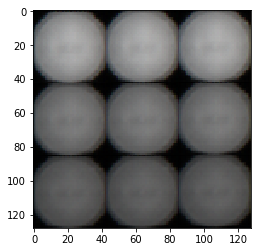

In [13]:
z = Variable(torch.rand(1,z_dim,1,1))
out1=G(z.cuda())
print out1.size()
nm1=out1.data.cpu().numpy()
plt.imshow(np.resize(nm1,(128,128,3)))
plt.show()

In [ ]:
testz = Variable(torch.rand(1,z_dim,1,1))
testx = Variable(torch.rand(1,3,128,128))
print testz.size()
print testx.size()